In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

95


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1653835,North America,North America,NaN,7370.0,832.0,"+3,565",NaN,18964.0,NaN,3246860,171261.0,1421764.0,NaN,NaN
1,NaN,\n,NaN,NaN,763359,South America,South America,NaN,1008.0,78.0,"+89,705",NaN,12892.0,NaN,2299908,87067.0,1449482.0,NaN,NaN
2,NaN,\n,NaN,NaN,877616,Europe,Europe,NaN,NaN,NaN,NaN,NaN,5636.0,NaN,2456661,192122.0,1386923.0,NaN,NaN
3,NaN,\n,NaN,NaN,752600,Asia,Asia,NaN,6746.0,115.0,"+4,665",NaN,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
4,NaN,\n,NaN,NaN,209944,Africa,Africa,NaN,NaN,NaN,NaN,NaN,919.0,NaN,421382,10443.0,200995.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,752600,Asia,Total:,NaN,6746.0,115.0,"+4,665",NaN,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
226,NaN,,NaN,NaN,209944,Africa,Total:,NaN,NaN,NaN,NaN,NaN,919.0,NaN,421382,10443.0,200995.0,NaN,NaN
227,NaN,,NaN,NaN,830,Australia/Oceania,Total:,NaN,83.0,NaN,NaN,NaN,6.0,NaN,9643,126.0,8687.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,159938,Europe,European Union,299.451648,0.0,0.0,NaN,NaN,2318.0,65537.202277,1290784,133331.0,620657.0,29180473.0,2899.006199


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1653835,North America,North America,NaN,7370.0,832.0,"+3,565",NaN,18964.0,NaN,3246860,171261.0,1421764.0,NaN,NaN
1,NaN,\n,NaN,NaN,763359,South America,South America,NaN,1008.0,78.0,"+89,705",NaN,12892.0,NaN,2299908,87067.0,1449482.0,NaN,NaN
2,NaN,\n,NaN,NaN,877616,Europe,Europe,NaN,NaN,NaN,NaN,NaN,5636.0,NaN,2456661,192122.0,1386923.0,NaN,NaN
3,NaN,\n,NaN,NaN,752600,Asia,Asia,NaN,6746.0,115.0,"+4,665",NaN,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
4,NaN,\n,NaN,NaN,209944,Africa,Africa,NaN,NaN,NaN,NaN,NaN,919.0,NaN,421382,10443.0,200995.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
118,112.0,"1,497","34,895",6,216,Europe,Lithuania,29.0,0.0,0.0,0,"2,721,829",16.0,157335.0,1818,78.0,1524.0,428238.0,668.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


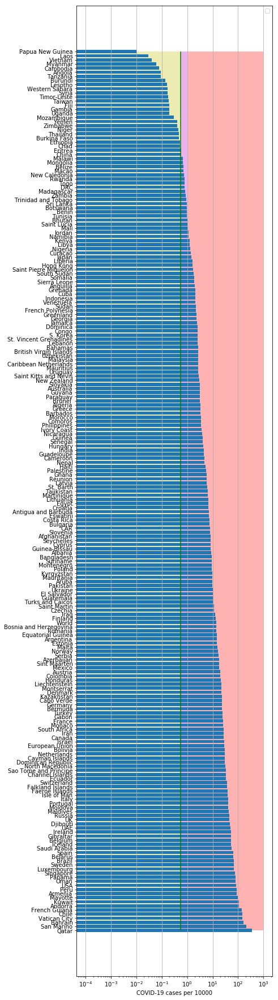

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


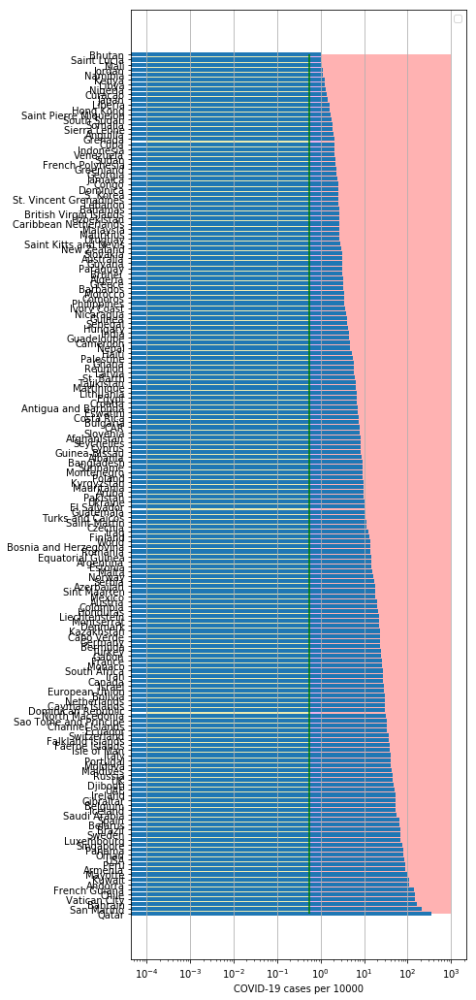

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

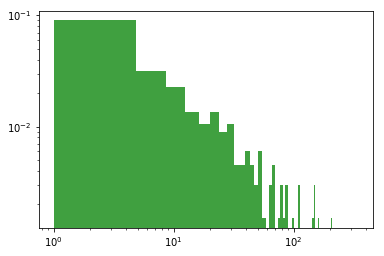

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
123 2020-06-27  295549       0  28341.0
124 2020-06-28  295850       0  28343.0
125 2020-06-29  296050       0  28346.0
126 2020-06-30  296351       0  28355.0
127 2020-07-01  296739       0  28363.0
GB
           date   cases  active    death
122 2020-06-27  310250       0  43514.0
123 2020-06-28  311151       0  43550.0
124 2020-06-29  311965       0  43575.0
125 2020-06-30  312654       0  43730.0
126 2020-07-01  313483       0  43906.0
IT
           date   cases  active    death
125 2020-06-27  240136   16836  34716.0
126 2020-06-28  240310   16681  34738.0
127 2020-06-29  240436   16496  34744.0
128 2020-06-30  240578   15563  34767.0
129 2020-07-01  240760   15255  34788.0
LT
           date   cases  active  death     tests
110 2020-06-27  1815.0     224   78.0  416739.0
111 2020-06-28  1816.0     216   78.0  418368.0
112 2020-06-29  1817.0     224   78.0  422840.0
113 2020-06-30  1818.0     206   78.0  428238.0
114 2020-07-01  1818.0  

PU
           date   cases    active   death
112 2020-06-27  275989  102830.0  9135.0
113 2020-06-28  279419  102104.0  9317.0
114 2020-06-29  282365  101702.0  9504.0
115 2020-06-30  285213  101001.0  9677.0
116 2020-07-01  288477  100372.0  9860.0
SB
           date  cases  active  death
109 2020-06-27  13792  1187.0  267.0
110 2020-06-28  14046  1312.0  270.0
111 2020-06-29  14288  1433.0  274.0
112 2020-06-30  14564  1625.0  277.0
113 2020-07-01  14836  1783.0  281.0
AG
           date    cases   active   death
115 2020-06-27  57744.0  37394.0  1207.0
116 2020-06-28  59933.0  38567.0  1232.0
117 2020-06-29  62268.0  39850.0  1280.0
118 2020-06-30  64530.0  41195.0  1307.0
119 2020-07-01  67197.0  42806.0  1351.0
CT
           date   cases  active  death
119 2020-06-27  2624.0   365.0  107.0
120 2020-06-28  2691.0   432.0  107.0
121 2020-06-29  2725.0   463.0  107.0
122 2020-06-30  2777.0   515.0  107.0
123 2020-07-01  2831.0   568.0  108.0
EG
           date  cases  active   death


In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5731200343237358
intercept: -0.6217148760528142
slope: [0.0518543]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


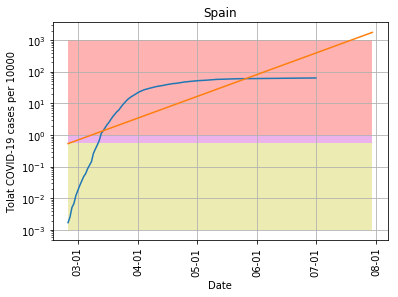

In [38]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [39]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7119735255448605
intercept: -2.20319006559623
slope: [0.06360949]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


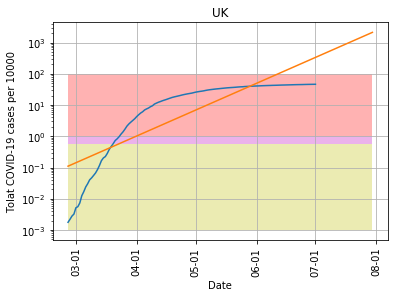

In [40]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [41]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.955109569665593
intercept: 1.4715306083874704
slope: [-0.03908749]


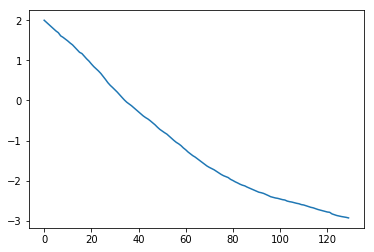

In [42]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


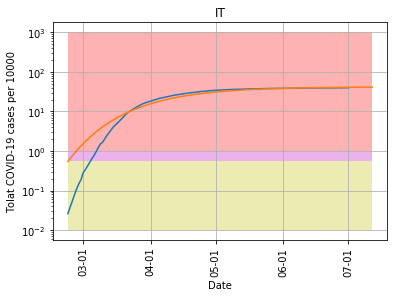

In [43]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [44]:
cs=y_pred11[-1]/10000.*populationIT

In [45]:
cs

249385.45562311113

In [46]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5030607831570039
intercept: -0.9050593988554059
slope: [0.03394968]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


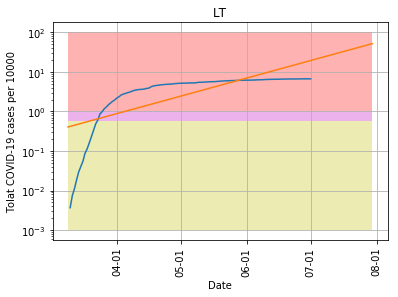

In [48]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [49]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7515392254545373
intercept: -4.0443487562946085
slope: [0.07022898]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


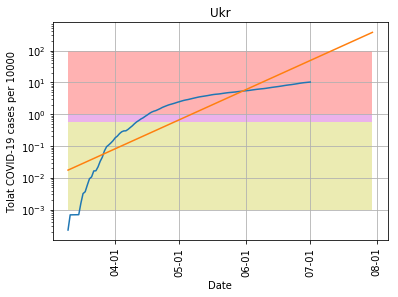

In [50]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


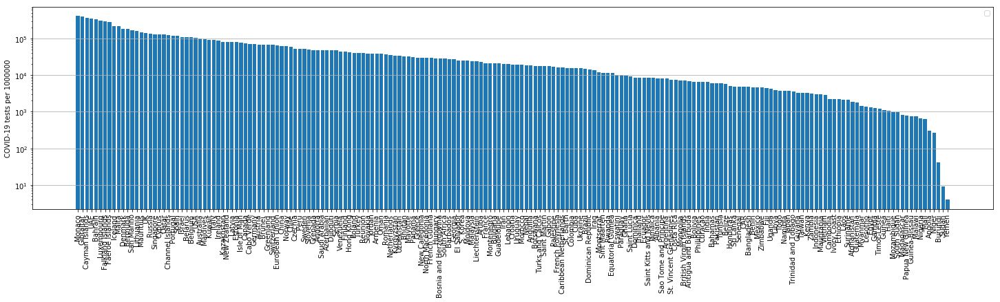

In [51]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [52]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.687809584330107
intercept: -1.6750127245607458
slope: [0.06443752]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


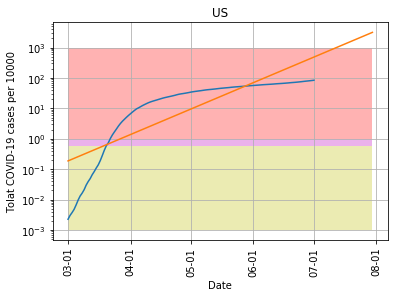

In [53]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [54]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.103295


(0, 0.15)

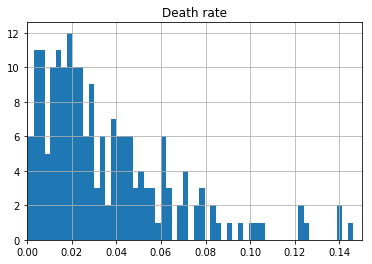

In [55]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

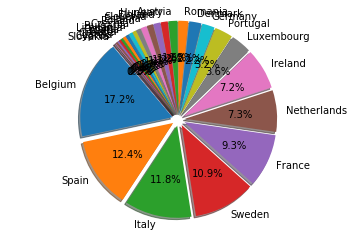

In [56]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [57]:
dfTTh.head()

,Country,Deathsper1Mpop
32,Belgium,842.0
12,Spain,607.0
15,Italy,575.0
29,Sweden,532.0
22,France,457.0


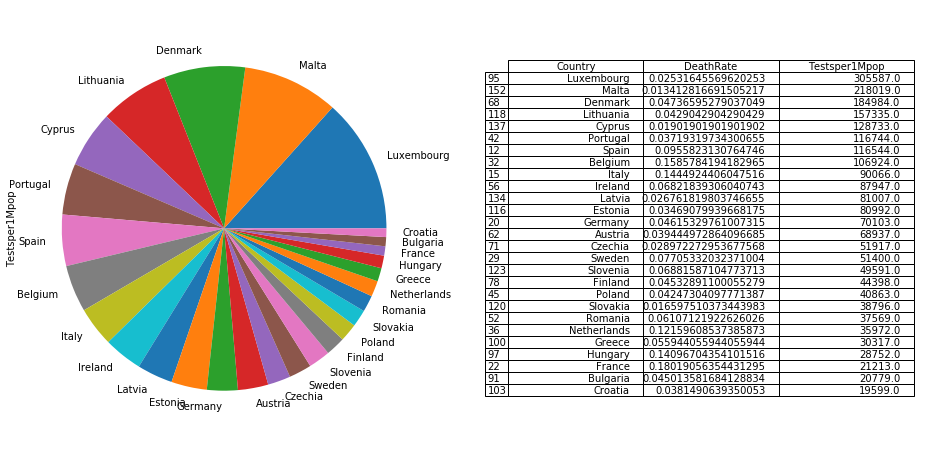

In [58]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

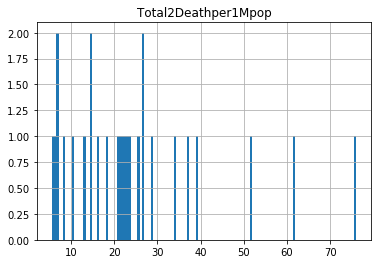

In [59]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [60]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6347.0,607.0
15,Italy,3982.0,575.0
20,Germany,2343.0,108.0
22,France,2539.0,457.0
29,Sweden,6901.0,532.0


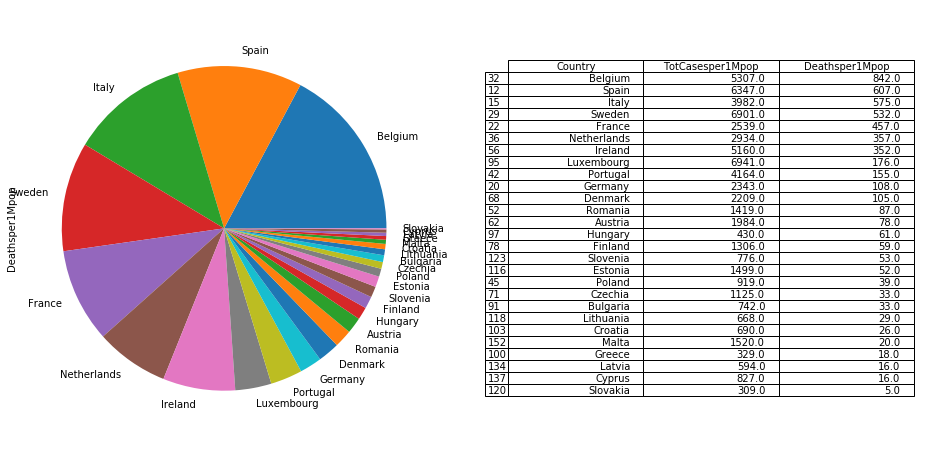

In [61]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [62]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1653835,North America,North America,0.0,7370.0,832.0,"+3,565",0,18964.0,0.0,3246860,171261.0,1421764.0,0.0,0.0
1,0.0,\n,0,0,763359,South America,South America,0.0,1008.0,78.0,"+89,705",0,12892.0,0.0,2299908,87067.0,1449482.0,0.0,0.0
2,0.0,\n,0,0,877616,Europe,Europe,0.0,0.0,0.0,0,0,5636.0,0.0,2456661,192122.0,1386923.0,0.0,0.0
3,0.0,\n,0,0,752600,Asia,Asia,0.0,6746.0,115.0,"+4,665",0,19488.0,0.0,2375132,58049.0,1564483.0,0.0,0.0
4,0.0,\n,0,0,209944,Africa,Africa,0.0,0.0,0.0,0,0,919.0,0.0,421382,10443.0,200995.0,0.0,0.0


In [63]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.054460
15,Italy,0.044212
20,Germany,0.033422
22,France,0.119691
29,Sweden,0.134261


In [64]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.134261
      France             0.119691
 Netherlands             0.081563
     Ireland             0.058672
       Spain             0.054460
     Belgium             0.049633
       Italy             0.044212
     Romania             0.037771
    Bulgaria             0.035709
    Portugal             0.035668
     Croatia             0.035206
     Germany             0.033422
     Finland             0.029416
     Austria             0.028780
  Luxembourg             0.022714
      Poland             0.022490
     Czechia             0.021669
     Estonia             0.018508
    Slovenia             0.015648
     Hungary             0.014955
     Denmark             0.011942
      Greece             0.010852
    Slovakia             0.007965
      Latvia             0.007333
       Malta             0.006972
      Cyprus             0.006424
   Lithuania             0.004246


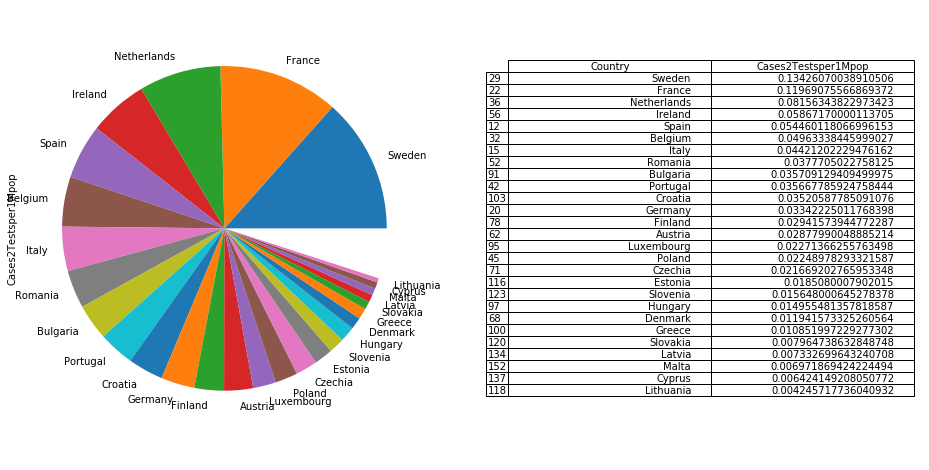

In [65]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [66]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
40,Singapore,0.000589,129520.000000
27,Qatar,0.001186,128393.000000
66,Nepal,0.002136,18323.000000
136,Rwanda,0.002879,11421.000000
104,Palestine,0.002901,16590.000000
74,Uzbekistan,0.002920,33501.000000
51,Bahrain,0.003356,331820.000000
96,French Guiana,0.003749,29157.000000
108,Maldives,0.003778,95421.000000
158,Réunion,0.003788,39560.000000


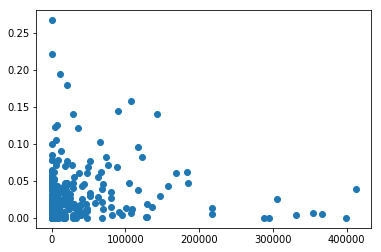

In [67]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


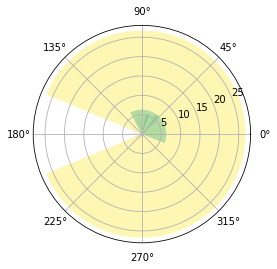

In [68]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

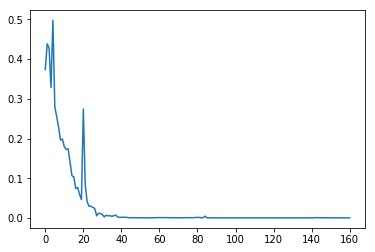

In [69]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [70]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


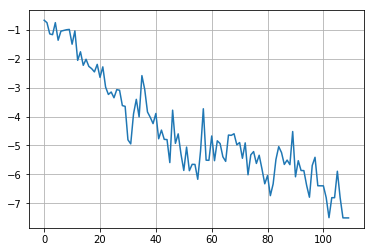

In [71]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

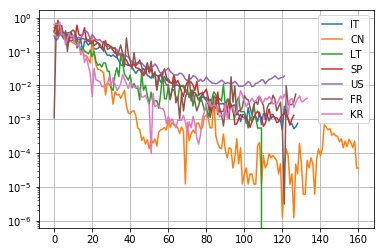

In [72]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

122 122
coefficient of determination: 0.7799807148156798
intercept: -10.344976509391312
slope: [-0.0934719]


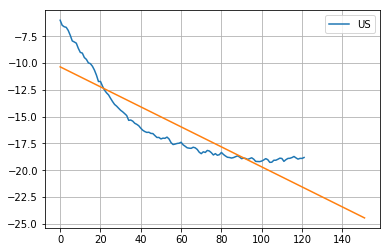

In [73]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [74]:
#np.diff(dfIT["cases"])

129 129
coefficient of determination: 0.8807850363410269
intercept: -10.463004622649933
slope: [-0.08496638]


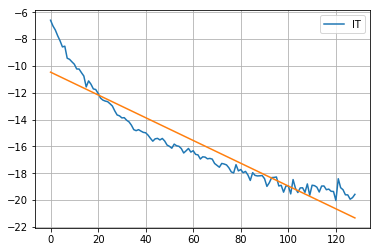

In [75]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [76]:
#model11.coef_

In [77]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

111 111
coefficient of determination: 0.8794066319315487
intercept: -15.515835478687604
slope: [-0.05135826]


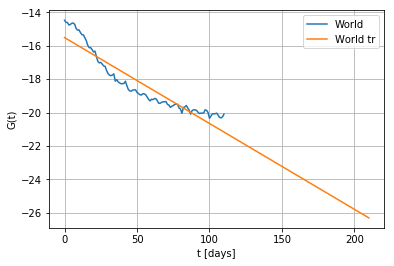

In [78]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

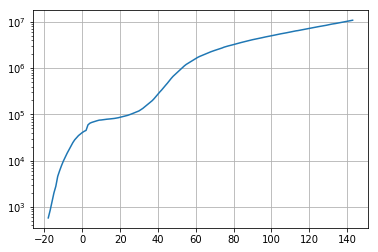

In [79]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [80]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.20310972e+07  1.12323580e+00 -1.48747983e+02  1.38476311e-02]


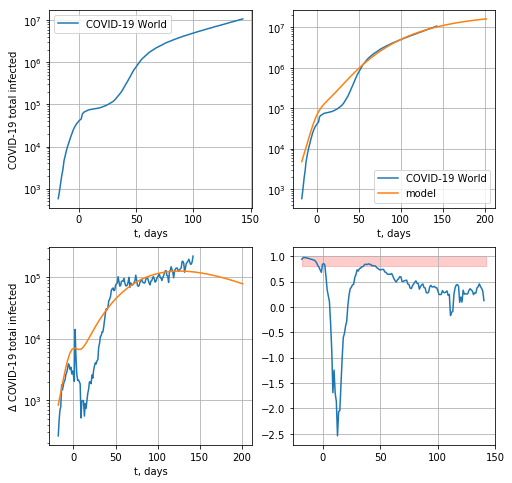

186473.28634249352


In [81]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

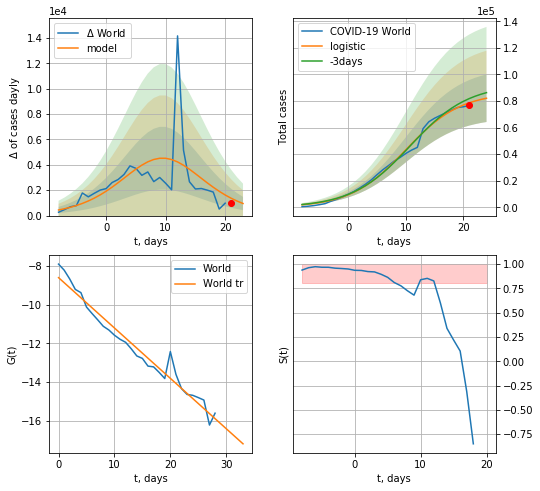

World data at: 2020-07-01
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +3 days
	 deltaDaycases:  952
	 total cases:  82121 ± 17886
	 total death:  3943 ± 2576
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


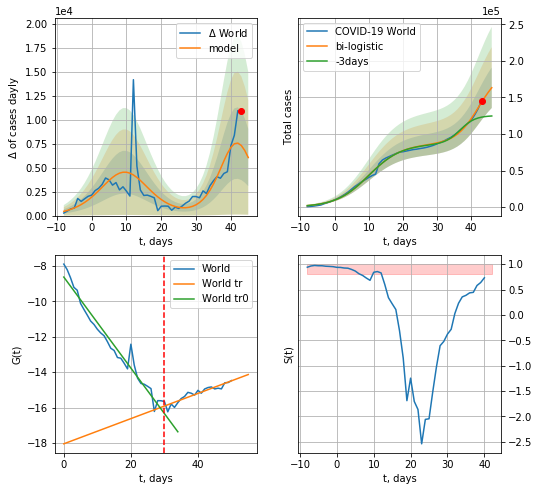

World data at: 2020-07-01
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +3 days
	 deltaDaycases:  6044
	 total cases:  163366 ± 27760
	 total death:  7844 ± 3998
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


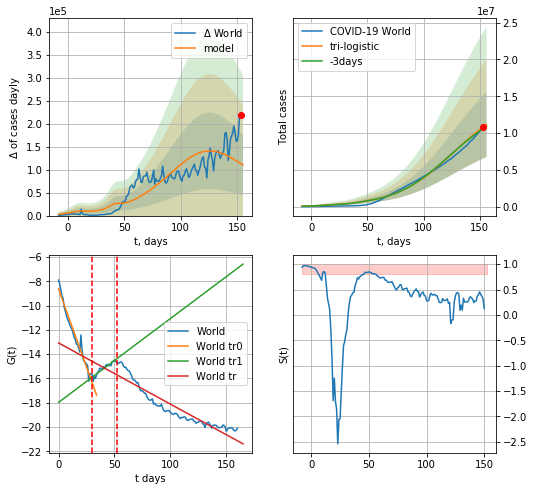

World data at: 2020-07-01
+3 day model MAPE: 0.022980300820371675
model: tri-logistic
coeffs:  [1.28320576e+07 4.09117937e-02 1.22852361e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.39639075381130195
forecast at the end of period: +3 days
	 deltaDaycases:  110182
	 total cases:  11159295 ± 4423441
	 total death:  535840 ± 637206
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.874958
 intercept: -13.075468
 slope: -0.050328


In [82]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*14-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

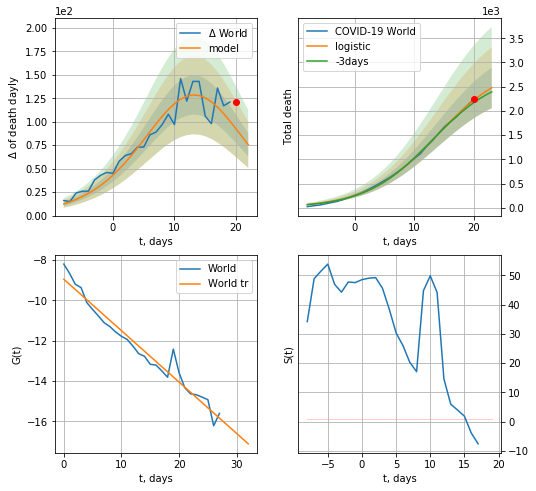

World data at: 2020-07-01
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +3 days
	 total death:  2476 ± 419
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


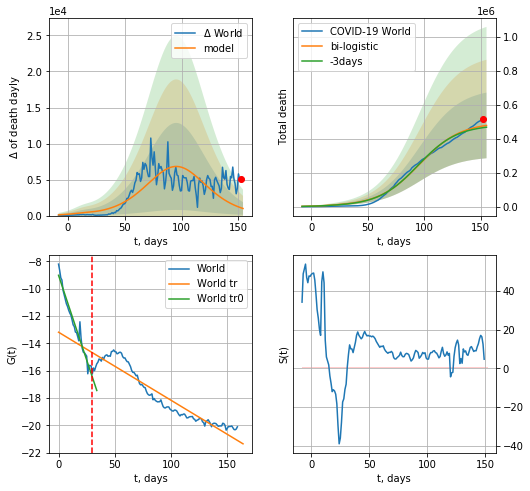

World data at: 2020-07-01
+3 day model MAPE: 0.021673872162935624
model: bi-logistic
coeffs:  [4.93846341e+05 5.52659117e-02 9.58336881e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4044259089819181
forecast at the end of period: +3 days
	 deltaDaydeath:  987
	 total death:  478731 ± 193611
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.898472
 intercept: -13.185135
 slope: -0.049724


In [83]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [84]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


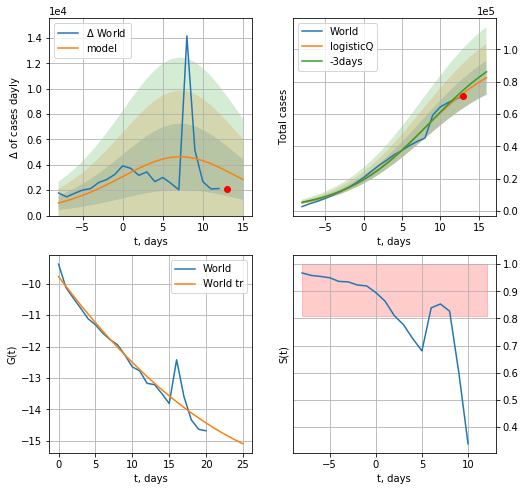

World data at: 2020-07-01
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +3 days
	 deltaDaycases: 2839
	 total cases: 82454 ± 10468
	 total death: 3959 ± 1507
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


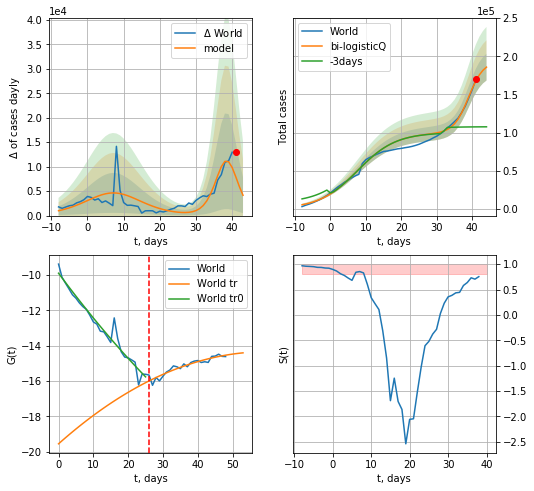

World data at: 2020-07-01
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +3 days
	 deltaDaycases: 4152
	 total cases: 185813 ± 17596
	 total death: 8922 ± 2534
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


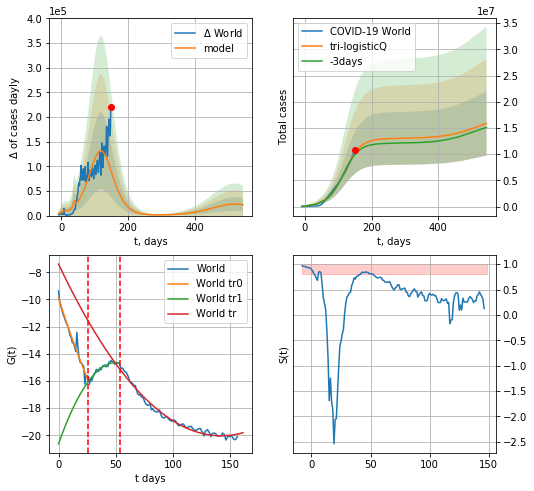

World data at: 2020-07-01
+3 day model MAPE: 0.030160
model: tri-logisticQ
coeffs: [ 1.28083496e+07  2.36998083e-07  1.18796085e+02 -1.72842334e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386541
forecast at the end of period: +395 days
	 deltaDaycases: 21808
	 total cases: 15868498 ± 6133826
	 total death: 761964 ± 883591
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.982150
 intercept_: -7.4005044260195625
 coeffs_: [ 0.         -0.17812775  0.00062784]


In [85]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


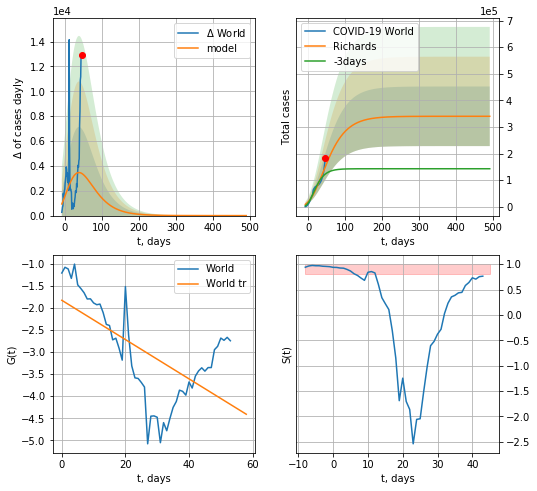

World data at: 2020-07-01
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +445 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 16329 ± 16130
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


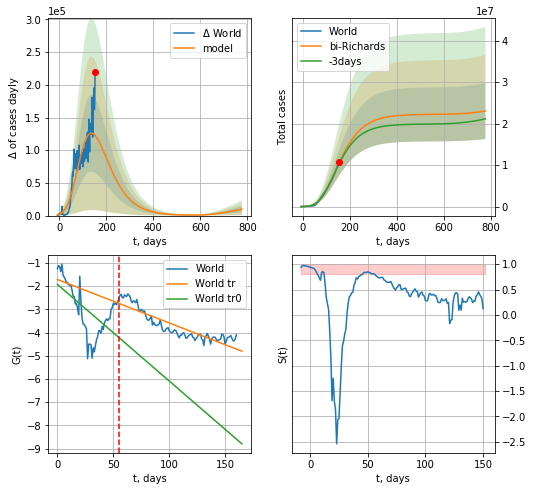

World data at: 2020-07-01
+3 day model MAPE: 0.019443
model: bi-Richards
coeffs: [ 2.19028446e+07  1.26879767e+00 -1.42721806e+02  1.23441371e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.292982
forecast at the end of period: +625 days
	 deltaDaycases: 9704
	 total cases: 23031008 ± 6747674
	 total death: 1105889 ± 972017
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.358115
 intercept: -1.923852
 slope: -0.041641
trend coefficient of determination: 0.793752
 intercept: -1.711511
 slope: -0.018733


In [86]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

162


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


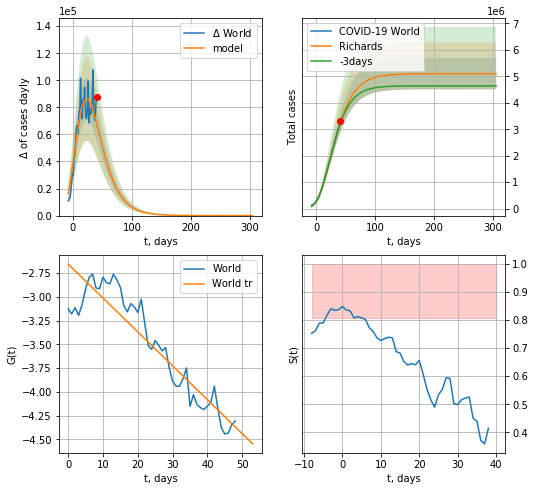

World data at: 2020-07-01
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +265 days
	 deltaDaycases: 0
	 total cases: 5102534 ± 589488
	 total death: 245010 ± 84917
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


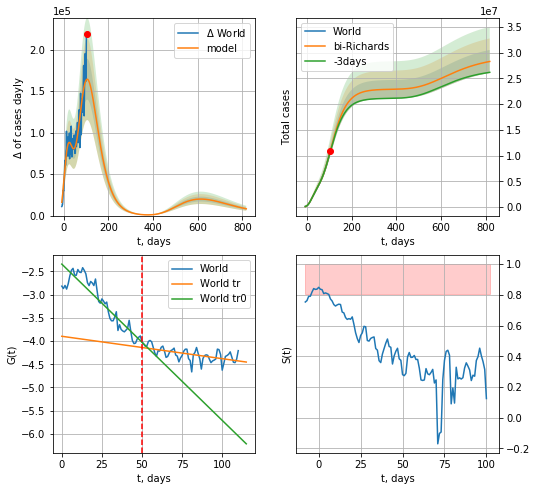

World data at: 2020-07-01
+3 day model MAPE: 0.007691
model: bi-Richards
coeffs: [ 1.77877927e+07  1.29048023e+00 -5.22226031e+01  1.90840678e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.079142
forecast at the end of period: +715 days
	 deltaDaycases: 8168
	 total cases: 28276256 ± 2237851
	 total death: 1357752 ± 322367
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.843536
 intercept: -2.342884
 slope: -0.033671
trend coefficient of determination: 0.340761
 intercept: -3.897887
 slope: -0.004826


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


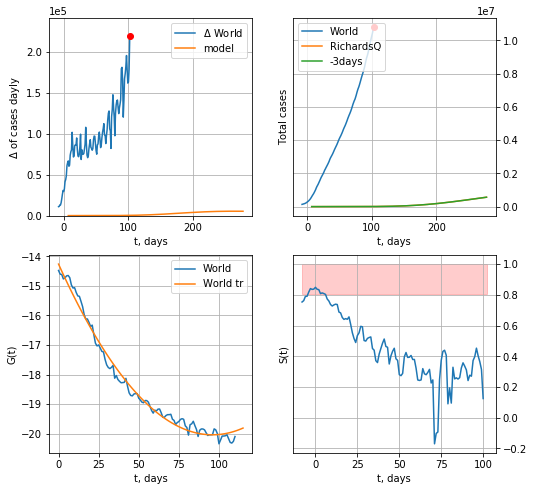

World data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.29689889e+06  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +175 days
	 deltaDaycases: 5292


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [87]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,90*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


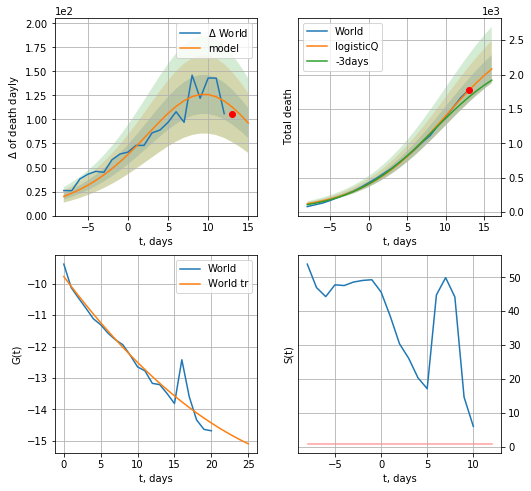

World data at: 2020-07-01
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +3 days
	 total death: 2081 ± 203
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


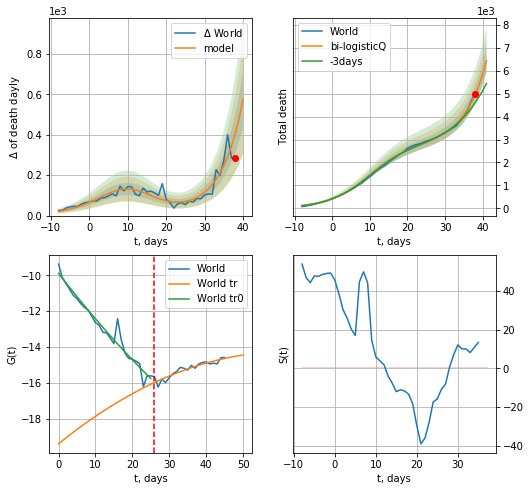

World data at: 2020-07-01
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +3 days
	 total death: 6424 ± 492
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


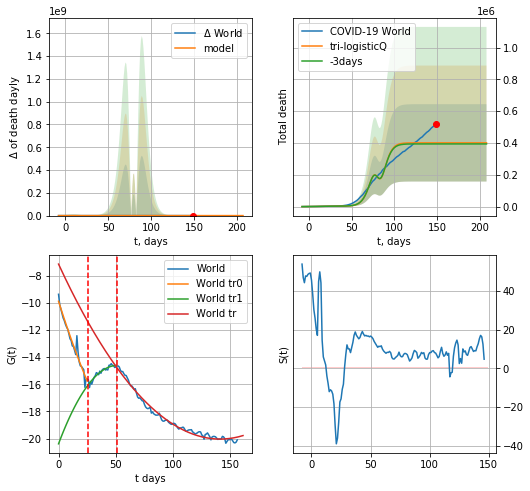

World data at: 2020-07-01
+3 day model MAPE: 0.017123
model: tri-logisticQ
coeffs: [-6.02380628e+06  1.15151014e-03 -1.27338563e+02  7.95338706e+01]
rational stdev: 0.606206
forecast at the end of period: +59 days
	 total death: 400905 ± 243031
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.984392
 intercept_: -7.152907506512893
 coeffs_: [ 0.         -0.18266441  0.00064759]


In [88]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


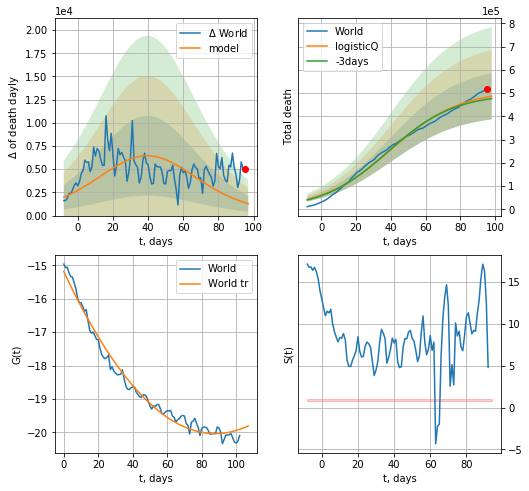

World data at: 2020-07-01
+3 day model MAPE: 0.020691
model: logisticQ
coeffs: [ 5.12490503e+05  2.51159211e-07  3.99997479e+01 -2.00567765e+05]
rational stdev: 0.204524
forecast at the end of period: +3 days
	 total death: 486342 ± 99468
trend coefficient of determination: 0.982150
 intercept_: -15.187892674073836
 coeffs_: [ 0.         -0.11036345  0.00062824]


In [89]:
x = forecastRRR("World",dfW[58:],d1,7*14-dT,1.0,False,cases='death')

In [90]:
#trend(dfSP,'SP',10)

In [91]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
123 2020-06-27  295549       0  28341.0
124 2020-06-28  295850       0  28343.0
125 2020-06-29  296050       0  28346.0
126 2020-06-30  296351       0  28355.0
127 2020-07-01  296739       0  28363.0


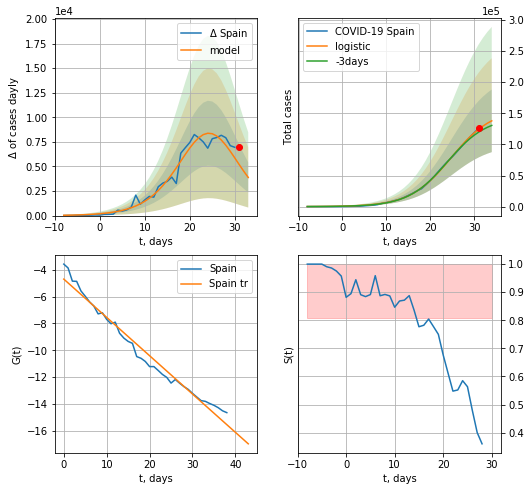

Spain data at: 2020-07-01
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +3 days
	 deltaDaycases:  3876
	 total cases:  137914 ± 50323
	 total death:  13182 ± 14430
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


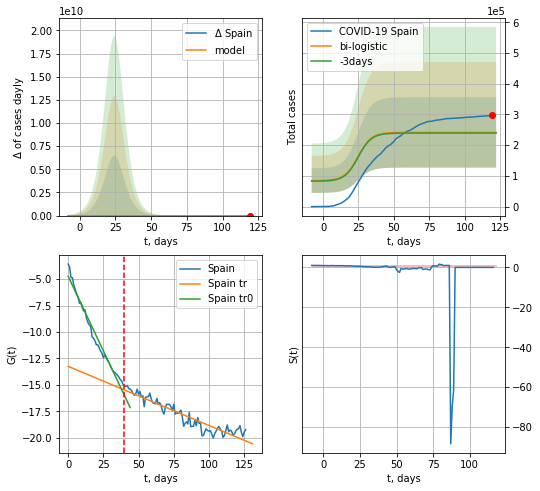

Spain data at: 2020-07-01
+3 day model MAPE: 0.008984965714727249
model: bi-logistic
coeffs:  [ 6.77095418e+04 -5.99361774e+00  1.55958653e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.4739884250028535
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  241594 ± 114512
	 total death:  23092 ± 32836
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.880884
 intercept: -13.251101
 slope: -0.055938


In [92]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*14-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

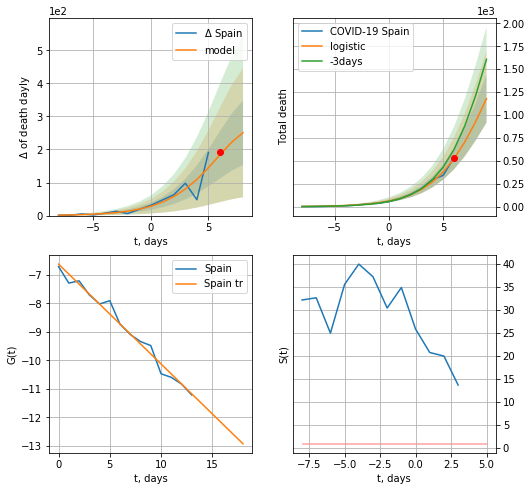

Spain data at: 2020-07-01
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +3 days
	 total death:  1178 ± 260
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


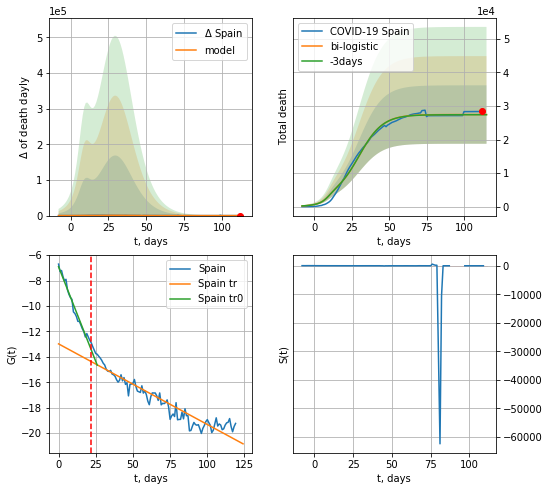

Spain data at: 2020-07-01
+3 day model MAPE: 0.002052657014543847
model: bi-logistic
coeffs:  [2.47029996e+04 1.25776628e-01 3.00022855e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3172573138428015
forecast at the end of period: +3 days
	 deltaDaydeath:  0
	 total death:  27447 ± 8707
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.900890
 intercept: -12.982241
 slope: -0.063405


In [93]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*14-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


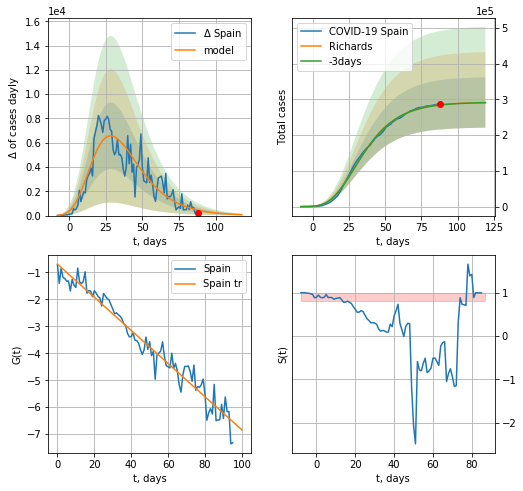

Spain data at: 2020-07-01
+3 day model MAPE: 0.001576
model: Richards
coeffs: [ 2.92623031e+05  8.19006343e+00 -5.10999338e+01  7.47571626e-03]
rational stdev: 0.241957
forecast at the end of period: +31 days
	 deltaDaycases: 73
	 total cases: 291451 ± 70518
	 total death: 27857 ± 20220
trend coefficient of determination: 0.955401
 intercept: -0.697601
 slope: -0.061420


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


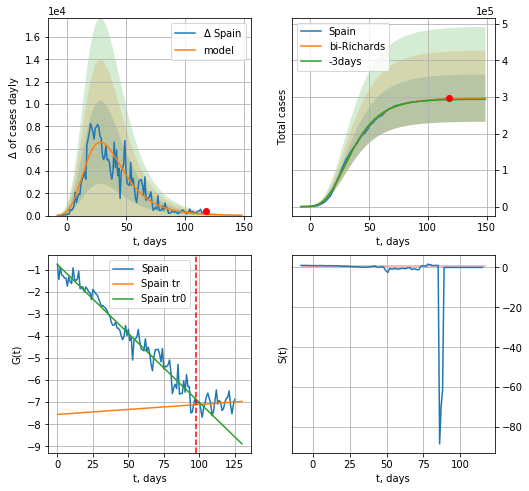

Spain data at: 2020-07-01
+3 day model MAPE: 0.009151
model: bi-Richards
coeffs: [5.00789567e+03 2.57528971e+00 3.67943482e+00 1.80897057e-02]
rational stdev: 0.218388
forecast at the end of period: +31 days
	 deltaDaycases: 25
	 total cases: 297136 ± 64890
	 total death: 28400 ± 18606
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.959495
 intercept: -0.768433
 slope: -0.062429
trend coefficient of determination: 0.014265
 intercept: -7.554279
 slope: 0.004523


In [103]:
vL = 98+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*18-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


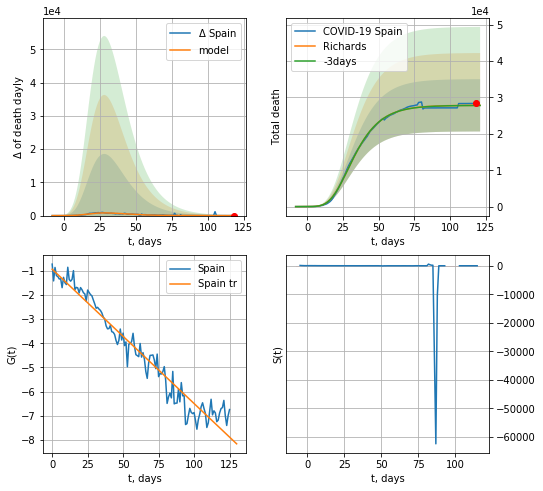

Spain data at: 2020-07-01
+3 day model MAPE: 0.001386
model: Richards
coeffs: [ 2.78523717e+04  9.81862874e+00 -3.20293334e+01  8.09223789e-03]
rational stdev: 0.258151
forecast at the end of period: +3 days
	 total death: 27834 ± 7185
trend coefficient of determination: 0.950656
 intercept: -0.929923
 slope: -0.055628


In [104]:
x = forecastRR('Spain',dfSP[1:],d1,7*14-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


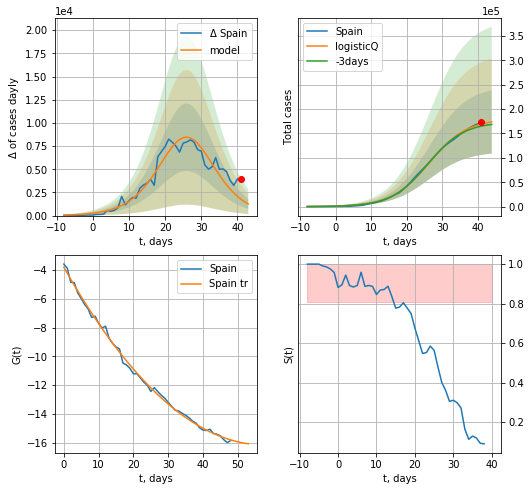

Spain data at: 2020-07-01
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +3 days
	 deltaDaycases: 1252
	 total cases: 173641 ± 64928
	 total death: 16597 ± 18617
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


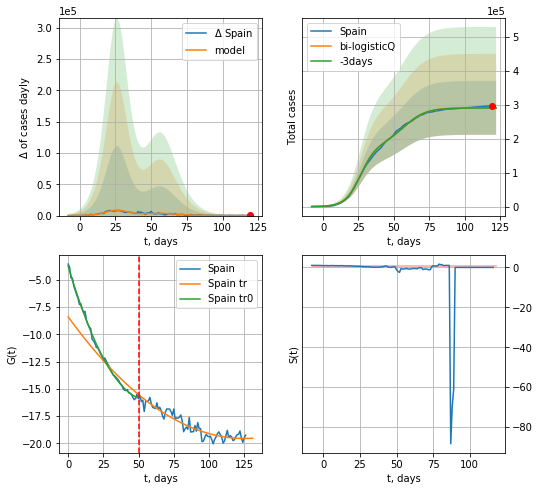

Spain data at: 2020-07-01
+3 day model MAPE: 0.002052
model: bi-logisticQ
coeffs: [ 1.10582971e+05  4.03397751e-07  5.71582963e+01 -3.19635732e+05]
rational stdev: 0.272840
forecast at the end of period: +3 days
	 deltaDaycases: 3
	 total cases: 290501 ± 79260
	 total death: 27766 ± 22727
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.890578
 intercept_: -8.415449566375049
 coeffs_: [ 0.         -0.17775617  0.00071004]


In [105]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


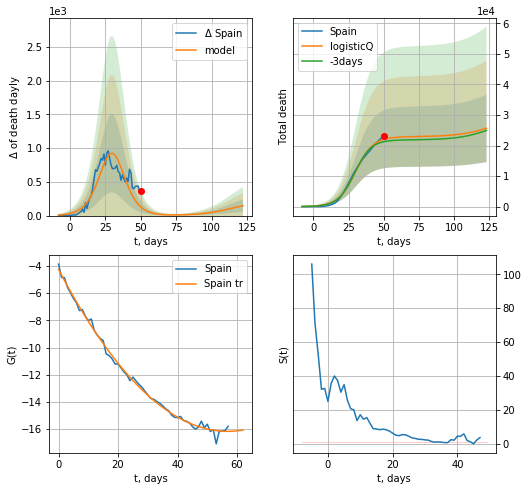

Spain data at: 2020-07-01
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +73 days
	 total death: 25665 ± 11057
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


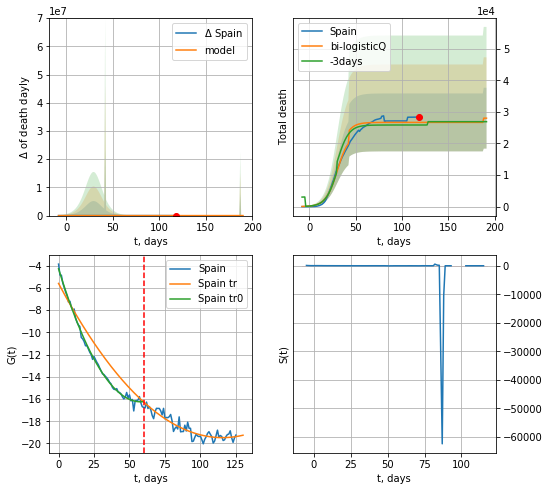

Spain data at: 2020-07-01
+3 day model MAPE: 0.031897
model: bi-logisticQ
coeffs: [3793.73155391   10.38172521   42.93150292  -24.25649299]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343921
forecast at the end of period: +73 days
	 total death: 28017 ± 9635
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.851013
 intercept_: -5.609245892642134
 coeffs_: [ 0.         -0.24002836  0.00103886]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [106]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


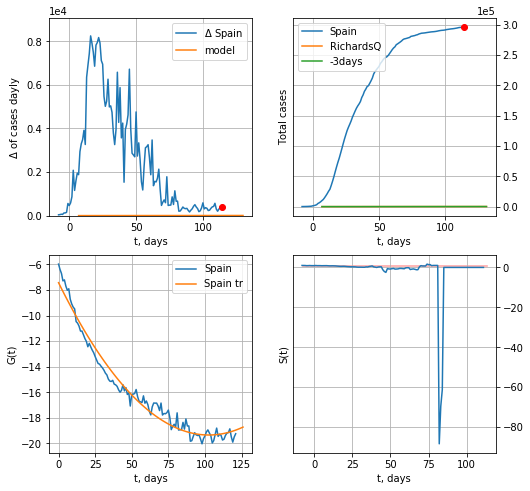

Spain data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.79976480e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +17 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [107]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

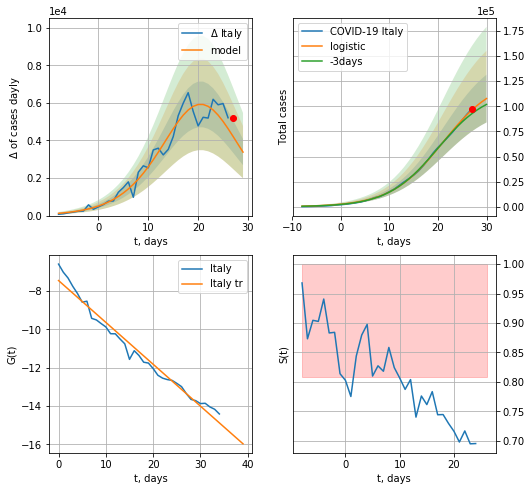

Italy data at: 2020-07-01
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +3 days
	 deltaDaycases:  3378
	 total cases:  107738 ± 23773
	 total death:  15567 ± 10304
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


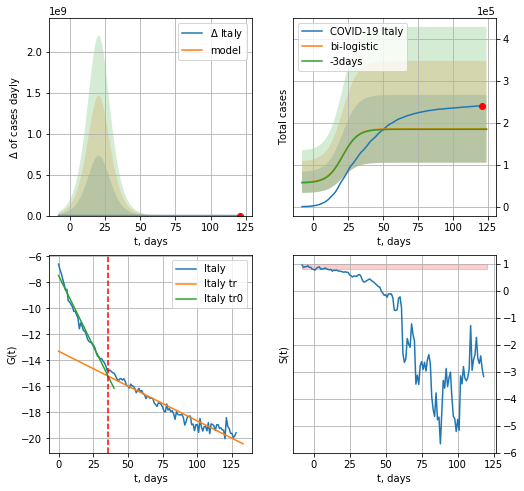

Italy data at: 2020-07-01
+3 day model MAPE: 0.006997902648926778
model: bi-logistic
coeffs:  [ 5.77626947e+04 -2.64811678e+01  1.34395681e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.43584760120459637
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  185901 ± 81024
	 total death:  26861 ± 35121
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.936012
 intercept: -13.299437
 slope: -0.053605


In [108]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

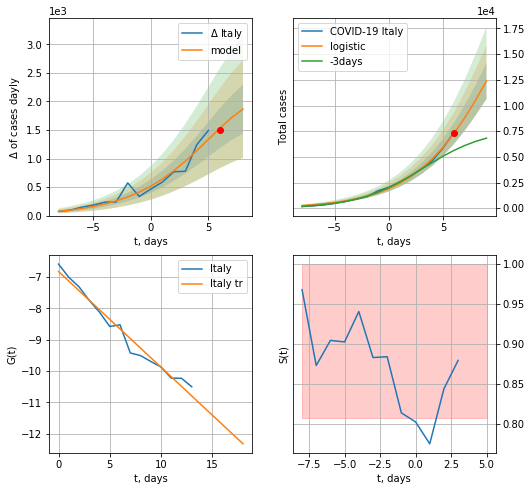

Italy data at: 2020-07-01
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +3 days
	 deltaDaycases:  1866
	 total cases:  12394 ± 1753
	 total death:  1790 ± 759
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


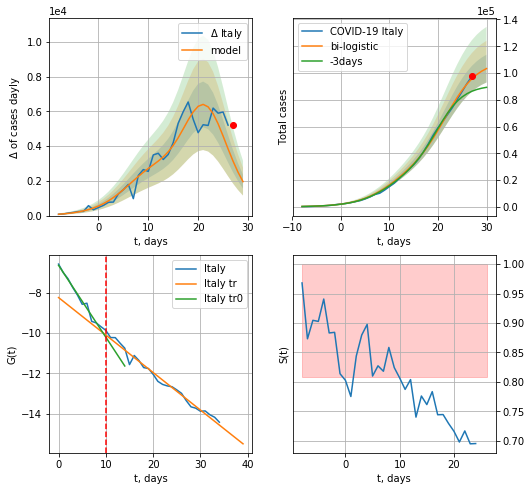

Italy data at: 2020-07-01
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +3 days
	 deltaDaycases:  1953
	 total cases:  103307 ± 10381
	 total death:  14927 ± 4500
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


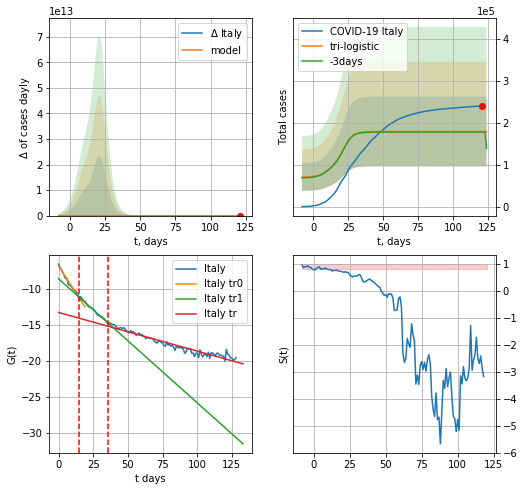

Italy data at: 2020-07-01
+3 day model MAPE: 0.008128826312065643
model: tri-logistic
coeffs:  [ 7.02448692e+04 -4.73911773e+00  1.05712163e+03] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.46361681515668585
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  179607 ± 83268
	 total death:  25951 ± 36093
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.936012
 intercept: -13.299437
 slope: -0.053605


In [109]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

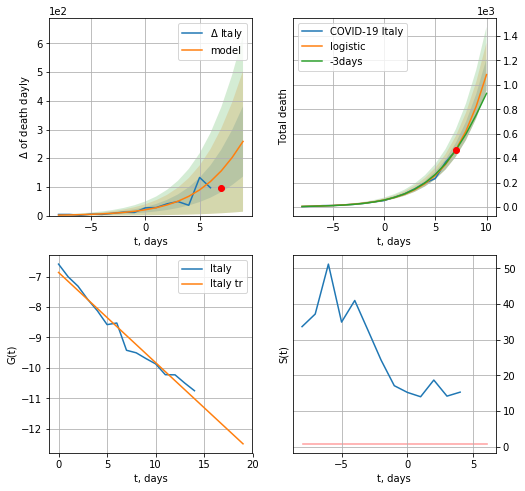

Italy data at: 2020-07-01
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +3 days
	 total death:  1083 ± 130
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


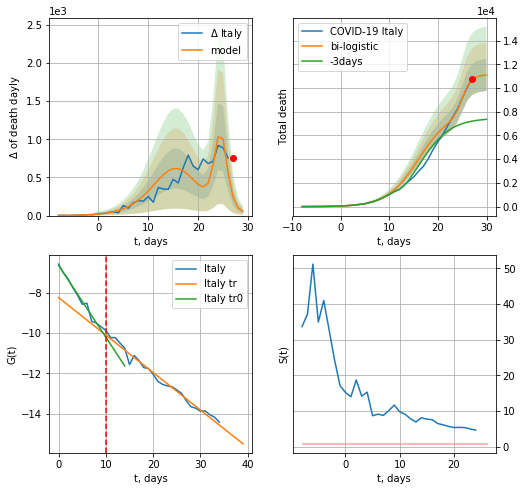

Italy data at: 2020-07-01
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +3 days
	 deltaDaydeath:  52
	 total death:  11100 ± 1351
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


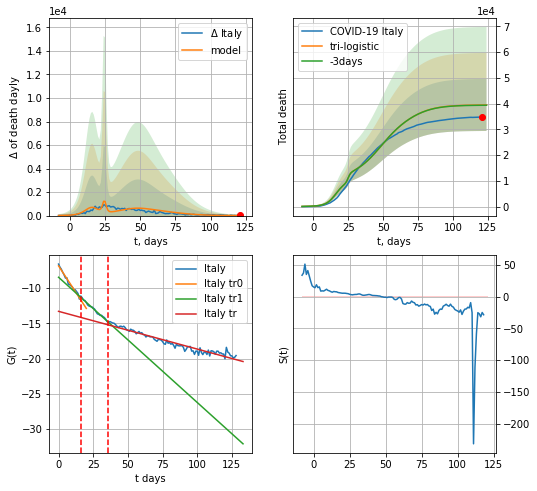

Italy data at: 2020-07-01
+3 day model MAPE: 0.002589945191292445
model: tri-logistic
coeffs:  [2.26395584e+04 1.04076135e-01 4.76777466e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.25596813553529413
forecast at the end of period: +3 days
	 deltaDaydeath:  3
	 total death:  39479 ± 10105
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.936012
 intercept: -13.299437
 slope: -0.053605


In [110]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


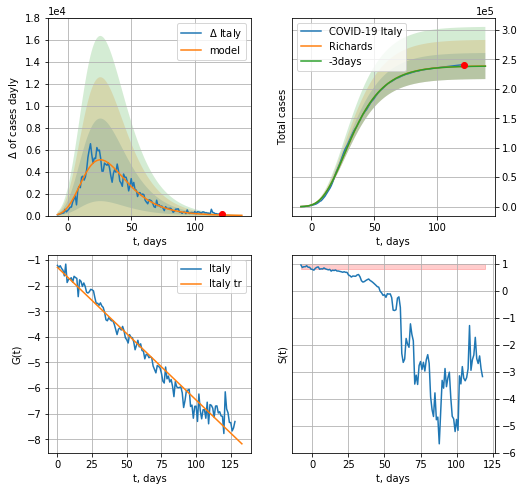

Italy data at: 2020-07-01
+3 day model MAPE: 0.001000
model: Richards
coeffs: [ 2.38830872e+05  6.14720466e+00 -5.40748045e+01  9.44189146e-03]
rational stdev: 0.092736
forecast at the end of period: +17 days
	 deltaDaycases: 21
	 total cases: 238466 ± 22114
	 total death: 34456 ± 9585
trend coefficient of determination: 0.972412
 intercept: -1.284533
 slope: -0.051811


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


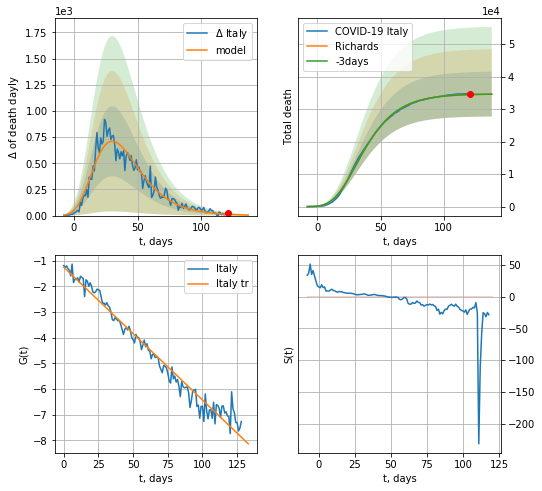

Italy data at: 2020-07-01
+3 day model MAPE: 0.000876
model: Richards
coeffs: [ 3.47078817e+04  8.20416907e+00 -5.87385522e+01  6.80990020e-03]
rational stdev: 0.198911
forecast at the end of period: +17 days
	 total death: 34622 ± 6886
trend coefficient of determination: 0.972442
 intercept: -1.260145
 slope: -0.051723


In [111]:
vL=95
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


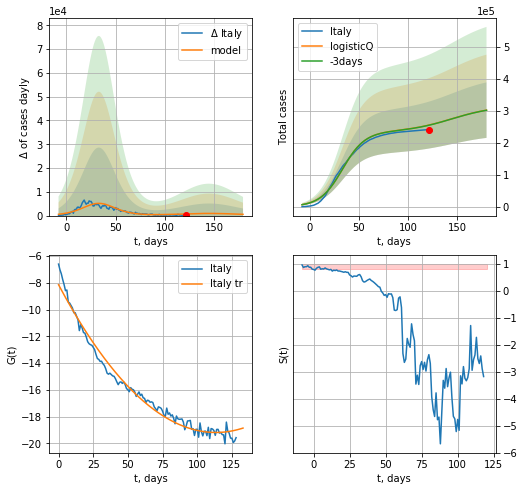

Italy data at: 2020-07-01
+3 day model MAPE: 0.001562
model: logisticQ
coeffs: [ 2.33478138e+05  2.66902869e-07  3.32488364e+01 -3.28668142e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287445
forecast at the end of period: +59 days
	 deltaDaycases: 535
	 total cases: 301671 ± 86714
	 total death: 43589 ± 37588
trend coefficient of determination: 0.980876
 intercept_: -8.133286765196997
 coeffs_: [ 0.         -0.195034    0.00085991]


In [112]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


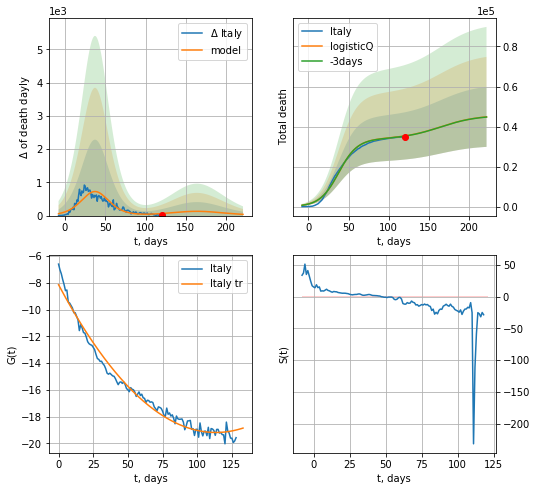

Italy data at: 2020-07-01
+3 day model MAPE: 0.002152
model: logisticQ
coeffs: [ 3.37867496e+04  2.44036709e-07  3.76872566e+01 -3.50302208e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334206
forecast at the end of period: +101 days
	 total death: 44831 ± 14982
trend coefficient of determination: 0.980876
 intercept_: -8.133286765196997
 coeffs_: [ 0.         -0.195034    0.00085991]


In [113]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [114]:
dT

95

FR
           date     cases  active    death
133 2020-06-27  163376.0   57509  29778.0
134 2020-06-28  163817.0   57509  29778.0
135 2020-06-29  164260.0   58798  29813.0
136 2020-06-30  164801.0   58684  29843.0
137 2020-07-01  165719.0   59319  29861.0


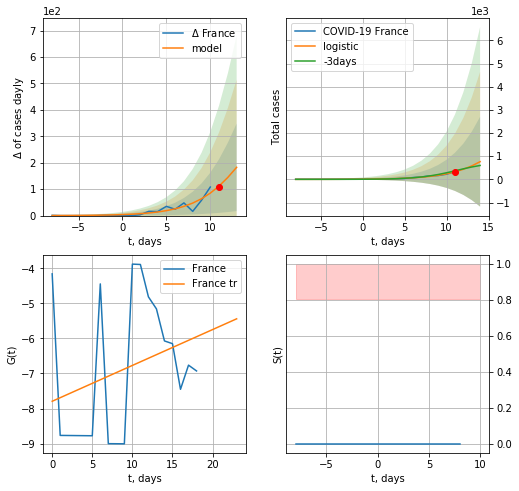

France data at: 2020-07-01
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +3 days
	 deltaDaycases:  182
	 total cases:  763 ± 1939
	 total death:  137 ± 1043
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


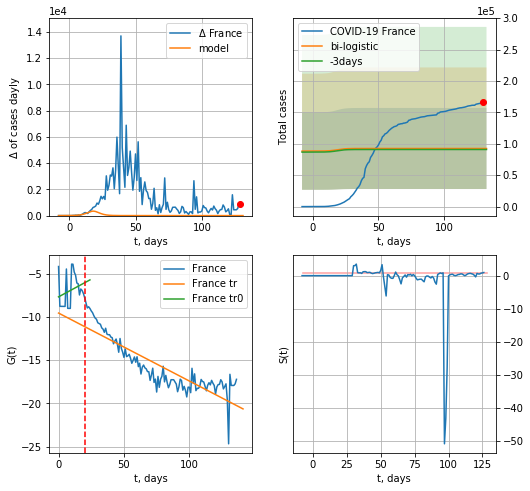

France data at: 2020-07-01
+3 day model MAPE: 0.01770424558456902
model: bi-logistic
coeffs:  [ 8.83344376e+04 -5.36041127e+00  1.40684104e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.6972161683269974
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  92508 ± 64498
	 total death:  16669 ± 34865
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.762405
 intercept: -9.545300
 slope: -0.078660


In [115]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,14*7-dT,1.0)
xx = forecast2('France',dfFR,d1,14*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [116]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

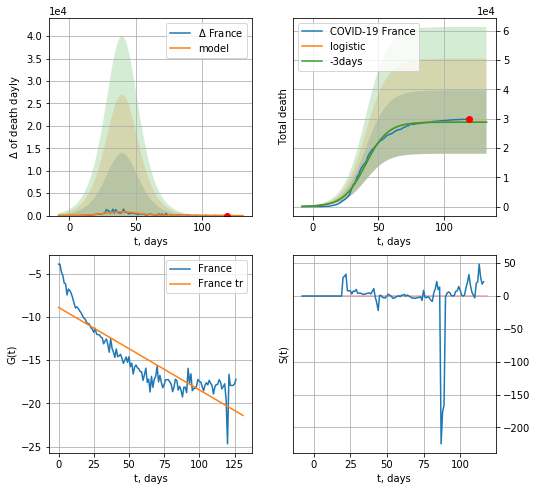

France data at: 2020-07-01
+3 day model MAPE: 0.0023910679331836026
model: logistic
coeffs:  [2.88644969e+04 1.19148583e-01 4.03073260e+01]
rational stdev:  0.3748079515503688
forecast at the end of period: +13 days
	 total death:  28863 ± 10818
trend coefficient of determination: 0.780633
 intercept: -8.893472
 slope: -0.095434


In [117]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


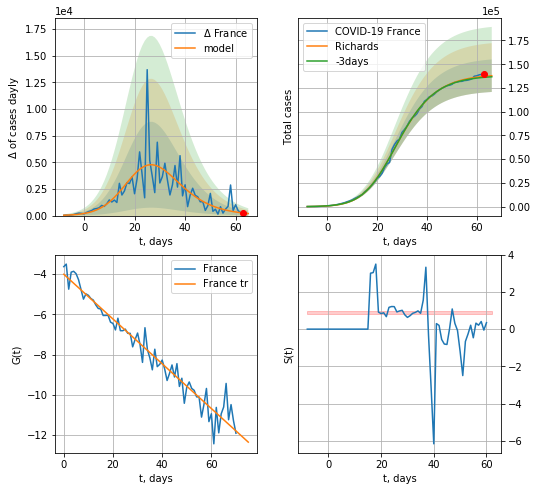

France data at: 2020-07-01
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +3 days
	 deltaDaycases: 193
	 total cases: 137914 ± 17127
	 total death: 24850 ± 9258
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


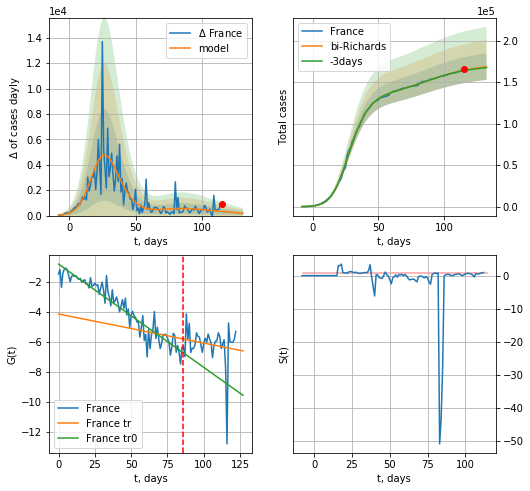

France data at: 2020-07-01
+3 day model MAPE: 0.003747
model: bi-Richards
coeffs: [ 3.35043484e+04  4.03422570e+00 -1.49622484e+01  1.09285587e-02]
rational stdev: 0.094708
forecast at the end of period: +17 days
	 deltaDaycases: 183
	 total cases: 168646 ± 15972
	 total death: 30388 ± 8633
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.904162
 intercept: -0.839996
 slope: -0.068838
trend coefficient of determination: 0.026093
 intercept: -4.162525
 slope: -0.019378


In [118]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


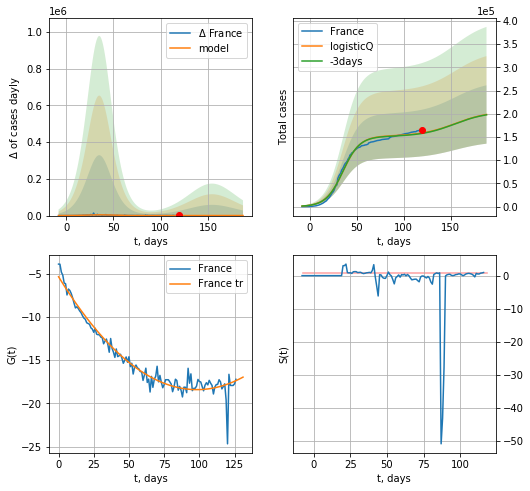

France data at: 2020-07-01
+3 day model MAPE: 0.005512
model: logisticQ
coeffs: [ 1.51877271e+05  2.58039595e-07  3.54841941e+01 -4.29084374e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316920
forecast at the end of period: +69 days
	 deltaDaycases: 357
	 total cases: 198404 ± 62878
	 total death: 35750 ± 33989
trend coefficient of determination: 0.949266
 intercept_: -5.342821380232744
 coeffs_: [ 0.         -0.26586872  0.00135267]


In [119]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


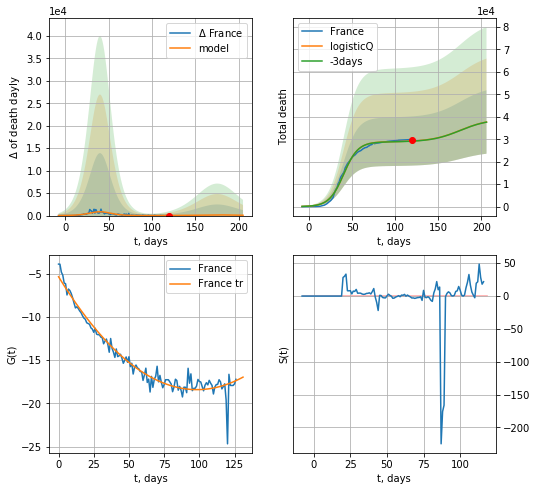

France data at: 2020-07-01
+3 day model MAPE: 0.002432
model: logisticQ
coeffs: [ 2.88643700e+04  3.75957824e-07  4.03075959e+01 -3.16768614e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374874
forecast at the end of period: +87 days
	 total death: 37657 ± 14116
trend coefficient of determination: 0.949266
 intercept_: -5.342821380232744
 coeffs_: [ 0.         -0.26586872  0.00135267]


In [120]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [121]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [122]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
124 2020-06-27  194689    8163  9026.0
125 2020-06-28  194864    8135  9029.0
126 2020-06-29  195392    7251  9041.0
127 2020-06-30  195832    6980  9052.0
128 2020-07-01  196324    7463  9061.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


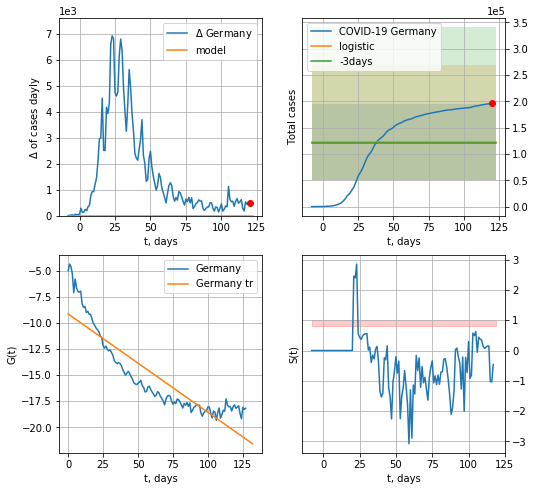

Germany data at: 2020-07-01
+3 day model MAPE: 0.014385301272904487
model: logistic
coeffs:  [ 1.22742264e+05 -4.79126673e+00  1.43214269e+02]
rational stdev:  0.5934101485195401
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  122742 ± 72836
	 total death:  5664 ± 10083
trend coefficient of determination: 0.799319
 intercept: -9.140607
 slope: -0.094297


In [123]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*14-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


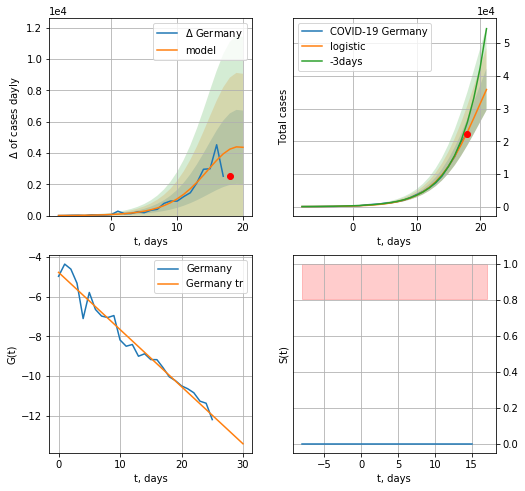

Germany data at: 2020-07-01
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +3 days
	 deltaDaycases:  4359
	 total cases:  35837 ± 6383
	 total death:  1654 ± 883
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


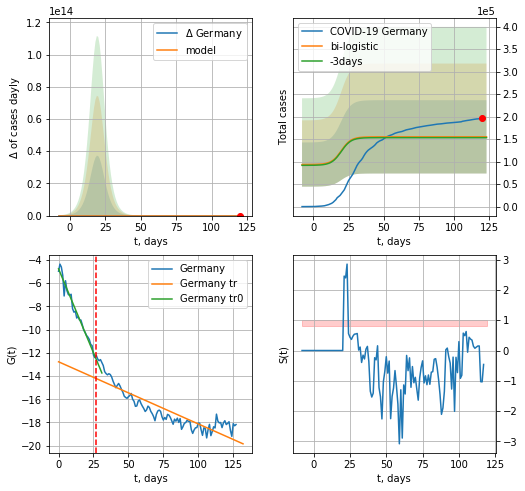

Germany data at: 2020-07-01
+3 day model MAPE: 0.011577578526838751
model: bi-logistic
coeffs:  [ 7.47146396e+04 -2.53040512e+00  1.39376793e+02] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5252923129715311
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  154943 ± 81390
	 total death:  7151 ± 11269
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.790945
 intercept: -12.771773
 slope: -0.053529


In [124]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,14*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*14-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
124 2020-06-27  194689    8163  9026.0
125 2020-06-28  194864    8135  9029.0
126 2020-06-29  195392    7251  9041.0
127 2020-06-30  195832    6980  9052.0
128 2020-07-01  196324    7463  9061.0


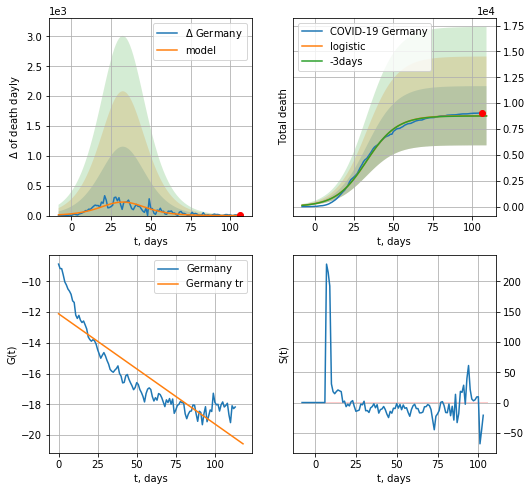

Germany data at: 2020-07-01
+3 day model MAPE: 0.002716483852247431
model: logistic
coeffs:  [8.78675281e+03 1.03153697e-01 3.29066888e+01]
rational stdev:  0.3257906221972602
forecast at the end of period: +3 days
	 total death:  8783 ± 2861
trend coefficient of determination: 0.794609
 intercept: -12.110617
 slope: -0.071720


In [125]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,14*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


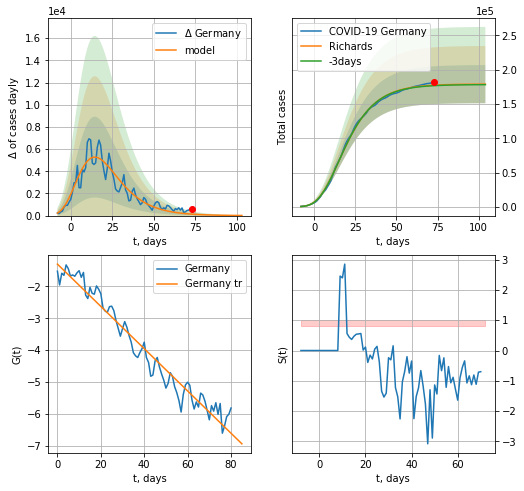

Germany data at: 2020-07-01
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +31 days
	 deltaDaycases: 11
	 total cases: 178971 ± 27832
	 total death: 8260 ± 3853
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


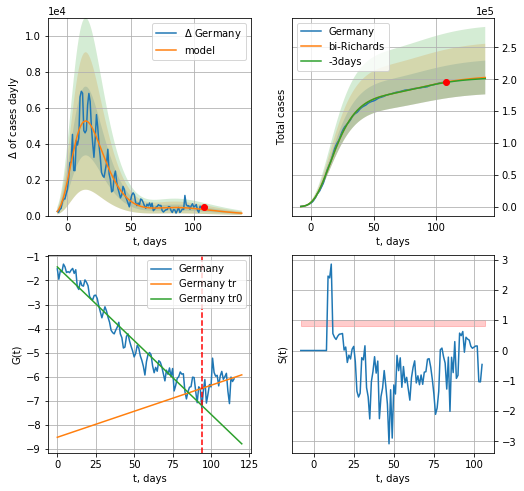

Germany data at: 2020-07-01
+3 day model MAPE: 0.002901
model: bi-Richards
coeffs: [ 2.69881941e+04  5.31927215e+00 -2.54291079e+01  7.85244179e-03]
rational stdev: 0.130416
forecast at the end of period: +31 days
	 deltaDaycases: 133
	 total cases: 202742 ± 26440
	 total death: 9357 ± 3660
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950726
 intercept: -1.437603
 slope: -0.061181
trend coefficient of determination: 0.080796
 intercept: -8.508553
 slope: 0.021590


In [126]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


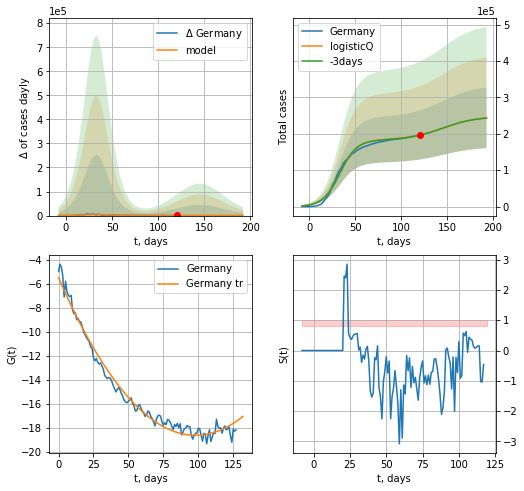

Germany data at: 2020-07-01
+3 day model MAPE: 0.003467
model: logisticQ
coeffs: [ 1.83424790e+05  2.53177170e-07  3.33243179e+01 -4.26888944e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341359
forecast at the end of period: +73 days
	 deltaDaycases: 233
	 total cases: 243883 ± 83251
	 total death: 11256 ± 11527
trend coefficient of determination: 0.982562
 intercept_: -5.497321721930536
 coeffs_: [ 0.         -0.26778961  0.0013661 ]


In [127]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


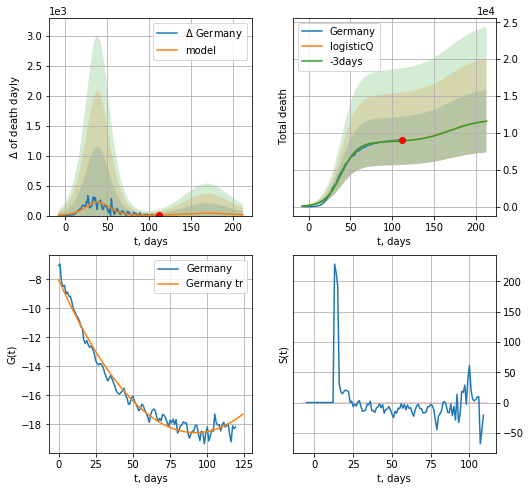

Germany data at: 2020-07-01
+3 day model MAPE: 0.002732
model: logisticQ
coeffs: [ 8.78524407e+03  4.15716793e-07  3.89042143e+01 -2.48435759e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367102
forecast at the end of period: +101 days
	 total death: 11601 ± 4259
trend coefficient of determination: 0.979692
 intercept_: -8.025842828261238
 coeffs_: [ 0.         -0.22920307  0.00124635]


In [128]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
118 2020-06-27  2596770  1387124  128152.0
119 2020-06-28  2637077  1415184  128437.0
120 2020-06-29  2681811  1435851  128783.0
121 2020-06-30  2727853  1454397  130122.0
122 2020-07-01  2779953  1484475  130798.0


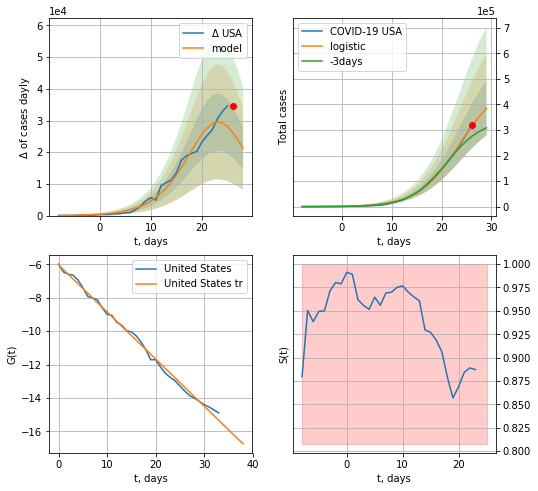

USA data at: 2020-07-01
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +3 days
	 deltaDaycases:  21241
	 total cases:  384598 ± 106176
	 total death:  18095 ± 14986
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


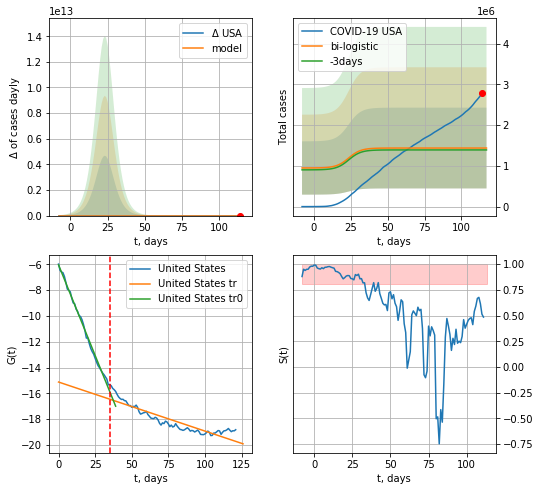

USA data at: 2020-07-01
+3 day model MAPE: 0.0333088526042849
model: bi-logistic
coeffs:  [ 7.58452141e+05 -9.77057682e+00  2.44120910e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6893971119412642
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1437090 ± 990726
	 total death:  67615 ± 139840
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.824682
 intercept: -15.122554
 slope: -0.037965


In [129]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

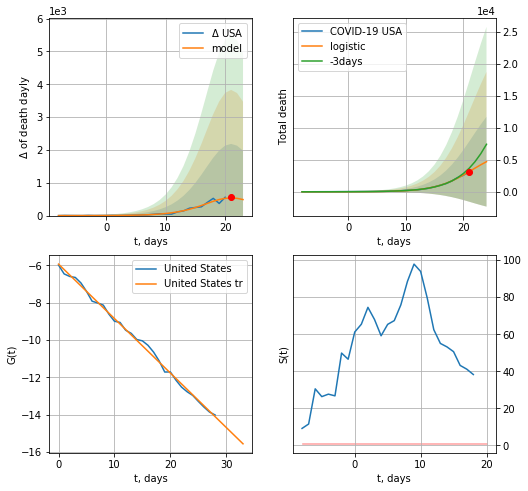

USA data at: 2020-07-01
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +3 days
	 total death:  4706 ± 7026
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


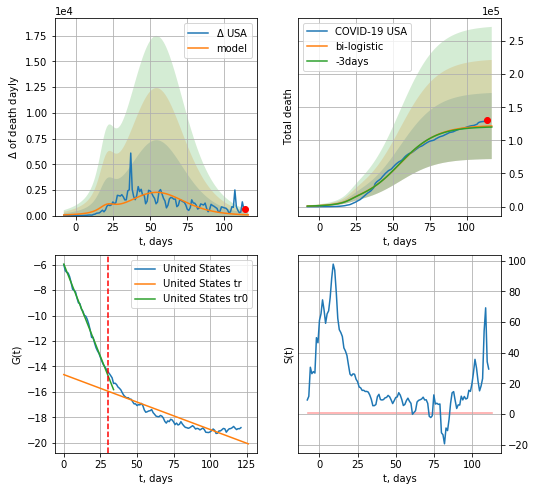

USA data at: 2020-07-01
+3 day model MAPE: 0.01278062741767074
model: bi-logistic
coeffs:  [1.15670554e+05 7.83162206e-02 5.48038226e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.41003801589733047
forecast at the end of period: +3 days
	 deltaDaydeath:  71
	 total death:  121624 ± 49870
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.818522
 intercept: -14.641705
 slope: -0.043213


In [130]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*14-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


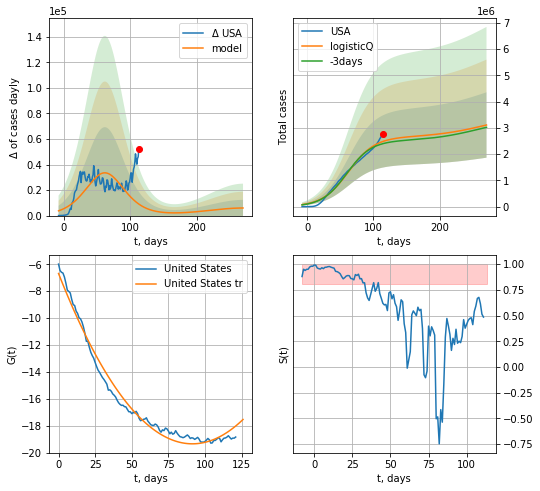

USA data at: 2020-07-01
+3 day model MAPE: 0.035575
model: logisticQ
coeffs: [ 2.63847998e+06  1.76144298e-07  6.21369698e+01 -2.87408369e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.400684
forecast at the end of period: +157 days
	 deltaDaycases: 5954
	 total cases: 3106660 ± 1244787
	 total death: 146169 ± 175702
trend coefficient of determination: 0.982224
 intercept_: -6.68853856714421
 coeffs_: [ 0.         -0.27629749  0.00151097]


In [131]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


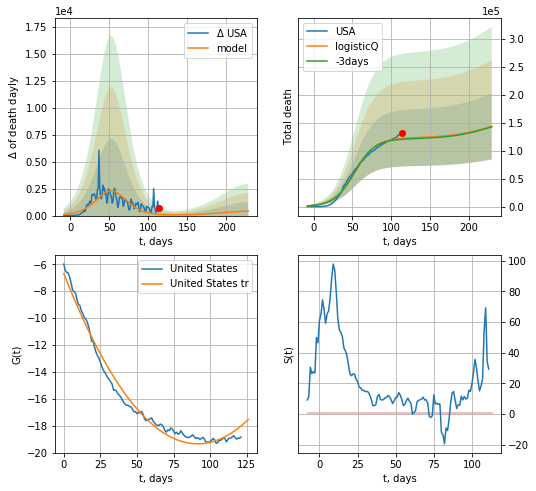

USA data at: 2020-07-01
+3 day model MAPE: 0.012511
model: logisticQ
coeffs: [ 1.22670312e+05  2.30685034e-07  5.30319700e+01 -3.24555425e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412639
forecast at the end of period: +115 days
	 total death: 143516 ± 59220
trend coefficient of determination: 0.982224
 intercept_: -6.68853856714421
 coeffs_: [ 0.         -0.27629749  0.00151097]


In [132]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


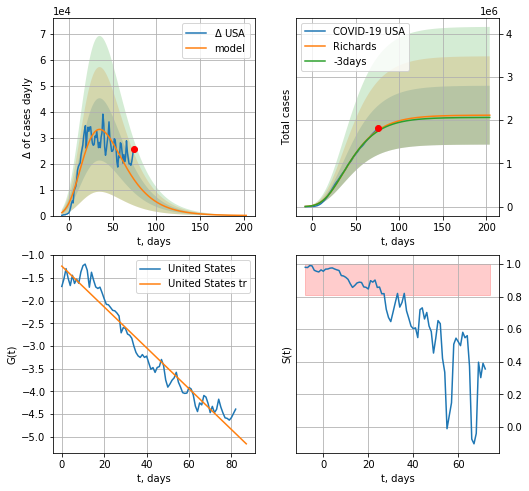

USA data at: 2020-07-01
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +129 days
	 deltaDaycases: 68
	 total cases: 2113911 ± 680409
	 total death: 99460 ± 96040
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


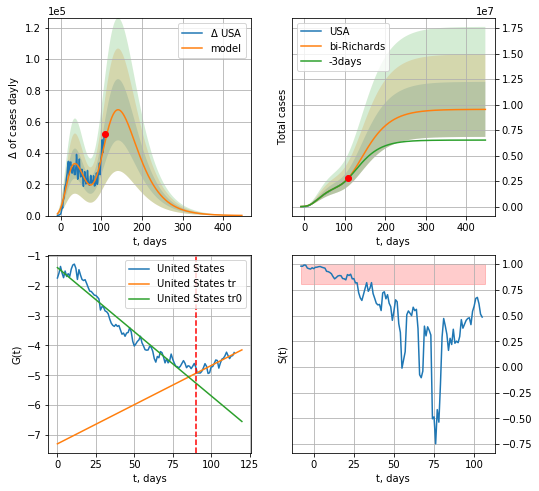

USA data at: 2020-07-01
+3 day model MAPE: 0.011919
model: bi-Richards
coeffs: [ 7.42470860e+06  1.40787842e+00 -2.17379813e+01  1.74761602e-02]
rational stdev: 0.282884
forecast at the end of period: +339 days
	 deltaDaycases: 103
	 total cases: 9536016 ± 2697589
	 total death: 448673 ± 380767
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944860
 intercept: -1.392117
 slope: -0.042943
trend coefficient of determination: 0.764373
 intercept: -7.293355
 slope: 0.026215


In [134]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


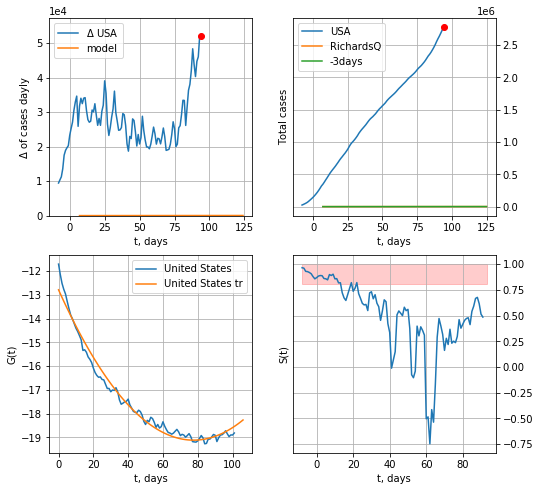

USA data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.52188019e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +31 days
	 deltaDaycases: 30


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [135]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
122 2020-06-27  310250       0  43514.0
123 2020-06-28  311151       0  43550.0
124 2020-06-29  311965       0  43575.0
125 2020-06-30  312654       0  43730.0
126 2020-07-01  313483       0  43906.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


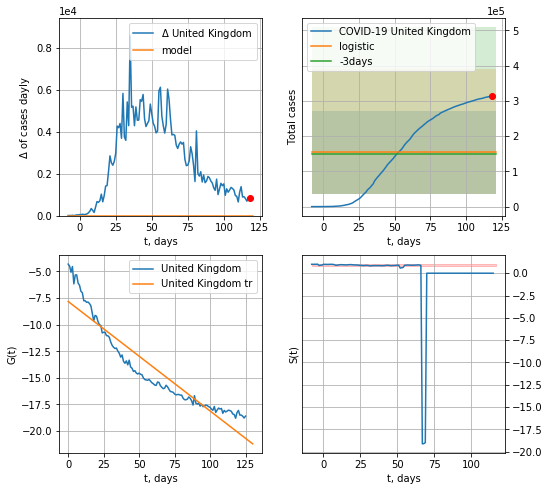

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.025545017251186075
model: logistic
coeffs:  [ 1.54073086e+05 -8.99107356e+00  2.33083973e+02]
rational stdev:  0.7696216014385825
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  154073 ± 118577
	 total death:  21579 ± 49822
trend coefficient of determination: 0.881355
 intercept: -7.825409
 slope: -0.102826


In [136]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*14-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


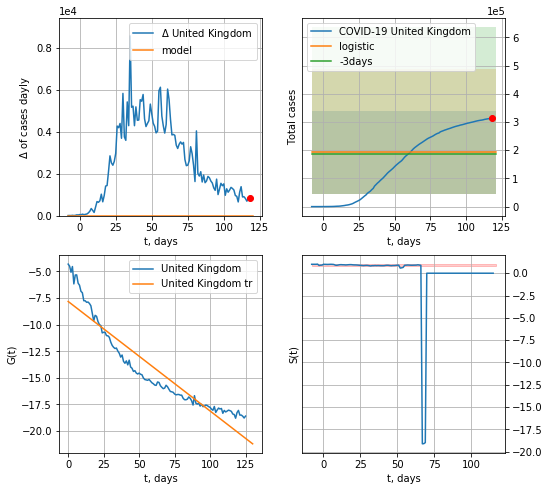

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.025545017251186155
model: logistic
coeffs:  [ 1.54073086e+05 -8.99107356e+00  2.33083973e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7696216014385825
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  192591 ± 148222
	 total death:  26974 ± 62279
trend coefficient of determination: 0.881355
 intercept: -7.825409
 slope: -0.102826


In [137]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


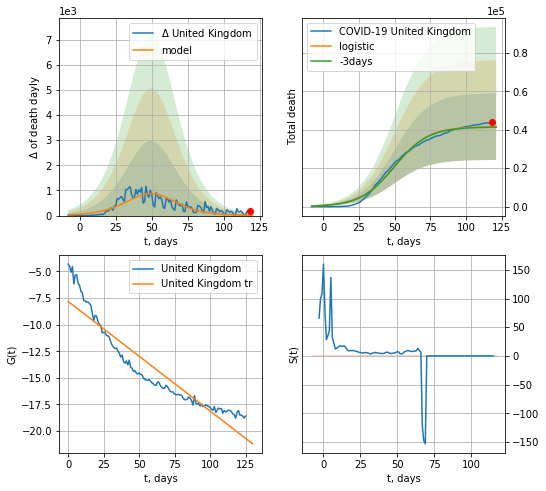

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.006759357594440697
model: logistic
coeffs:  [4.16774840e+04 8.39599145e-02 4.99915452e+01]
rational stdev:  0.4161502850736172
forecast at the end of period: +3 days
	 total death:  41570 ± 17299
trend coefficient of determination: 0.881355
 intercept: -7.825409
 slope: -0.102826


In [138]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


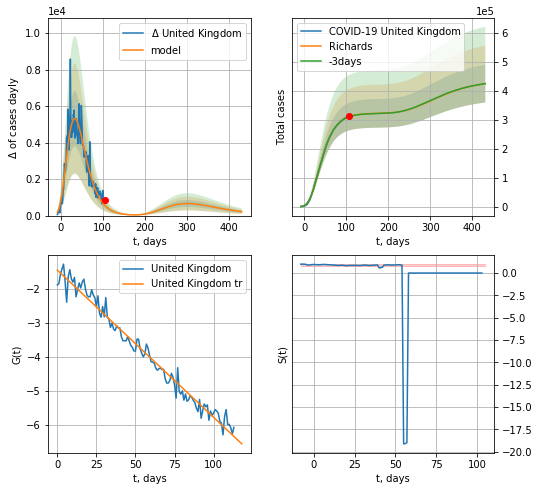

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.001934
model: Richards
coeffs: [ 3.22188811e+05  4.09252173e+00 -6.60233251e+01  1.10300949e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.153514
forecast at the end of period: +325 days
	 deltaDaycases: 213
	 total cases: 424201 ± 65120
	 total death: 59413 ± 27362
trend coefficient of determination: 0.976156
 intercept: -1.455642
 slope: -0.043226


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


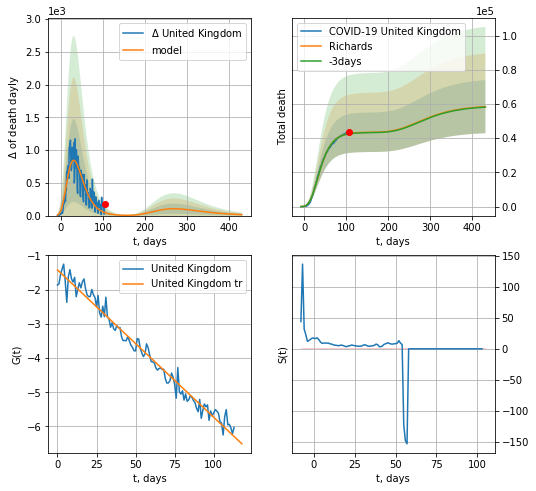

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.003948
model: Richards
coeffs: [ 4.35216633e+04  7.00881769e+00 -6.12832805e+01  7.54441774e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.265772
forecast at the end of period: +325 days
	 total death: 58470 ± 15539
trend coefficient of determination: 0.976051
 intercept: -1.424645
 slope: -0.043073


In [139]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


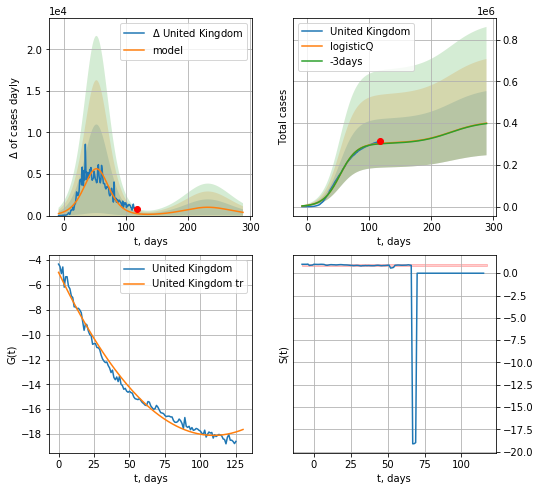

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.005858
model: logisticQ
coeffs: [ 3.03593024e+05  2.85152046e-07  5.32295246e+01 -2.60033031e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384526
forecast at the end of period: +171 days
	 deltaDaycases: 387
	 total cases: 399658 ± 153679
	 total death: 55975 ± 64571
trend coefficient of determination: 0.988236
 intercept_: -4.982209046403263
 coeffs_: [ 0.         -0.24040362  0.00110063]


In [140]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


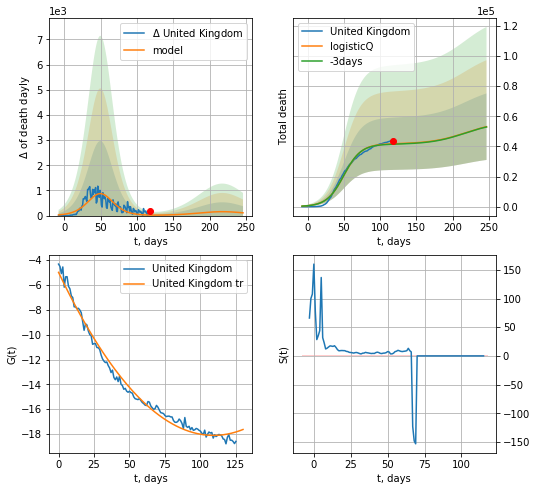

United Kingdom data at: 2020-07-01
+3 day model MAPE: 0.006836
model: logisticQ
coeffs: [ 4.16770278e+04  2.34750810e-07  4.99923037e+01 -3.57502559e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.416177
forecast at the end of period: +129 days
	 total death: 53096 ± 22097
trend coefficient of determination: 0.988236
 intercept_: -4.982209046403263
 coeffs_: [ 0.         -0.24040362  0.00110063]


In [141]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [125]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [126]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [127]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [128]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [129]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [142]:
dT

95

DK
           date    cases  active  death
121 2020-06-27  12675.3     563  604.0
122 2020-06-28  12675.6     563  604.0
123 2020-06-29  12751.0     534  605.0
124 2020-06-30  12768.0     514  605.0
125 2020-07-01  12794.0     495  606.0


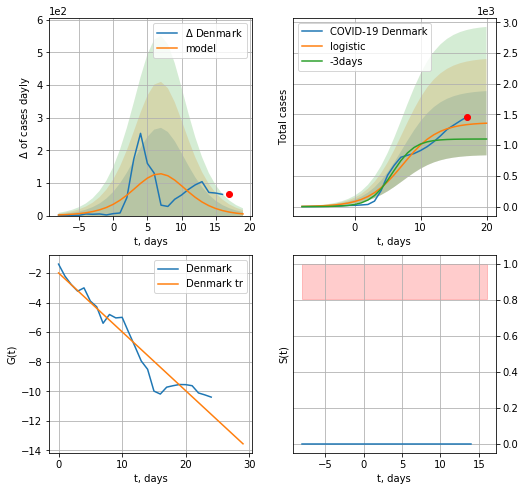

Denmark data at: 2020-07-01
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  1358 ± 522
	 total death:  64 ± 73
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


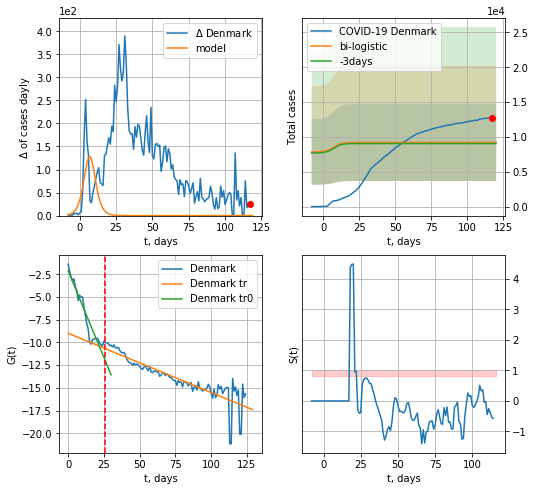

Denmark data at: 2020-07-01
+3 day model MAPE: 0.017258388912055837
model: bi-logistic
coeffs:  [6274.61082734  -14.53536158  126.06833603] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.600246781071037
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9212 ± 5530
	 total death:  436 ± 785
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.756101
 intercept: -8.992667
 slope: -0.065159


In [143]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*14-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,14*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


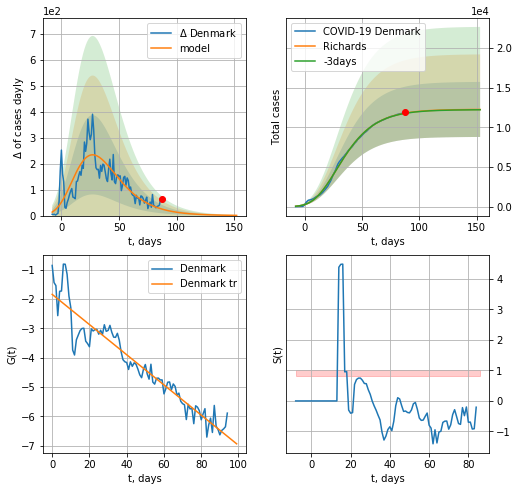

Denmark data at: 2020-07-01
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +66 days
	 deltaDaycases: 0
	 total cases: 12251 ± 3468
	 total death: 580 ± 492
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


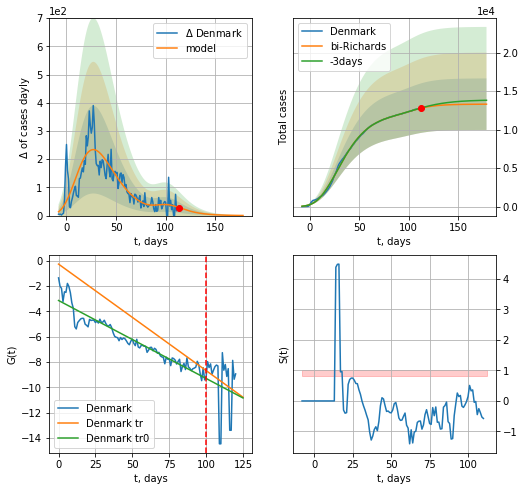

Denmark data at: 2020-07-01
+3 day model MAPE: 0.002612
model: bi-Richards
coeffs: [1.05092295e+03 2.77199221e-01 8.88071289e+01 2.90694364e-01]
rational stdev: 0.251435
forecast at the end of period: +66 days
	 deltaDaycases: 0
	 total cases: 13310 ± 3346
	 total death: 630 ± 475
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.911490
 intercept: -3.149118
 slope: -0.061582
trend coefficient of determination: 0.053523
 intercept: -0.276181
 slope: -0.084085


In [144]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


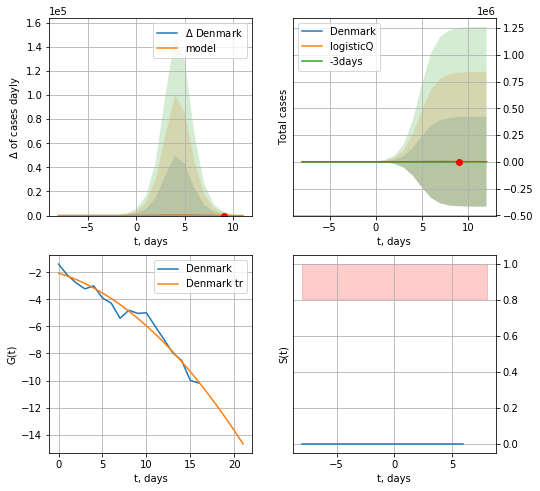

Denmark data at: 2020-07-01
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 862 ± 420141
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


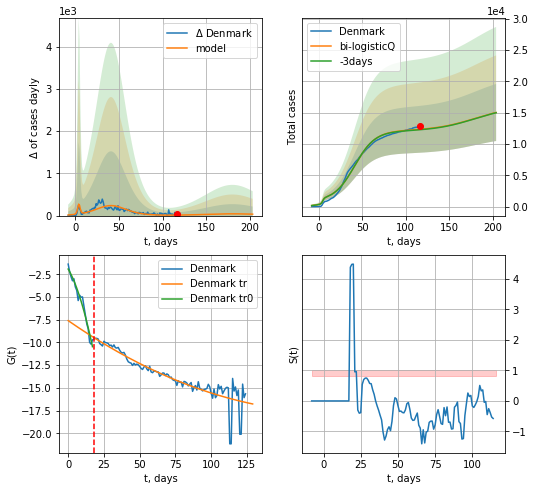

Denmark data at: 2020-07-01
+3 day model MAPE: 0.005589
model: bi-logisticQ
coeffs: [ 1.12494081e+04  1.89186454e-07  4.13775264e+01 -4.44927659e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303001
forecast at the end of period: +87 days
	 deltaDaycases: 33
	 total cases: 15025 ± 4552
	 total death: 711 ± 646
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.815294
 intercept_: -7.603473377841269
 coeffs_: [ 0.         -0.10908646  0.00029502]


In [145]:
x = forecastRRR('Denmark',dfDK[:18],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
122 2020-06-27  8846.0     459  249.0
123 2020-06-28  8855.0     468  249.0
124 2020-06-29  8862.0     475  249.0
125 2020-06-30  8879.0     491  250.0
126 2020-07-01  8896.0     507  251.0


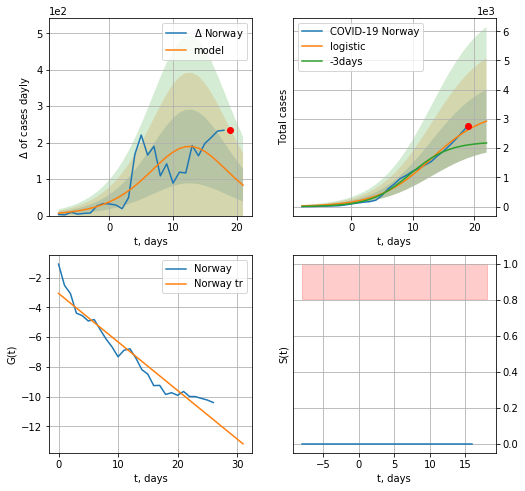

Norway data at: 2020-07-01
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +3 days
	 deltaDaycases:  83
	 total cases:  2925 ± 1074
	 total death:  82 ± 90
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


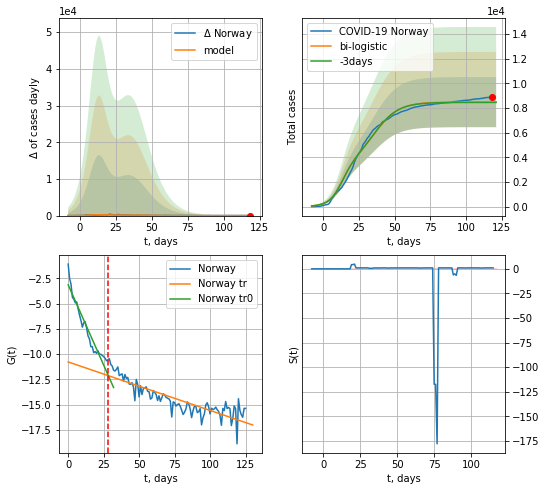

Norway data at: 2020-07-01
+3 day model MAPE: 0.0032465982656133866
model: bi-logistic
coeffs:  [5.18440407e+03 1.15331459e-01 3.54580449e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23977514689156187
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  8482 ± 2033
	 total death:  239 ± 171
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.738057
 intercept: -10.765178
 slope: -0.047911


In [146]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

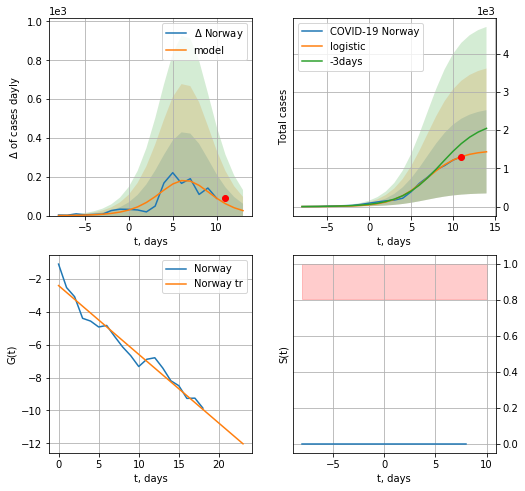

Norway data at: 2020-07-01
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +3 days
	 deltaDaycases:  25
	 total cases:  1432 ± 1088
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


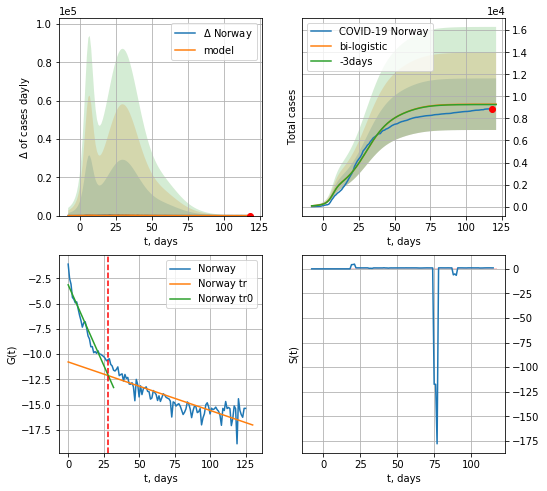

Norway data at: 2020-07-01
+3 day model MAPE: 0.0033596990767594923
model: bi-logistic
coeffs:  [6.94537535e+03 1.19794585e-01 3.00588992e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.25160012110641955
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9287 ± 2336
	 total death:  262 ± 197
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.738057
 intercept: -10.765178
 slope: -0.047911


In [147]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


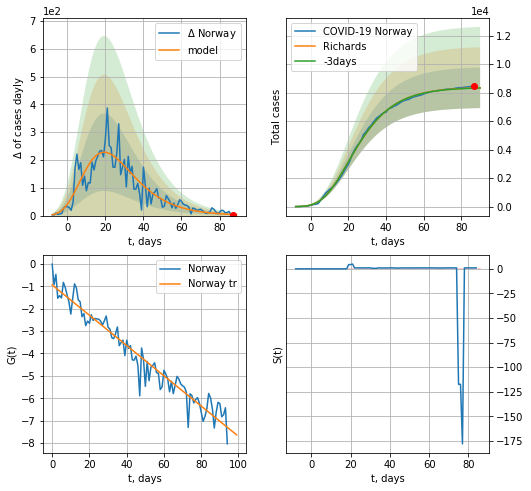

Norway data at: 2020-07-01
+3 day model MAPE: 0.001826
model: Richards
coeffs: [ 8.38632888e+03  7.27892835e+00 -4.19155218e+01  1.02039579e-02]
rational stdev: 0.170759
forecast at the end of period: +3 days
	 deltaDaycases: 3
	 total cases: 8340 ± 1424
	 total death: 235 ± 120
trend coefficient of determination: 0.940553
 intercept: -0.942750
 slope: -0.067601


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


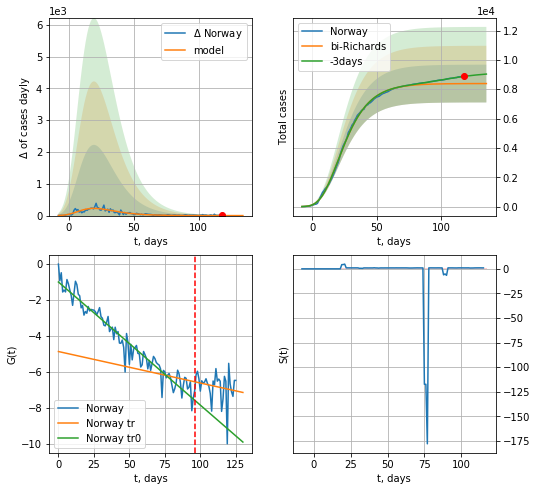

Norway data at: 2020-07-01
+3 day model MAPE: 0.057108
model: bi-Richards
coeffs: [ 6.56461660e+02  2.30199079e-02 -5.60474380e+00  2.34933460e-02]
rational stdev: 0.153472
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 8384 ± 1286
	 total death: 236 ± 108
bi-Richards approximation splitting point: 96
trend coefficient of determination: 0.942440
 intercept: -1.016933
 slope: -0.068253
trend coefficient of determination: 0.033452
 intercept: -4.871451
 slope: -0.017452


In [148]:
vL = 96
x = forecastRR('Norway',dfNG[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


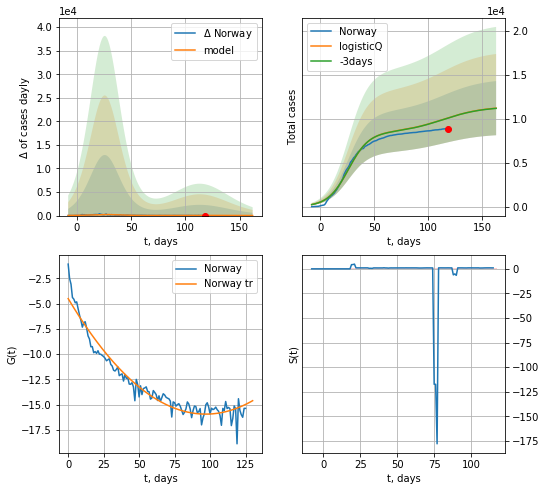

Norway data at: 2020-07-01
+3 day model MAPE: 0.001270
model: logisticQ
coeffs: [ 8.43550638e+03  2.61089610e-07  2.61013855e+01 -4.02059808e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275070
forecast at the end of period: +45 days
	 deltaDaycases: 10
	 total cases: 11216 ± 3085
	 total death: 316 ± 260
trend coefficient of determination: 0.944605
 intercept_: -4.507374811331166
 coeffs_: [ 0.         -0.23547697  0.00121449]


In [149]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


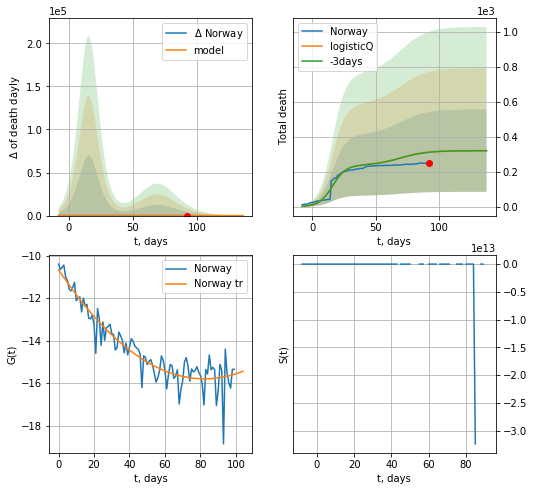

Norway data at: 2020-07-01
+3 day model MAPE: 0.002167
model: logisticQ
coeffs: [ 2.36738194e+02  1.58099575e-06  1.59523450e+01 -1.20884333e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.734600
forecast at the end of period: +45 days
	 total death: 320 ± 235
trend coefficient of determination: 0.868201
 intercept_: -10.665263925440964
 coeffs_: [ 0.         -0.12484304  0.00075917]


In [150]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
123 2020-06-27  65969       0  5280.0
124 2020-06-28  66812       0  5280.0
125 2020-06-29  67667       0  5310.0
126 2020-06-30  68451       0  5333.0
127 2020-07-01  69692       0  5370.0


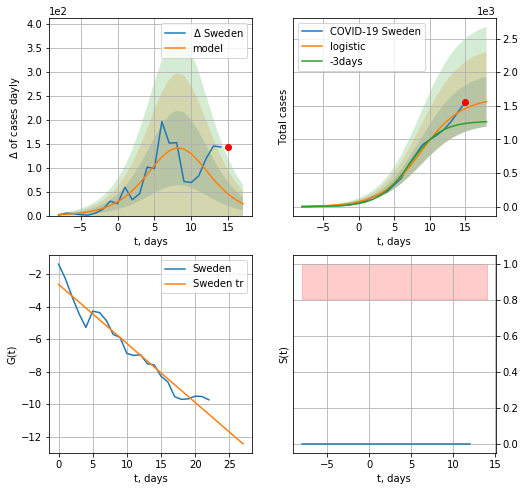

Sweden data at: 2020-07-01
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +3 days
	 deltaDaycases:  24
	 total cases:  1562 ± 370
	 total death:  120 ± 85
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


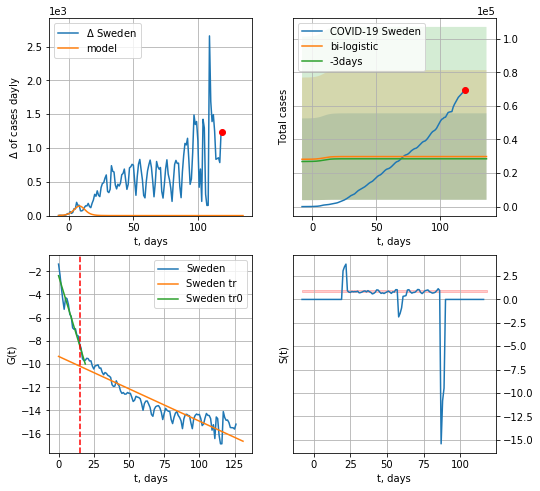

Sweden data at: 2020-07-01
+3 day model MAPE: 0.04675042080460351
model: bi-logistic
coeffs:  [ 2.25672116e+04 -9.09309685e+00  2.32378383e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8634312905694728
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  29832 ± 25758
	 total death:  2298 ± 5952
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.857601
 intercept: -9.339100
 slope: -0.055809


In [151]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[:-9-dT],d1,7*14-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date  cases  active   death
123 2020-06-27  65969       0  5280.0
124 2020-06-28  66812       0  5280.0
125 2020-06-29  67667       0  5310.0
126 2020-06-30  68451       0  5333.0
127 2020-07-01  69692       0  5370.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


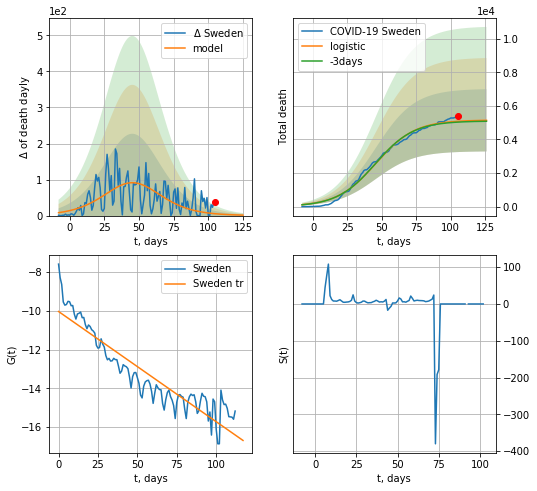

Sweden data at: 2020-07-01
+3 day model MAPE: 0.009835120588463352
model: logistic
coeffs:  [5.15941864e+03 7.08135388e-02 4.56630792e+01]
rational stdev:  0.3608190269813021
forecast at the end of period: +21 days
	 total death:  5142 ± 1855
trend coefficient of determination: 0.853995
 intercept: -10.031726
 slope: -0.056991


In [152]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


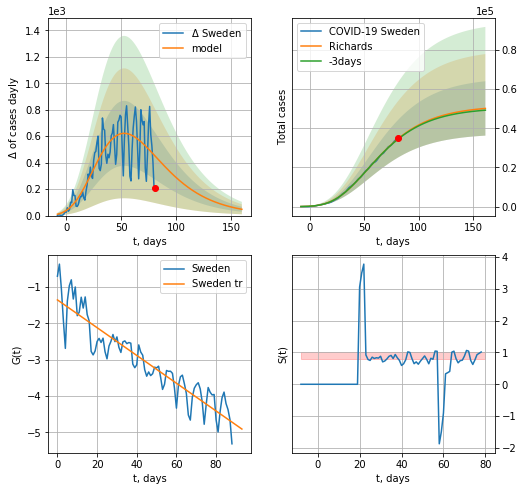

Sweden data at: 2020-07-01
+3 day model MAPE: 0.006125
model: Richards
coeffs: [ 5.15411678e+04  1.71360194e+00 -6.59040825e+01  1.93271263e-02]
rational stdev: 0.276754
forecast at the end of period: +80 days
	 deltaDaycases: 47
	 total cases: 50108 ± 13867
	 total death: 3861 ± 3205
trend coefficient of determination: 0.852284
 intercept: -1.357303
 slope: -0.038160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


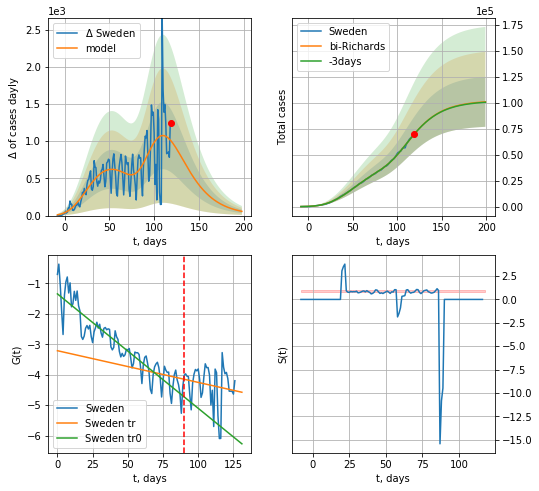

Sweden data at: 2020-07-01
+3 day model MAPE: 0.000889
model: bi-Richards
coeffs: [5.05783546e+04 3.06682236e+00 2.39517430e+01 1.52552112e-02]
rational stdev: 0.238366
forecast at the end of period: +80 days
	 deltaDaycases: 57
	 total cases: 100796 ± 24026
	 total death: 7766 ± 5553
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.852955
 intercept: -1.344255
 slope: -0.037616
trend coefficient of determination: 0.029263
 intercept: -3.211948
 slope: -0.010420


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


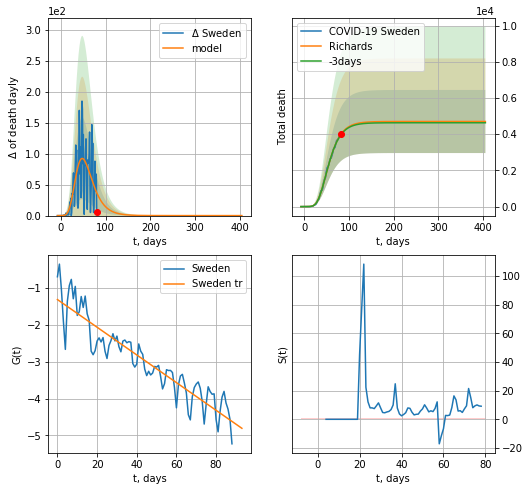

Sweden data at: 2020-07-01
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +325 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849510
 intercept: -1.318621
 slope: -0.037513


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


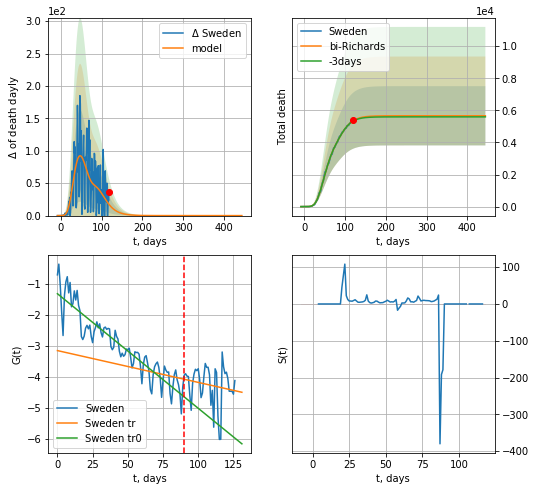

Sweden data at: 2020-07-01
+3 day model MAPE: 0.004076
model: bi-Richards
coeffs: [9.59891287e+02 7.53614621e+00 1.41392886e+01 7.82029735e-03]
rational stdev: 0.326126
forecast at the end of period: +325 days
	 total death: 5661 ± 1846
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850420
 intercept: -1.308495
 slope: -0.037029
trend coefficient of determination: 0.028510
 intercept: -3.146344
 slope: -0.010282


In [153]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


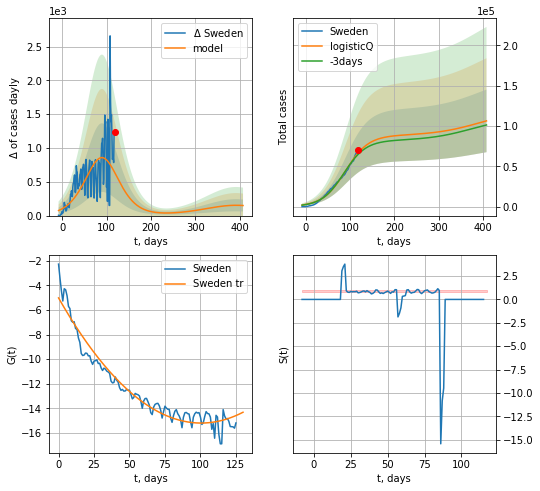

Sweden data at: 2020-07-01
+3 day model MAPE: 0.027260
model: logisticQ
coeffs: [ 8.81754704e+04  2.27126973e-07  8.98678472e+01 -1.70888782e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365417
forecast at the end of period: +290 days
	 deltaDaycases: 148
	 total cases: 106254 ± 38827
	 total death: 8187 ± 8974
trend coefficient of determination: 0.945899
 intercept_: -5.027398760997476
 coeffs_: [ 0.         -0.20226396  0.00100655]


In [154]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


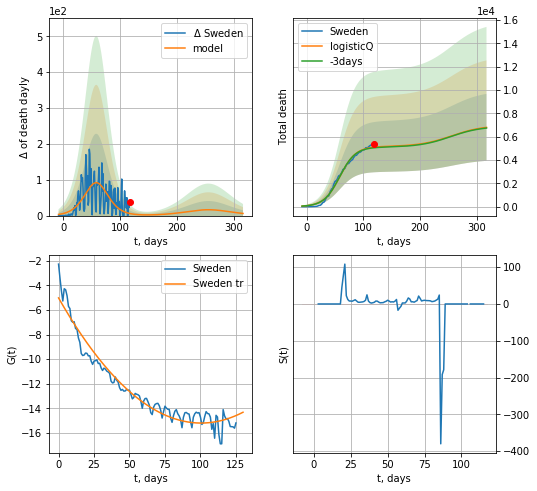

Sweden data at: 2020-07-01
+3 day model MAPE: 0.009925
model: logisticQ
coeffs: [ 5.15258684e+03  2.63488881e-07  5.86177293e+01 -2.70205117e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422621
forecast at the end of period: +199 days
	 total death: 6796 ± 2872
trend coefficient of determination: 0.945899
 intercept_: -5.027398760997476
 coeffs_: [ 0.         -0.20226396  0.00100655]


In [155]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
157 2020-06-27  83500.0     415  4634.0
158 2020-06-28  83512.0     418  4634.0
159 2020-06-29  83531.0     428  4634.0
160 2020-06-30  83534.0     421  4634.0
161 2020-07-01  83537.0     416  4634.0


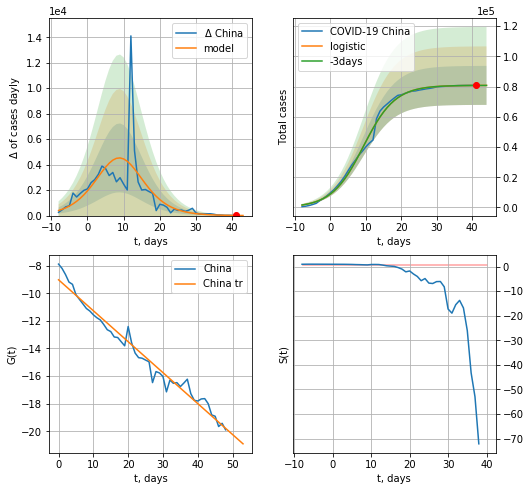

China data at: 2020-07-01
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  80776 ± 12901
	 total death:  4480 ± 2146
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


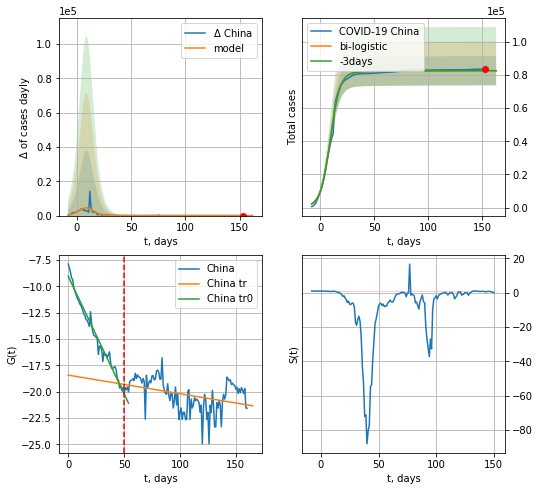

China data at: 2020-07-01
+3 day model MAPE: 2.4117266333330078e-05
model: bi-logistic
coeffs:  [1.74801874e+03 2.64917792e-02 1.23519411e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10669964301797984
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  82526 ± 8805
	 total death:  4577 ± 1465
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.142089
 intercept: -18.428781
 slope: -0.017668


In [156]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*14-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,15*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [157]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

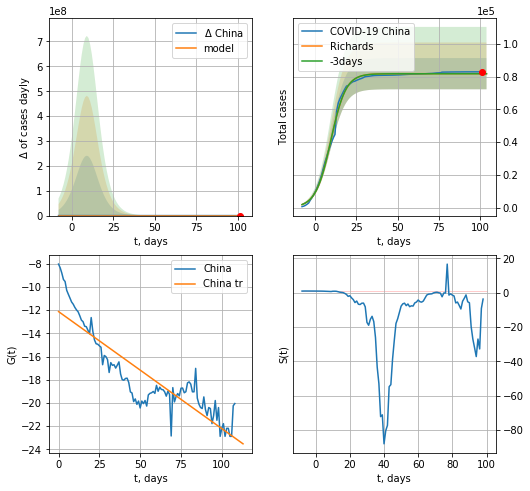

China data at: 2020-07-01
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4536 ± 1584
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


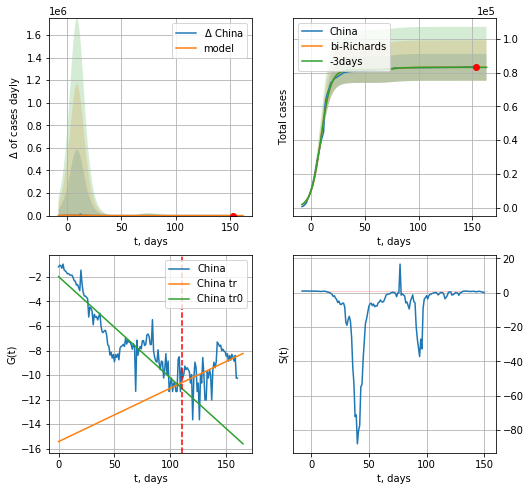

China data at: 2020-07-01
+3 day model MAPE: 0.000441
model: bi-Richards
coeffs: [1.36224836e+03 6.84942387e+01 1.98116529e+01 1.69286607e-03]
rational stdev: 0.096004
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 83135 ± 7981
	 total death: 4611 ± 1328
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821006
 intercept: -1.970415
 slope: -0.082662
trend coefficient of determination: 0.208442
 intercept: -15.429125
 slope: 0.043587


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [158]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,14*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,15*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

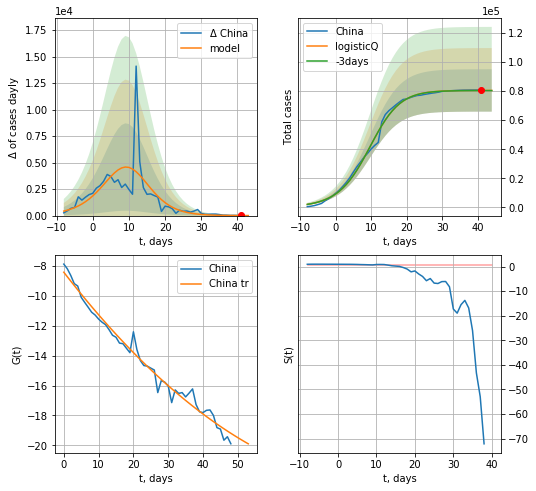

China data at: 2020-07-01
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +3 days
	 deltaDaycases: 2
	 total cases: 80409 ± 14555
	 total death: 4460 ± 2422
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


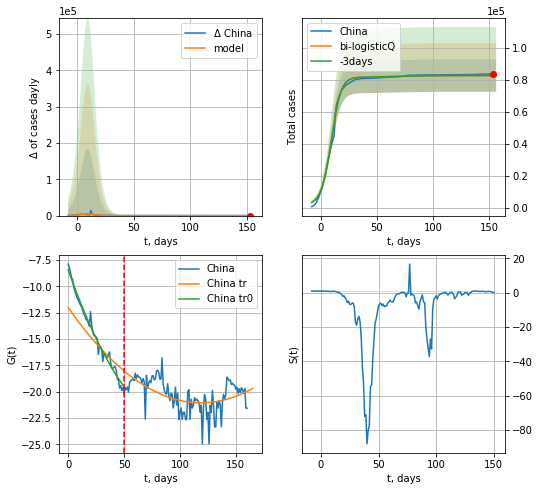

China data at: 2020-07-01
+3 day model MAPE: 0.000436
model: bi-logisticQ
coeffs: [ 2.15067327e+03  4.20830567e-04  2.47847563e+01 -4.03695037e-02]
rational stdev: 0.122789
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 82567 ± 10138
	 total death: 4580 ± 1687
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.296523
 intercept_: -12.005645809857498
 coeffs_: [ 0.         -0.15257751  0.00064243]


In [159]:
x = forecastRRR('China',dfCN[:50],d1,7*14-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,14*7-dT,x,1.0,vL=50)

In [160]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
133 2020-06-27  12715  1069.0  282.0
134 2020-06-28  12757  1046.0  282.0
135 2020-06-29  12800   981.0  282.0
136 2020-06-30  12850   955.0  282.0
137 2020-07-01  12904   938.0  282.0


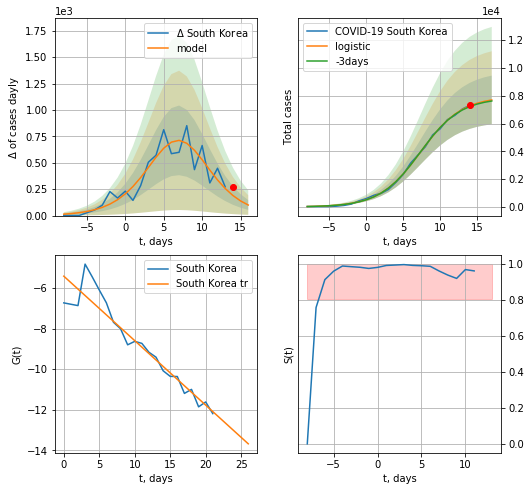

South Korea data at: 2020-07-01
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +3 days
	 deltaDaycases:  99
	 total cases:  7699 ± 1752
	 total death:  168 ± 114
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


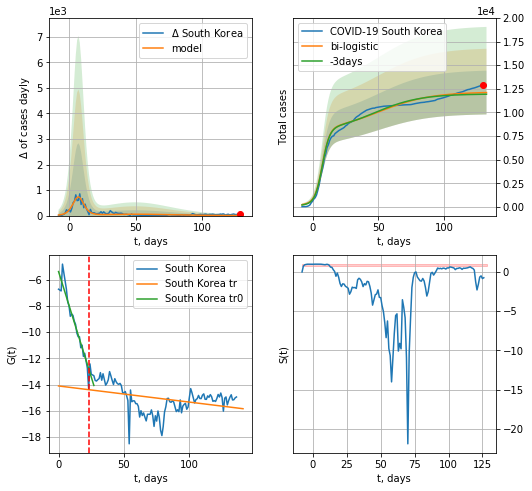

South Korea data at: 2020-07-01
+3 day model MAPE: 0.014389801856413186
model: bi-logistic
coeffs:  [4.22315332e+03 5.11701972e-02 5.00434996e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19144252041607224
forecast at the end of period: +3 days
	 deltaDaycases:  3
	 total cases:  12101 ± 2316
	 total death:  264 ± 151
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.140501
 intercept: -14.103471
 slope: -0.012285


In [161]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*14-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,14*7-dT,x,1.0,vL=23)

In [162]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

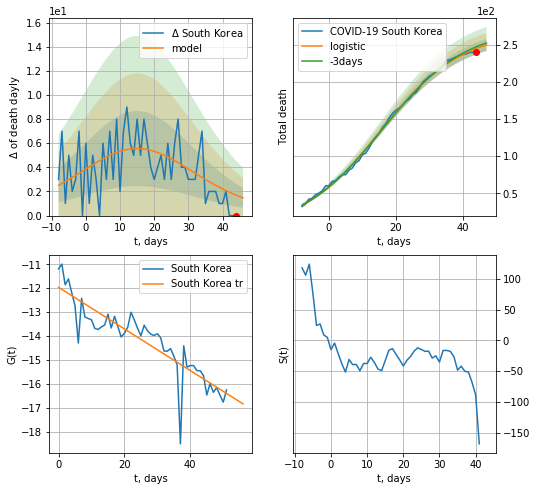

South Korea data at: 2020-07-01
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +3 days
	 total death:  250 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


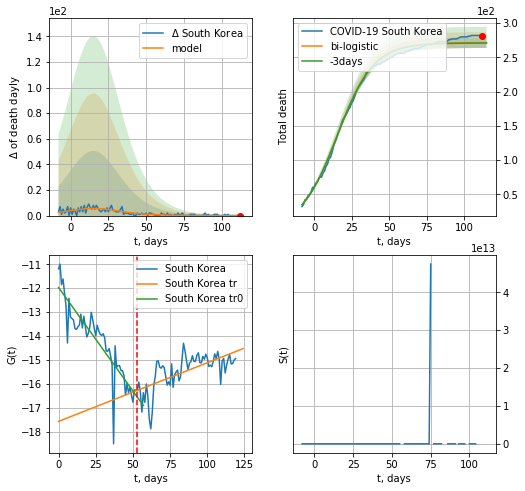

South Korea data at: 2020-07-01
+3 day model MAPE: 0.0017230597206978817
model: bi-logistic
coeffs:  [ 3.34220757  0.02361089 11.03545744] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.028297323697115354
forecast at the end of period: +3 days
	 deltaDaydeath:  0
	 total death:  271 ± 7
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.437960
 intercept: -17.570712
 slope: 0.024531


In [163]:
x = forecast('South Korea',dfKR[17:70],d1,14*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,14*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


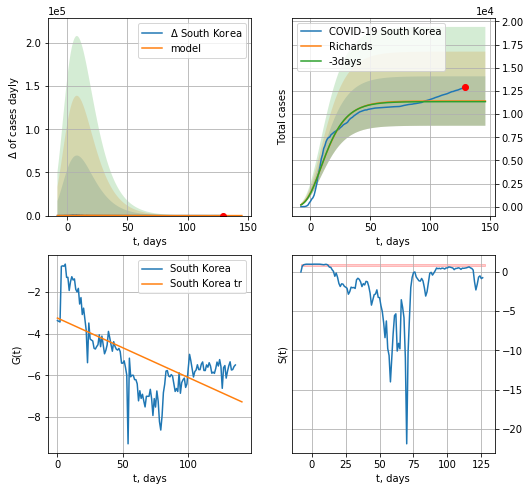

South Korea data at: 2020-07-01
+3 day model MAPE: 0.006048
model: Richards
coeffs: [ 1.14141382e+04  2.85674484e+01 -6.24152068e+01  2.88321064e-03]
rational stdev: 0.233392
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 11413 ± 2663
	 total death: 249 ± 174
trend coefficient of determination: 0.418113
 intercept: -3.255709
 slope: -0.028474


In [164]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


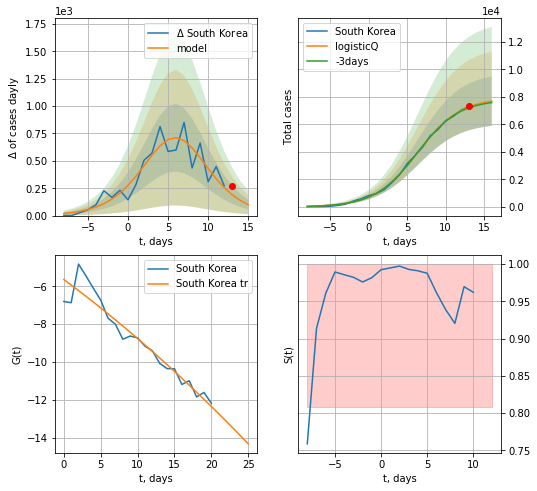

South Korea data at: 2020-07-01
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +3 days
	 deltaDaycases: 99
	 total cases: 7697 ± 1797
	 total death: 168 ± 117
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


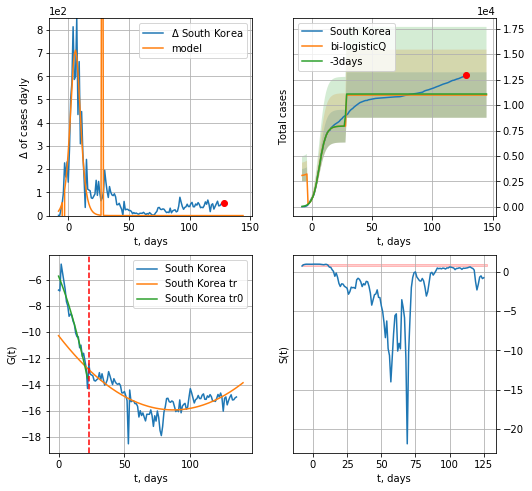

South Korea data at: 2020-07-01
+3 day model MAPE: 0.009196
model: bi-logisticQ
coeffs: [3046.55791009   11.9565365    28.73873159   -3.92714268]
rational stdev: 0.203025
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 10983 ± 2229
	 total death: 240 ± 146
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.564885
 intercept_: -10.272813697582428
 coeffs_: [ 0.         -0.1296584   0.00074316]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [165]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [166]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


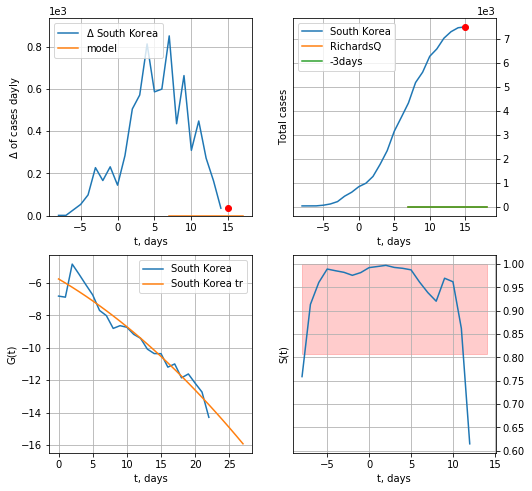

South Korea data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +3 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [167]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


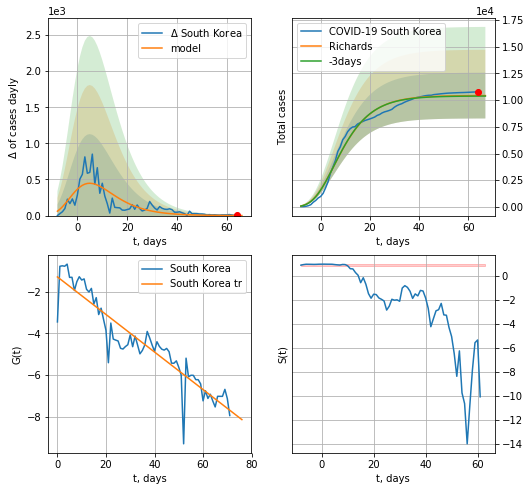

South Korea data at: 2020-07-01
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 10424 ± 2142
	 total death: 227 ± 139
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


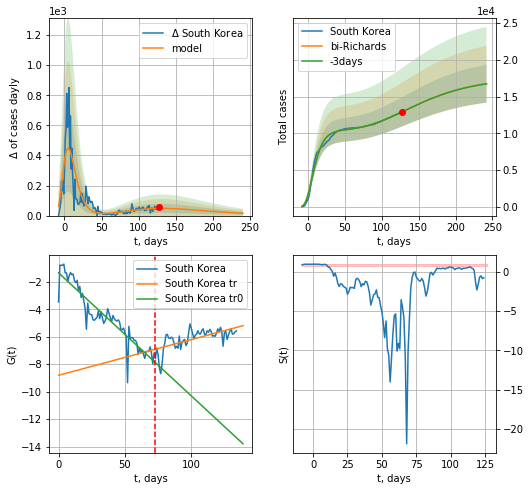

South Korea data at: 2020-07-01
+3 day model MAPE: 0.000071
model: bi-Richards
coeffs: [ 7.23841175e+03  1.78691666e+00 -1.22622907e+02  1.01191285e-02]
rational stdev: 0.153709
forecast at the end of period: +115 days
	 deltaDaycases: 15
	 total cases: 16754 ± 2575
	 total death: 366 ± 168
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865856
 intercept: -1.351353
 slope: -0.089545
trend coefficient of determination: 0.428408
 intercept: -8.809687
 slope: 0.026010


In [168]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,14*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [169]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


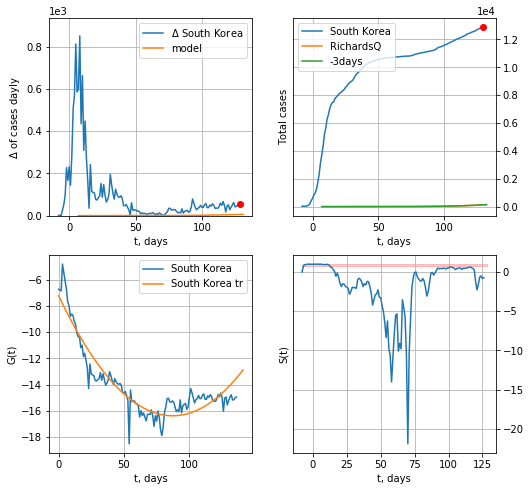

South Korea data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +3 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [170]:
x = forecastQR('South Korea',dfKR[:],d1,14*7-dT,1.0)

SG
           date    cases  active  death
156 2020-06-27  43459.0    6270   26.0
157 2020-06-28  43661.0    6127   26.0
158 2020-06-29  43907.0    5896   26.0
159 2020-06-30  44122.0    5596   26.0
160 2020-07-01  44122.0    5085   26.0


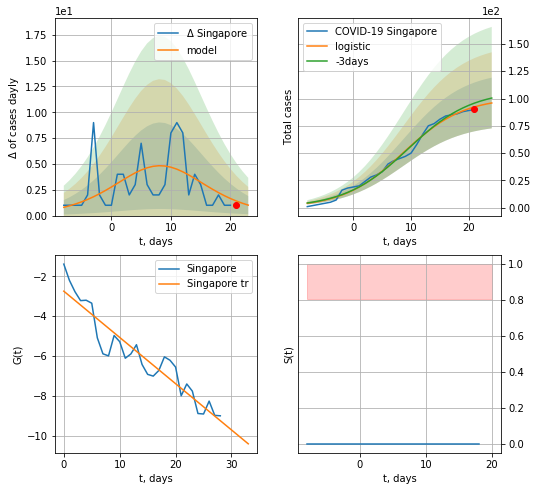

Singapore data at: 2020-07-01
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  95 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


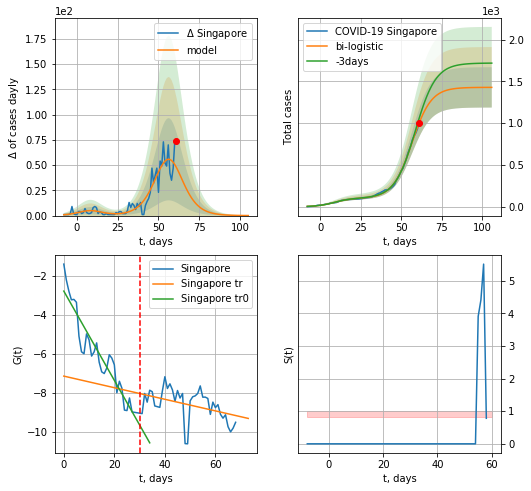

Singapore data at: 2020-07-01
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +45 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


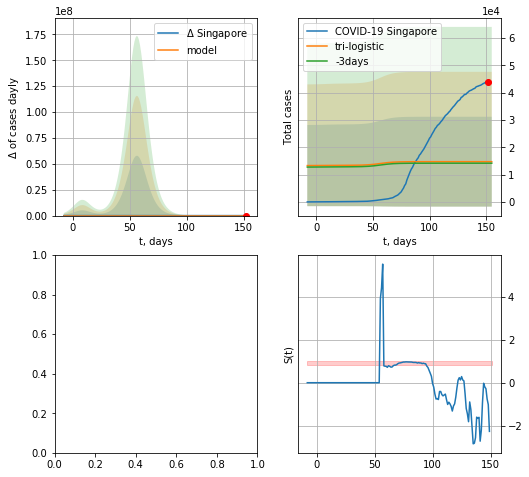

In [171]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*14-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


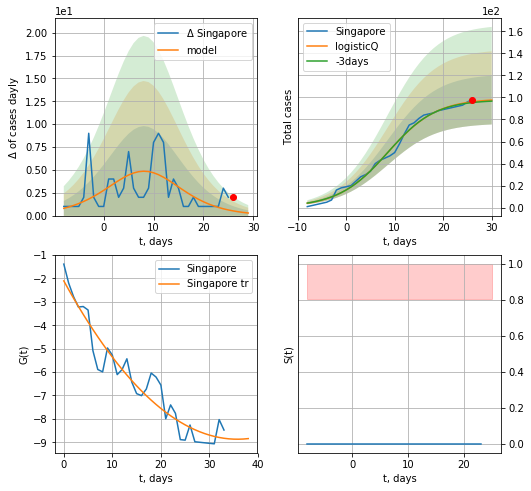

Singapore data at: 2020-06-30
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


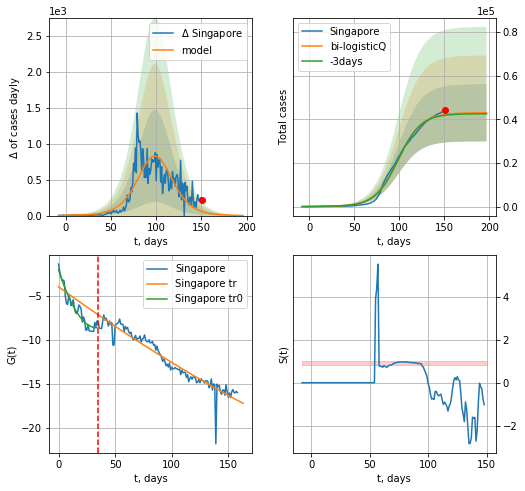

Singapore data at: 2020-06-30
+3 day model MAPE: 0.009377
model: bi-logisticQ
coeffs: [ 4.28734625e+04  3.14109173e-07  9.89887005e+01 -2.45974412e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.305214
forecast at the end of period: +46 days
	 deltaDaycases: 1
	 total cases: 42952 ± 13109
	 total death: 25 ± 22
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.917578
 intercept_: -3.9711000218444976
 coeffs_: [ 0.00000000e+00 -9.37241548e-02  7.54812779e-05]


In [57]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*14-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [58]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

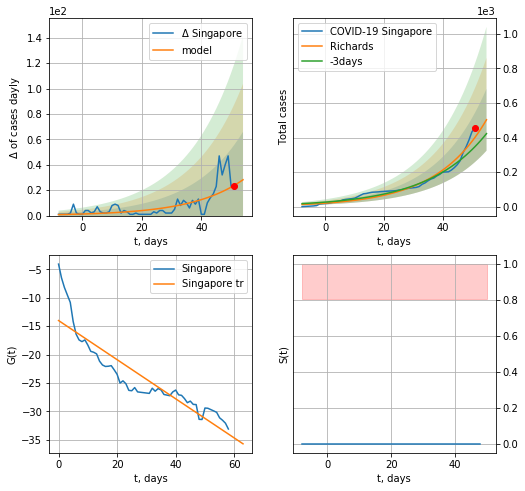

Singapore data at: 2020-06-30
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +4 days
	 deltaDaycases: 28
	 total cases: 502 ± 178
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


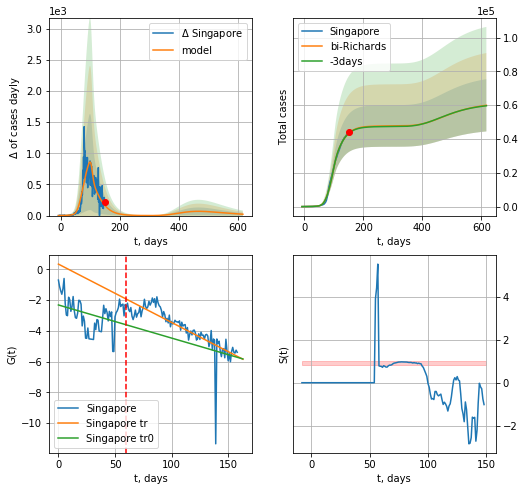

Singapore data at: 2020-06-30
+3 day model MAPE: 0.003891
model: bi-Richards
coeffs: [ 3.84411371e+04  5.94604303e+00 -3.17169229e+01  6.60201119e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.257938
forecast at the end of period: +466 days
	 deltaDaycases: 21
	 total cases: 59946 ± 15462
	 total death: 35 ± 27
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.124482
 intercept: -2.315949
 slope: -0.021532
trend coefficient of determination: 0.657618
 intercept: 0.340302
 slope: -0.037937


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


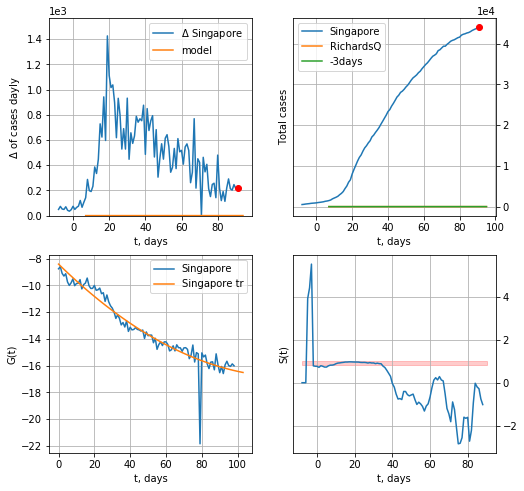

Singapore data at: 2020-06-30
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 9.75970661e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +4 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [59]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,14*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,14*7-dT,1.0)

ES
           date   cases  active  death
107 2020-06-27  1987.0     100   69.0
108 2020-06-28  1987.5     100   69.0
109 2020-06-29  1989.0      91   69.0
110 2020-06-30  1989.1      91   69.0
111 2020-07-01  1989.0      84   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


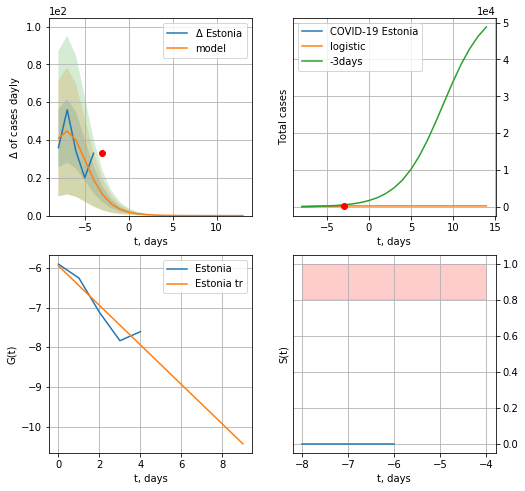

Estonia data at: 2020-07-01
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


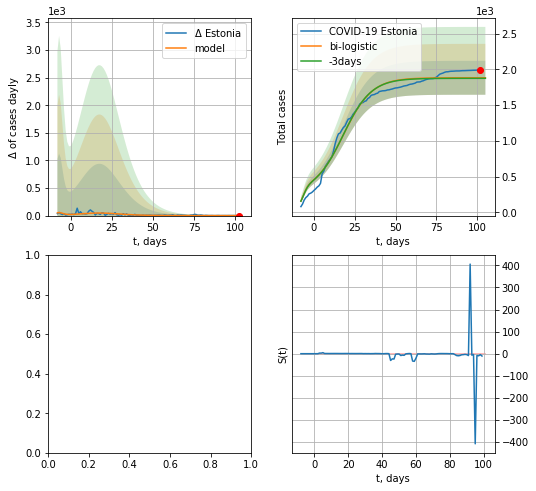

In [172]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,14*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

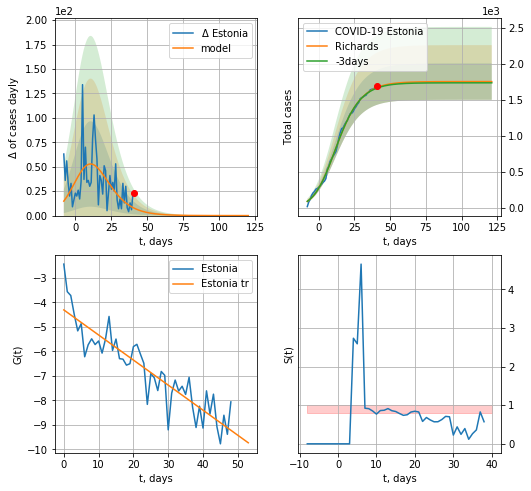

Estonia data at: 2020-07-01
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

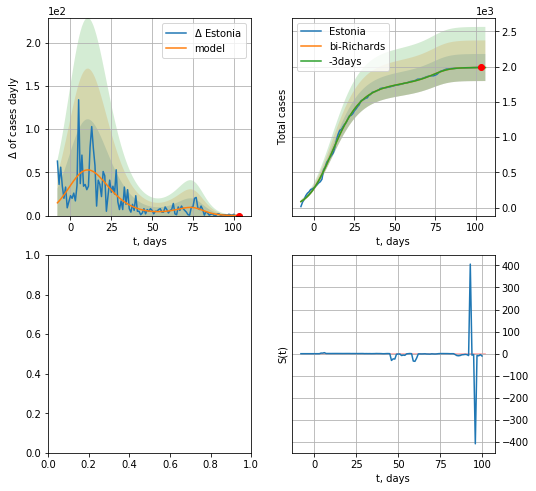

In [173]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*14-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


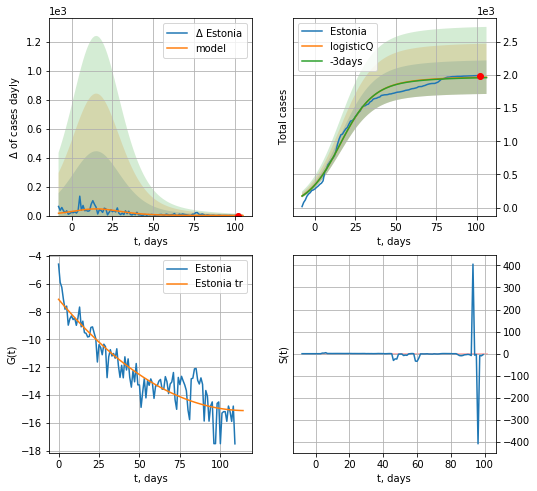

Estonia data at: 2020-06-30
+3 day model MAPE: 0.003588
model: logisticQ
coeffs: [ 1.89063076e+03  2.35847213e-07  1.55183171e+01 -4.11676374e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128484
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 1964 ± 252
	 total death: 68 ± 26
trend coefficient of determination: 0.843908
 intercept_: -7.121138639290527
 coeffs_: [ 0.         -0.13781018  0.00059439]


In [404]:
x = forecastRRR('Estonia',dfES[:],d1,7*14-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
112 2020-06-27  1115.0     153   30.0
113 2020-06-28  1116.0     154   30.0
114 2020-06-29  1117.0     155   30.0
115 2020-06-30  1118.0     114   30.0
116 2020-07-01  1121.0     117   30.0


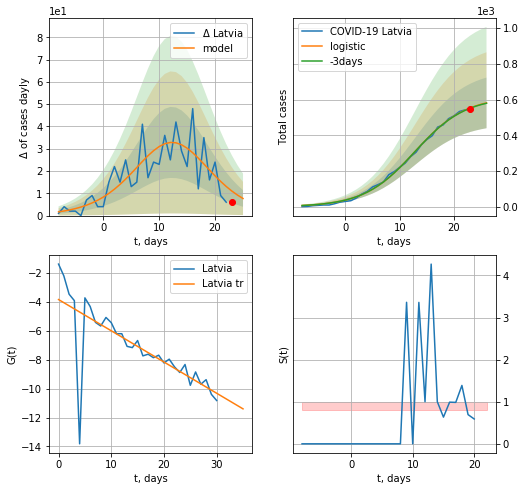

Latvia data at: 2020-07-01
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +3 days
	 deltaDaycases:  7
	 total cases:  581 ± 141
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


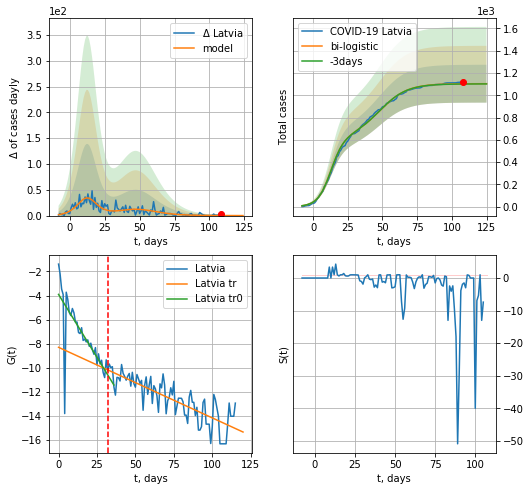

Latvia data at: 2020-07-01
+3 day model MAPE: 0.001853029279915608
model: bi-logistic
coeffs:  [4.88181658e+02 1.00273038e-01 4.78734589e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.15384069406098
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  1104 ± 169
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.659831
 intercept: -8.303872
 slope: -0.058705


In [175]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,14*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


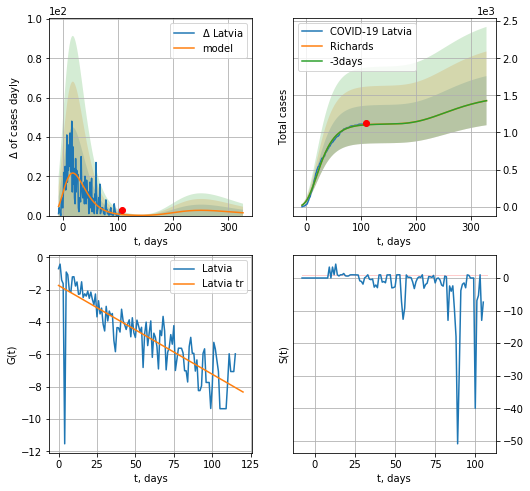

Latvia data at: 2020-07-01
+3 day model MAPE: 0.001472
model: Richards
coeffs: [ 1.11421541e+03  9.51851747e+00 -7.97153519e+01  5.56117143e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.231825
forecast at the end of period: +220 days
	 deltaDaycases: 1
	 total cases: 1428 ± 331
	 total death: 38 ± 26
trend coefficient of determination: 0.666636
 intercept: -1.736124
 slope: -0.054883


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


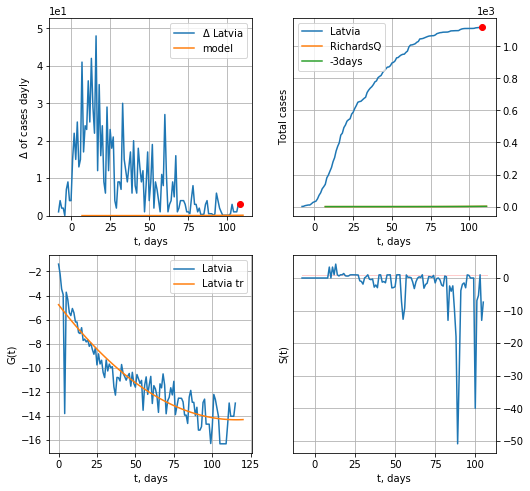

Latvia data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.14660905e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +3 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [176]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*14-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


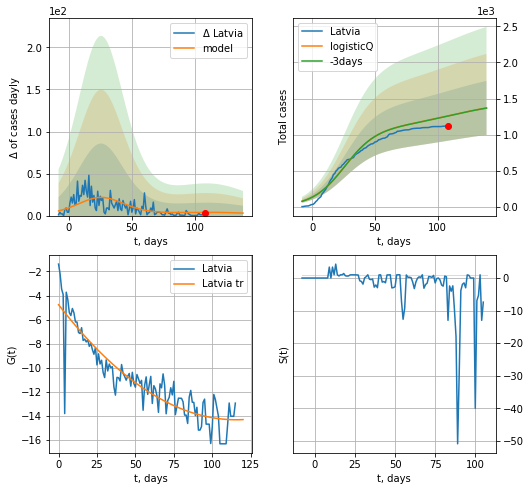

Latvia data at: 2020-07-01
+3 day model MAPE: 0.001432
model: logisticQ
coeffs: [ 1.08600146e+03  1.81536597e-07  2.58741461e+01 -4.30464506e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.273652
forecast at the end of period: +31 days
	 deltaDaycases: 2
	 total cases: 1369 ± 374
	 total death: 36 ± 29
trend coefficient of determination: 0.819969
 intercept_: -4.7602590755738
 coeffs_: [ 0.         -0.16558009  0.00071631]


In [177]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


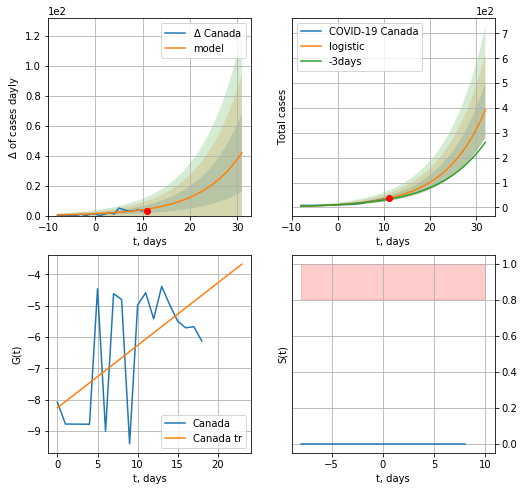

Canada data at: 2020-07-01
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


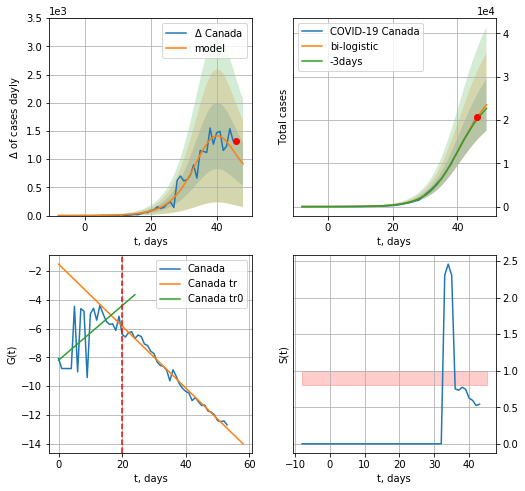

Canada data at: 2020-07-01
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +3 days
	 deltaDaycases:  918
	 total cases:  23518 ± 5995
	 total death:  1943 ± 1485
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


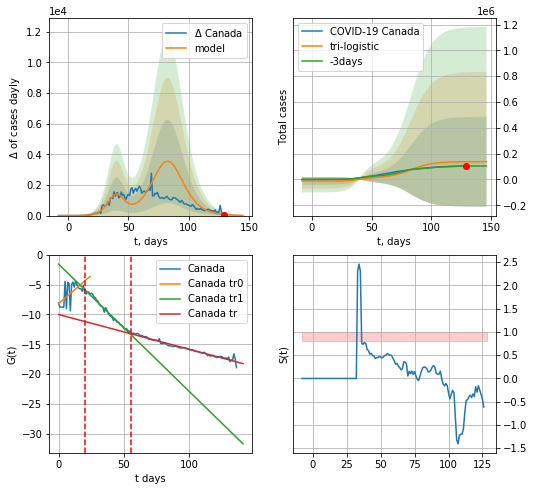

Canada data at: 2020-07-01
+3 day model MAPE: 0.32100024707407365
model: tri-logistic
coeffs:  [-1.17466975e+04  1.54449667e+00 -2.46530106e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  2.5310732212529583
forecast at the end of period: +17 days
	 deltaDaycases:  11
	 total cases:  137510 ± 348048
	 total death:  11361 ± 86266
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.969438
 intercept: -10.016099
 slope: -0.058330


In [178]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,14*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
133 2020-06-27  103032.0   28543  8516.0
134 2020-06-28  103250.0   28537  8522.0
135 2020-06-29  103918.0   28174  8566.0
136 2020-06-30  104204.0   28019  8591.0
137 2020-07-01  104271.0   27912  8615.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


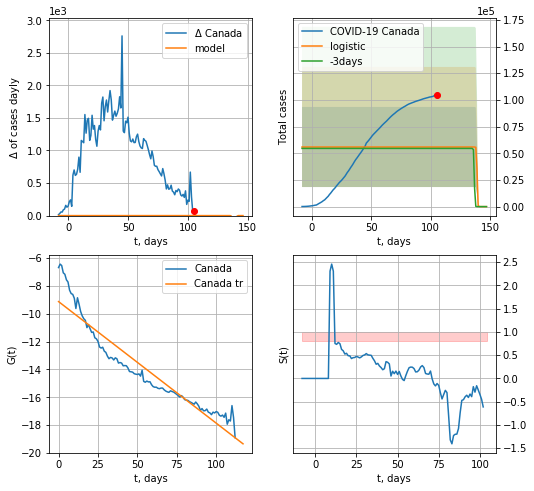

Canada data at: 2020-07-01
+3 day model MAPE: 0.023917030494818723
model: logistic
coeffs:  [ 5.58564912e+04 -4.65573144e+00  1.39124554e+02]
rational stdev:  0.6715828055509157
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.898898
 intercept: -9.135080
 slope: -0.087219


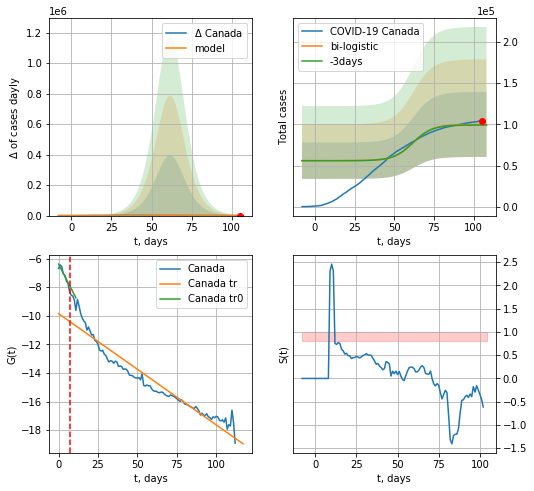

Canada data at: 2020-07-01
+3 day model MAPE: 0.007126276580688606
model: bi-logistic
coeffs:  [4.40071690e+04 1.62083533e-01 6.20056056e+01] [ 5.58564912e+04 -4.65573144e+00  1.39124554e+02]
rational stdev:  0.395439326046655
forecast at the end of period: +3 days
	 deltaDaycases:  4
	 total cases:  99838 ± 39479
	 total death:  8248 ± 9784
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.920705
 intercept: -9.853450
 slope: -0.077768


In [179]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

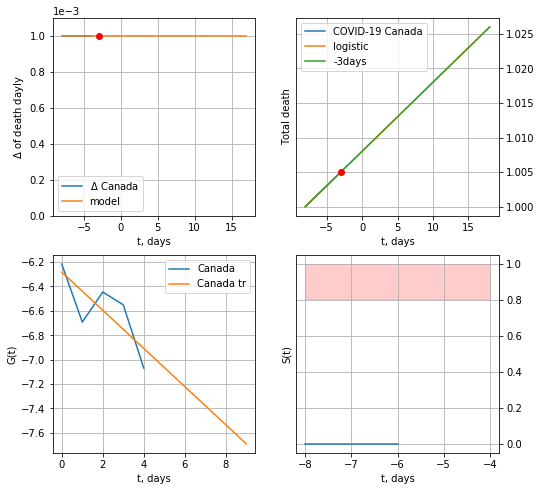

Canada data at: 2020-07-01
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


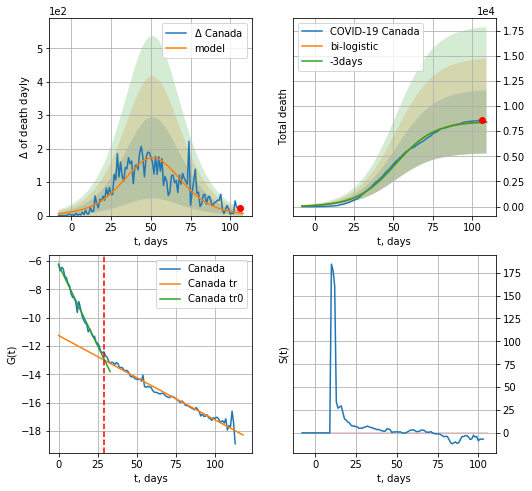

Canada data at: 2020-07-01
+3 day model MAPE: 0.004385622718307454
model: bi-logistic
coeffs:  [8.50881478e+03 8.11845884e-02 5.15058903e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3733223882053277
forecast at the end of period: +3 days
	 deltaDaydeath:  6
	 total death:  8430 ± 3147
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.970181
 intercept: -11.258300
 slope: -0.059491


In [180]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,14*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


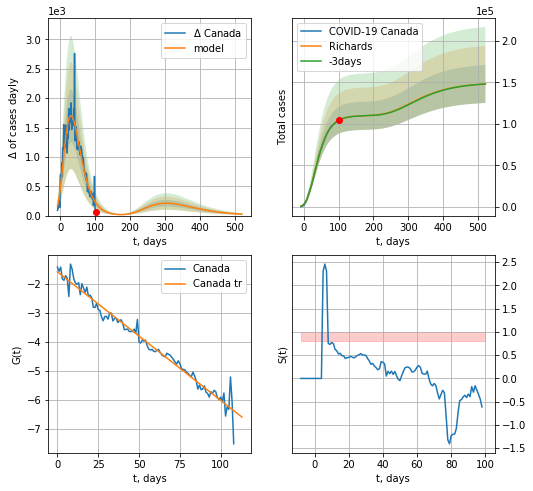

Canada data at: 2020-07-01
+3 day model MAPE: 0.000083
model: Richards
coeffs: [ 1.09816126e+05  2.83618868e+00 -6.79367976e+01  1.49518064e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.154776
forecast at the end of period: +420 days
	 deltaDaycases: 23
	 total cases: 147936 ± 22897
	 total death: 12222 ± 5675
trend coefficient of determination: 0.972498
 intercept: -1.593951
 slope: -0.044305


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


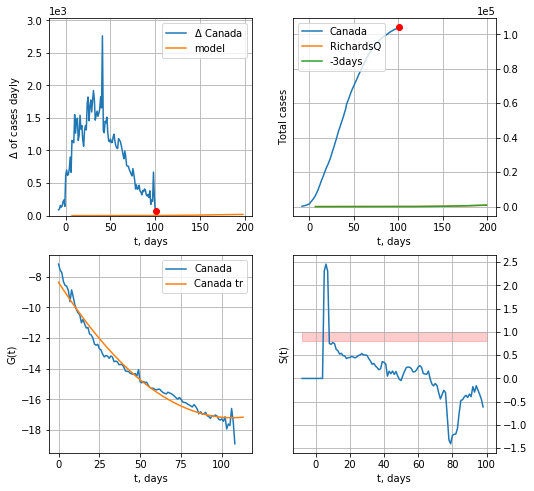

Canada data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 6.29625328e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +98 days
	 deltaDaycases: 18


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [181]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


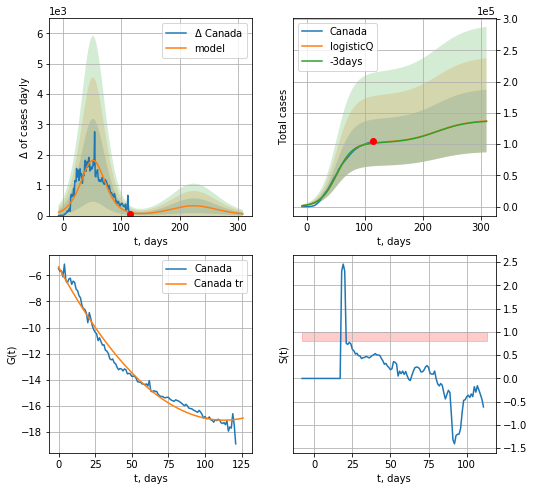

Canada data at: 2020-07-01
+3 day model MAPE: 0.004926
model: logisticQ
coeffs: [ 1.02413277e+05  3.03255694e-07  5.15894997e+01 -2.33989869e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366023
forecast at the end of period: +196 days
	 deltaDaycases: 57
	 total cases: 137028 ± 50155
	 total death: 11321 ± 12431
trend coefficient of determination: 0.982982
 intercept_: -5.363095132612129
 coeffs_: [ 0.         -0.20778965  0.00092025]


In [182]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
117 2020-06-27  41189   12764  1561.0
118 2020-06-28  41646   13016  1564.0
119 2020-06-29  41912   13139  1568.0
120 2020-06-30  42141   13060  1576.0
121 2020-07-01  42454   13077  1579.0


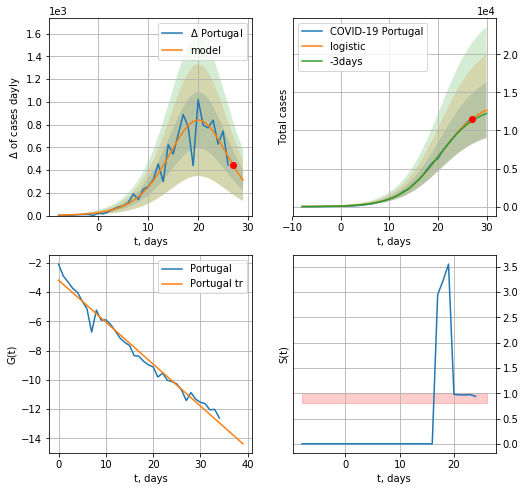

Portugal data at: 2020-07-01
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +3 days
	 deltaDaycases:  310
	 total cases:  12662 ± 3647
	 total death:  470 ± 406
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


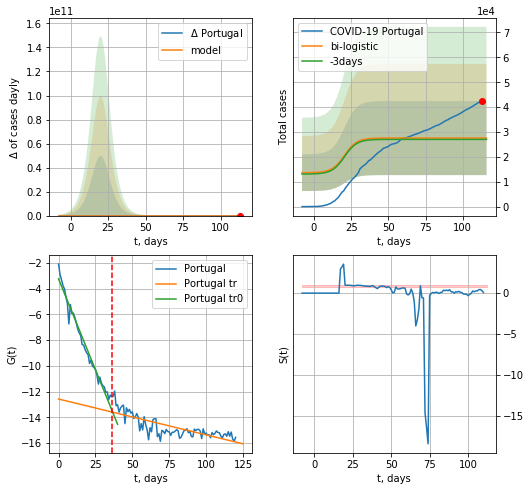

Portugal data at: 2020-07-01
+3 day model MAPE: 0.02020788995880683
model: bi-logistic
coeffs:  [ 1.08982653e+04 -6.58357837e+00  9.55599239e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5401351303460813
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  27566 ± 14889
	 total death:  1025 ± 1660
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.607202
 intercept: -12.580100
 slope: -0.027892


In [183]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,14*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


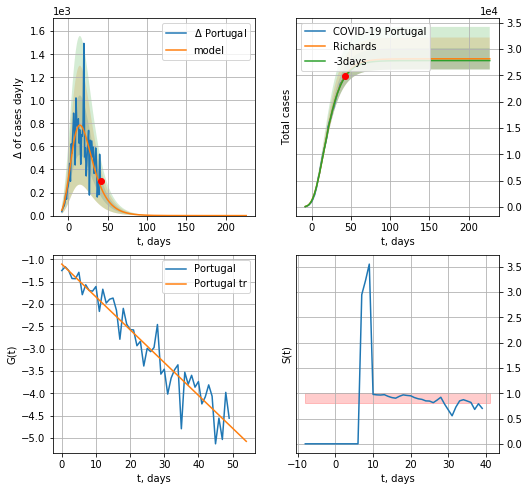

Portugal data at: 2020-07-01
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1047 ± 225
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


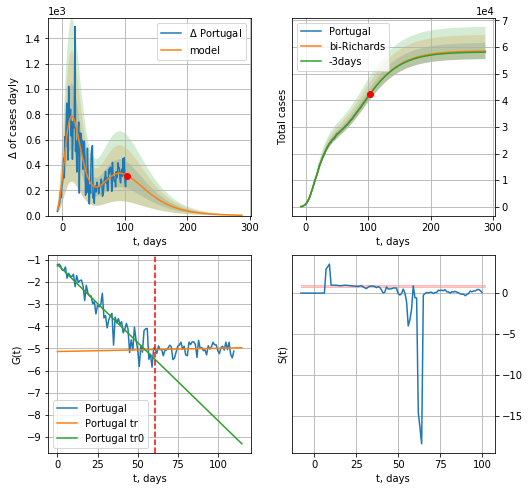

Portugal data at: 2020-07-01
+3 day model MAPE: 0.001076
model: bi-Richards
coeffs: [ 3.04153666e+04  1.50284387e+00 -3.84299651e+01  1.97584192e-02]
rational stdev: 0.051695
forecast at the end of period: +185 days
	 deltaDaycases: 2
	 total cases: 58482 ± 3023
	 total death: 2175 ± 337
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904653
 intercept: -1.210991
 slope: -0.070419
trend coefficient of determination: 0.009404
 intercept: -5.140580
 slope: 0.001467


In [184]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


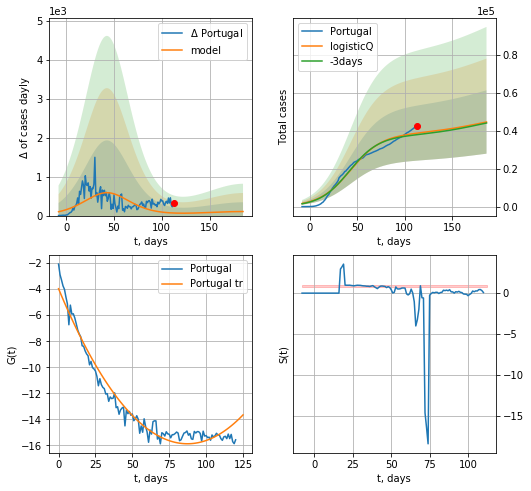

Portugal data at: 2020-07-01
+3 day model MAPE: 0.021012
model: logisticQ
coeffs: [ 3.80519328e+04  1.15101250e-07  4.29058229e+01 -5.31942114e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374505
forecast at the end of period: +73 days
	 deltaDaycases: 104
	 total cases: 44679 ± 16732
	 total death: 1661 ± 1866
trend coefficient of determination: 0.963491
 intercept_: -3.9679357846443146
 coeffs_: [ 0.         -0.27252254  0.0015603 ]


In [185]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

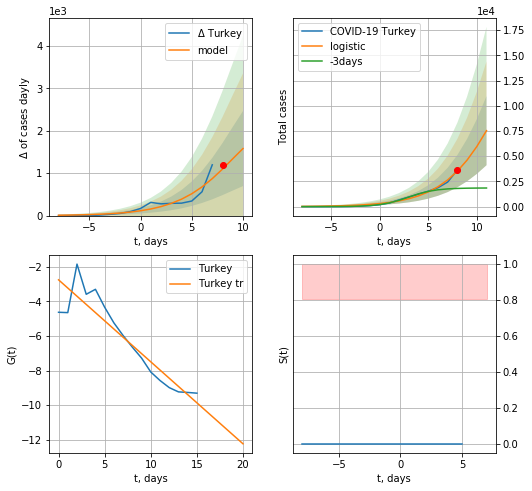

Turkey data at: 2020-07-01
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +3 days
	 deltaDaycases:  1579
	 total cases:  7530 ± 3427
	 total death:  192 ± 262
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


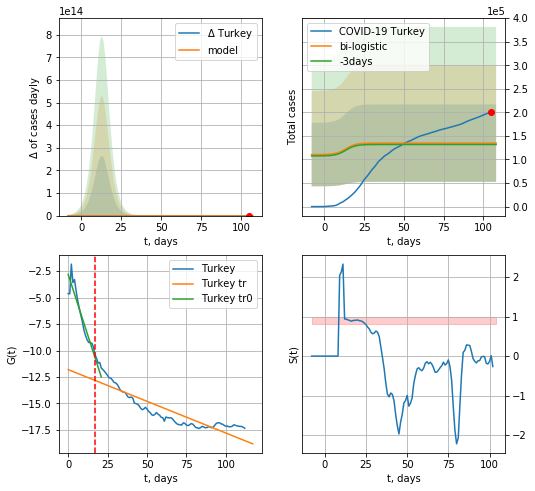

Turkey data at: 2020-07-01
+3 day model MAPE: 0.022353395873634333
model: bi-logistic
coeffs:  [ 8.83915485e+04 -3.85321458e+00  1.12671289e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.610256027127762
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  134756 ± 82236
	 total death:  3451 ± 6317
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.788789
 intercept: -11.802260
 slope: -0.059925


In [186]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*14-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,14*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


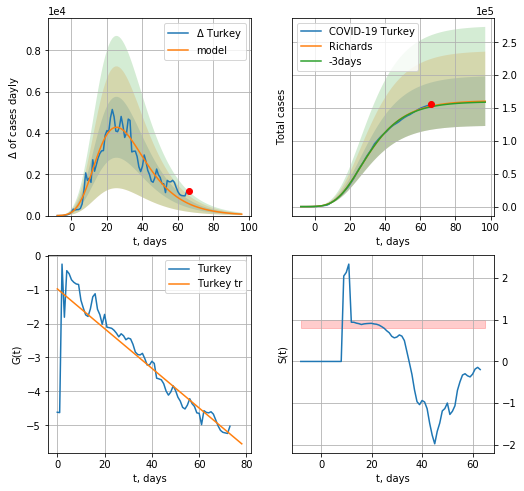

Turkey data at: 2020-07-01
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +31 days
	 deltaDaycases: 68
	 total cases: 160316 ± 37685
	 total death: 4105 ± 2894
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


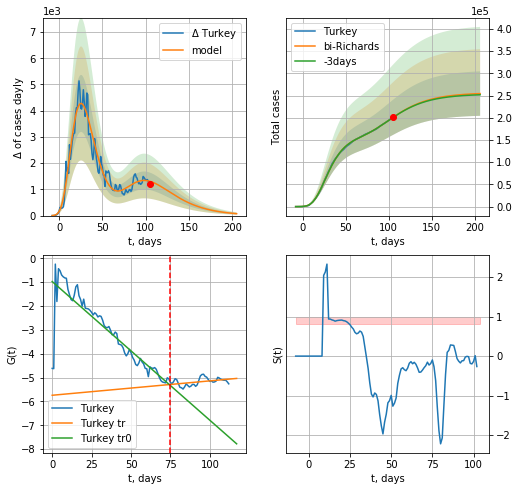

Turkey data at: 2020-07-01
+3 day model MAPE: 0.001067
model: bi-Richards
coeffs: [ 9.52380649e+04  3.37572176e+00 -2.12648971e+01  1.09385797e-02]
rational stdev: 0.196619
forecast at the end of period: +101 days
	 deltaDaycases: 72
	 total cases: 254518 ± 50043
	 total death: 6518 ± 3844
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.778685
 intercept: -0.975737
 slope: -0.058114
trend coefficient of determination: 0.178355
 intercept: -5.740887
 slope: 0.006029


In [187]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


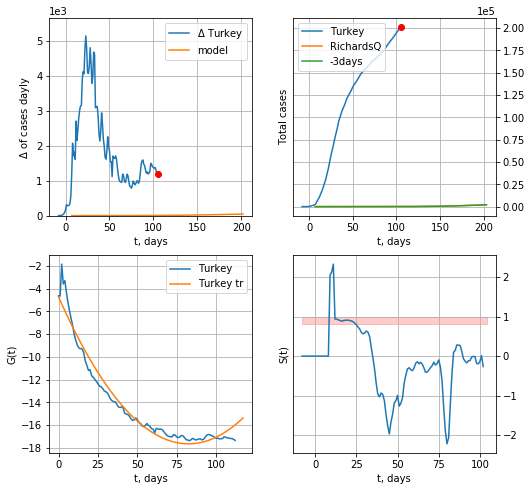

Turkey data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.40696826e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +98 days
	 deltaDaycases: 43


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [188]:
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


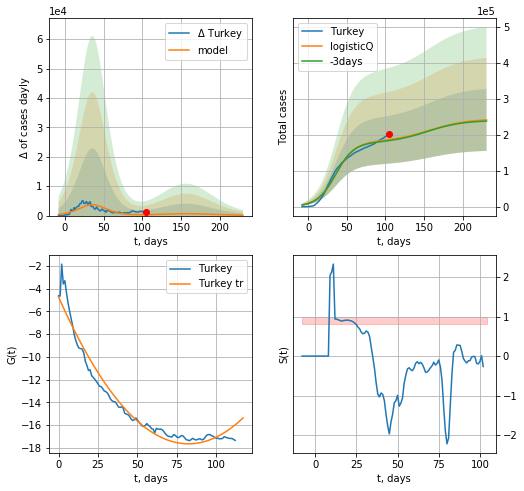

Turkey data at: 2020-07-01
+3 day model MAPE: 0.014151
model: logisticQ
coeffs: [ 1.80144699e+05  1.45998116e-07  3.59769081e+01 -5.61288809e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357502
forecast at the end of period: +126 days
	 deltaDaycases: 114
	 total cases: 241086 ± 86188
	 total death: 6174 ± 6621
trend coefficient of determination: 0.960926
 intercept_: -4.719796401978561
 coeffs_: [ 0.         -0.31351478  0.00190189]


In [189]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [190]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.026761819803746655

In [191]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

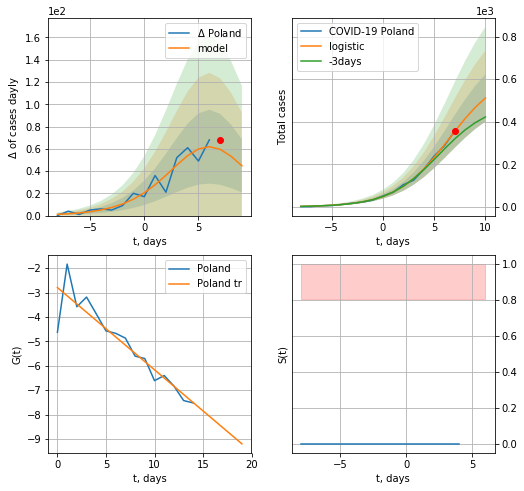

Poland data at: 2020-07-01
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +3 days
	 deltaDaycases:  44
	 total cases:  511 ± 111
	 total death:  21 ± 13
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


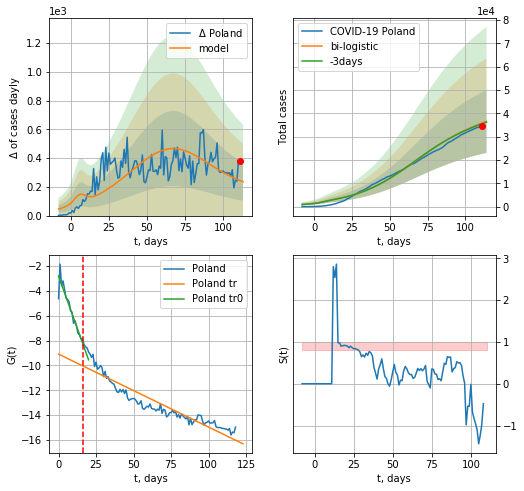

Poland data at: 2020-07-01
+3 day model MAPE: 0.00852833879801409
model: bi-logistic
coeffs:  [3.64507806e+04 4.93786381e-02 6.62443840e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3695625374425431
forecast at the end of period: +3 days
	 deltaDaycases:  236
	 total cases:  36551 ± 13508
	 total death:  1552 ± 1720
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.869154
 intercept: -9.085547
 slope: -0.058750


In [192]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*14-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,14*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


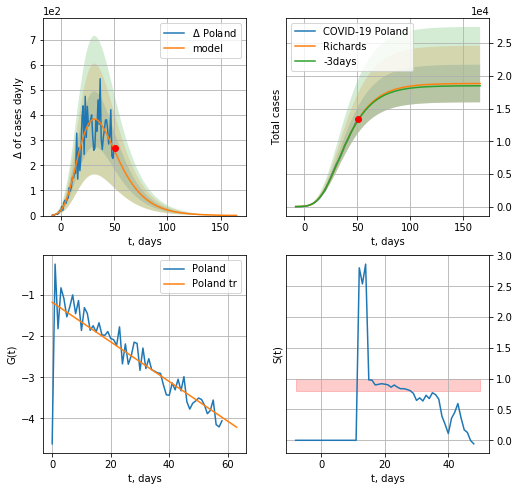

Poland data at: 2020-07-01
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 18831 ± 2884
	 total death: 799 ± 367
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


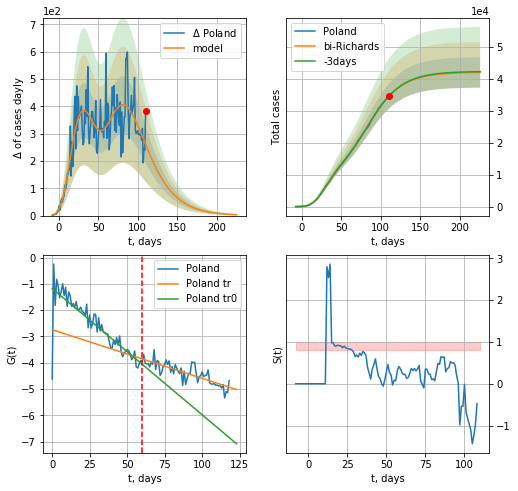

Poland data at: 2020-07-01
+3 day model MAPE: 0.001502
model: bi-Richards
coeffs: [ 2.32696871e+04  2.61377360e+00 -1.31160447e+01  1.58682553e-02]
rational stdev: 0.113147
forecast at the end of period: +115 days
	 deltaDaycases: 3
	 total cases: 42038 ± 4756
	 total death: 1785 ± 605
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.717101
 intercept: -1.179425
 slope: -0.047963
trend coefficient of determination: 0.657980
 intercept: -2.742152
 slope: -0.018499


In [193]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


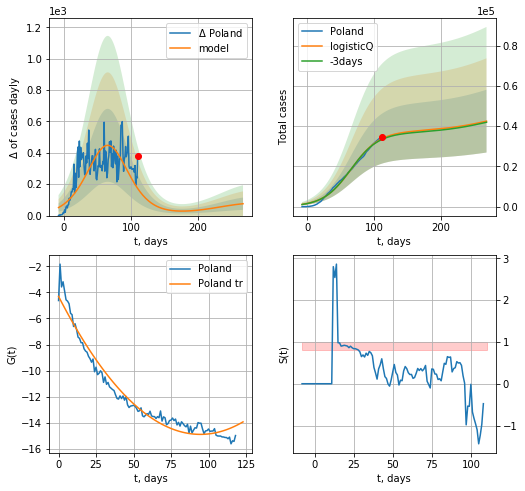

Poland data at: 2020-07-01
+3 day model MAPE: 0.011753
model: logisticQ
coeffs: [ 3.73581302e+04  2.47269204e-07  6.57011078e+01 -1.93167152e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367387
forecast at the end of period: +157 days
	 deltaDaycases: 75
	 total cases: 42534 ± 15626
	 total death: 1806 ± 1990
trend coefficient of determination: 0.960353
 intercept_: -4.304994763810175
 coeffs_: [ 0.         -0.22361724  0.0011825 ]


In [194]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
126 2020-06-27  23421.0    6102  317.0
127 2020-06-28  23755.0    6363  318.0
128 2020-06-29  24441.0    6904  319.0
129 2020-06-30  25244.0    7583  320.0
130 2020-07-01  26257.0    8483  322.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


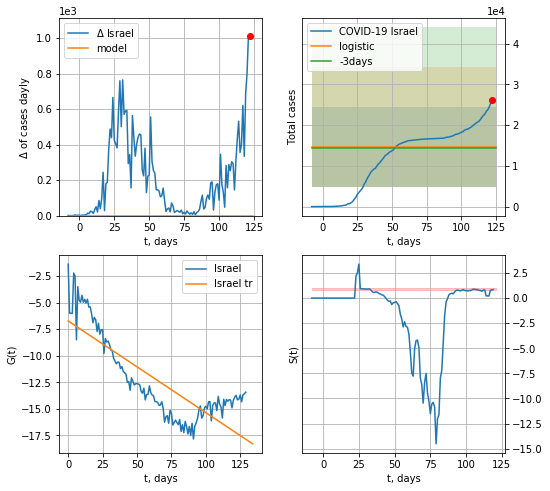

Israel data at: 2020-07-01
+3 day model MAPE: 0.027842589396191293
model: logistic
coeffs:  [ 1.17424357e+04 -5.04925728e+00  1.39605058e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6677270110498398
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  14678 ± 9800
	 total death:  180 ± 360
trend coefficient of determination: 0.669301
 intercept: -6.737071
 slope: -0.086207


In [195]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


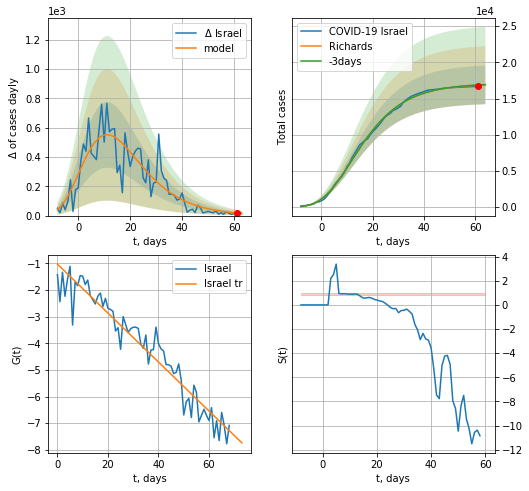

Israel data at: 2020-07-01
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +3 days
	 deltaDaycases: 15
	 total cases: 16887 ± 2671
	 total death: 207 ± 98
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


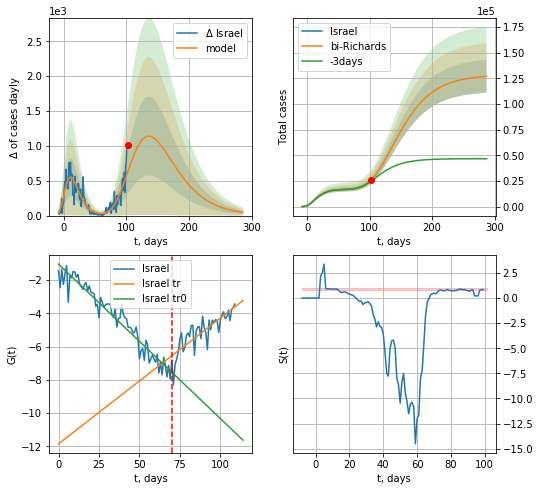

Israel data at: 2020-07-01
+3 day model MAPE: 0.041001
model: bi-Richards
coeffs: [ 1.11724235e+05  1.54084198e+00 -6.91086864e+00  1.81583102e-02]
rational stdev: 0.126245
forecast at the end of period: +185 days
	 deltaDaycases: 46
	 total cases: 127137 ± 16050
	 total death: 1559 ± 590
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.929110
 intercept: -1.044262
 slope: -0.092821
trend coefficient of determination: 0.690040
 intercept: -11.843643
 slope: 0.075554


In [196]:
x = forecastRR('Israel',dfIS[20:90],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


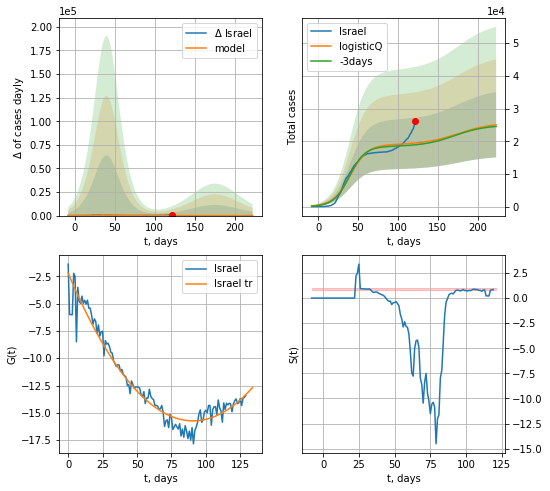

Israel data at: 2020-07-01
+3 day model MAPE: 0.029575
model: logisticQ
coeffs: [ 1.89739110e+04  1.17469385e-07  4.02415640e+01 -7.92323733e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398671
forecast at the end of period: +101 days
	 deltaDaycases: 28
	 total cases: 25040 ± 9983
	 total death: 307 ± 367
trend coefficient of determination: 0.942252
 intercept_: -2.2235566732918315
 coeffs_: [ 0.         -0.29778088  0.00164012]


In [197]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


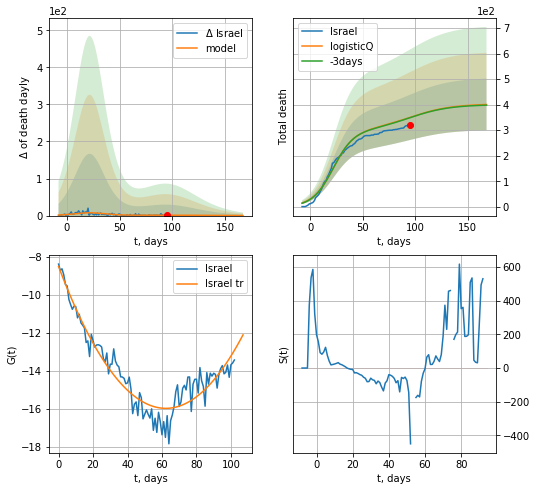

Israel data at: 2020-07-01
+3 day model MAPE: 0.003149
model: logisticQ
coeffs: [ 2.97764699e+02  2.86449632e-07  2.18067771e+01 -3.50319184e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252653
forecast at the end of period: +73 days
	 total death: 400 ± 101
trend coefficient of determination: 0.902827
 intercept_: -8.507736048522835
 coeffs_: [ 0.         -0.23996714  0.0019284 ]


In [198]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


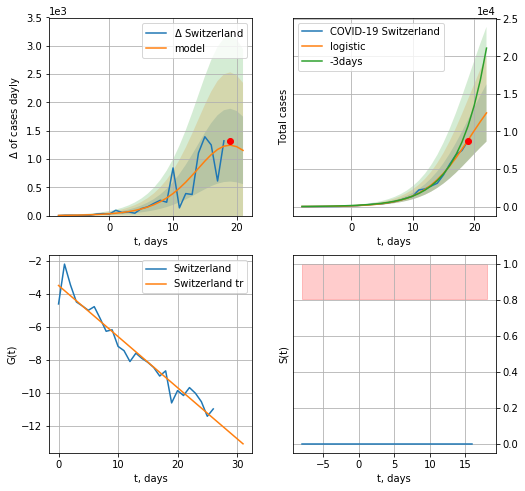

Switzerland data at: 2020-07-01
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +3 days
	 deltaDaycases:  1152
	 total cases:  12470 ± 3816
	 total death:  769 ± 706
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


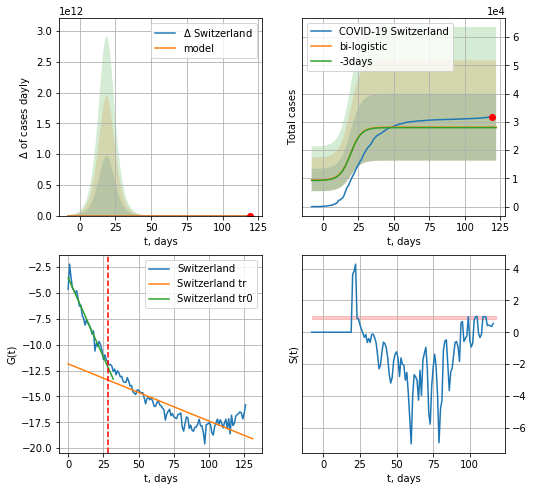

Switzerland data at: 2020-07-01
+3 day model MAPE: 0.005911747128040346
model: bi-logistic
coeffs:  [ 7.52553123e+03 -1.61578734e+00  1.56709605e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4206814342523097
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  28113 ± 11826
	 total death:  1734 ± 2188
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.704218
 intercept: -11.853468
 slope: -0.055225


In [199]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*14-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*14-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


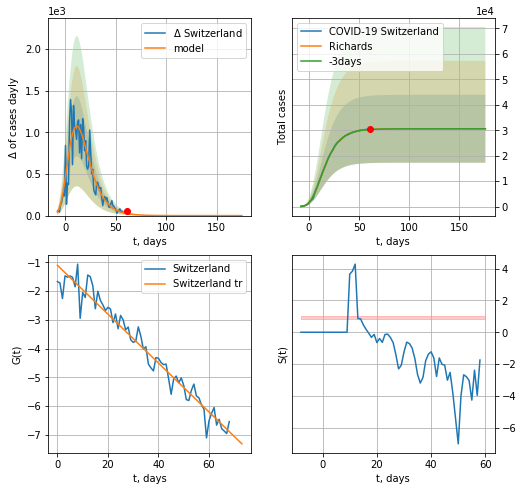

Switzerland data at: 2020-07-01
+3 day model MAPE: 0.000900
model: Richards
coeffs: [ 3.05802442e+04  7.81133256e+00 -3.41505008e+01  1.22973970e-02]
rational stdev: 0.435595
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 30580 ± 13320
	 total death: 1886 ± 2464
trend coefficient of determination: 0.956477
 intercept: -1.104106
 slope: -0.085019


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


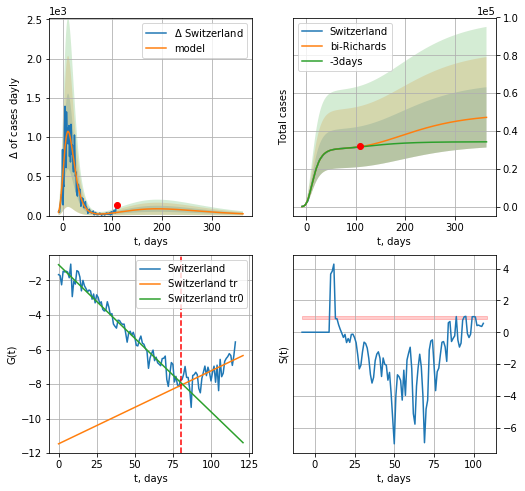

Switzerland data at: 2020-07-01
+3 day model MAPE: 0.004094
model: bi-Richards
coeffs: [ 1.85596973e+04  1.17808439e+00 -1.63570930e+02  1.08261940e-02]
rational stdev: 0.337748
forecast at the end of period: +255 days
	 deltaDaycases: 23
	 total cases: 47199 ± 15941
	 total death: 2911 ± 2949
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.962731
 intercept: -1.084893
 slope: -0.085215
trend coefficient of determination: 0.391767
 intercept: -11.462081
 slope: 0.042254


In [200]:
iL = 10
vL = 80 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*50-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


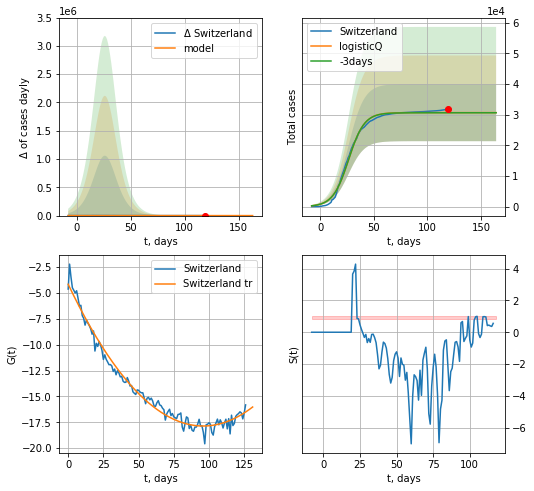

Switzerland data at: 2020-07-01
+3 day model MAPE: 0.001730
model: logisticQ
coeffs: [ 3.06624948e+04  4.68330176e-07  2.64466305e+01 -2.92031815e+05]
rational stdev: 0.303856
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 30662 ± 9316
	 total death: 1891 ± 1723
trend coefficient of determination: 0.980945
 intercept_: -4.161957411789741
 coeffs_: [ 0.         -0.28568436  0.0014898 ]


In [201]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [202]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
109 2020-06-27  42065.0   22254  1110.0
110 2020-06-28  42982.0   22919  1129.0
111 2020-06-29  43628.0   23454  1147.0
112 2020-06-30  44334.0   24060  1159.0
113 2020-07-01  44998.0   24277  1173.0


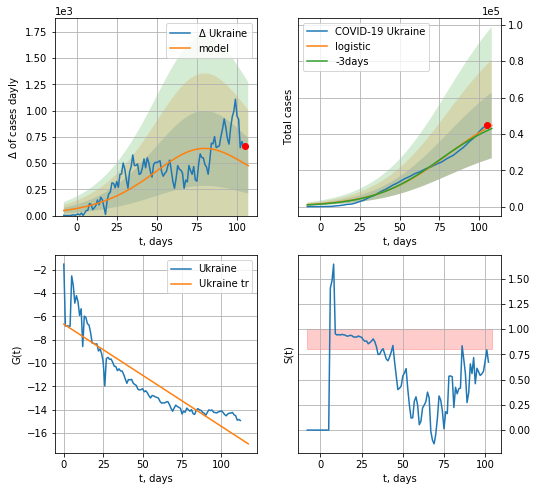

Ukraine data at: 2020-07-01
+3 day model MAPE: 0.036532670643112365
model: logistic
coeffs:  [5.51407969e+04 4.52001622e-02 7.91144850e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.40437401992963395
forecast at the end of period: +3 days
	 deltaDaycases:  475
	 total cases:  44674 ± 18065
	 total death:  1164 ± 1412
trend coefficient of determination: 0.813504
 intercept: -6.657114
 slope: -0.087809


In [203]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


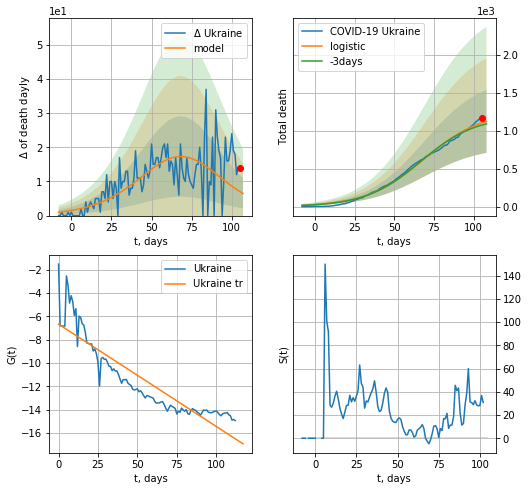

Ukraine data at: 2020-07-01
+3 day model MAPE: 0.027790281141349876
model: logistic
coeffs:  [1.25082733e+03 5.53518269e-02 6.86466768e+01]
rational stdev:  0.3694952833813653
forecast at the end of period: +3 days
	 total death:  1123 ± 415
trend coefficient of determination: 0.813504
 intercept: -6.657114
 slope: -0.087809


In [204]:
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


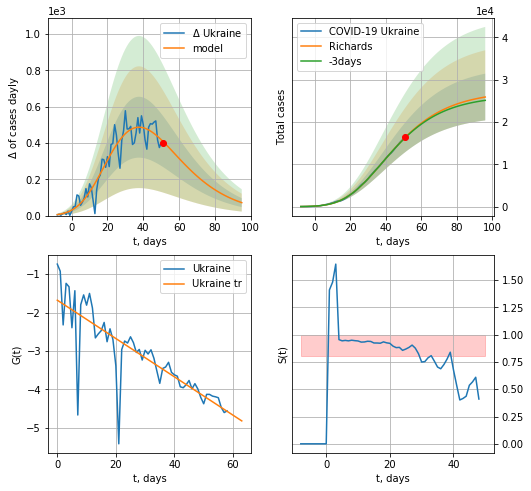

Ukraine data at: 2020-07-01
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +45 days
	 deltaDaycases: 71
	 total cases: 25897 ± 5523
	 total death: 675 ± 431
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


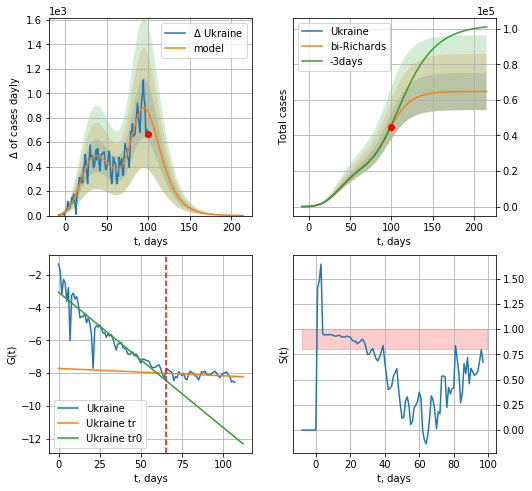

Ukraine data at: 2020-07-01
+3 day model MAPE: 0.019355
model: bi-Richards
coeffs: [3.74958410e+04 1.73776261e-01 8.35416411e+01 4.05340825e-01]
rational stdev: 0.162230
forecast at the end of period: +115 days
	 deltaDaycases: 0
	 total cases: 64798 ± 10512
	 total death: 1689 ± 822
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.851797
 intercept: -3.072765
 slope: -0.082399
trend coefficient of determination: 0.079714
 intercept: -7.711226
 slope: -0.004483


In [205]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


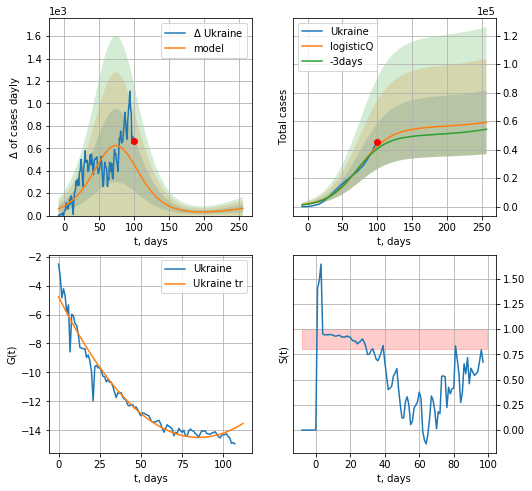

Ukraine data at: 2020-07-01
+3 day model MAPE: 0.043023
model: logisticQ
coeffs: [ 5.56473623e+04  2.85834187e-07  7.45803061e+01 -1.56589268e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377533
forecast at the end of period: +157 days
	 deltaDaycases: 65
	 total cases: 59131 ± 22324
	 total death: 1541 ± 1745
trend coefficient of determination: 0.959751
 intercept_: -4.770404619822382
 coeffs_: [ 0.         -0.22834804  0.00134142]


In [206]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [207]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

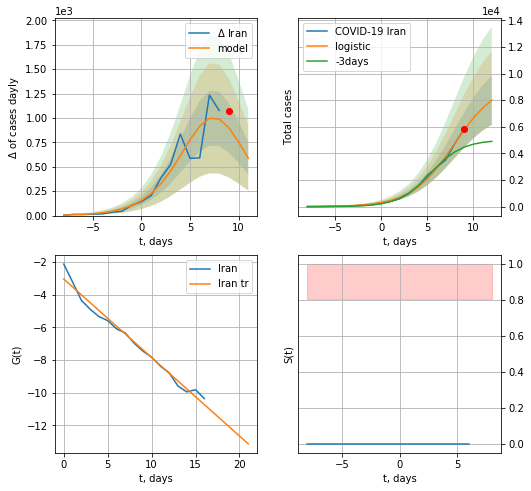

Iran data at: 2020-07-01
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +3 days
	 deltaDaycases:  589
	 total cases:  7994 ± 1836
	 total death:  380 ± 261
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


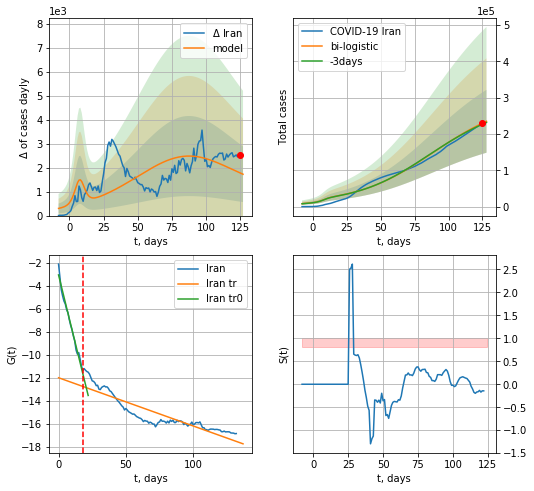

Iran data at: 2020-07-01
+3 day model MAPE: 0.0133171067810094
model: bi-logistic
coeffs:  [2.60451643e+05 3.67346558e-02 8.58317226e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3685845573856066
forecast at the end of period: +3 days
	 deltaDaycases:  1728
	 total cases:  235101 ± 86654
	 total death:  11190 ± 12373
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.810747
 intercept: -11.997708
 slope: -0.041927


In [208]:
x = forecast('Iran',dfIN[:18],d1,7*14-dT)
xx = forecast2('Iran',dfIN[:],d1,14*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


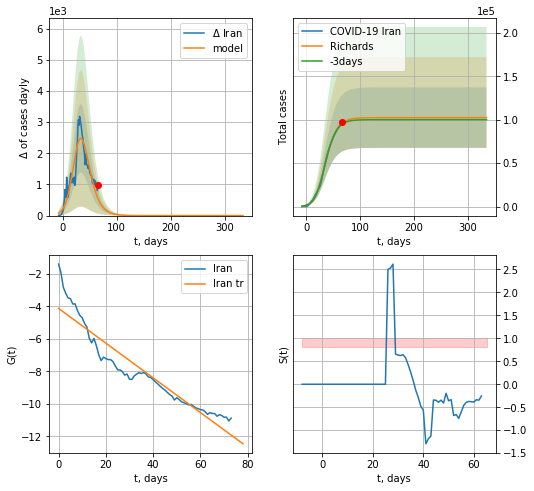

Iran data at: 2020-07-01
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +269 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4877 ± 4973
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


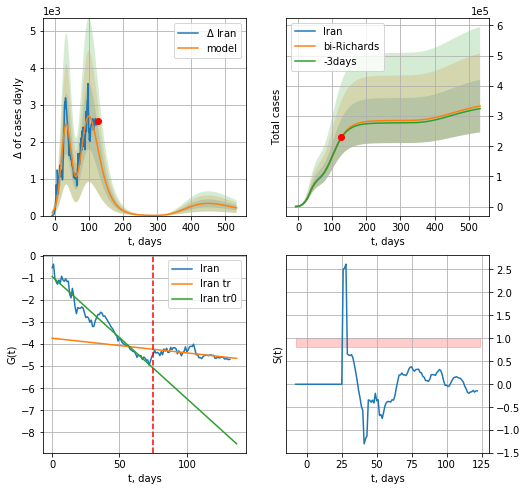

Iran data at: 2020-07-01
+3 day model MAPE: 0.007867
model: bi-Richards
coeffs: [ 1.82665477e+05  2.79587132e+00 -6.14118231e+00  1.42323148e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.261985
forecast at the end of period: +409 days
	 deltaDaycases: 209
	 total cases: 333253 ± 87307
	 total death: 15862 ± 12466
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949243
 intercept: -0.931534
 slope: -0.055400
trend coefficient of determination: 0.379435
 intercept: -3.728326
 slope: -0.006684


In [209]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,72*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


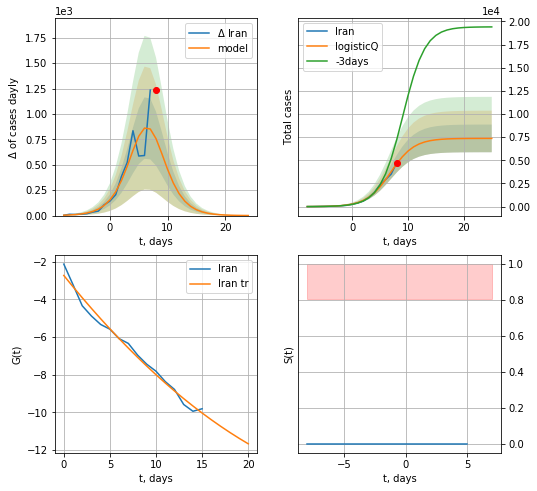

Iran data at: 2020-07-01
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 7367 ± 1495
	 total death: 350 ± 213
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


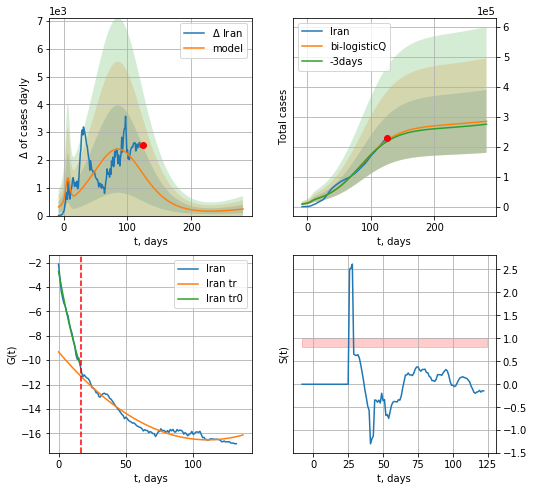

Iran data at: 2020-07-01
+3 day model MAPE: 0.017784
model: bi-logisticQ
coeffs: [ 2.62764097e+05  1.56731550e-07  8.53814802e+01 -2.31416831e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369132
forecast at the end of period: +157 days
	 deltaDaycases: 236
	 total cases: 284979 ± 105195
	 total death: 13564 ± 15020
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.949857
 intercept_: -9.3231528483146
 coeffs_: [ 0.         -0.13024053  0.00058755]


In [210]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active   death
119 2020-06-27  627646.0  225325  8969.0
120 2020-06-28  634437.0  226277  9073.0
121 2020-06-29  641156.0  228560  9166.0
122 2020-06-30  647849.0  225879  9320.0
123 2020-07-01  654405.0  221938  9536.0


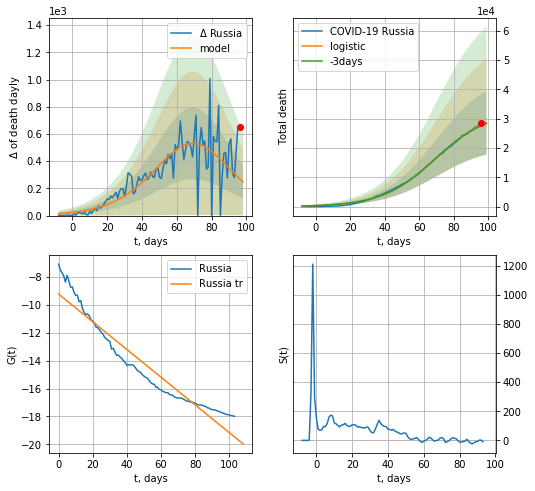

Russia data at: 2020-07-01
+3 day model MAPE: 0.010628463937313055
model: logistic
coeffs:  [3.29727224e+04 6.44690375e-02 6.96508842e+01]
rational stdev:  0.379925364181795
forecast at the end of period: +3 days
	 total death:  28653 ± 10886
trend coefficient of determination: 0.921828
 intercept: -9.222651
 slope: -0.099462


In [211]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,14*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


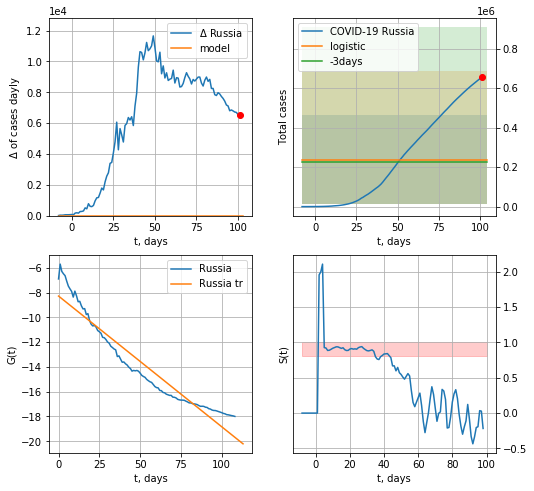

Russia data at: 2020-07-01
+3 day model MAPE: 0.05075063590118872
model: logistic
coeffs:  [ 2.37928654e+05 -6.80841622e+00  1.77631451e+02]
rational stdev:  0.9415028511572656
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  237928 ± 224010
	 total death:  3467 ± 9792
trend coefficient of determination: 0.919063
 intercept: -8.282120
 slope: -0.105528


In [212]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


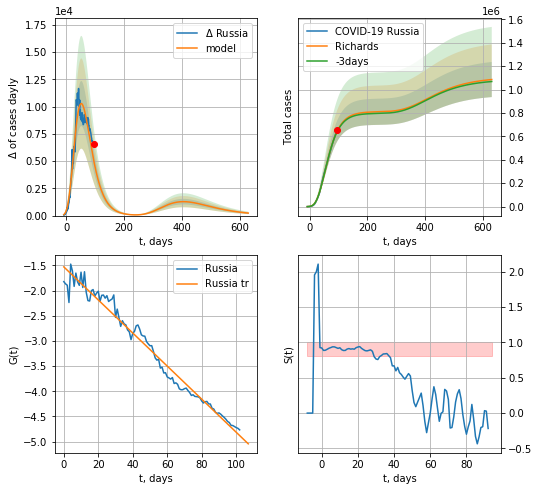

Russia data at: 2020-07-01
+3 day model MAPE: 0.006962
model: Richards
coeffs: [ 8.11311443e+05  2.82608163e+00 -7.41587789e+01  1.22573514e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.138029
forecast at the end of period: +535 days
	 deltaDaycases: 228
	 total cases: 1085404 ± 149817
	 total death: 15816 ± 6549
trend coefficient of determination: 0.975606
 intercept: -1.529837
 slope: -0.032846


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


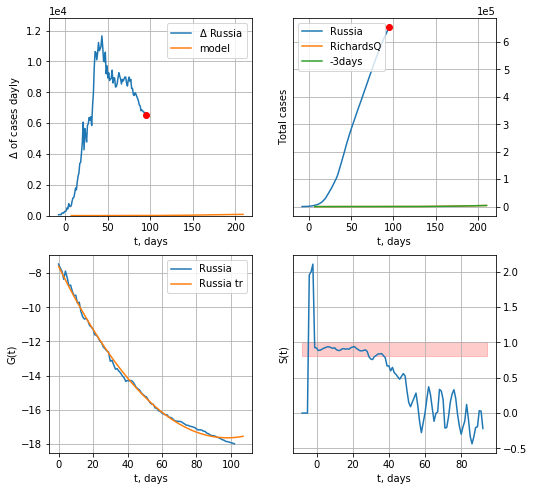

Russia data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.43452012e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +115 days
	 deltaDaycases: 80


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [213]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


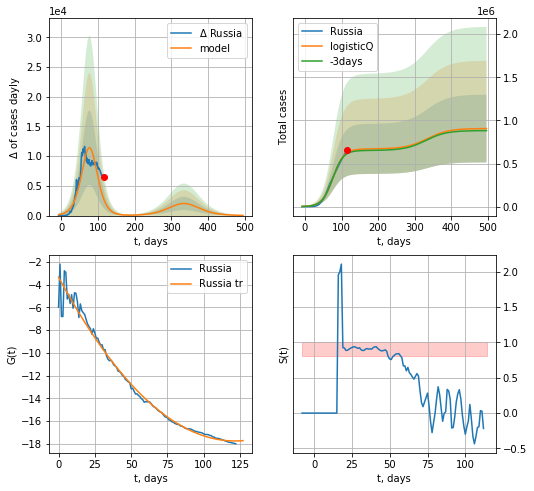

Russia data at: 2020-07-01
+3 day model MAPE: 0.018293
model: logisticQ
coeffs: [ 6.69221275e+05  4.37653276e-07  7.66477660e+01 -1.56033680e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434155
forecast at the end of period: +381 days
	 deltaDaycases: 31
	 total cases: 905334 ± 393054
	 total death: 13192 ± 17182
trend coefficient of determination: 0.982732
 intercept_: -3.360765321188172
 coeffs_: [ 0.         -0.23691821  0.00097549]


In [214]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
157 2020-06-27  18297.0     874  971.0
158 2020-06-28  18390.0     914  971.0
159 2020-06-29  18476.0     947  972.0
160 2020-06-30  18593.0     990  972.0
161 2020-07-01  18723.0    1018  974.0


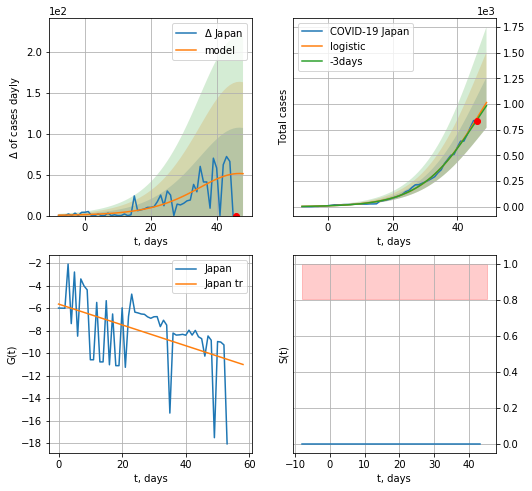

Japan data at: 2020-07-01
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +3 days
	 deltaDaycases:  51
	 total cases:  1014 ± 245
	 total death:  52 ± 37
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


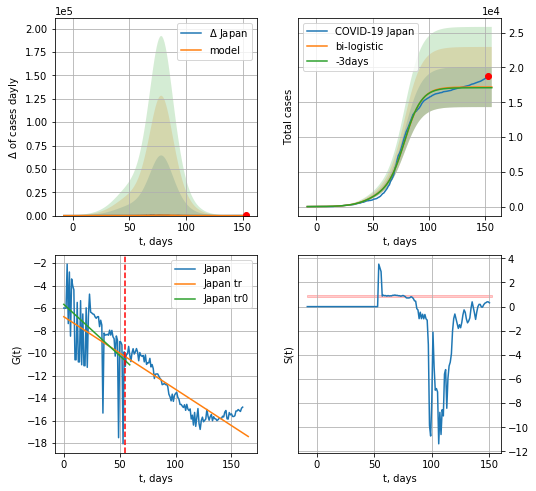

Japan data at: 2020-07-01
+3 day model MAPE: 0.006027316864662177
model: bi-logistic
coeffs:  [1.53236761e+04 1.31041027e-01 7.86851083e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.16758768612940567
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  17189 ± 2880
	 total death:  894 ± 449
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.800252
 intercept: -6.771973
 slope: -0.064531


In [215]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*14-dT)
    xx = forecast2('Japan',dfJP[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

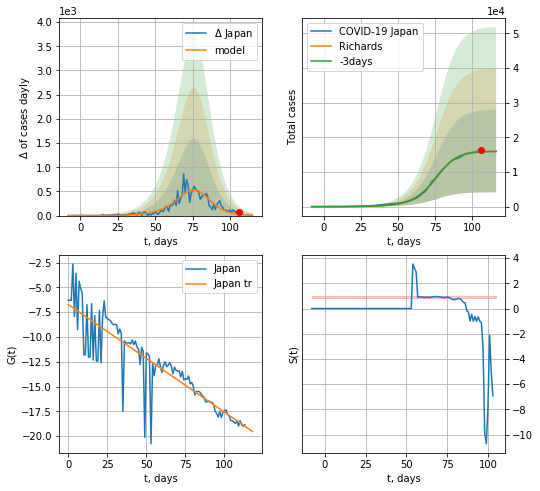

Japan data at: 2020-07-01
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +10 days
	 deltaDaycases: 7
	 total cases: 16058 ± 11936
	 total death: 835 ± 1862
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


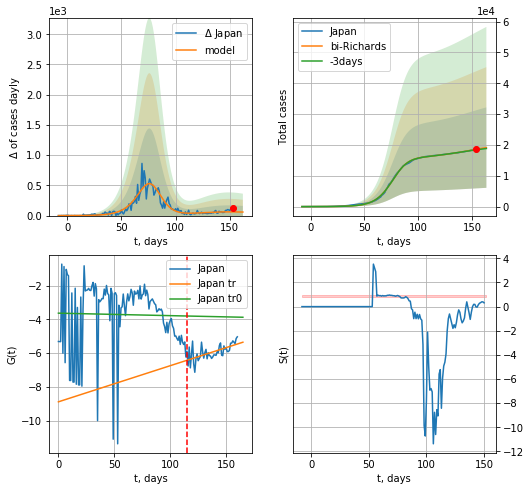

Japan data at: 2020-07-01
+3 day model MAPE: 0.008510
model: bi-Richards
coeffs: [ 6.03759676e+03  4.56660169e+00 -3.22937305e+01  6.12959729e-03]
rational stdev: 0.681612
forecast at the end of period: +10 days
	 deltaDaycases: 58
	 total cases: 19138 ± 13045
	 total death: 995 ± 2034
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000575
 intercept: -3.627249
 slope: -0.001468
trend coefficient of determination: 0.386345
 intercept: -8.887076
 slope: 0.021430


In [216]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,15*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,15*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


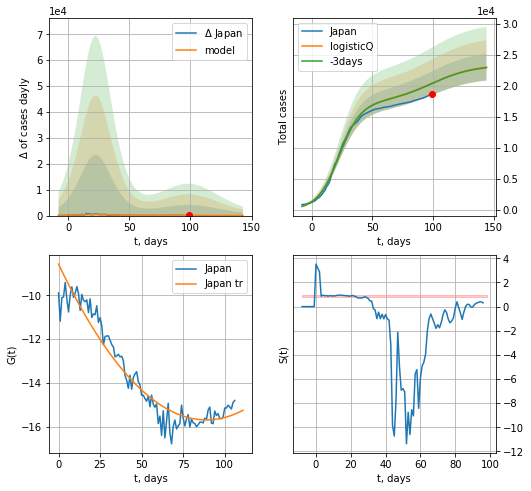

Japan data at: 2020-07-01
+3 day model MAPE: 0.002698
model: logisticQ
coeffs: [ 1.73162250e+04  5.50163261e-07  2.26782601e+01 -2.01683687e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.093863
forecast at the end of period: +45 days
	 deltaDaycases: 24
	 total cases: 22992 ± 2158
	 total death: 1196 ± 336
trend coefficient of determination: 0.924626
 intercept_: -8.571780645448266
 coeffs_: [ 0.         -0.16023425  0.00090109]


In [217]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


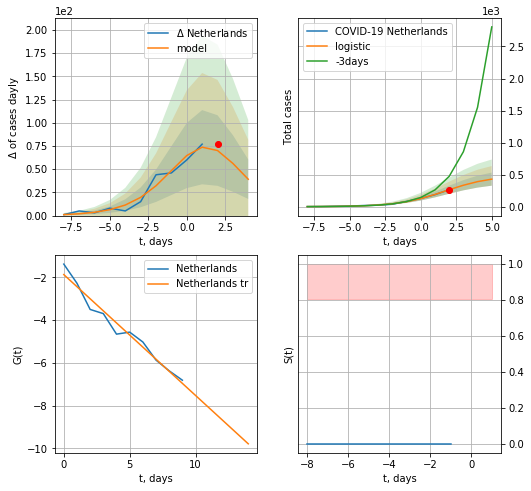

Netherlands data at: 2020-07-01
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +3 days
	 deltaDaycases:  39
	 total cases:  429 ± 102
	 total death:  52 ± 37
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

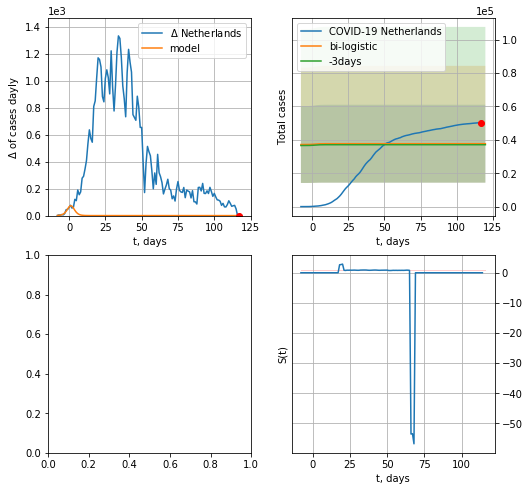

In [218]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,14*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date  cases  active   death
121 2020-06-27  50074       0  6105.0
122 2020-06-28  50147       0  6105.0
123 2020-06-29  50223       0  6107.0
124 2020-06-30  50273       0  6113.0
125 2020-07-01  50273       0  6113.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

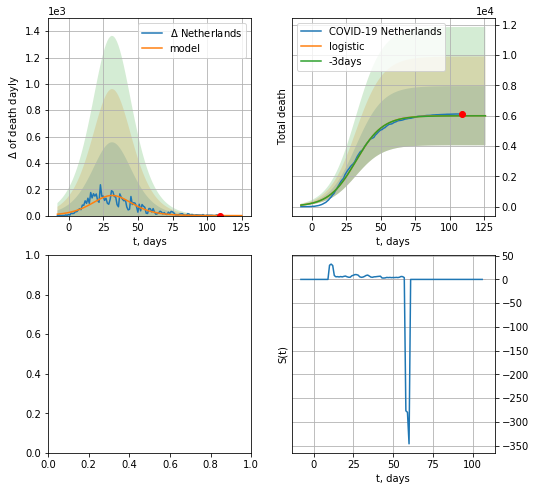

In [219]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


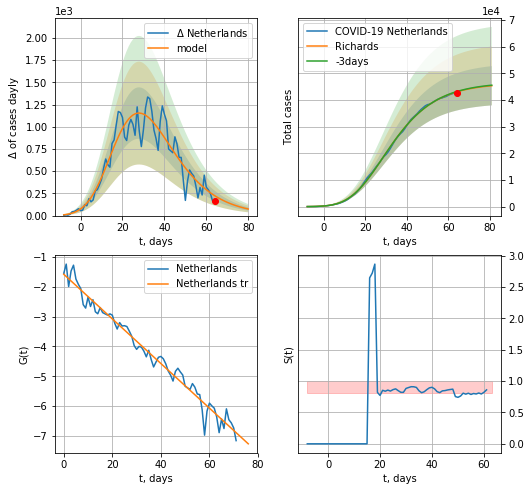

Netherlands data at: 2020-07-01
+3 day model MAPE: 0.002842
model: Richards
coeffs: [4.63365786e+04 4.92236139e-01 2.02382698e+00 1.47660483e-01]
rational stdev: 0.162270
forecast at the end of period: +17 days
	 deltaDaycases: 74
	 total cases: 45340 ± 7357
	 total death: 5513 ± 2683
trend coefficient of determination: 0.973735
 intercept: -1.579499
 slope: -0.074799


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

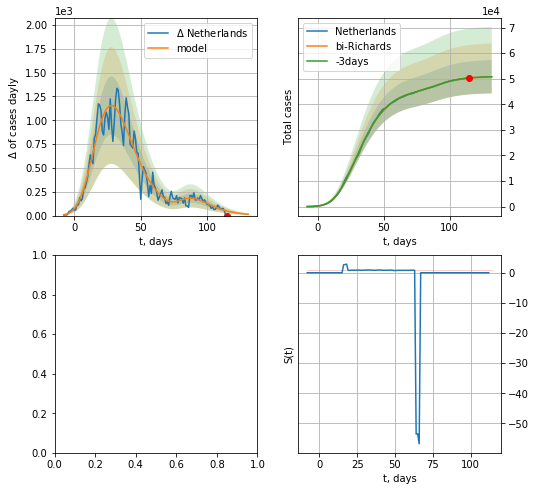

In [220]:
vL = 75
x = forecastRR('Netherlands',dfNL[2:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[2:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

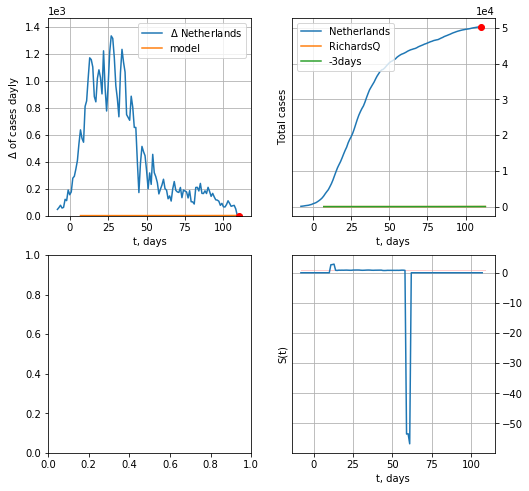

In [221]:
x = forecastQR('Netherlands',dfNL[7:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

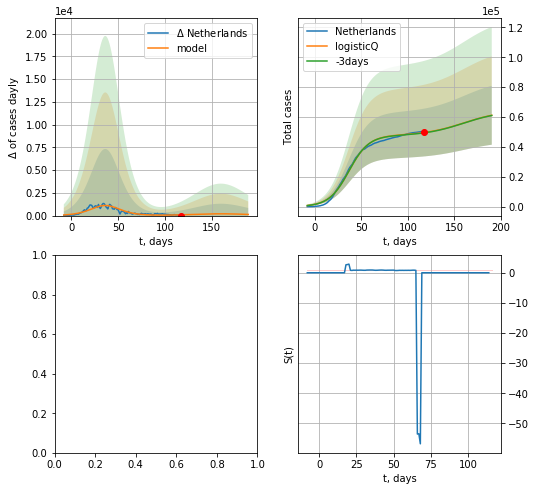

In [222]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [214]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


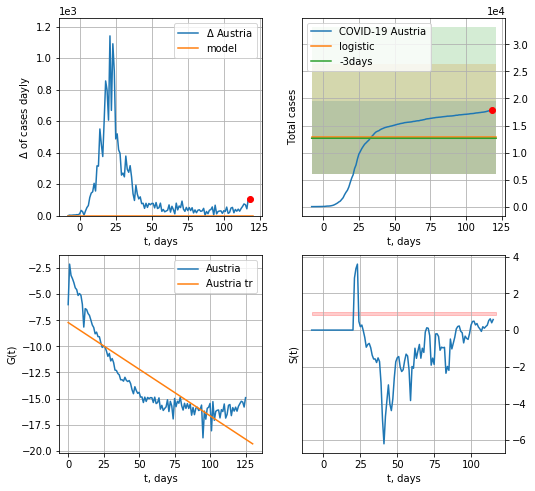

Austria data at: 2020-07-01
+3 day model MAPE: 0.011680695937952191
model: logistic
coeffs:  [ 1.20411339e+04 -8.34420510e+00  1.14593835e+03]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5326866822769519
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  12793 ± 6815
	 total death:  504 ± 805
trend coefficient of determination: 0.722910
 intercept: -7.717855
 slope: -0.089322


In [223]:
x = forecast('Austria',dfAT[:],d1,7*14-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

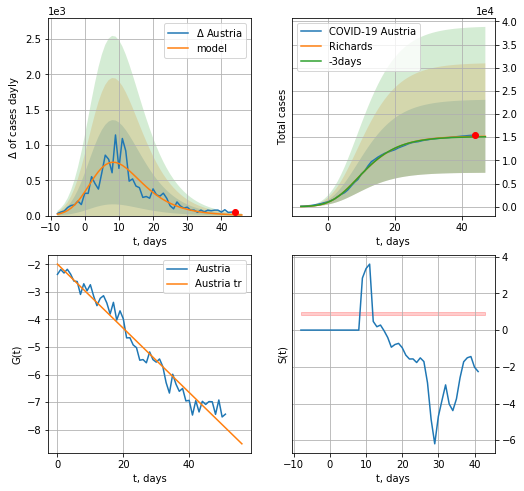

Austria data at: 2020-07-01
+3 day model MAPE: 0.006824
model: Richards
coeffs: [ 1.52413256e+04  8.30508829e-01 -3.03588001e+00  1.76502169e-01]
rational stdev: 0.518621
forecast at the end of period: +3 days
	 deltaDaycases: 8
	 total cases: 15185 ± 7875
	 total death: 598 ± 930
trend coefficient of determination: 0.965129
 intercept: -1.995756
 slope: -0.116348


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


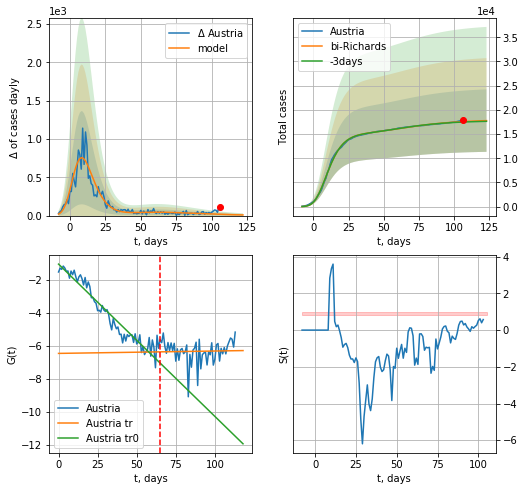

Austria data at: 2020-07-01
+3 day model MAPE: 0.005618
model: bi-Richards
coeffs: [ 2.74583751e+03  7.57393163e+00 -5.66016714e+01  5.68416840e-03]
rational stdev: 0.362848
forecast at the end of period: +17 days
	 deltaDaycases: 8
	 total cases: 17783 ± 6452
	 total death: 701 ± 763
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.933035
 intercept: -1.059965
 slope: -0.092139
trend coefficient of determination: 0.000830
 intercept: -6.461728
 slope: 0.001438


In [224]:
vL=65+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


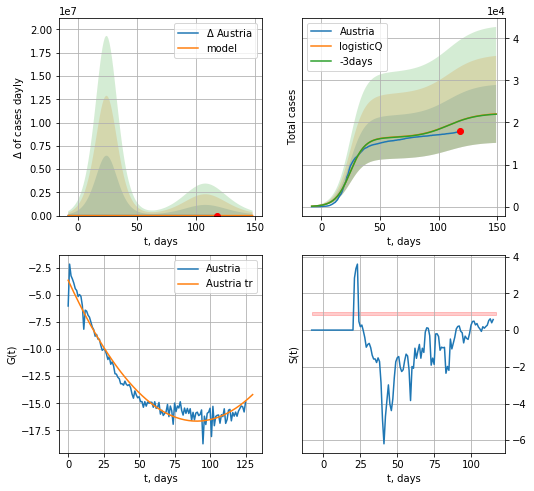

Austria data at: 2020-07-01
+3 day model MAPE: 0.001397
model: logisticQ
coeffs: [ 1.64361811e+04  3.73186975e-07  2.48756229e+01 -4.21527284e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312650
forecast at the end of period: +31 days
	 deltaDaycases: 17
	 total cases: 22031 ± 6888
	 total death: 869 ± 815
trend coefficient of determination: 0.964258
 intercept_: -3.619778218087907
 coeffs_: [ 0.         -0.28761943  0.00158639]


In [225]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
118 2020-06-27  61209.0   34536  9732.0
119 2020-06-28  61295.0   34622  9732.0
120 2020-06-29  61361.0   34688  9732.0
121 2020-06-30  61427.0   34696  9747.0
122 2020-07-01  61509.0   34734  9754.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


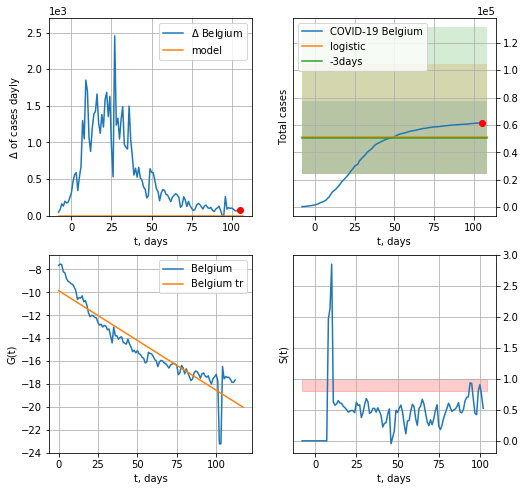

Belgium data at: 2020-07-01
+3 day model MAPE: 0.014016739139528644
model: logistic
coeffs:  [ 4.06446219e+04 -8.17184470e+00  2.63484842e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5303798426084082
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  50805 ± 26946
	 total death:  8056 ± 12818
trend coefficient of determination: 0.858082
 intercept: -9.850117
 slope: -0.086993


In [226]:
vL=9
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[vL:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date    cases  active   death
118 2020-06-27  61209.0   34536  9732.0
119 2020-06-28  61295.0   34622  9732.0
120 2020-06-29  61361.0   34688  9732.0
121 2020-06-30  61427.0   34696  9747.0
122 2020-07-01  61509.0   34734  9754.0


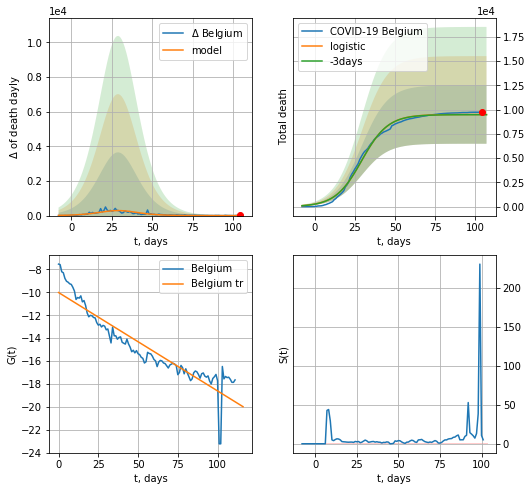

Belgium data at: 2020-07-01
+3 day model MAPE: 0.0019705046660967035
model: logistic
coeffs:  [9.49699096e+03 1.21789822e-01 2.92020118e+01]
rational stdev:  0.3170871412025932
forecast at the end of period: +3 days
	 total death:  9496 ± 3011
trend coefficient of determination: 0.855962
 intercept: -10.015734
 slope: -0.085931


In [227]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


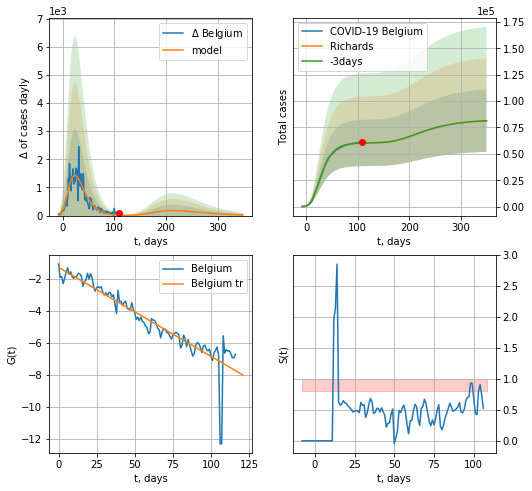

Belgium data at: 2020-07-01
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 6.05477275e+04  6.51115346e+00 -4.78768292e+01  9.85972820e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.363585
forecast at the end of period: +241 days
	 deltaDaycases: 23
	 total cases: 81401 ± 29596
	 total death: 12908 ± 14079
trend coefficient of determination: 0.847345
 intercept: -1.290753
 slope: -0.055634


In [228]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


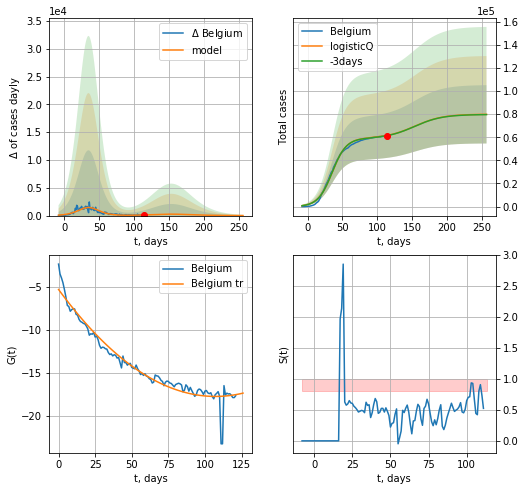

Belgium data at: 2020-07-01
+3 day model MAPE: 0.002958
model: logisticQ
coeffs: [ 5.90615543e+04  3.37138416e-07  3.52772805e+01 -2.92313358e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315738
forecast at the end of period: +143 days
	 deltaDaycases: 6
	 total cases: 79855 ± 25213
	 total death: 12663 ± 11994
trend coefficient of determination: 0.941985
 intercept_: -5.310967076861973
 coeffs_: [ 0.         -0.23166481  0.00108077]


In [229]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [230]:
dfBZ.tail()

,date,cases,active,death
123,2020-06-27,1315941.0,542933,57103.0
124,2020-06-28,1345254.0,553748,57658.0
125,2020-06-29,1370488.0,554641,58385.0
126,2020-06-30,1408485.0,558789,59656.0
127,2020-07-01,1453369.0,476509,60713.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


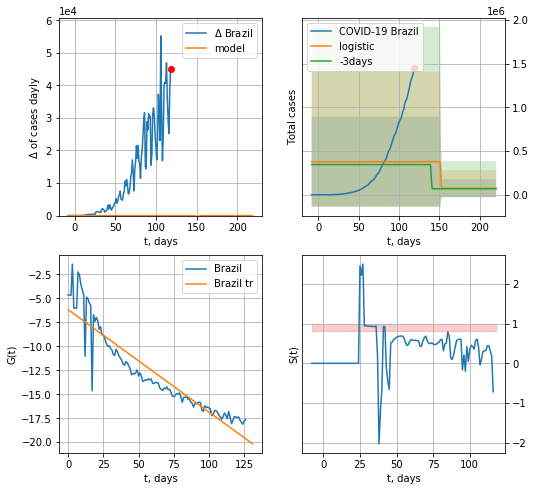

Brazil data at: 2020-07-01
+3 day model MAPE: 0.09625554316541929
model: logistic
coeffs:  [ 3.02840305e+05 -5.92276531e+00  1.51656592e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.356635746981868
forecast at the end of period: +101 days
	 deltaDaycases:  0
	 total cases:  75710 ± 102710
	 total death:  3162 ± 12869
trend coefficient of determination: 0.866332
 intercept: -6.170553
 slope: -0.106873


In [231]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


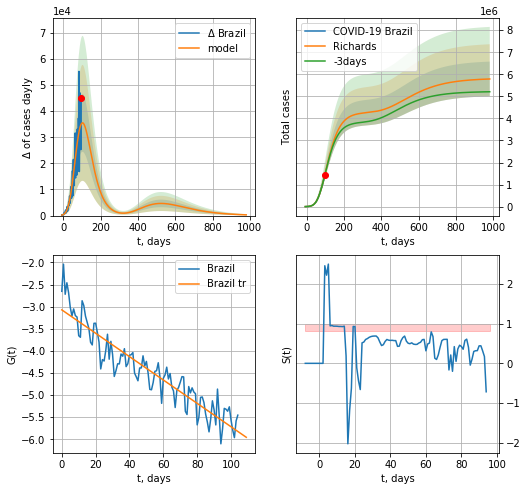

Brazil data at: 2020-07-01
+3 day model MAPE: 0.005700
model: Richards
coeffs: [4.27405050e+06 1.73199041e-01 2.19612760e+01 1.39341193e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.135958
forecast at the end of period: +885 days
	 deltaDaycases: 288
	 total cases: 5787799 ± 786899
	 total death: 241779 ± 98615
trend coefficient of determination: 0.863615
 intercept: -3.072000
 slope: -0.026453


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


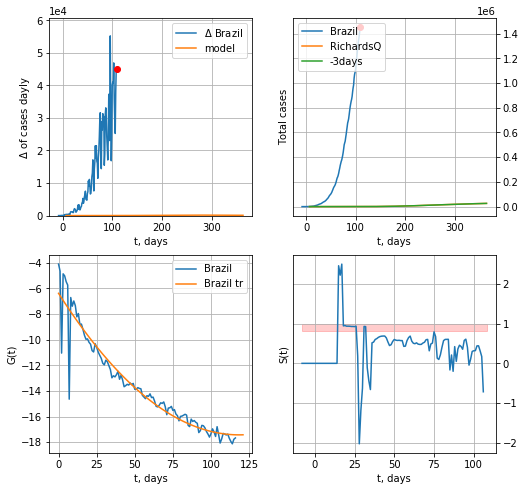

Brazil data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.54597654e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +255 days
	 deltaDaycases: 92


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [232]:
x = forecastRR('Brazil',dfBZ[22:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


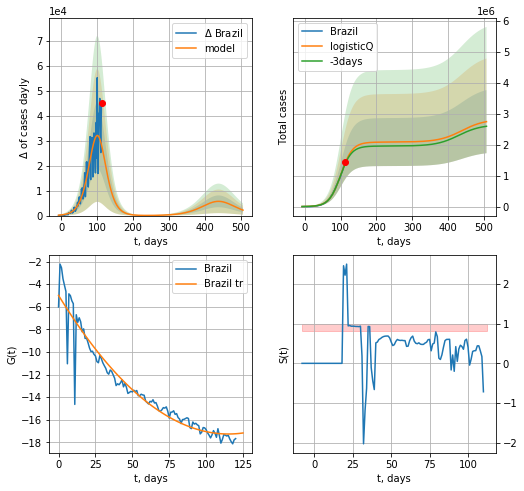

Brazil data at: 2020-07-01
+3 day model MAPE: 0.020691
model: logisticQ
coeffs: [ 2.08075388e+06  1.57512602e-06  1.00747830e+02 -3.90630352e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371661
forecast at the end of period: +395 days
	 deltaDaycases: 2187
	 total cases: 2739684 ± 1018233
	 total death: 114447 ± 127606
trend coefficient of determination: 0.923167
 intercept_: -4.992894032147992
 coeffs_: [ 0.         -0.2131179   0.00092587]


In [233]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [234]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
133 2020-06-27  7686.0     603  104.0
134 2020-06-28  7764.0     653  104.0
135 2020-06-29  7836.0     724  104.0
136 2020-06-30  7920.0     776  104.0
137 2020-07-01  8001.0     807  104.0


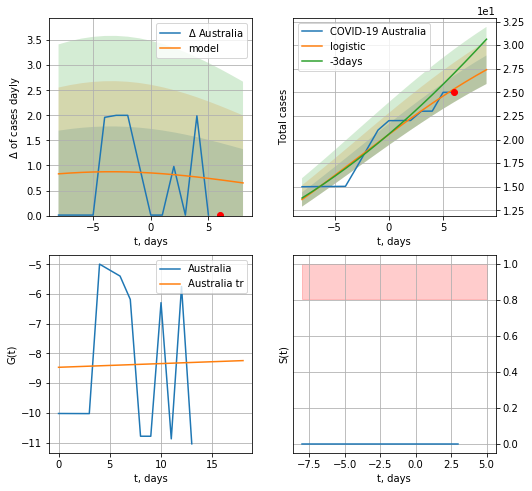

Australia data at: 2020-07-01
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  27 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


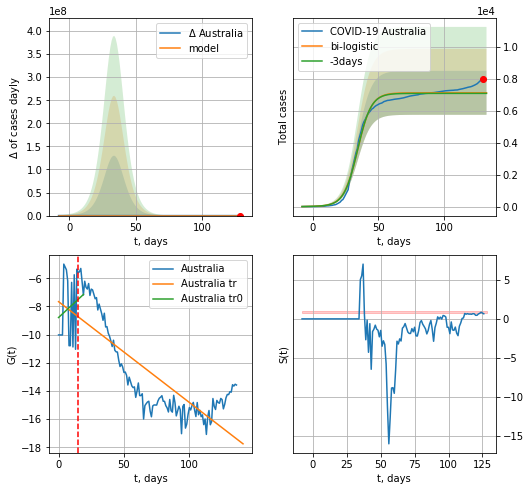

Australia data at: 2020-07-01
+3 day model MAPE: 0.004893625482950517
model: bi-logistic
coeffs:  [7.07653321e+03 1.91630519e-01 3.42333003e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.19277630187710876
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  7112 ± 1371
	 total death:  92 ± 53
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.645547
 intercept: -7.659795
 slope: -0.071604


In [235]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,14*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,14*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


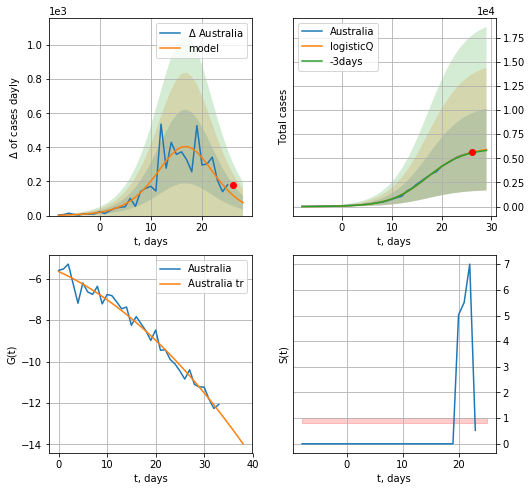

Australia data at: 2020-07-01
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +3 days
	 deltaDaycases: 75
	 total cases: 5904 ± 4231
	 total death: 76 ± 163
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


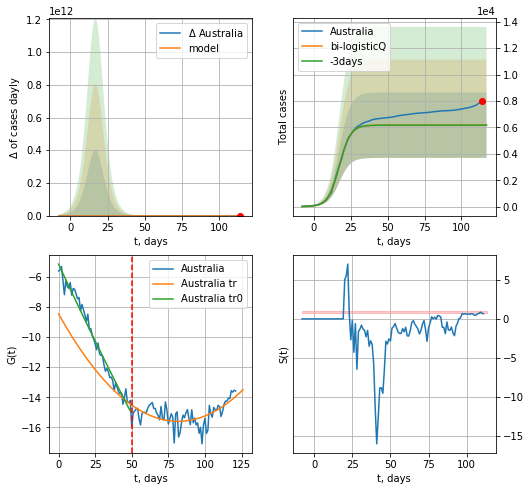

Australia data at: 2020-07-01
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-2.42122503 -0.06295556 24.69702425  0.22536415]
rational stdev: 0.401770
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2478
	 total death: 80 ± 96
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.359091
 intercept_: -8.4514268038366
 coeffs_: [ 0.         -0.17481585  0.00106954]


In [236]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,14*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

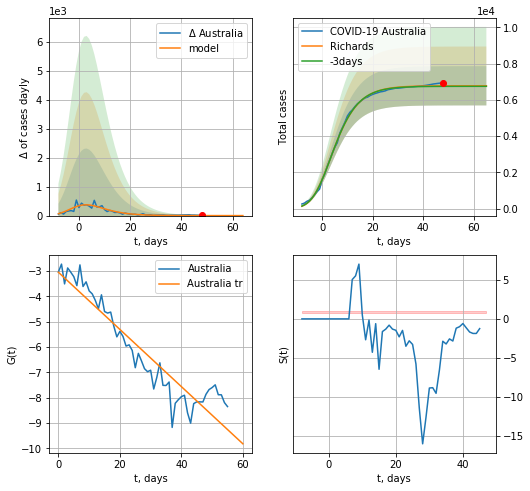

Australia data at: 2020-07-01
+3 day model MAPE: 0.004280
model: Richards
coeffs: [ 6.77705018e+03  7.40442846e-01 -5.76166471e+00  2.24569731e-01]
rational stdev: 0.159926
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 6776 ± 1083
	 total death: 88 ± 42
trend coefficient of determination: 0.885689
 intercept: -3.046778
 slope: -0.112817


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


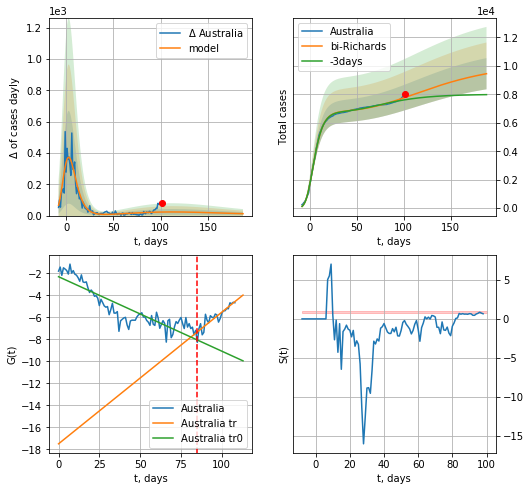

Australia data at: 2020-07-01
+3 day model MAPE: 0.022484
model: bi-Richards
coeffs: [ 3.40961184e+03  2.03103249e+00 -1.38797141e+02  9.19299143e-03]
rational stdev: 0.115998
forecast at the end of period: +87 days
	 deltaDaycases: 12
	 total cases: 9450 ± 1096
	 total death: 122 ± 42
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.792877
 intercept: -2.309366
 slope: -0.067660
trend coefficient of determination: 0.795884
 intercept: -17.494508
 slope: 0.119595


In [237]:
iL = 28
vL = 85+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

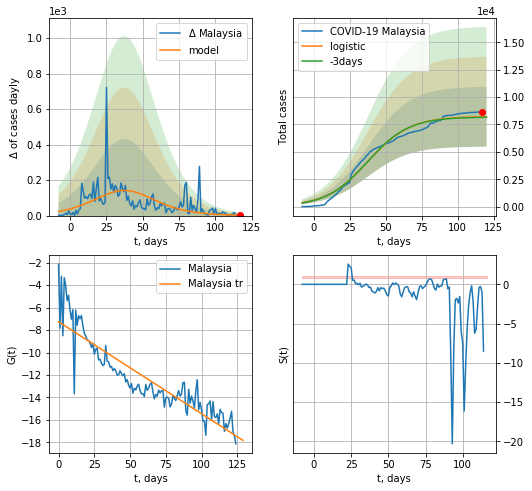

Malaysia data at: 2020-07-01
+3 day model MAPE: 0.0066585716004400825
model: logistic
coeffs:  [8.24040405e+03 6.87430420e-02 3.77078767e+01]
rational stdev:  0.3327230910966982
forecast at the end of period: +3 days
	 deltaDaycases:  2
	 total cases:  8211 ± 2732
	 total death:  115 ± 114
trend coefficient of determination: 0.807053
 intercept: -7.253824
 slope: -0.081935


In [238]:
x = forecast('Malaysia',dfML[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

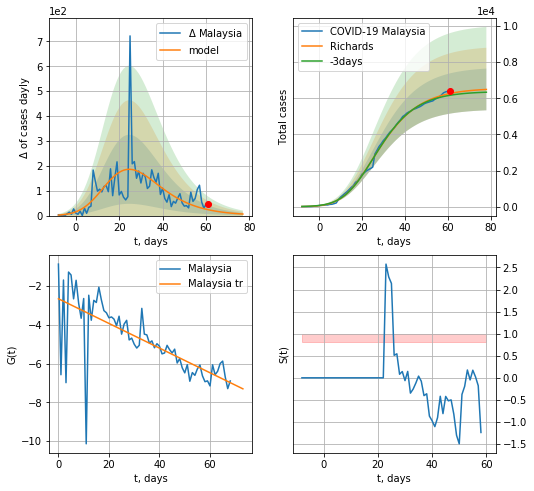

Malaysia data at: 2020-07-01
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +17 days
	 deltaDaycases: 6
	 total cases: 6486 ± 1153
	 total death: 90 ± 48
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


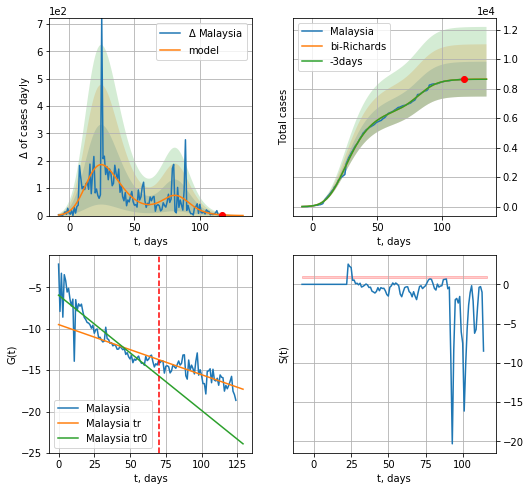

Malaysia data at: 2020-07-01
+3 day model MAPE: 0.000570
model: bi-Richards
coeffs: [2.09424357e+03 1.28190619e-01 8.23511938e+01 1.05673070e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136511
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 8649 ± 1180
	 total death: 121 ± 49
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.811568
 intercept: -5.955516
 slope: -0.138998
trend coefficient of determination: 0.546944
 intercept: -9.505850
 slope: -0.060417


In [239]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


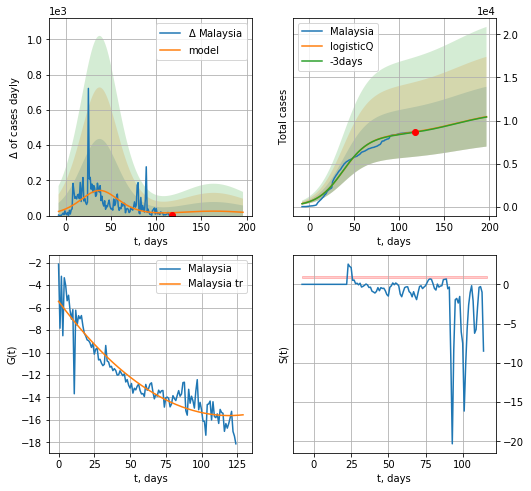

Malaysia data at: 2020-07-01
+3 day model MAPE: 0.005501
model: logisticQ
coeffs: [ 8.24037106e+03  1.21503461e-07  3.77084792e+01 -5.65543628e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332761
forecast at the end of period: +80 days
	 deltaDaycases: 18
	 total cases: 10445 ± 3475
	 total death: 146 ± 145
trend coefficient of determination: 0.871052
 intercept_: -5.4367091916736605
 coeffs_: [ 0.         -0.17057714  0.00071486]


In [240]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
120 2020-06-27  1526.0      20   22.0
121 2020-06-28  1528.0      22   22.0
122 2020-06-29  1528.3      22   22.0
123 2020-06-30  1528.6      22   22.0
124 2020-07-01  1530.0      18   22.0


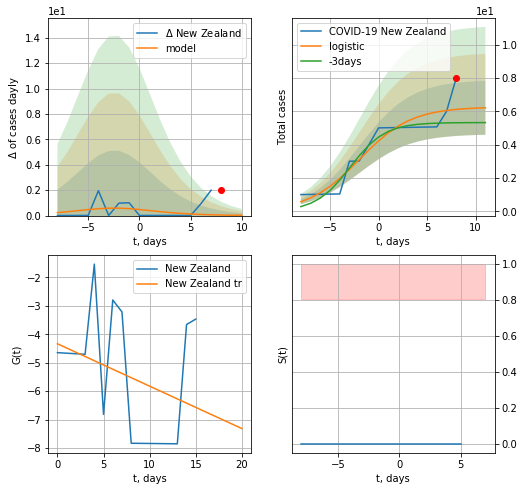

New Zealand data at: 2020-07-01
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


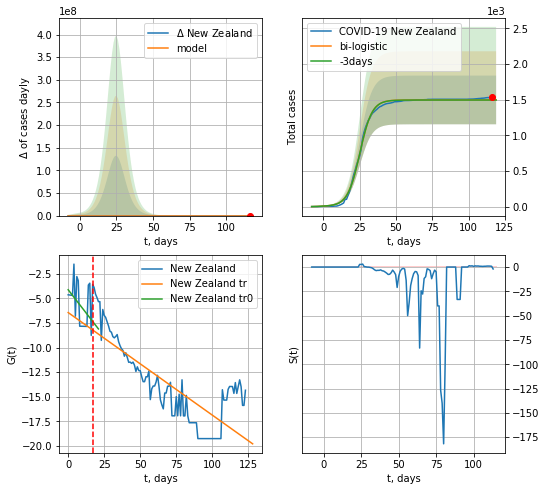

New Zealand data at: 2020-07-01
+3 day model MAPE: 0.0009340203750932649
model: bi-logistic
coeffs:  [1.48918319e+03 2.39311275e-01 2.51739016e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.22808785368164355
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1495 ± 341
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.630449
 intercept: -6.447419
 slope: -0.104052


In [243]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,14*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

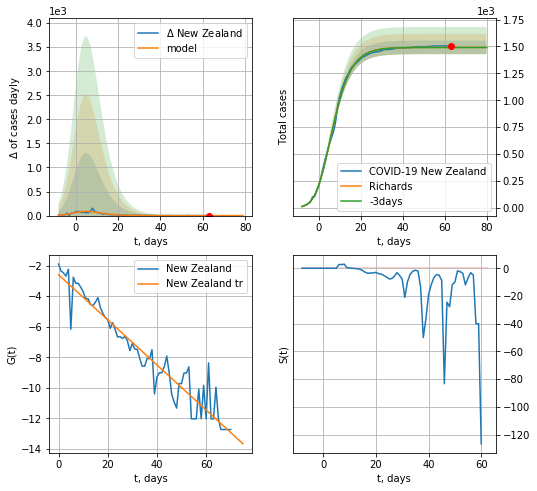

New Zealand data at: 2020-07-01
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158630e+03  5.64402224e-01 -5.41494471e-01  3.30453174e-01]
rational stdev: 0.042486
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603090
 slope: -0.147473


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


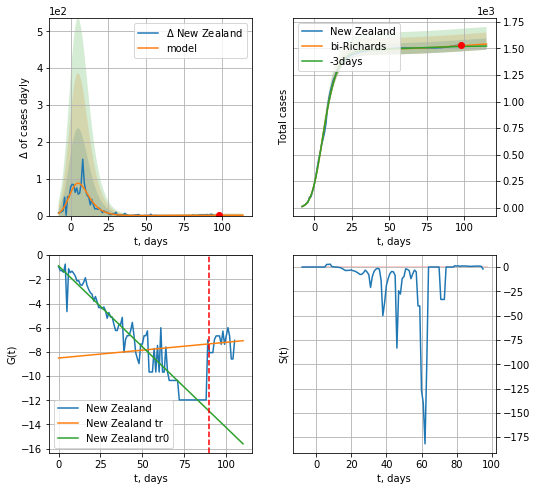

New Zealand data at: 2020-07-01
+3 day model MAPE: 0.005132
model: bi-Richards
coeffs: [ 1.20907363e+02  3.22408212e+00 -1.21063224e+02  6.72257003e-03]
rational stdev: 0.034857
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1541 ± 53
	 total death: 22 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914484
 intercept: -0.896178
 slope: -0.133641
trend coefficient of determination: 0.005855
 intercept: -8.505197
 slope: 0.013012


In [247]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


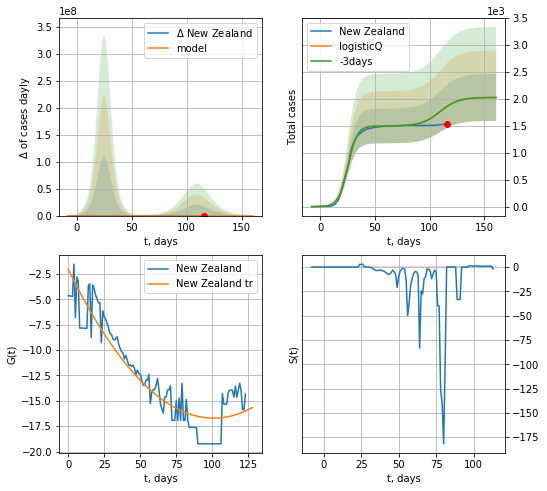

New Zealand data at: 2020-07-01
+3 day model MAPE: 0.000423
model: logisticQ
coeffs: [ 1.49567238e+03  1.93766211e-06  2.51268272e+01 -1.22304173e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.215235
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 2024 ± 435
	 total death: 29 ± 18
trend coefficient of determination: 0.854485
 intercept_: -2.0346229787546477
 coeffs_: [ 0.         -0.29068937  0.00143959]


In [248]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
120 2020-06-27  61095.0   16592  377.0
121 2020-06-28  61475.0   16065  383.0
122 2020-06-29  61790.0   16190  387.0
123 2020-06-30  62118.0   15672  392.0
124 2020-07-01  62424.0   14473  398.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


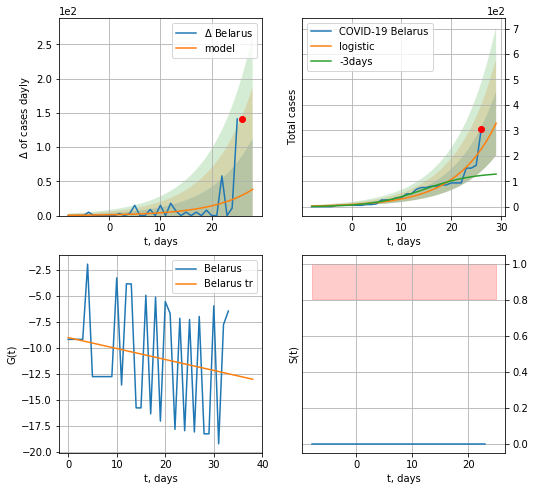

Belarus data at: 2020-07-01
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +3 days
	 deltaDaycases:  38
	 total cases:  328 ± 126
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


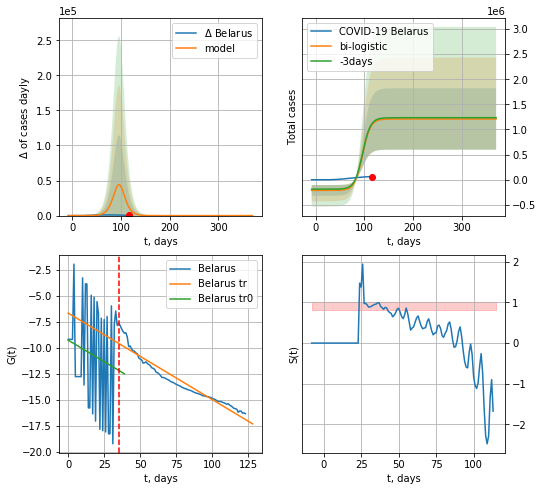

Belarus data at: 2020-07-01
+3 day model MAPE: 0.022105141177713797
model: bi-logistic
coeffs:  [-2.12703721e+05  3.38297719e+01 -7.82156094e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.5050399954162306
forecast at the end of period: +255 days
	 deltaDaycases:  0
	 total cases:  1209275 ± 610732
	 total death:  7710 ± 11681
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.927849
 intercept: -6.683236
 slope: -0.083233


In [249]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*14-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
120 2020-06-27  61095.0   16592  377.0
121 2020-06-28  61475.0   16065  383.0
122 2020-06-29  61790.0   16190  387.0
123 2020-06-30  62118.0   15672  392.0
124 2020-07-01  62424.0   14473  398.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


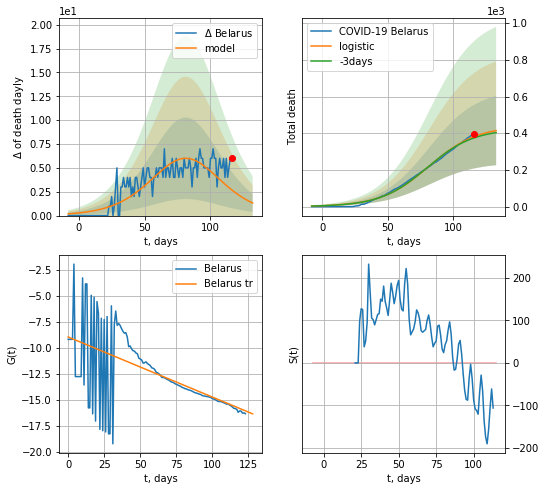

Belarus data at: 2020-07-01
+3 day model MAPE: 0.018851777218312684
model: logistic
coeffs:  [4.39097482e+02 5.46866296e-02 8.16635804e+01]
rational stdev:  0.45491403357076254
forecast at the end of period: +17 days
	 total death:  414 ± 188
trend coefficient of determination: 0.344097
 intercept: -8.983883
 slope: -0.057749


In [250]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


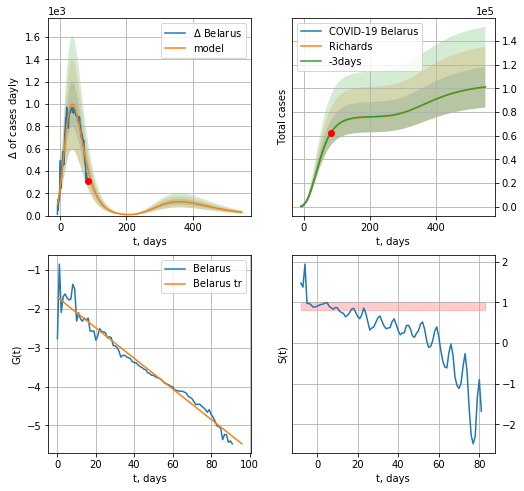

Belarus data at: 2020-07-01
+3 day model MAPE: 0.002428
model: Richards
coeffs: [ 7.57692522e+04  2.57078983e+00 -8.05846140e+01  1.40558607e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.169007
forecast at the end of period: +465 days
	 deltaDaycases: 30
	 total cases: 100687 ± 17016
	 total death: 641 ± 325
trend coefficient of determination: 0.960646
 intercept: -1.705233
 slope: -0.039252


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


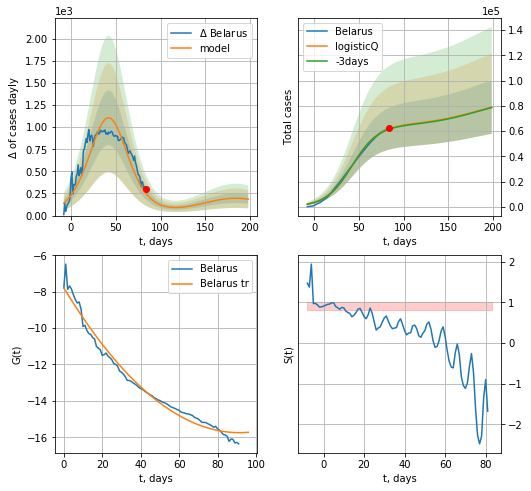

Belarus data at: 2020-07-01
+3 day model MAPE: 0.006851
model: logisticQ
coeffs: [ 6.47758609e+04  5.57371741e-07  4.23460326e+01 -1.21914679e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267858
forecast at the end of period: +115 days
	 deltaDaycases: 185
	 total cases: 79019 ± 21165
	 total death: 503 ± 404
trend coefficient of determination: 0.980180
 intercept_: -7.789405457388247
 coeffs_: [ 0.         -0.17403996  0.00095162]


In [251]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


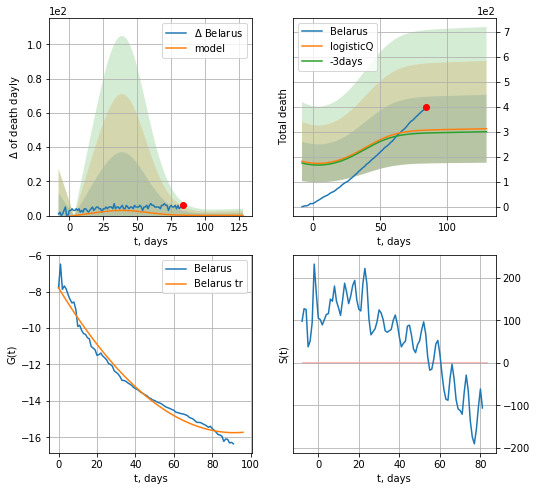

Belarus data at: 2020-07-01
+3 day model MAPE: 0.039757
model: logisticQ
coeffs: [ 2.60068302e+02  8.49377327e-04  8.91415334e+00 -9.87852807e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434427
forecast at the end of period: +45 days
	 total death: 312 ± 135
trend coefficient of determination: 0.980180
 intercept_: -7.789405457388247
 coeffs_: [ 0.         -0.17403996  0.00095162]


In [252]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

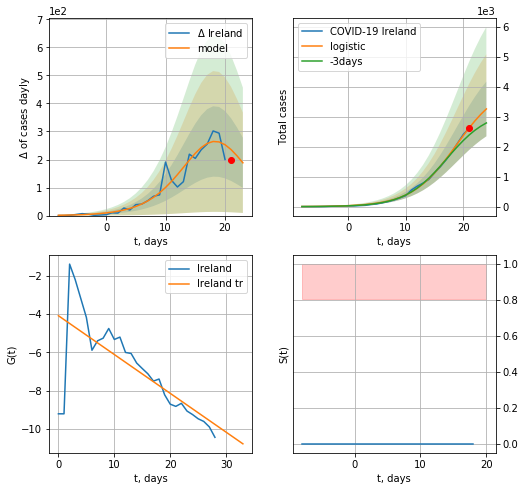

Ireland data at: 2020-07-01
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +3 days
	 deltaDaycases:  188
	 total cases:  3265 ± 913
	 total death:  222 ± 186
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


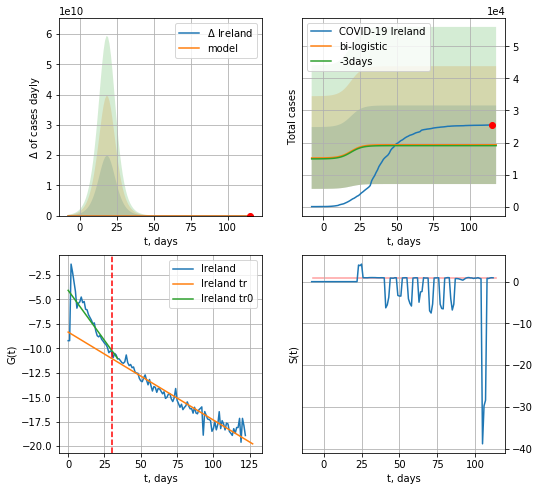

Ireland data at: 2020-07-01
+3 day model MAPE: 0.014995387506155061
model: bi-logistic
coeffs:  [ 1.21411907e+04 -1.02760330e+01  2.59167279e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.63502960937951
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  19303 ± 12258
	 total death:  1316 ± 2507
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.940374
 intercept: -8.334901
 slope: -0.089920


In [253]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,14*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


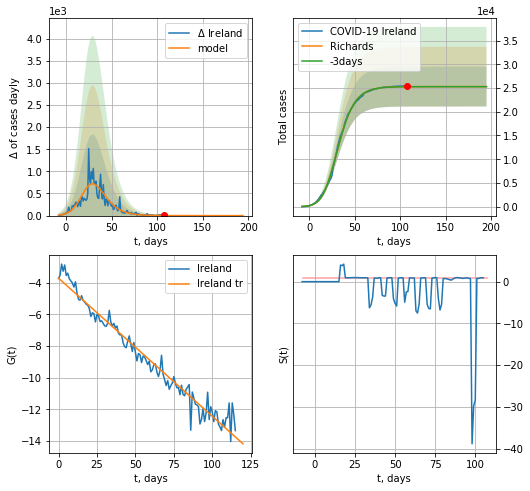

Ireland data at: 2020-07-01
+3 day model MAPE: 0.000743
model: Richards
coeffs: [2.53004828e+04 2.07859302e-01 2.12840892e+01 4.52744344e-01]
rational stdev: 0.165622
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 25300 ± 4190
	 total death: 1725 ± 857
trend coefficient of determination: 0.964259
 intercept: -3.710550
 slope: -0.087308


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


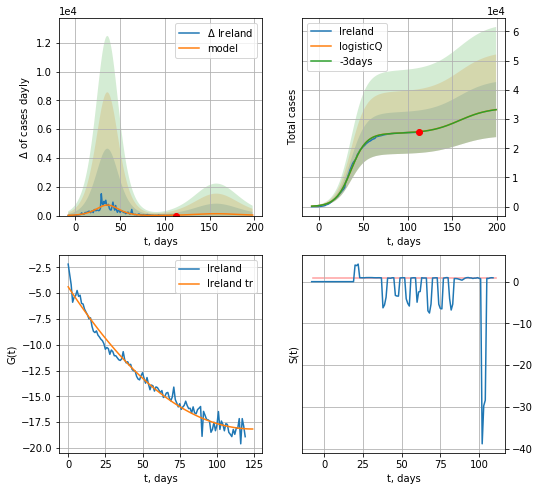

Ireland data at: 2020-07-01
+3 day model MAPE: 0.001156
model: logisticQ
coeffs: [ 2.50766754e+04  7.34764603e-07  3.62160482e+01 -1.59075771e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.284048
forecast at the end of period: +87 days
	 deltaDaycases: 40
	 total cases: 33232 ± 9439
	 total death: 2267 ± 1931
trend coefficient of determination: 0.978686
 intercept_: -4.394804745024972
 coeffs_: [ 0.         -0.22145444  0.00089063]


In [254]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
116 2020-06-27  267766   34364  5347.0
117 2020-06-28  271982   34263  5509.0
118 2020-06-29  275999   34270  5575.0
119 2020-06-30  279393   32476  5688.0
120 2020-07-01  282043   30847  5753.0


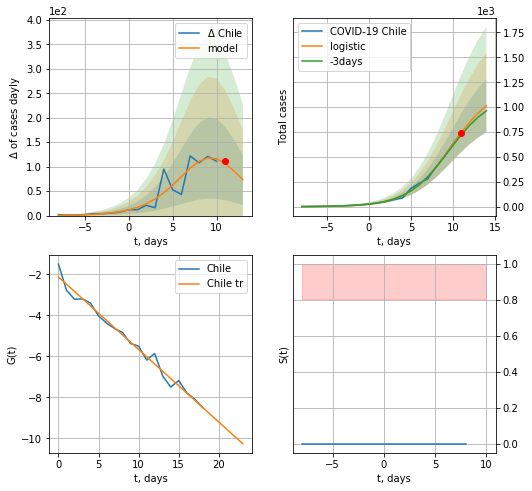

Chile data at: 2020-07-01
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +3 days
	 deltaDaycases:  73
	 total cases:  1012 ± 264
	 total death:  20 ± 15
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


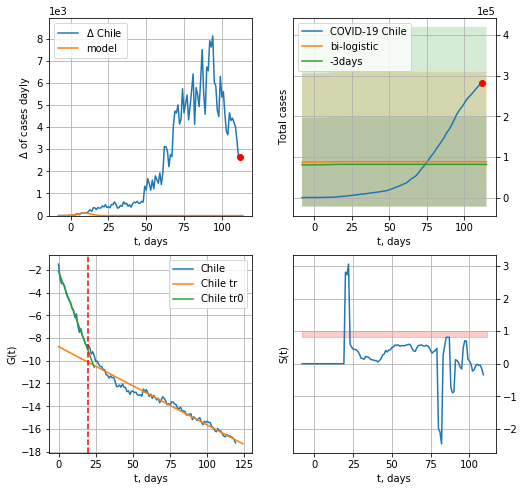

Chile data at: 2020-07-01
+3 day model MAPE: 0.08098915546129568
model: bi-logistic
coeffs:  [ 6.96977465e+04 -1.55540457e+01  3.83360797e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2530988531285467
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  88329 ± 110685
	 total death:  1801 ± 6770
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.958871
 intercept: -8.761557
 slope: -0.068888


In [255]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*14-dT)
xx = forecast2('Chile',dfCL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


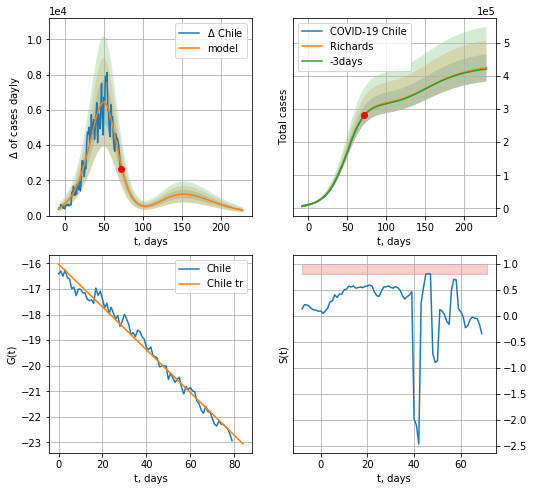

Chile data at: 2020-07-01
+3 day model MAPE: 0.003902
model: Richards
coeffs: [3.18793856e+05 6.30972194e-02 5.43790471e+01 1.45559553e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.097276
forecast at the end of period: +157 days
	 deltaDaycases: 302
	 total cases: 424283 ± 41272
	 total death: 8654 ± 2525
trend coefficient of determination: 0.984671
 intercept: -16.029438
 slope: -0.083636


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


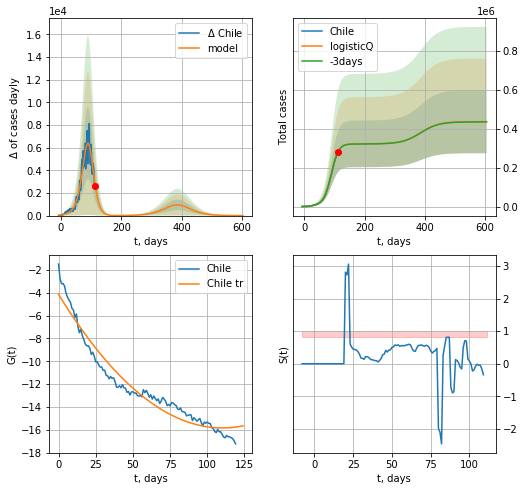

Chile data at: 2020-07-01
+3 day model MAPE: 0.001338
model: logisticQ
coeffs: [ 3.21745147e+05  1.89127197e-04  8.85242983e+01 -3.29461562e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371597
forecast at the end of period: +493 days
	 deltaDaycases: 2
	 total cases: 435636 ± 161880
	 total death: 8885 ± 9904
trend coefficient of determination: 0.947456
 intercept_: -4.147930680113296
 coeffs_: [ 0.         -0.21214434  0.00096324]


In [256]:
vL = 20+10
x = forecastRR('Chile',dfCL[40:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

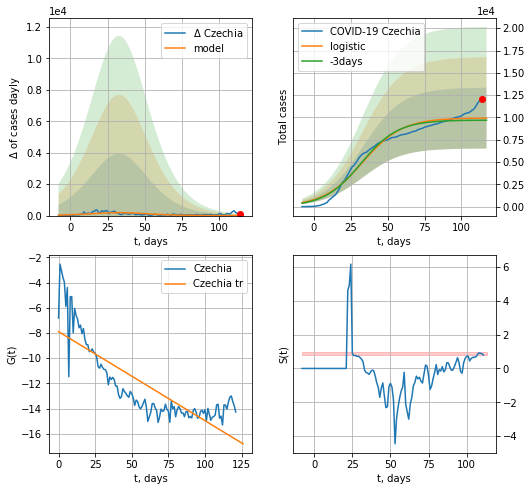

Czechia data at: 2020-07-01
+3 day model MAPE: 0.024151540254412997
model: logistic
coeffs:  [9.94230834e+03 7.45692287e-02 3.30851677e+01]
rational stdev:  0.3433944136391025
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  9923 ± 3407
	 total death:  287 ± 295
trend coefficient of determination: 0.668381
 intercept: -7.894278
 slope: -0.070699


In [257]:
x = forecast('Czechia',dfCH[:],d1,14*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


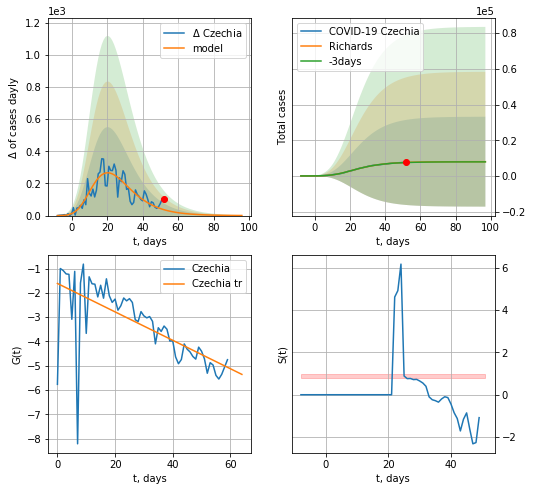

Czechia data at: 2020-07-01
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 7982 ± 25173
	 total death: 231 ± 2185
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


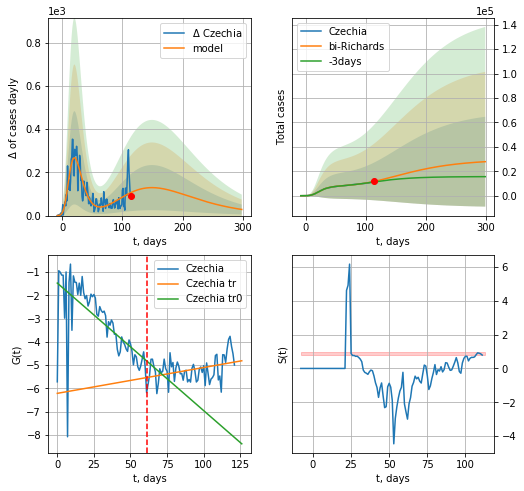

Czechia data at: 2020-07-01
+3 day model MAPE: 0.036216
model: bi-Richards
coeffs: [ 2.16883291e+04  1.21095297e+00 -1.13981111e+02  1.34940810e-02]
rational stdev: 1.320325
forecast at the end of period: +185 days
	 deltaDaycases: 28
	 total cases: 27873 ± 36801
	 total death: 807 ± 3196
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.424049
 intercept: -1.474946
 slope: -0.054871
trend coefficient of determination: 0.134294
 intercept: -6.218106
 slope: 0.011117


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


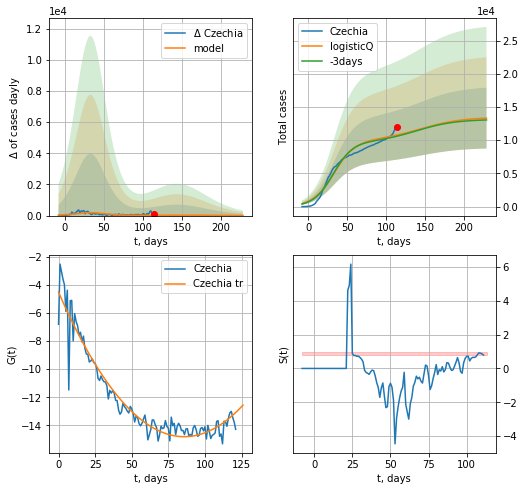

Czechia data at: 2020-07-01
+3 day model MAPE: 0.016538
model: logisticQ
coeffs: [ 9.94240755e+03  1.02867000e-07  3.30870257e+01 -7.24614329e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343429
forecast at the end of period: +115 days
	 deltaDaycases: 5
	 total cases: 13323 ± 4575
	 total death: 386 ± 397
trend coefficient of determination: 0.925953
 intercept_: -4.5226547078996155
 coeffs_: [ 0.         -0.23928366  0.00139327]


In [259]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

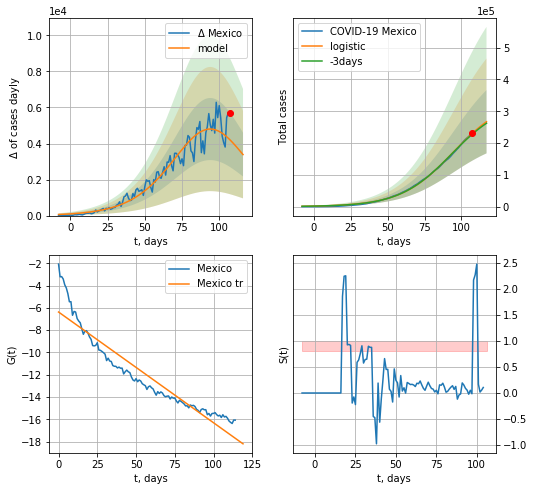

Mexico data at: 2020-07-01
+3 day model MAPE: 0.011708711206982435
model: logistic
coeffs:  [3.39352975e+05 5.63491074e-02 9.42806699e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37249203751817206
forecast at the end of period: +10 days
	 deltaDaycases:  3386
	 total cases:  267017 ± 99461
	 total death:  32845 ± 36703
trend coefficient of determination: 0.890614
 intercept: -6.373298
 slope: -0.099269


In [260]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


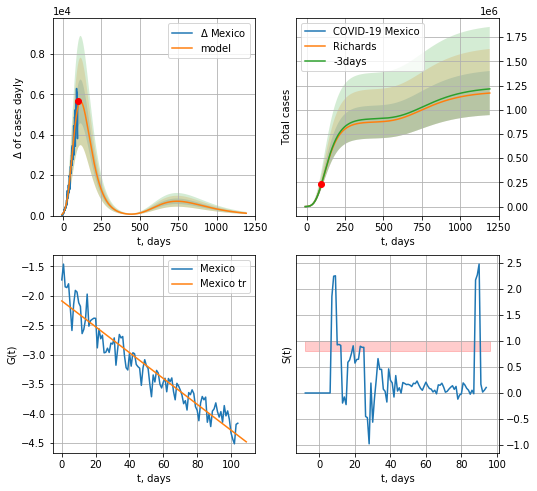

Mexico data at: 2020-07-01
+3 day model MAPE: 0.003459
model: Richards
coeffs: [ 8.75528543e+05  4.83073763e-01 -7.04755359e+01  3.69649572e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.194165
forecast at the end of period: +1095 days
	 deltaDaycases: 116
	 total cases: 1173167 ± 227788
	 total death: 144311 ± 84060
trend coefficient of determination: 0.914990
 intercept: -2.085960
 slope: -0.021977


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


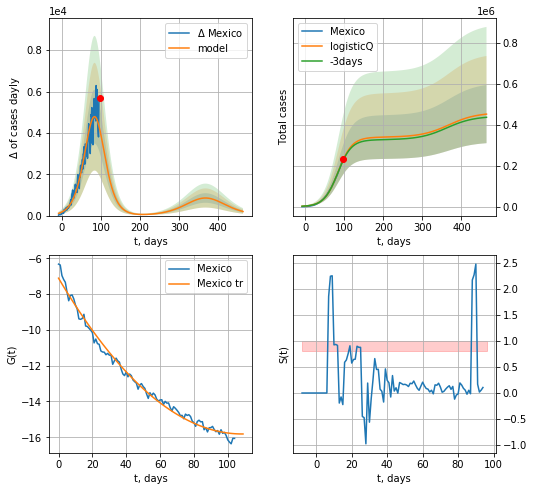

Mexico data at: 2020-07-01
+3 day model MAPE: 0.011743
model: logisticQ
coeffs: [ 3.39769844e+05  1.21234403e-06  8.43298252e+01 -4.63597028e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314268
forecast at the end of period: +367 days
	 deltaDaycases: 198
	 total cases: 452728 ± 142278
	 total death: 55690 ± 52504
trend coefficient of determination: 0.989785
 intercept_: -7.108897046089046
 coeffs_: [ 0.         -0.1604573   0.00073935]


In [261]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
110 2020-06-27  1815.0     224   78.0  416739.0
111 2020-06-28  1816.0     216   78.0  418368.0
112 2020-06-29  1817.0     224   78.0  422840.0
113 2020-06-30  1818.0     206   78.0  428238.0
114 2020-07-01  1818.0     216   78.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


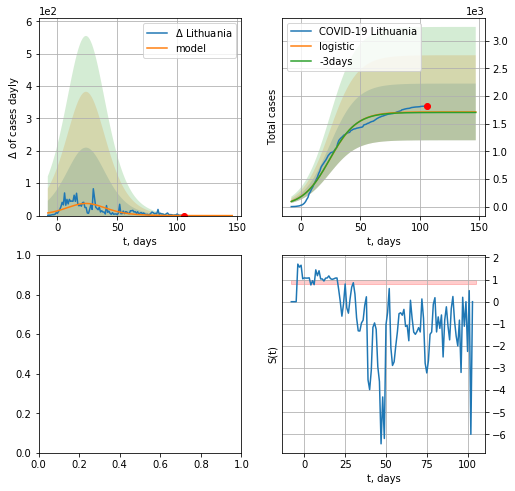

In [262]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [353]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [354]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


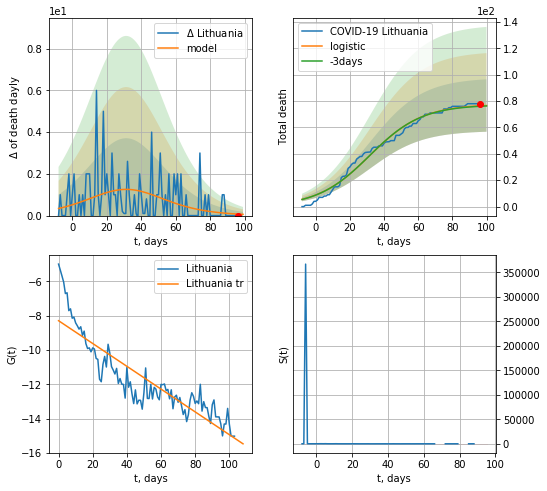

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.004172429463678193
model: logistic
coeffs:  [7.75268559e+01 6.48190938e-02 3.17027915e+01]
rational stdev:  0.2592381252515281
forecast at the end of period: +4 days
	 total death:  76 ± 19
trend coefficient of determination: 0.789249
 intercept: -8.294693
 slope: -0.066310


In [52]:
x = forecast('Lithuania',dfLT[9:],d1,7*14-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


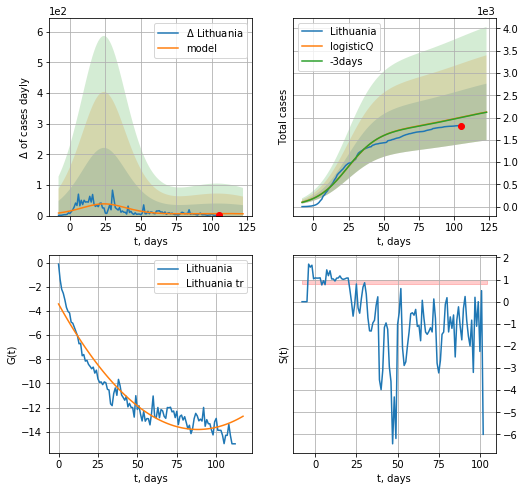

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.002475
model: logisticQ
coeffs: [ 1.71015684e+03  1.67524265e-07  2.42895480e+01 -5.25352310e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300159
forecast at the end of period: +18 days
	 deltaDaycases: 5
	 total cases: 2122 ± 637
	 total death: 91 ± 81
trend coefficient of determination: 0.909796
 intercept_: -3.4126371277975895
 coeffs_: [ 0.         -0.23570013  0.00133429]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


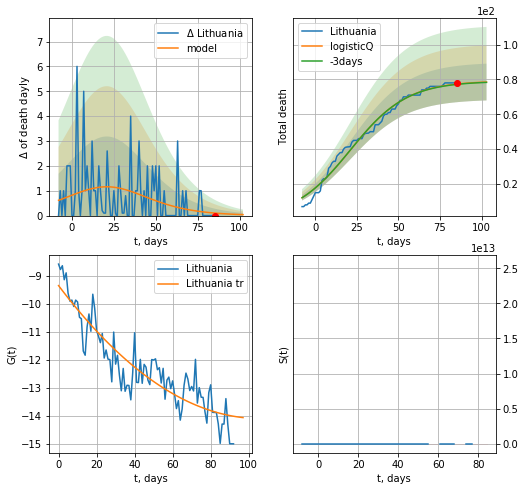

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.002180
model: logisticQ
coeffs: [ 7.91451272e+01  3.72076089e-07  2.11790058e+01 -1.57362507e+05]
rational stdev: 0.134397
forecast at the end of period: +18 days
	 total death: 78 ± 10
trend coefficient of determination: 0.823542
 intercept_: -9.35767919249015
 coeffs_: [ 0.         -0.08975288  0.00042405]


In [53]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


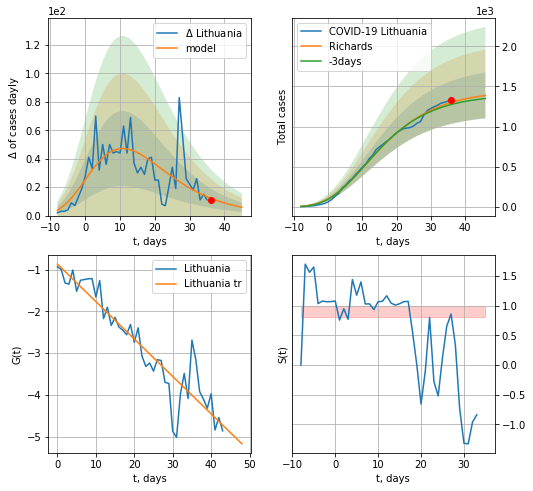

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +10 days
	 deltaDaycases: 5
	 total cases: 1387 ± 284
	 total death: 59 ± 36
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


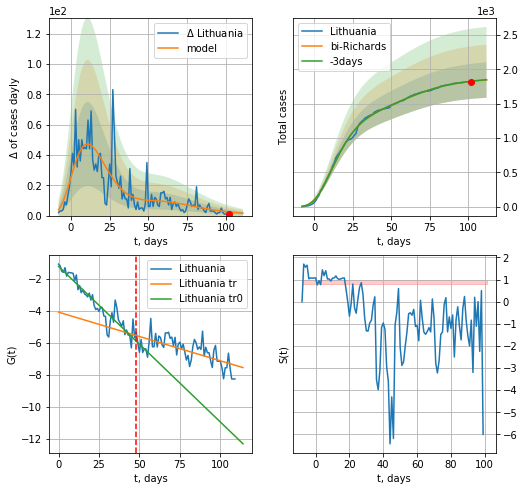

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.001851
model: bi-Richards
coeffs: [4.21516096e+02 5.35985899e-01 1.86269747e+01 9.85227457e-02]
rational stdev: 0.139754
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 1843 ± 257
	 total death: 79 ± 33
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.887611
 intercept: -1.215826
 slope: -0.097150
trend coefficient of determination: 0.452150
 intercept: -4.074600
 slope: -0.030349


In [54]:
vL = 48+3
x = forecastRR('Lithuania',dfLT[3:vL-3],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-3)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


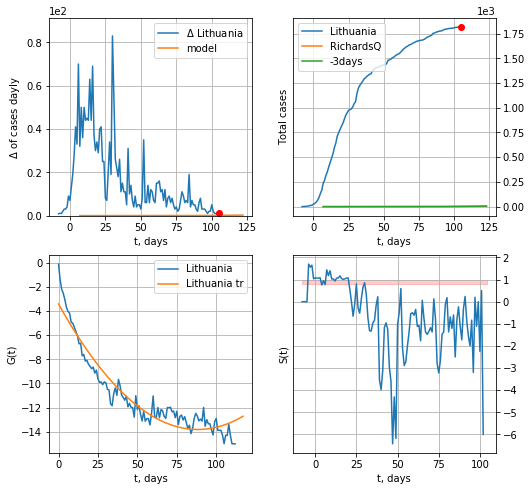

Lithuania data at: 2020-06-30
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 4.54139979e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +18 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [55]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
112 2020-06-27  4217.0     129  110.0
113 2020-06-28  4242.0     154  110.0
114 2020-06-29  4256.0     149  110.0
115 2020-06-30  4299.0     191  110.0
116 2020-07-01  4345.0     232  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


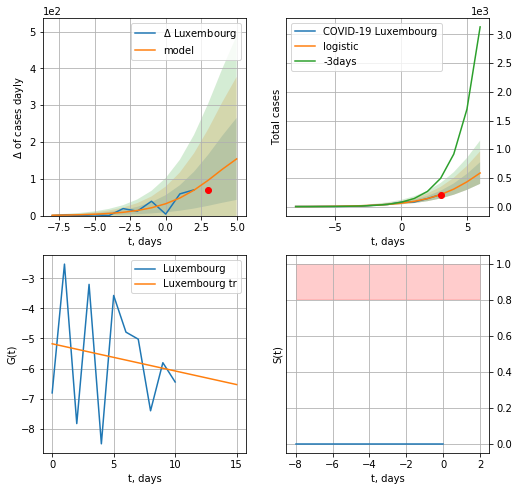

Luxembourg data at: 2020-07-01
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +3 days
	 deltaDaycases:  154
	 total cases:  585 ± 188
	 total death:  14 ± 13
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


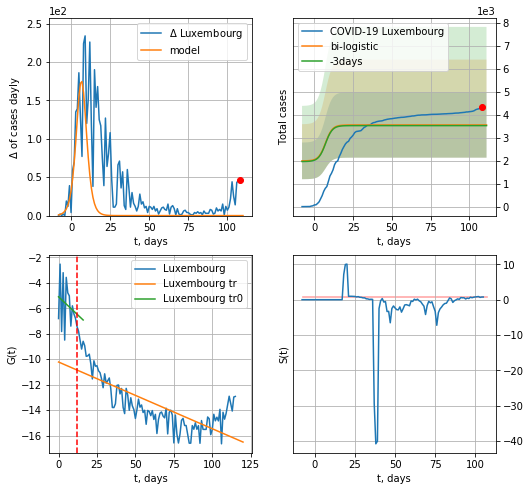

Luxembourg data at: 2020-07-01
+3 day model MAPE: 0.008118920652645044
model: bi-logistic
coeffs:  [1770.12023372   -6.75938166  248.28591277] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4000182149124925
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3554 ± 1421
	 total death:  89 ± 106
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.570705
 intercept: -10.221442
 slope: -0.052405


In [263]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,14*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,14*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


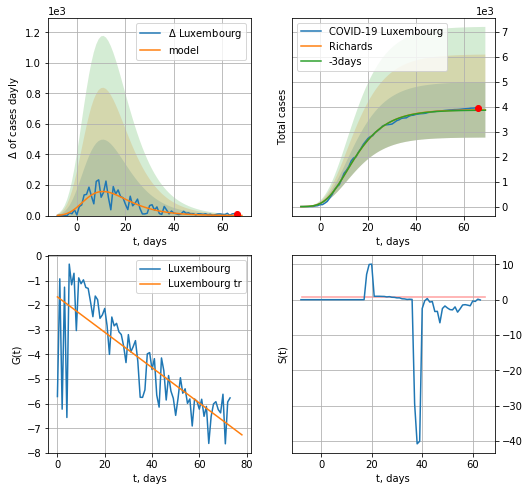

Luxembourg data at: 2020-07-01
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 3875 ± 1108
	 total death: 98 ± 84
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


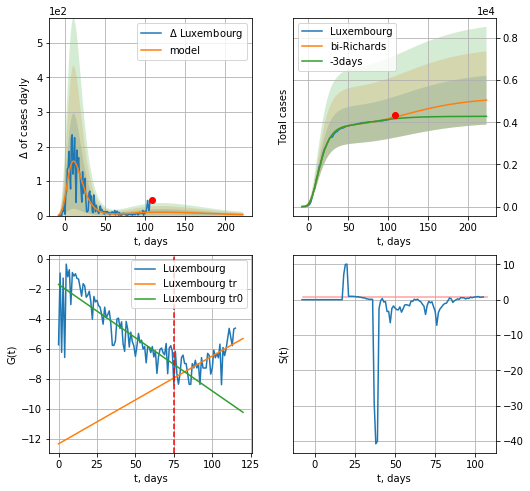

Luxembourg data at: 2020-07-01
+3 day model MAPE: 0.018698
model: bi-Richards
coeffs: [ 1.32037662e+03  2.76017212e+00 -1.14878407e+02  7.52169071e-03]
rational stdev: 0.229241
forecast at the end of period: +115 days
	 deltaDaycases: 2
	 total cases: 5053 ± 1158
	 total death: 127 ± 87
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.630030
 intercept: -1.694960
 slope: -0.071093
trend coefficient of determination: 0.450179
 intercept: -12.328848
 slope: 0.058575


In [267]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


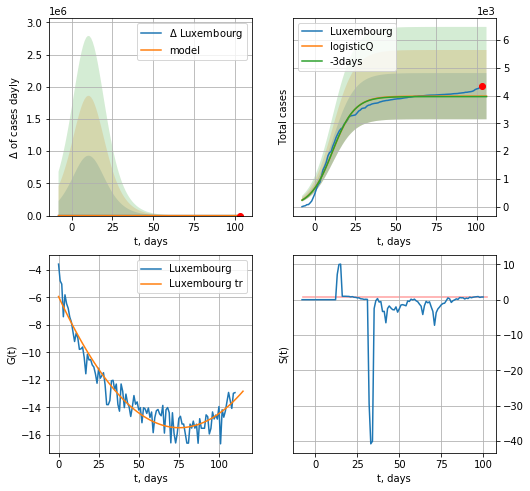

Luxembourg data at: 2020-07-01
+3 day model MAPE: 0.004053
model: logisticQ
coeffs: [ 3.97970241e+03  3.75156785e-07  1.08522590e+01 -3.86494733e+05]
rational stdev: 0.208730
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 3979 ± 830
	 total death: 100 ± 62
trend coefficient of determination: 0.920292
 intercept_: -5.929762787821279
 coeffs_: [ 0.         -0.25359644  0.00168427]


In [268]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
119 2020-06-27  54574.0  23230.0  4424.0
120 2020-06-28  55255.0  23768.0  4429.0
121 2020-06-29  55665.0  23733.0  4502.0
122 2020-06-30  56432.0  24311.0  4527.0
123 2020-07-01  58257.0  25794.0  4576.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


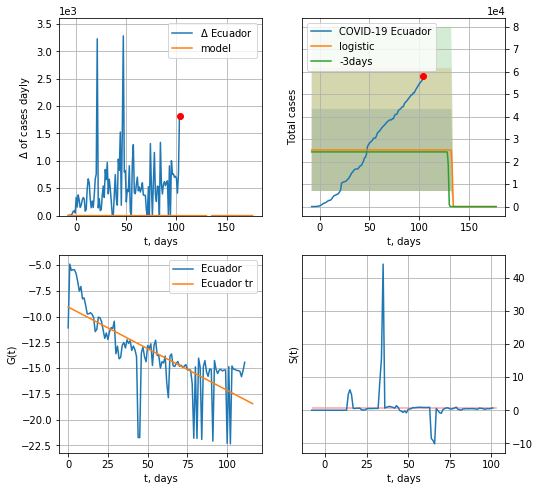

Ecuador data at: 2020-07-01
+3 day model MAPE: 0.035468898592035426
model: logistic
coeffs:  [ 2.51707528e+04 -4.60616627e+00  1.33134449e+02]
rational stdev:  0.7244656168194229
forecast at the end of period: +73 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.546937
 intercept: -9.066202
 slope: -0.080980


In [269]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


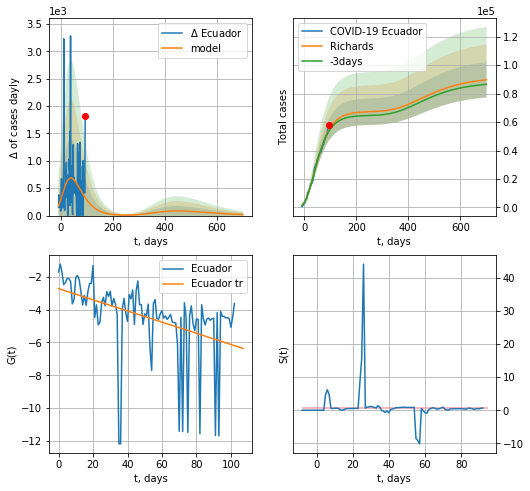

Ecuador data at: 2020-07-01
+3 day model MAPE: 0.016447
model: Richards
coeffs: [ 6.74339133e+04  1.82967913e+00 -1.10342836e+02  1.52308720e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.137923
forecast at the end of period: +605 days
	 deltaDaycases: 19
	 total cases: 89757 ± 12379
	 total death: 7050 ± 2917
trend coefficient of determination: 0.185627
 intercept: -2.722332
 slope: -0.034011


In [270]:
x = forecastRR("Ecuador",dfED[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


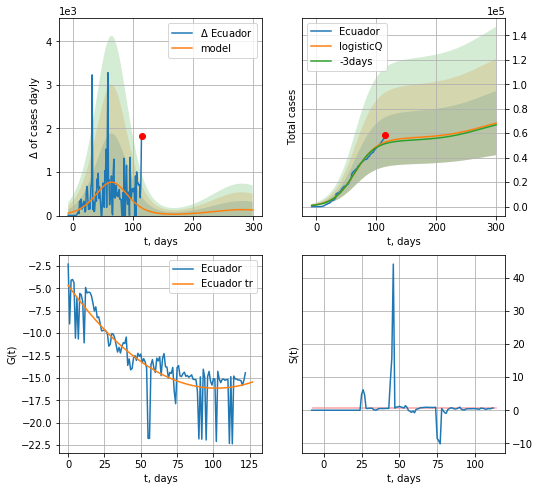

Ecuador data at: 2020-07-01
+3 day model MAPE: 0.025411
model: logisticQ
coeffs: [ 5.59089461e+04  2.24929732e-07  6.46039843e+01 -2.43589750e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383829
forecast at the end of period: +185 days
	 deltaDaycases: 128
	 total cases: 68270 ± 26204
	 total death: 5362 ± 6174
trend coefficient of determination: 0.722902
 intercept_: -4.68544272654408
 coeffs_: [ 0.         -0.22480483  0.00110227]


In [271]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
123 2020-06-27  7198.0     270  328.0
124 2020-06-28  7209.0     281  328.0
125 2020-06-29  7214.0     286  328.0
126 2020-06-30  7236.0     308  328.0
127 2020-07-01  7236.0     208  328.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


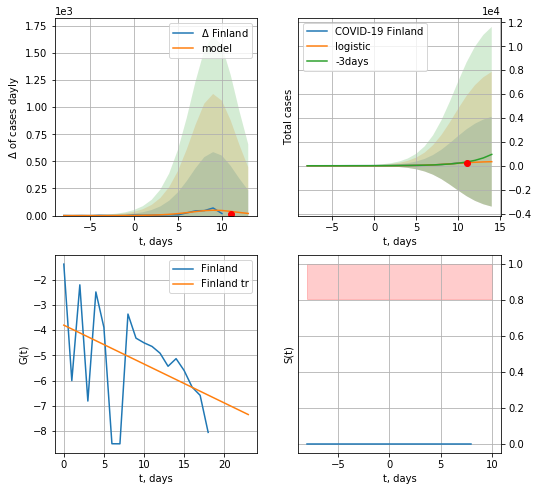

Finland data at: 2020-07-01
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +3 days
	 deltaDaycases:  19
	 total cases:  340 ± 3759
	 total death:  15 ± 496
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

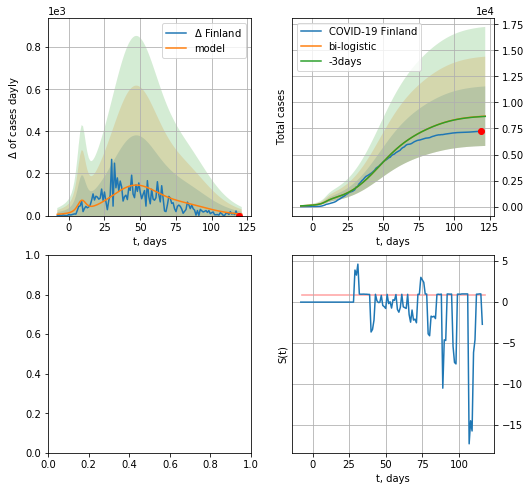

In [272]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*14-dT)
xx = forecast2("Finland",dfFI[:],d1,14*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


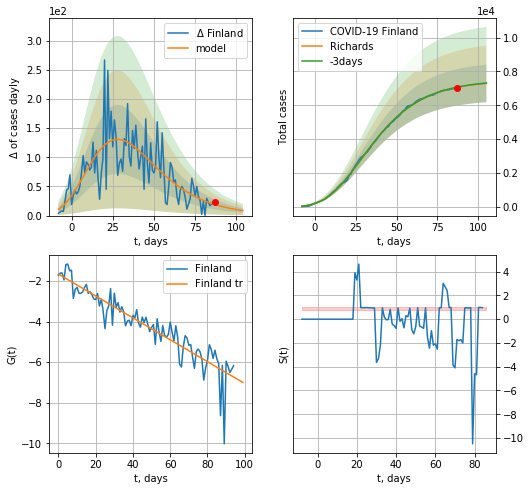

Finland data at: 2020-06-30
+3 day model MAPE: 0.001718
model: Richards
coeffs: [ 7.46745345e+03  8.75042301e-01 -3.06186517e+01  5.59118542e-02]
rational stdev: 0.152333
forecast at the end of period: +18 days
	 deltaDaycases: 8
	 total cases: 7294 ± 1111
	 total death: 331 ± 151
trend coefficient of determination: 0.846419
 intercept: -1.660591
 slope: -0.053972


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


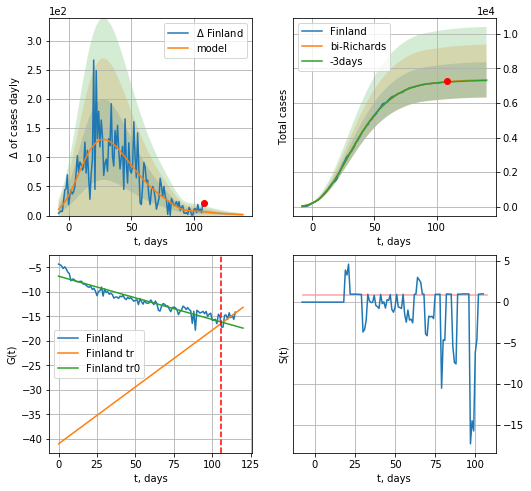

Finland data at: 2020-06-30
+3 day model MAPE: 0.002368
model: bi-Richards
coeffs: [-103.24493268    0.22158911   90.88195707    0.93750706]
rational stdev: 0.138829
forecast at the end of period: +32 days
	 deltaDaycases: 1
	 total cases: 7332 ± 1017
	 total death: 333 ± 138
bi-Richards approximation splitting point: 106
trend coefficient of determination: 0.895067
 intercept: -6.785438
 slope: -0.088440
trend coefficient of determination: 0.420252
 intercept: -41.033820
 slope: 0.232379


In [65]:
vL = 106 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


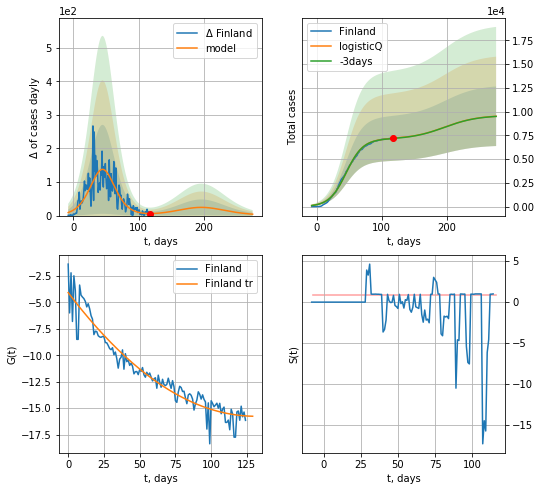

Finland data at: 2020-06-29
+3 day model MAPE: 0.002088
model: logisticQ
coeffs: [ 7.10556564e+03  3.59952576e-07  4.51398566e+01 -2.14989973e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329573
forecast at the end of period: +159 days
	 deltaDaycases: 4
	 total cases: 9512 ± 3134
	 total death: 432 ± 427
trend coefficient of determination: 0.923375
 intercept_: -4.079670330781514
 coeffs_: [ 0.         -0.17858209  0.00068198]


In [370]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
109 2020-06-27   4625  1934.0  216.0
110 2020-06-28   4691  1964.0  219.0
111 2020-06-29   4831  2026.0  223.0
112 2020-06-30   4989  2083.0  230.0
113 2020-07-01   5154  2200.0  232.0


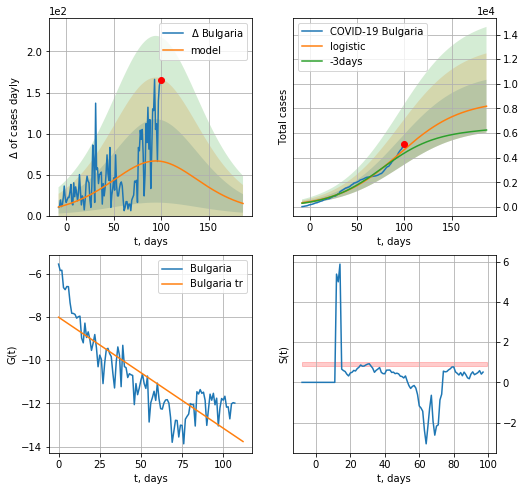

Bulgaria data at: 2020-07-01
+3 day model MAPE: 0.07080184816450784
model: logistic
coeffs:  [8.63680452e+03 3.08198038e-02 9.47173524e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.26182298558894923
forecast at the end of period: +87 days
	 deltaDaycases:  14
	 total cases:  8186 ± 2143
	 total death:  368 ± 289
trend coefficient of determination: 0.717362
 intercept: -8.016334
 slope: -0.051332


In [273]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


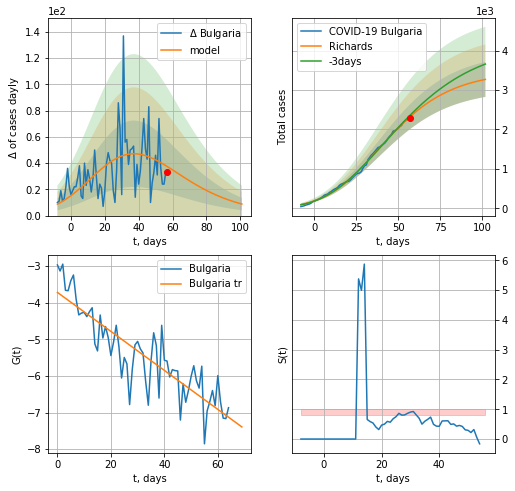

Bulgaria data at: 2020-07-01
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +45 days
	 deltaDaycases: 8
	 total cases: 3267 ± 443
	 total death: 147 ± 59
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


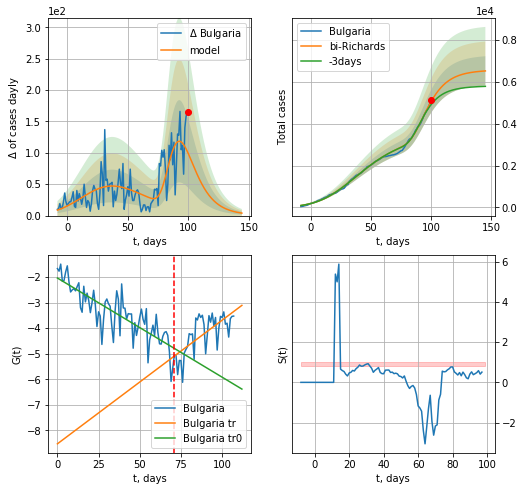

Bulgaria data at: 2020-07-01
+3 day model MAPE: 0.034667
model: bi-Richards
coeffs: [3.11220060e+03 9.49402004e+00 4.38806749e+01 9.83478537e-03]
rational stdev: 0.107480
forecast at the end of period: +45 days
	 deltaDaycases: 3
	 total cases: 6529 ± 701
	 total death: 293 ± 94
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.673117
 intercept: -2.037551
 slope: -0.038778
trend coefficient of determination: 0.482379
 intercept: -8.522129
 slope: 0.048351


In [274]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,20*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


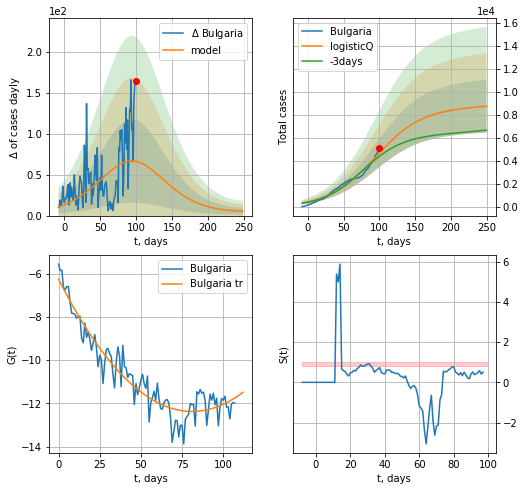

Bulgaria data at: 2020-07-01
+3 day model MAPE: 0.068176
model: logisticQ
coeffs: [ 8.61827624e+03  3.51755505e-07  9.45792036e+01 -8.76470157e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261847
forecast at the end of period: +150 days
	 deltaDaycases: 5
	 total cases: 8776 ± 2298
	 total death: 395 ± 310
trend coefficient of determination: 0.900469
 intercept_: -6.258425491477075
 coeffs_: [ 0.         -0.15083931  0.00092999]


In [275]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
121 2020-06-27  3162.2    51.0   58.0
122 2020-06-28  3169.0    58.0   58.0
123 2020-06-29  3171.0    57.0   58.0
124 2020-06-30  3173.0    56.0   58.0
125 2020-07-01  3179.0    62.0   58.0


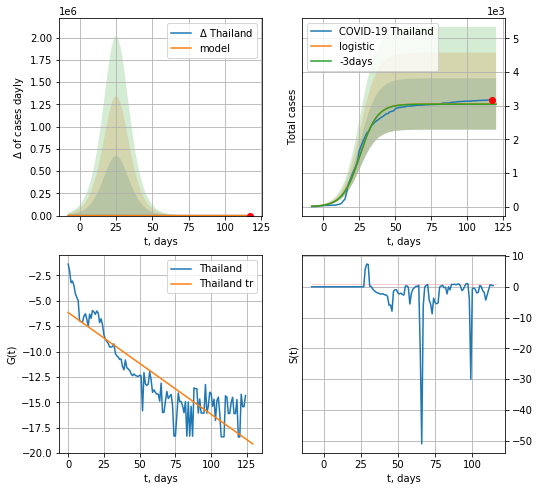

Thailand data at: 2020-07-01
+3 day model MAPE: 0.0018938765118706158
model: logistic
coeffs:  [3.05192521e+03 1.66833904e-01 2.55208810e+01]
rational stdev:  0.25020686599003256
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3051 ± 763
	 total death:  55 ± 41
trend coefficient of determination: 0.775548
 intercept: -6.158832
 slope: -0.100268


In [276]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [277]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


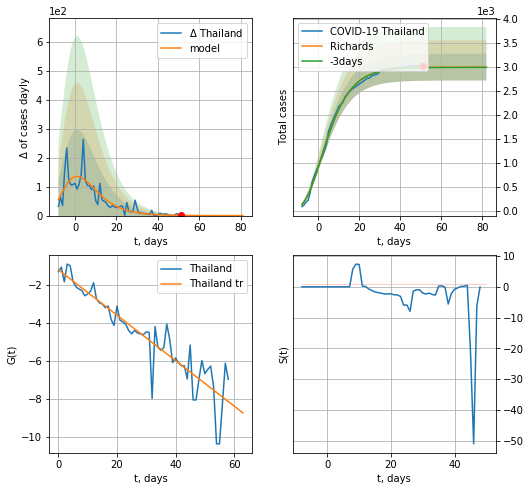

Thailand data at: 2020-07-01
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 54 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


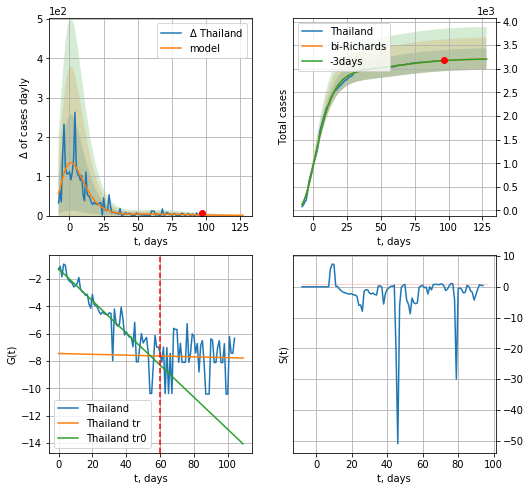

Thailand data at: 2020-07-01
+3 day model MAPE: 0.000239
model: bi-Richards
coeffs: [ 2.22289851e+02  7.03794722e+00 -4.44141562e+01  6.57389576e-03]
rational stdev: 0.070638
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 3207 ± 226
	 total death: 58 ± 12
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843234
 intercept: -1.240796
 slope: -0.117521
trend coefficient of determination: 0.000706
 intercept: -7.442795
 slope: -0.003061


In [278]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


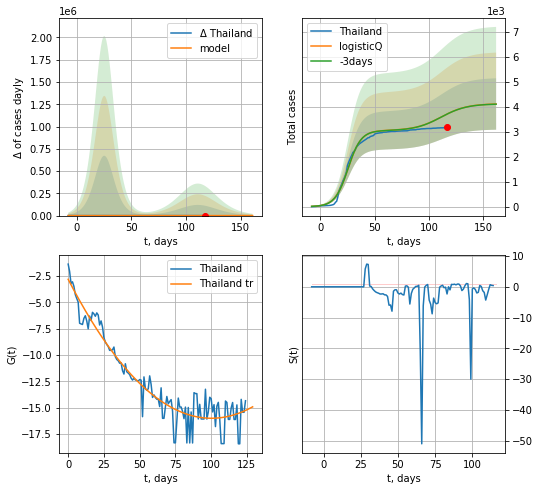

Thailand data at: 2020-07-01
+3 day model MAPE: 0.000711
model: logisticQ
coeffs: [ 3.05192755e+03  5.56628431e-07  2.55213841e+01 -2.99600139e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.250374
forecast at the end of period: +45 days
	 deltaDaycases: 1
	 total cases: 4117 ± 1030
	 total death: 75 ± 56
trend coefficient of determination: 0.913712
 intercept_: -2.825742805142829
 coeffs_: [ 0.         -0.26286133  0.00131125]


In [279]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

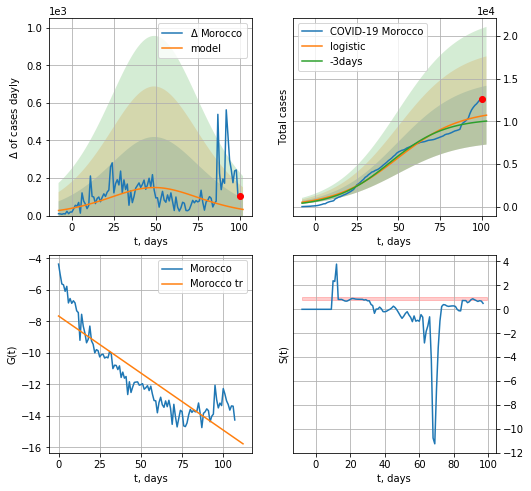

Morocco data at: 2020-07-01
+3 day model MAPE: 0.06614188988534964
model: logistic
coeffs:  [1.13742296e+04 5.25392896e-02 4.95145450e+01]
rational stdev:  0.32123675128533774
forecast at the end of period: +3 days
	 deltaDaycases:  32
	 total cases:  10728 ± 3446
	 total death:  193 ± 185
trend coefficient of determination: 0.779894
 intercept: -7.654827
 slope: -0.072429


In [280]:
x = forecast("Morocco",dfMR[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


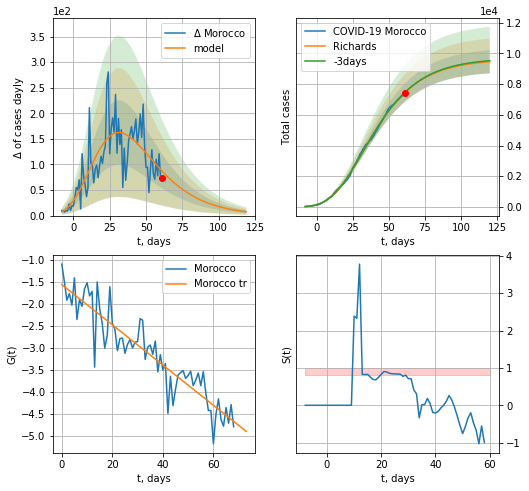

Morocco data at: 2020-07-01
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +59 days
	 deltaDaycases: 7
	 total cases: 9462 ± 756
	 total death: 170 ± 40
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


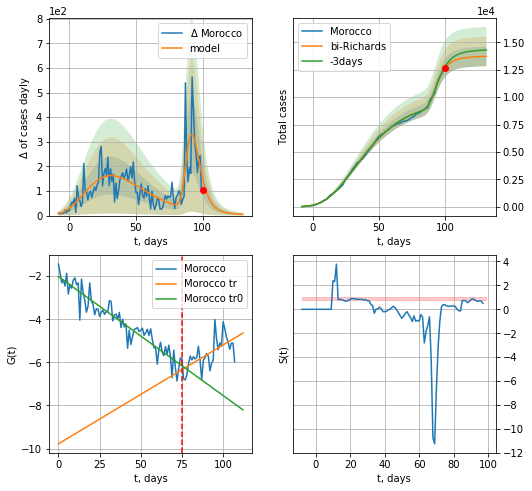

Morocco data at: 2020-07-01
+3 day model MAPE: 0.013979
model: bi-Richards
coeffs: [4.20371550e+03 1.70302038e+00 8.23616353e+01 1.23414082e-01]
rational stdev: 0.065099
forecast at the end of period: +31 days
	 deltaDaycases: 4
	 total cases: 13728 ± 893
	 total death: 247 ± 48
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.893289
 intercept: -2.016383
 slope: -0.055208
trend coefficient of determination: 0.403844
 intercept: -9.777771
 slope: 0.045865


In [281]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


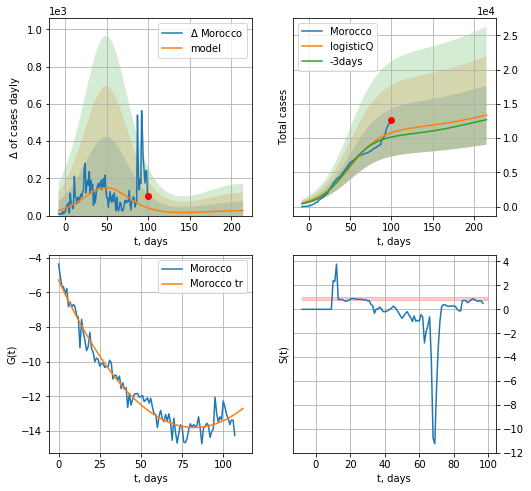

Morocco data at: 2020-07-01
+3 day model MAPE: 0.063213
model: logisticQ
coeffs: [ 1.13733352e+04  1.67664499e-07  4.95123477e+01 -3.13244097e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321293
forecast at the end of period: +115 days
	 deltaDaycases: 26
	 total cases: 13364 ± 4293
	 total death: 241 ± 232
trend coefficient of determination: 0.962024
 intercept_: -5.282317283436046
 coeffs_: [ 0.         -0.20672623  0.00125513]


In [282]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

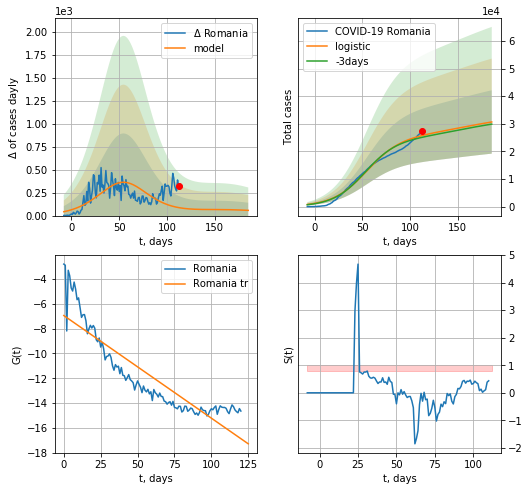

Romania data at: 2020-07-01
+3 day model MAPE: 0.026150371007216223
model: logistic
coeffs:  [2.49483130e+04 5.65729377e-02 5.44058108e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37433329313604635
forecast at the end of period: +73 days
	 deltaDaycases:  56
	 total cases:  30659 ± 11476
	 total death:  1872 ± 2102
trend coefficient of determination: 0.795424
 intercept: -6.946664
 slope: -0.082668


In [283]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


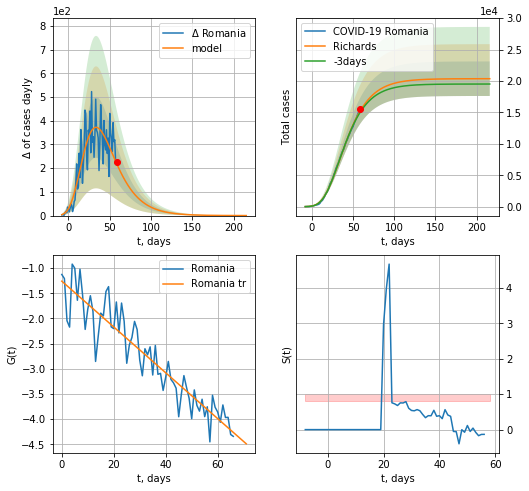

Romania data at: 2020-07-01
+3 day model MAPE: 0.015460
model: Richards
coeffs: [ 2.03688125e+04  4.42658382e+00 -5.58246363e+01  1.12883267e-02]
rational stdev: 0.134958
forecast at the end of period: +157 days
	 deltaDaycases: 0
	 total cases: 20366 ± 2748
	 total death: 1243 ± 503
trend coefficient of determination: 0.863843
 intercept: -1.259263
 slope: -0.045519


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


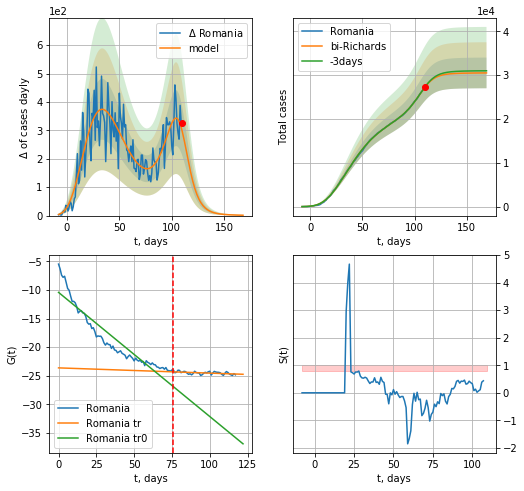

Romania data at: 2020-07-01
+3 day model MAPE: 0.002590
model: bi-Richards
coeffs: [1.01648992e+04 8.05249303e-02 1.09388334e+02 1.99654842e+00]
rational stdev: 0.114676
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 30509 ± 3498
	 total death: 1863 ± 640
bi-Richards approximation splitting point: 76
trend coefficient of determination: 0.880586
 intercept: -10.426206
 slope: -0.216750
trend coefficient of determination: 0.195814
 intercept: -23.608756
 slope: -0.009149


In [284]:
vL = 76+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


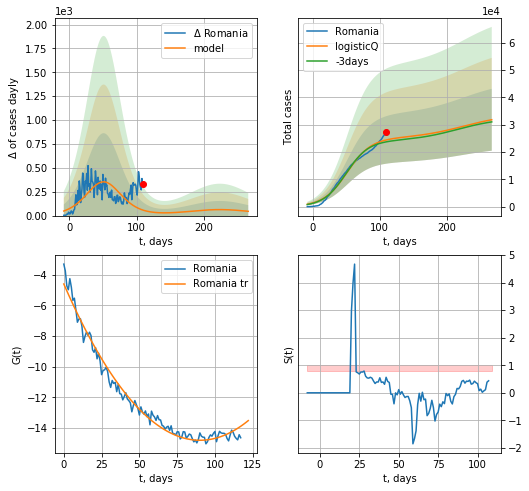

Romania data at: 2020-07-01
+3 day model MAPE: 0.030005
model: logisticQ
coeffs: [ 2.49897147e+04  1.33557697e-07  5.14834495e+01 -4.21320946e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356333
forecast at the end of period: +157 days
	 deltaDaycases: 44
	 total cases: 31801 ± 11331
	 total death: 1942 ± 2075
trend coefficient of determination: 0.980825
 intercept_: -4.59740955339775
 coeffs_: [ 0.         -0.22669482  0.00125854]


In [285]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [286]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
140 2020-06-27  1273620  159002  132822.0
141 2020-06-28  1275943  159198  132888.0
142 2020-06-29  1282170  159958  133018.0
143 2020-06-30  1285880  158877  133191.0
144 2020-07-01  1290784  159938  133331.0


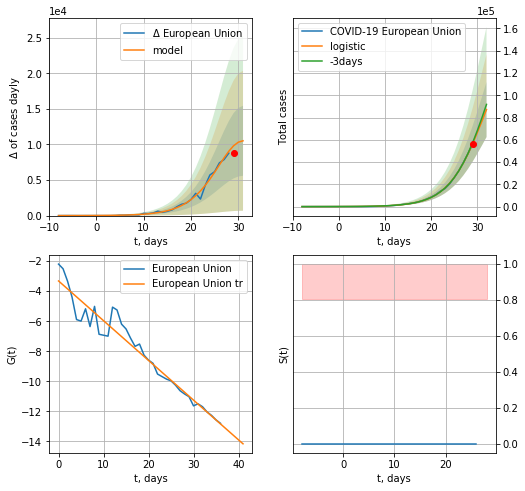

European Union data at: 2020-07-01
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +3 days
	 deltaDaycases:  10515
	 total cases:  87174 ± 24740
	 total death:  9004 ± 7666
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


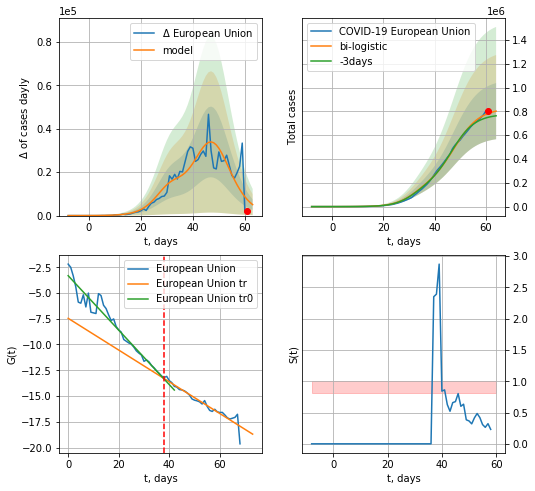

European Union data at: 2020-07-01
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +3 days
	 deltaDaycases:  5049
	 total cases:  801633 ± 235751
	 total death:  82804 ± 73055
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


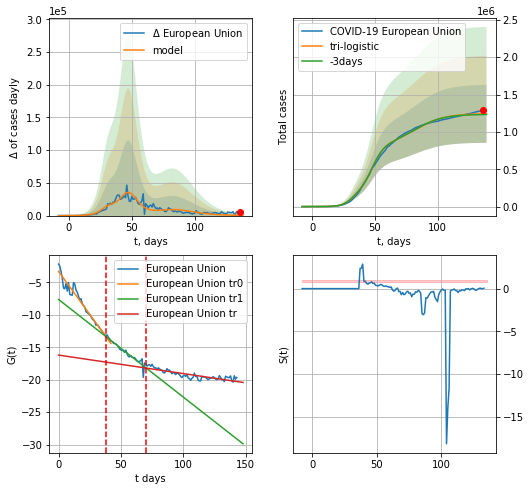

European Union data at: 2020-07-01
+3 day model MAPE: 0.007877058628248619
model: tri-logistic
coeffs:  [4.19760590e+05 8.76235486e-02 8.29653675e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.3121718894210459
forecast at the end of period: +3 days
	 deltaDaycases:  279
	 total cases:  1241908 ± 387688
	 total death:  128282 ± 120138
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.715527
 intercept: -16.209053
 slope: -0.028472


In [287]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,14*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,14*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


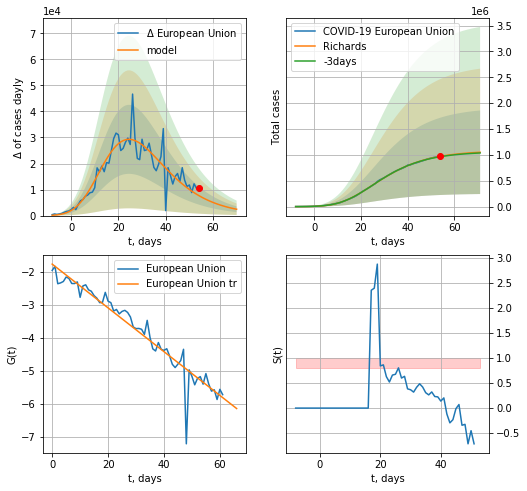

European Union data at: 2020-07-01
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +17 days
	 deltaDaycases: 2440
	 total cases: 1051236 ± 807960
	 total death: 108587 ± 250373
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


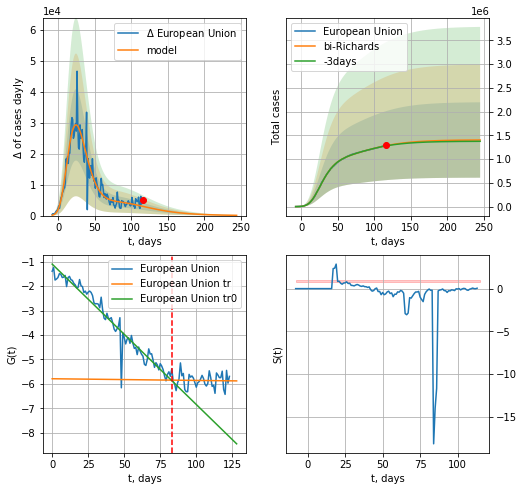

European Union data at: 2020-07-01
+3 day model MAPE: 0.003998
model: bi-Richards
coeffs: [ 3.22018008e+05  3.72826479e+00 -6.21358737e+01  8.33778186e-03]
rational stdev: 0.565806
forecast at the end of period: +129 days
	 deltaDaycases: 86
	 total cases: 1401631 ± 793051
	 total death: 144780 ± 245752
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943260
 intercept: -1.104207
 slope: -0.057350
trend coefficient of determination: 0.000770
 intercept: -5.786899
 slope: -0.000686


In [288]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


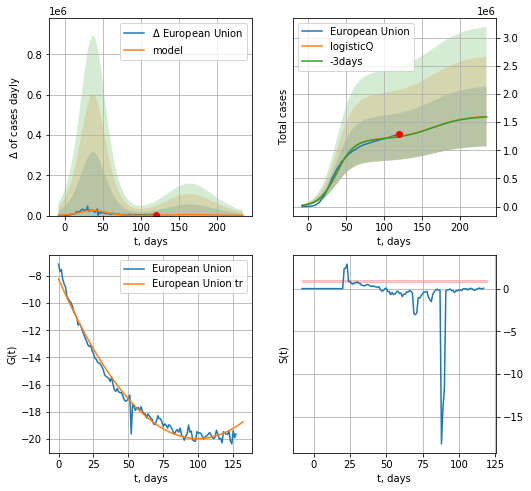

European Union data at: 2020-07-01
+3 day model MAPE: 0.005840
model: logisticQ
coeffs: [ 1.19600229e+06  2.08315060e-07  3.76800505e+01 -4.19800265e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331217
forecast at the end of period: +115 days
	 deltaDaycases: 774
	 total cases: 1601570 ± 530467
	 total death: 165433 ± 164382
trend coefficient of determination: 0.984248
 intercept_: -8.222212997950786
 coeffs_: [ 0.         -0.2360651   0.00118444]


In [289]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


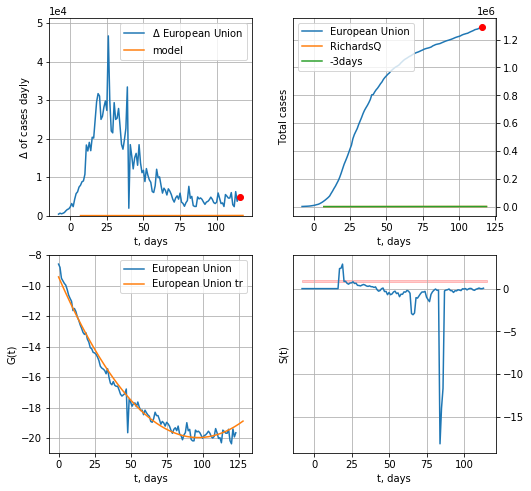

European Union data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.42779548e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: nan
forecast at the end of period: +3 days
	 deltaDaycases: 32


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [290]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [287]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [288]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [289]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [290]:
#dfIC[:]

IC
           date   cases  active  death
118 2020-06-27  1836.0      12   10.0
119 2020-06-28  1838.0      12   10.0
120 2020-06-29  1840.0      12   10.0
121 2020-06-30  1842.0      13   10.0
122 2020-07-01  1847.0      14   10.0


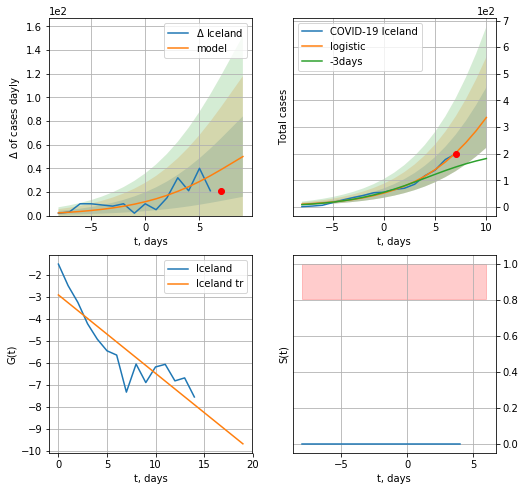

Iceland data at: 2020-07-01
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +3 days
	 deltaDaycases:  49
	 total cases:  335 ± 113
	 total death:  1 ± 1
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


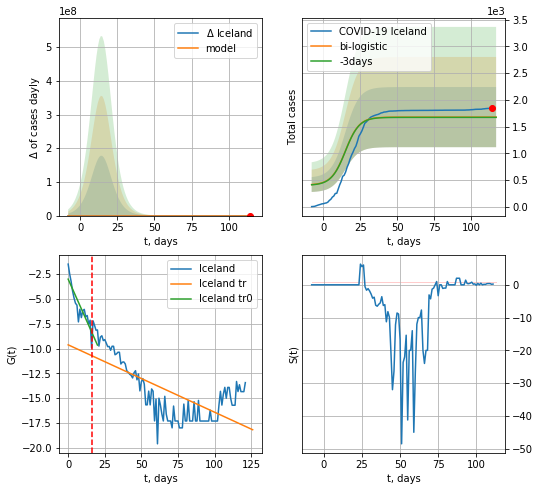

Iceland data at: 2020-07-01
+3 day model MAPE: 0.0030215350054368733
model: bi-logistic
coeffs:  [380.90286784 -44.33860071 186.9851401 ] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.33570162596271225
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1676 ± 562
	 total death:  9 ± 9
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.488019
 intercept: -9.629951
 slope: -0.067814


In [291]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


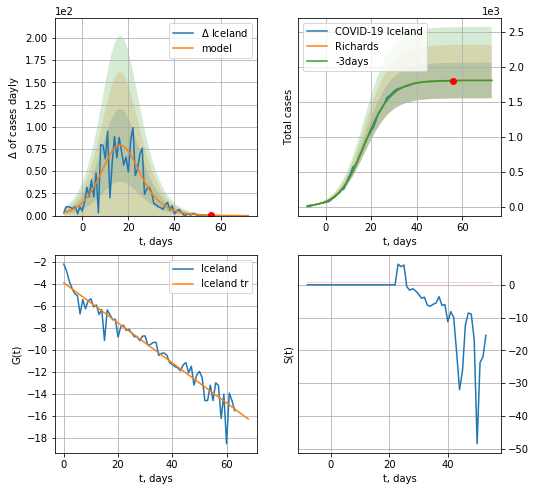

Iceland data at: 2020-07-01
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


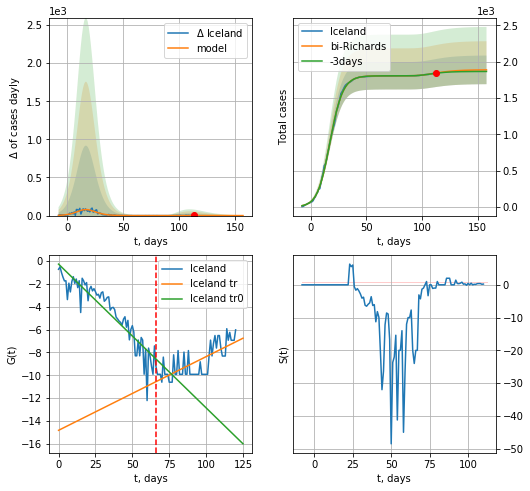

Iceland data at: 2020-07-01
+3 day model MAPE: 0.001681
model: bi-Richards
coeffs: [8.27794567e+01 5.72257329e+00 5.93689815e+01 1.46370853e-02]
rational stdev: 0.104573
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 1887 ± 197
	 total death: 10 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.838756
 intercept: -0.266135
 slope: -0.125824
trend coefficient of determination: 0.527362
 intercept: -14.812656
 slope: 0.064496


In [293]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


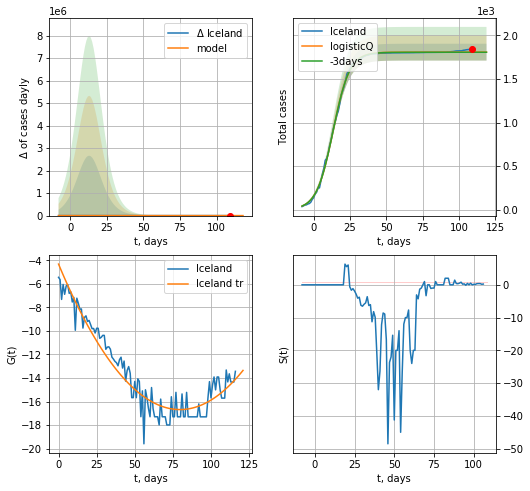

Iceland data at: 2020-07-01
+3 day model MAPE: 0.000783
model: logisticQ
coeffs: [ 1.80899905e+03  4.36971100e-06  1.33847447e+01 -4.02001507e+04]
rational stdev: 0.053381
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1808 ± 96
	 total death: 9 ± 1
trend coefficient of determination: 0.918024
 intercept_: -4.320490451573619
 coeffs_: [ 0.         -0.3103362   0.00194768]


In [294]:
x = forecastRRR("Iceland",dfIC[5:],d1,15*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
109 2020-06-27  30658  14696.0  592.0
110 2020-06-28  31686  15612.0  604.0
111 2020-06-29  32785  16570.0  620.0
112 2020-06-30  33550  17174.0  631.0
113 2020-07-01  34463  17873.0  645.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


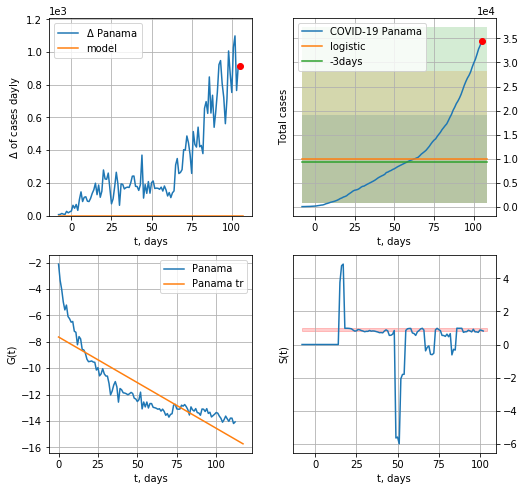

Panama data at: 2020-07-01
+3 day model MAPE: 0.06932033457958527
model: logistic
coeffs:  [ 9.88628074e+03 -8.02524863e+00  2.19055620e+02]
rational stdev:  0.9279424998300965
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9886 ± 9173
	 total death:  185 ± 515
trend coefficient of determination: 0.740336
 intercept: -7.631802
 slope: -0.069307


In [295]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


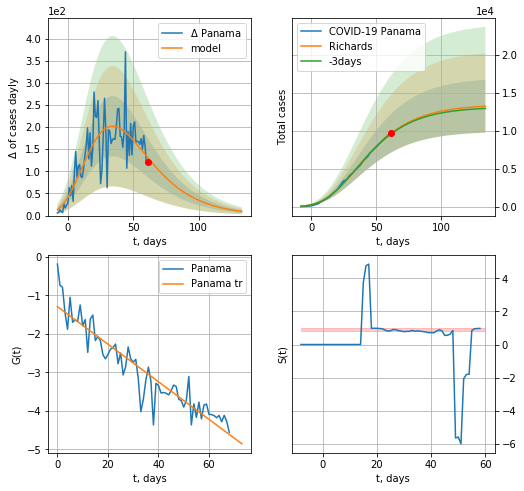

Panama data at: 2020-07-01
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +73 days
	 deltaDaycases: 9
	 total cases: 13262 ± 3489
	 total death: 248 ± 195
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


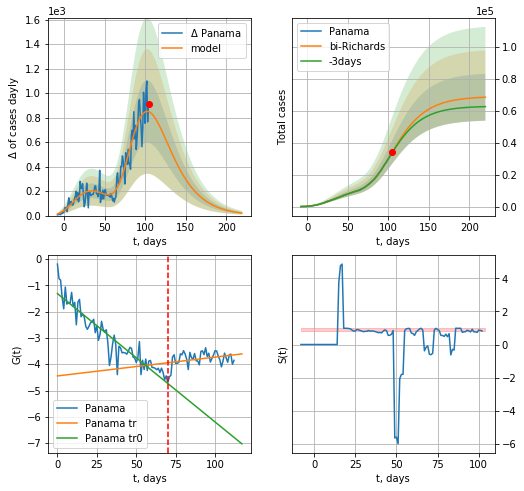

Panama data at: 2020-07-01
+3 day model MAPE: 0.012605
model: bi-Richards
coeffs: [5.54059788e+04 1.91980275e+00 9.08164104e+00 2.11773370e-02]
rational stdev: 0.214398
forecast at the end of period: +115 days
	 deltaDaycases: 20
	 total cases: 68396 ± 14664
	 total death: 1280 ± 823
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874804
 intercept: -1.315776
 slope: -0.048800
trend coefficient of determination: 0.104406
 intercept: -4.445388
 slope: 0.007149


In [296]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


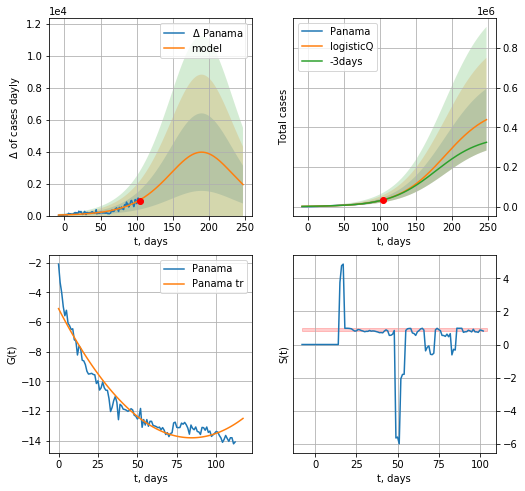

Panama data at: 2020-07-01
+3 day model MAPE: 0.008620
model: logisticQ
coeffs: [ 5.09500949e+05  2.76441274e-06  1.89848004e+02 -1.11013695e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355542
forecast at the end of period: +143 days
	 deltaDaycases: 1943
	 total cases: 438755 ± 155996
	 total death: 8211 ± 8758
trend coefficient of determination: 0.936703
 intercept_: -5.097107863536347
 coeffs_: [ 0.         -0.20632104  0.00122335]


In [297]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

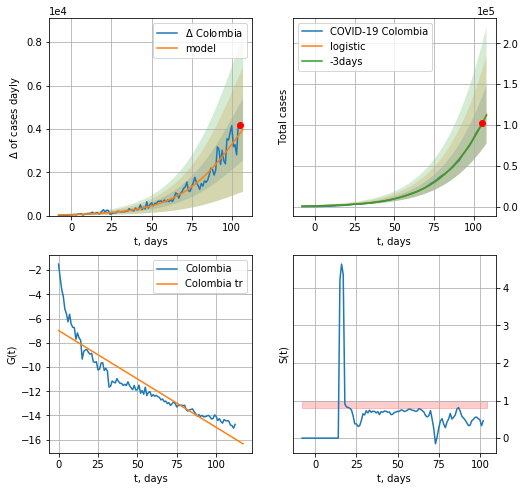

Colombia data at: 2020-07-01
+3 day model MAPE: 0.009106041065764386
model: logistic
coeffs:  [4.62172065e+05 4.70969815e-02 1.31926004e+02]
rational stdev:  0.3156058637204056
forecast at the end of period: +3 days
	 deltaDaycases:  3974
	 total cases:  113113 ± 35699
	 total death:  3847 ± 3642
trend coefficient of determination: 0.837066
 intercept: -6.986724
 slope: -0.079933


In [298]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,14*7-dT)

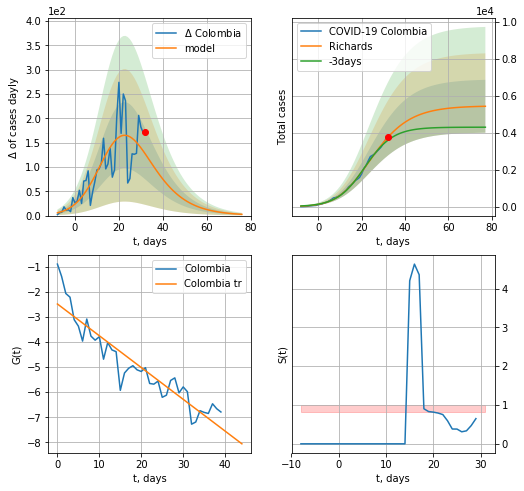

Colombia data at: 2020-07-01
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45323700e+03 2.23852153e-01 1.50939189e+01 4.47628300e-01]
rational stdev: 0.263661
forecast at the end of period: +45 days
	 deltaDaycases: 2
	 total cases: 5428 ± 1431
	 total death: 184 ± 145
trend coefficient of determination: 0.864435
 intercept: -2.485434
 slope: -0.126591


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


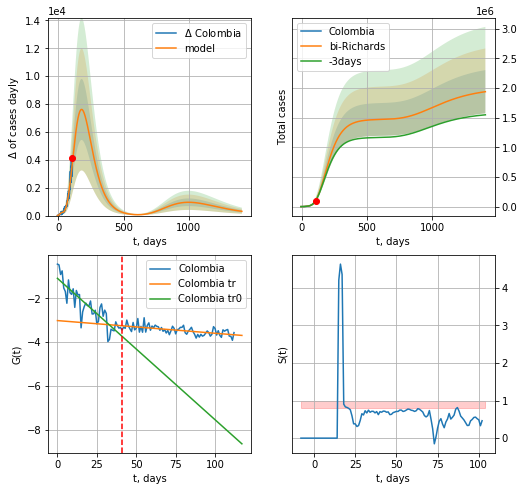

Colombia data at: 2020-07-01
+3 day model MAPE: 0.013359
model: bi-Richards
coeffs: [ 1.46586185e+06  4.48277931e-01 -6.17269721e+01  3.20087374e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.187975
forecast at the end of period: +1305 days
	 deltaDaycases: 305
	 total cases: 1935954 ± 363910
	 total death: 65854 ± 37136
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.759184
 intercept: -1.089125
 slope: -0.064590
trend coefficient of determination: 0.354027
 intercept: -3.018923
 slope: -0.005787


In [299]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,200*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


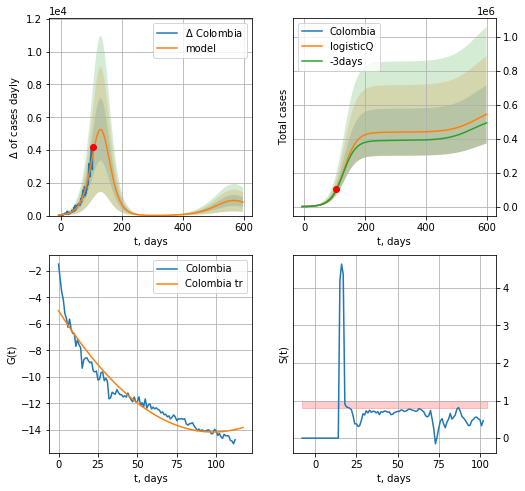

Colombia data at: 2020-07-01
+3 day model MAPE: 0.009544
model: logisticQ
coeffs: [ 4.38744613e+05  5.37528585e-06  1.30146870e+02 -8.78217912e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316385
forecast at the end of period: +493 days
	 deltaDaycases: 815
	 total cases: 543696 ± 172017
	 total death: 18494 ± 17553
trend coefficient of determination: 0.938080
 intercept_: -5.014996458585832
 coeffs_: [ 0.         -0.18651554  0.00095165]


In [300]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
115 2020-06-27  12968.0  2874.0  892.0
116 2020-06-28  13273.0  3005.0  897.0
117 2020-06-29  13571.0  2992.0  905.0
118 2020-06-30  13907.0  3098.0  912.0
119 2020-07-01  14272.0  3312.0  920.0


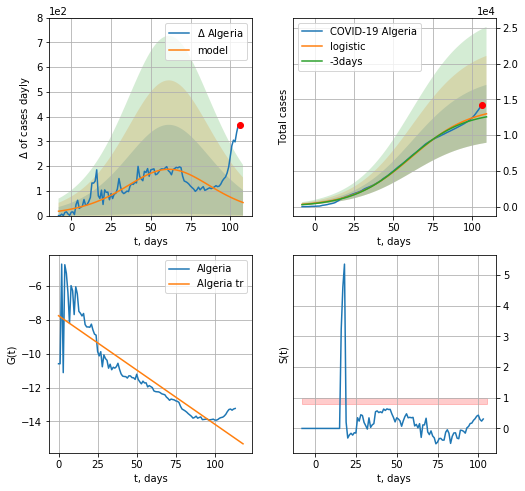

Algeria data at: 2020-07-01
+3 day model MAPE: 0.032448696101242895
model: logistic
coeffs:  [1.40308372e+04 5.33797633e-02 6.17927222e+01]
rational stdev:  0.3115662763802972
forecast at the end of period: +3 days
	 deltaDaycases:  52
	 total cases:  12985 ± 4045
	 total death:  837 ± 782
trend coefficient of determination: 0.803866
 intercept: -7.768807
 slope: -0.063957


In [301]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,14*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


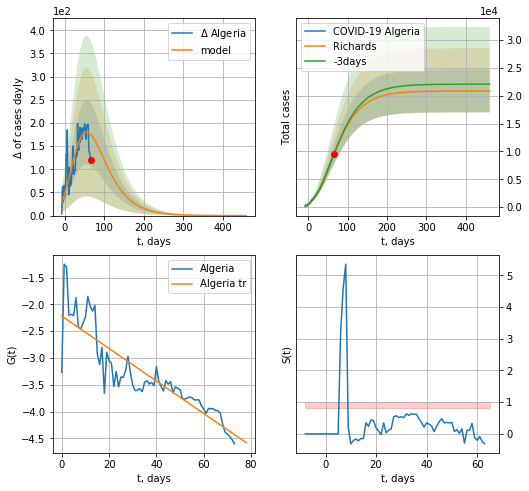

Algeria data at: 2020-07-01
+3 day model MAPE: 0.008186
model: Richards
coeffs: [ 2.08625851e+04  9.79673977e-01 -1.01161081e+02  2.42501114e-02]
rational stdev: 0.184006
forecast at the end of period: +395 days
	 deltaDaycases: 0
	 total cases: 20861 ± 3838
	 total death: 1344 ± 741
trend coefficient of determination: 0.777640
 intercept: -2.218091
 slope: -0.030315


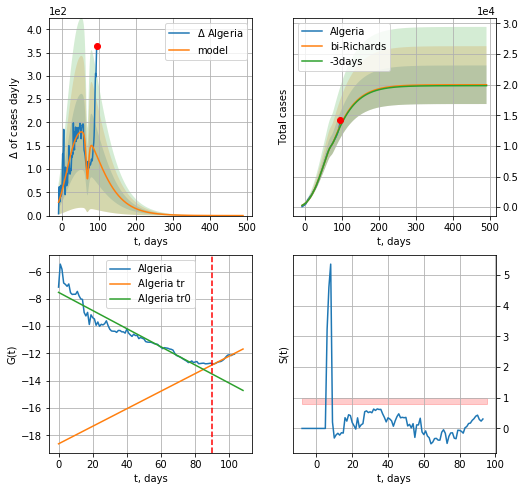

Algeria data at: 2020-07-01
+3 day model MAPE: 0.011185
model: bi-Richards
coeffs: [-8.69748342e+02  4.63342972e-01  6.99711966e+01  8.76658435e-01]
rational stdev: 0.157506
forecast at the end of period: +395 days
	 deltaDaycases: 0
	 total cases: 19992 ± 3148
	 total death: 1288 ± 608
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.911899
 intercept: -7.524387
 slope: -0.066526
trend coefficient of determination: 0.947046
 intercept: -18.620659
 slope: 0.064308


In [303]:
vL = 90+15
x = forecastRR("Algeria",dfAR[15:vL-15],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[15:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


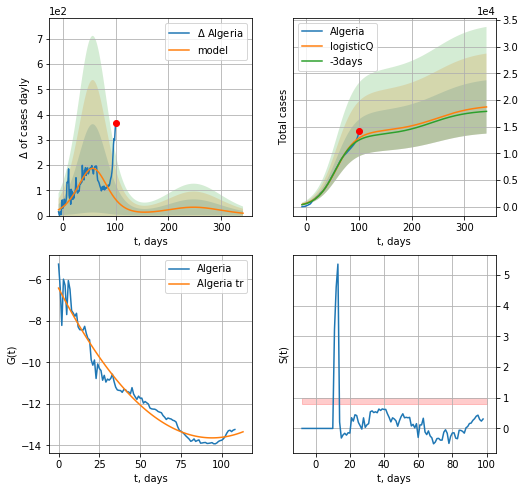

Algeria data at: 2020-07-01
+3 day model MAPE: 0.032037
model: logisticQ
coeffs: [ 1.40836420e+04  4.69365669e-07  5.69703554e+01 -1.12717179e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267127
forecast at the end of period: +241 days
	 deltaDaycases: 9
	 total cases: 18691 ± 4992
	 total death: 1204 ± 964
trend coefficient of determination: 0.963005
 intercept_: -6.425353714266246
 coeffs_: [ 0.         -0.15331702  0.00081503]


In [304]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

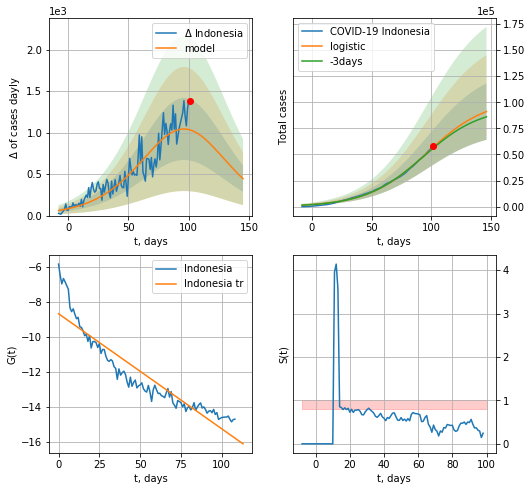

Indonesia data at: 2020-07-01
+3 day model MAPE: 0.016651448385101006
model: logistic
coeffs:  [1.03439974e+05 4.03676575e-02 9.64470859e+01]
rational stdev:  0.296740420577864
forecast at the end of period: +45 days
	 deltaDaycases:  445
	 total cases:  91113 ± 27036
	 total death:  4627 ± 4119
trend coefficient of determination: 0.863611
 intercept: -8.669475
 slope: -0.065776


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


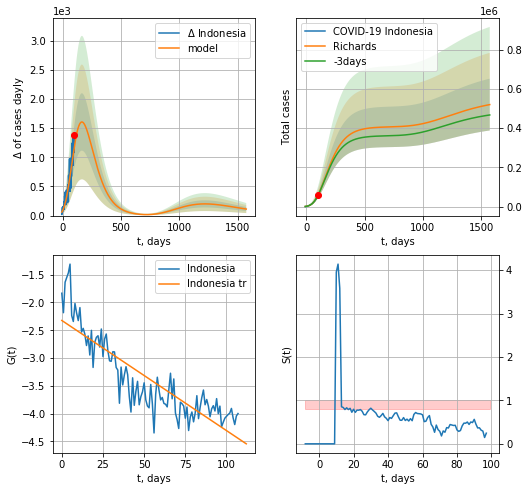

Indonesia data at: 2020-07-01
+3 day model MAPE: 0.007905
model: Richards
coeffs: [ 4.07041518e+05  4.43168245e-01 -1.77466142e+02  2.44763589e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.253764
forecast at the end of period: +1473 days
	 deltaDaycases: 112
	 total cases: 519852 ± 131920
	 total death: 26402 ± 20099
trend coefficient of determination: 0.751817
 intercept: -2.324084
 slope: -0.019822


In [305]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,224*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


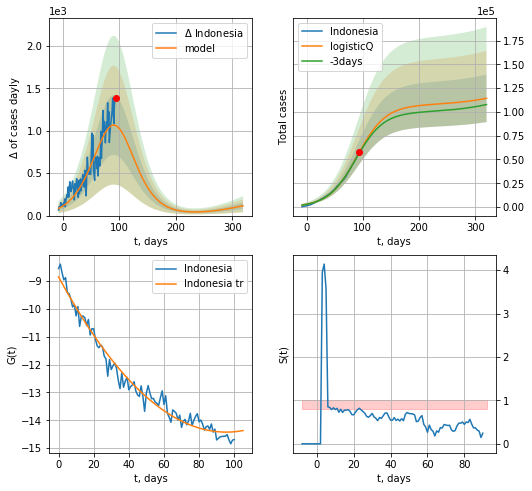

Indonesia data at: 2020-07-01
+3 day model MAPE: 0.014660
model: logisticQ
coeffs: [ 1.07103600e+05  2.57237963e-06  9.01169287e+01 -1.53731908e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218676
forecast at the end of period: +227 days
	 deltaDaycases: 115
	 total cases: 114302 ± 24995
	 total death: 5805 ± 3808
trend coefficient of determination: 0.975578
 intercept_: -8.846460792952787
 coeffs_: [ 0.         -0.1169208   0.00061251]


In [306]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


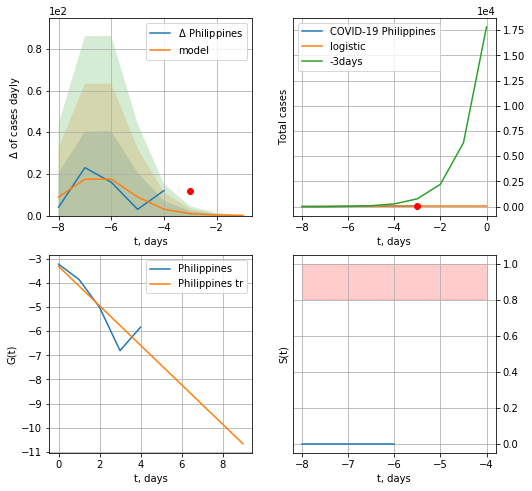

Philippines data at: 2020-07-01
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  2 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


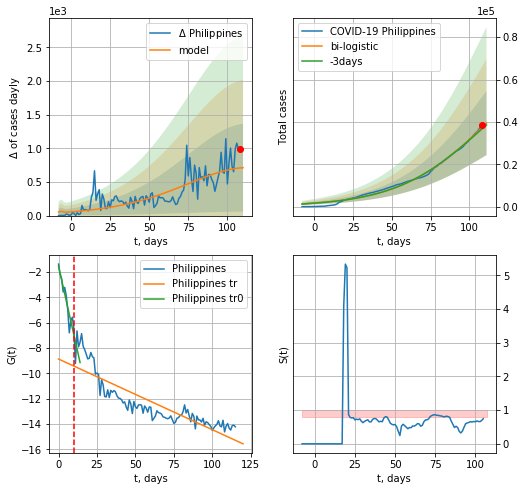

Philippines data at: 2020-07-01
+3 day model MAPE: 0.02087535020289685
model: bi-logistic
coeffs:  [8.32619998e+04 3.43270415e-02 1.14123378e+02] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3833100370248389
forecast at the end of period: +3 days
	 deltaDaycases:  711
	 total cases:  39462 ± 15126
	 total death:  1301 ± 1496
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.748601
 intercept: -8.870925
 slope: -0.055703


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


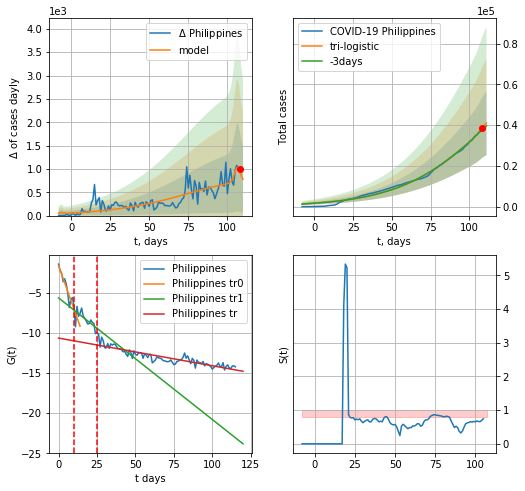

Philippines data at: 2020-07-01
+3 day model MAPE: 0.030230408122067492
model: tri-logistic
coeffs:  [1.66518924e+03 8.09444180e-01 1.06899982e+02] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  8.32619998e+04
  3.43270415e-02  1.14123378e+02]
forecast rational stdev:  0.38300548225132997
forecast at the end of period: +3 days
	 deltaDaycases:  778
	 total cases:  41069 ± 15730
	 total death:  1354 ± 1555
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.799029
 intercept: -10.620136
 slope: -0.034566


In [307]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,14*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


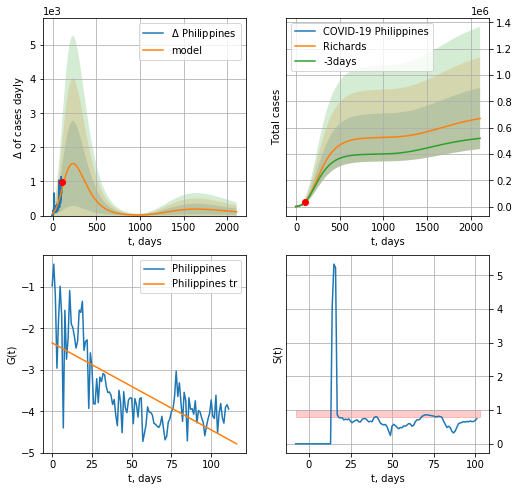

Philippines data at: 2020-07-01
+3 day model MAPE: 0.013912
model: Richards
coeffs: [ 5.26187566e+05  2.91161839e-01 -2.19007747e+02  2.74899197e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.346457
forecast at the end of period: +2005 days
	 deltaDaycases: 111
	 total cases: 669841 ± 232071
	 total death: 22089 ± 22958
trend coefficient of determination: 0.502403
 intercept: -2.353975
 slope: -0.020920


In [308]:
x = forecastRR("Philippines",dfPH[4:],d1,300*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


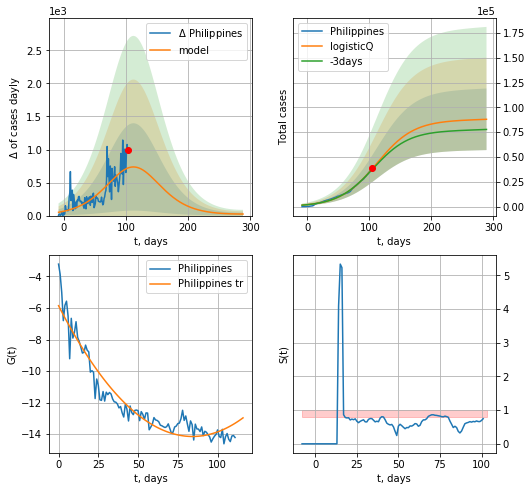

Philippines data at: 2020-07-01
+3 day model MAPE: 0.019441
model: logisticQ
coeffs: [ 8.72178213e+04  1.08109907e-06  1.12483673e+02 -3.10968390e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352687
forecast at the end of period: +185 days
	 deltaDaycases: 23
	 total cases: 87991 ± 31033
	 total death: 2901 ± 3069
trend coefficient of determination: 0.914985
 intercept_: -5.856262887667592
 coeffs_: [ 0.         -0.1968769   0.00116878]


In [309]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
119 2020-06-27  3366.0    1801  191.0
120 2020-06-28  3376.0    1811  191.0
121 2020-06-29  3390.0    1825  191.0
122 2020-06-30  3409.0    1843  192.0
123 2020-07-01  3432.0    1866  192.0


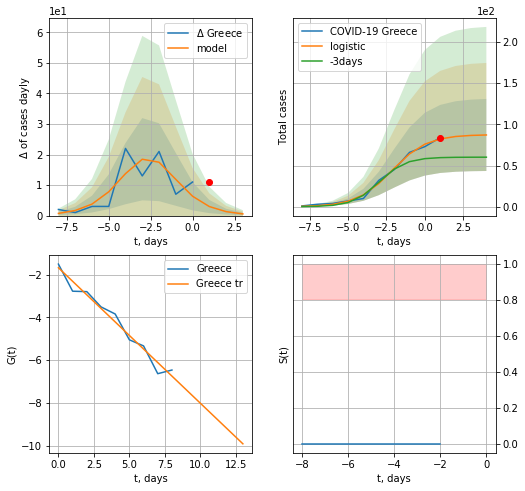

Greece data at: 2020-07-01
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


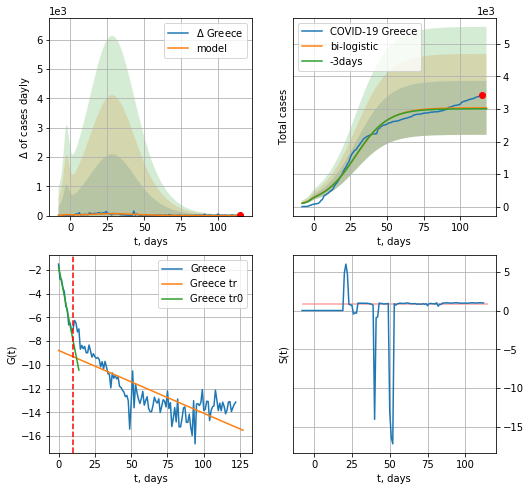

Greece data at: 2020-07-01
+3 day model MAPE: 0.010040867860348053
model: bi-logistic
coeffs:  [2.95015725e+03 8.91420051e-02 2.87893872e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.27300900689305074
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3036 ± 829
	 total death:  169 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.624515
 intercept: -8.784946
 slope: -0.053019


In [310]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,14*7-dT)
xx = forecast2("Greece",dfGC[:],d1,14*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


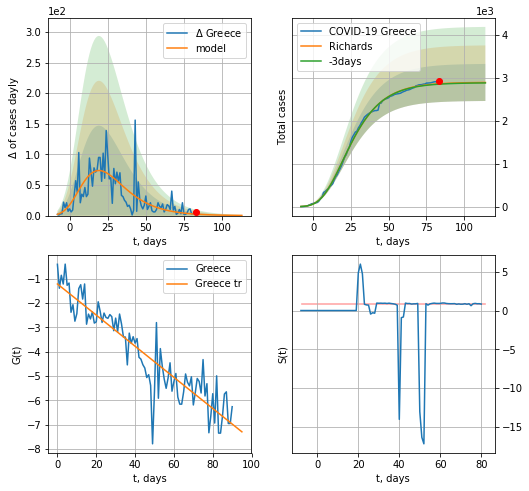

Greece data at: 2020-07-01
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 2889 ± 430
	 total death: 161 ± 72
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


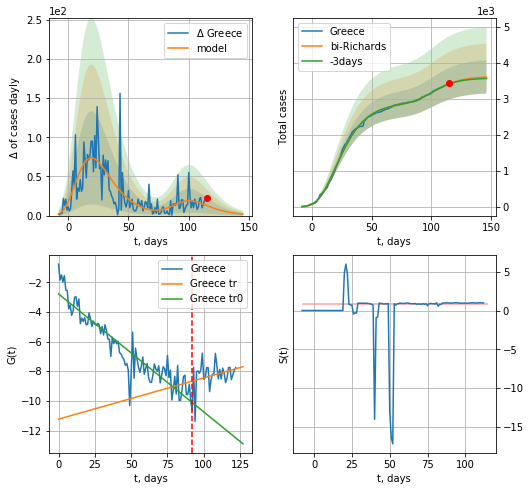

Greece data at: 2020-07-01
+3 day model MAPE: 0.002504
model: bi-Richards
coeffs: [7.38615384e+02 2.30581867e-01 8.74224998e+01 3.37982459e-01]
rational stdev: 0.128520
forecast at the end of period: +31 days
	 deltaDaycases: 1
	 total cases: 3609 ± 463
	 total death: 201 ± 77
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.861926
 intercept: -2.789836
 slope: -0.079580
trend coefficient of determination: 0.078271
 intercept: -11.234525
 slope: 0.027861


In [314]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


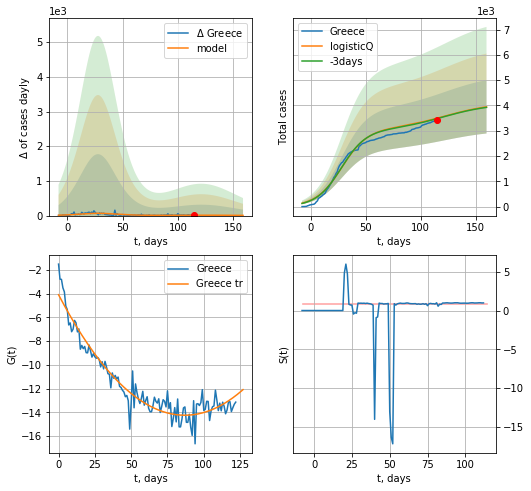

Greece data at: 2020-07-01
+3 day model MAPE: 0.004725
model: logisticQ
coeffs: [ 3.04315410e+03  1.54974675e-07  2.80495553e+01 -5.55507630e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267007
forecast at the end of period: +45 days
	 deltaDaycases: 6
	 total cases: 3945 ± 1053
	 total death: 220 ± 176
trend coefficient of determination: 0.918839
 intercept_: -4.087174456931415
 coeffs_: [ 0.         -0.23386568  0.00134508]


In [315]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
113 2020-06-27  4138.5     879  578.0
114 2020-06-28  4142.0     876  581.0
115 2020-06-29  4145.0     875  585.0
116 2020-06-30  4155.0     878  585.0
117 2020-07-01  4157.0     857  586.0


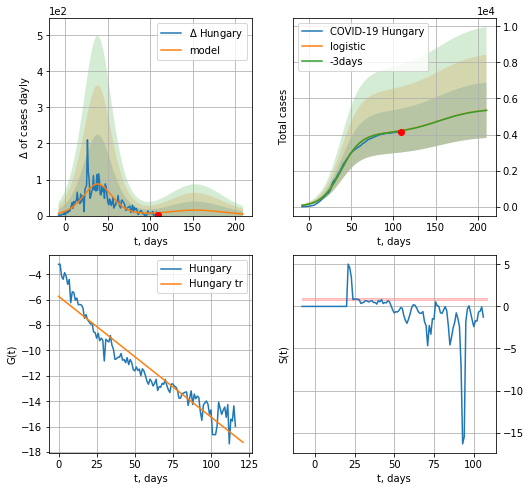

Hungary data at: 2020-07-01
+3 day model MAPE: 0.0028892524356223825
model: logistic
coeffs:  [4.04699316e+03 8.63740988e-02 3.83584198e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2875310400059778
forecast at the end of period: +101 days
	 deltaDaycases:  4
	 total cases:  5350 ± 1538
	 total death:  754 ± 650
trend coefficient of determination: 0.912836
 intercept: -5.734088
 slope: -0.095071


In [316]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


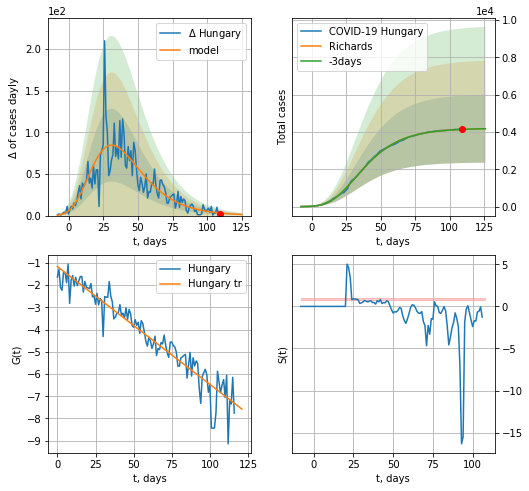

Hungary data at: 2020-07-01
+3 day model MAPE: 0.000531
model: Richards
coeffs: [ 4.19911434e+03  3.80982199e+00 -4.52039971e+01  1.44746579e-02]
rational stdev: 0.435507
forecast at the end of period: +17 days
	 deltaDaycases: 1
	 total cases: 4176 ± 1818
	 total death: 588 ± 768
trend coefficient of determination: 0.907262
 intercept: -1.164995
 slope: -0.052996


In [317]:
vL = 99
x = forecastRR("Hungary",dfHG[:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR("Hungary",dfHG[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


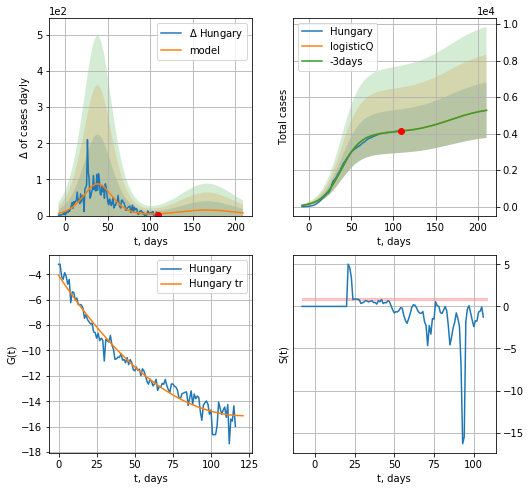

Hungary data at: 2020-07-01
+3 day model MAPE: 0.003046
model: logisticQ
coeffs: [ 4.04693417e+03  3.52057427e-07  3.83589956e+01 -2.45233431e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287627
forecast at the end of period: +101 days
	 deltaDaycases: 7
	 total cases: 5287 ± 1520
	 total death: 745 ± 642
trend coefficient of determination: 0.963678
 intercept_: -4.082994406763721
 coeffs_: [ 0.         -0.18121749  0.00074266]


In [318]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


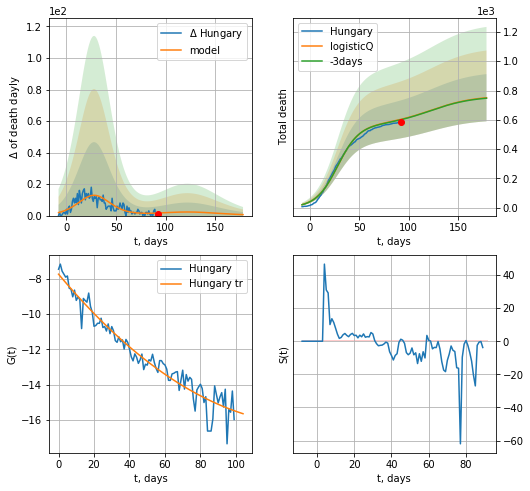

Hungary data at: 2020-07-01
+3 day model MAPE: 0.004084
model: logisticQ
coeffs: [ 5.65064149e+02  3.82785232e-07  2.81493776e+01 -2.36345392e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214475
forecast at the end of period: +87 days
	 total death: 750 ± 161
trend coefficient of determination: 0.936923
 intercept_: -7.748069372760027
 coeffs_: [ 0.        -0.1196427  0.0004203]


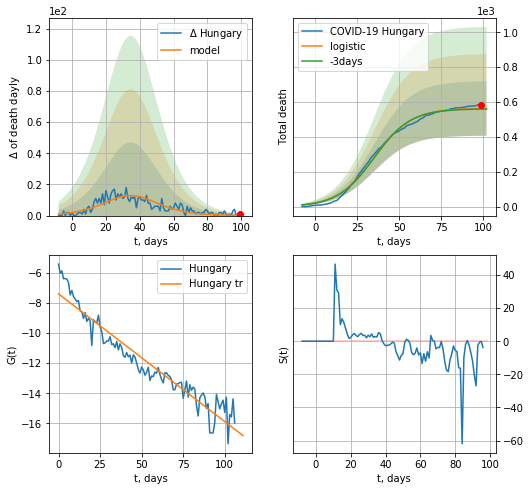

Hungary data at: 2020-07-01
+3 day model MAPE: 0.005263172742558901
model: logistic
coeffs:  [5.64464913e+02 9.12434801e-02 3.51276614e+01]
rational stdev:  0.2768933440369595
forecast at the end of period: +3 days
	 total death:  563 ± 155
trend coefficient of determination: 0.918222
 intercept: -7.399161
 slope: -0.084732


In [319]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,14*7-dT,cases='death')

MT
           date  cases  active  death
111 2020-06-27  670.1      26    9.0
112 2020-06-28  670.2      25    9.0
113 2020-06-29  670.3      22    9.0
114 2020-06-30  670.4      21    9.0
115 2020-07-01  671.0      15    9.0


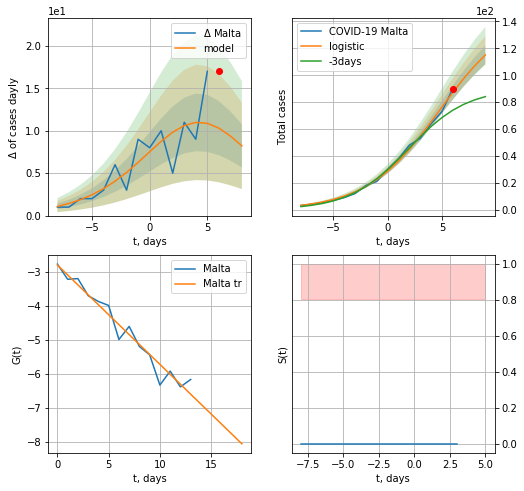

Malta data at: 2020-07-01
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  115 ± 6
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


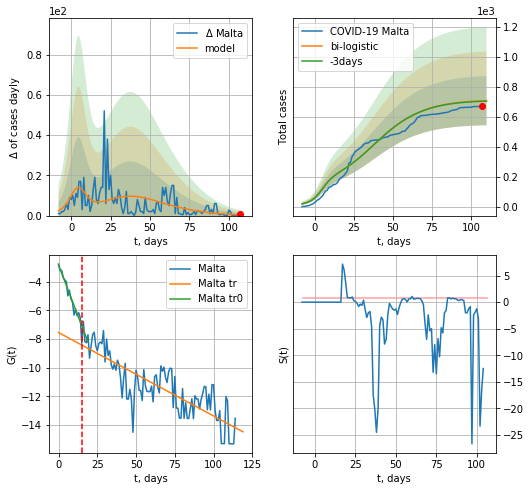

Malta data at: 2020-07-01
+3 day model MAPE: 0.004913404813024557
model: bi-logistic
coeffs:  [5.03734499e+02 7.29012637e-02 3.70418630e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.23091073037225432
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  709 ± 163
	 total death:  9 ± 6
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.677211
 intercept: -7.550200
 slope: -0.058230


In [321]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*14-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*14-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


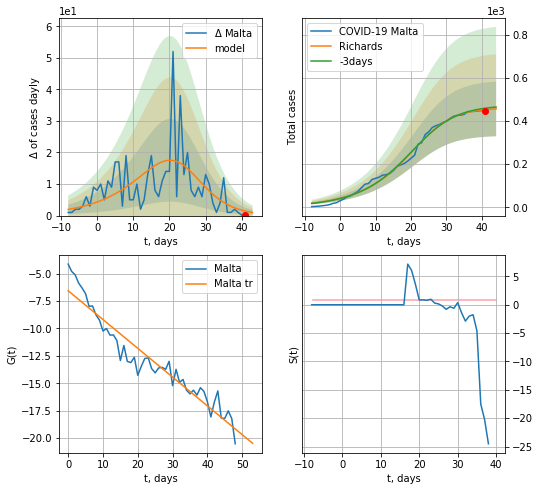

Malta data at: 2020-07-01
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 456 ± 126
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


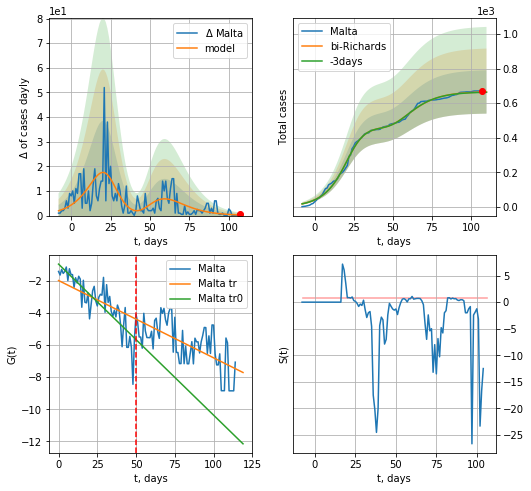

Malta data at: 2020-07-01
+3 day model MAPE: 0.002768
model: bi-Richards
coeffs: [2.06362373e+02 1.42213374e+01 3.12574657e+00 6.28394256e-03]
rational stdev: 0.188241
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 664 ± 125
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.728433
 intercept: -0.936153
 slope: -0.094325
trend coefficient of determination: 0.399675
 intercept: -1.960756
 slope: -0.048279


In [322]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


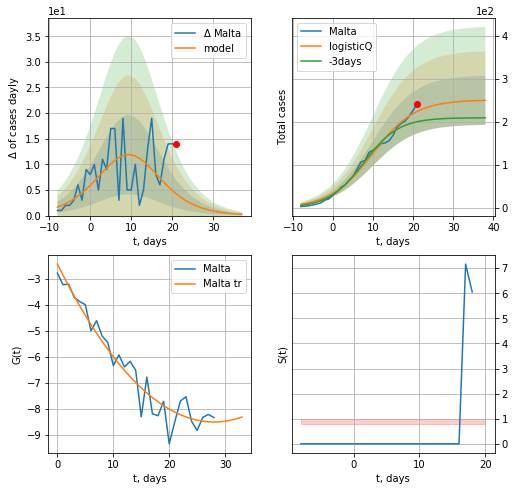

Malta data at: 2020-07-01
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 249 ± 56
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


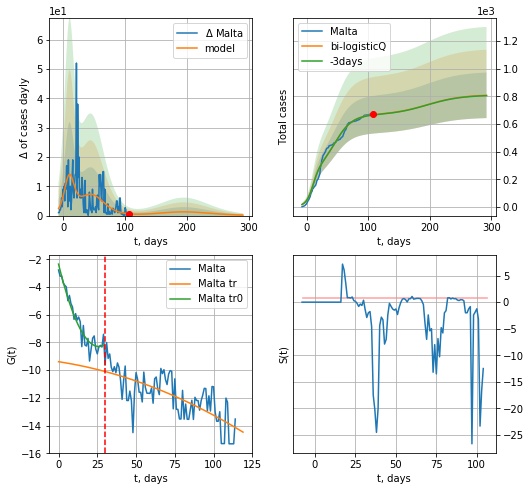

Malta data at: 2020-07-01
+3 day model MAPE: 0.002858
model: bi-logisticQ
coeffs: [ 4.14491698e+02  1.96976064e-07  4.48433968e+01 -3.52334829e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.204046
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 807 ± 164
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.512834
 intercept_: -9.392379306237274
 coeffs_: [ 0.         -0.01704713 -0.00021565]


In [323]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
109 2020-06-27  1657.0   174.0   28.0
110 2020-06-28  1664.0   175.0   28.0
111 2020-06-29  1665.0   173.0   28.0
112 2020-06-30  1667.0   175.0   28.0
113 2020-07-01  1687.0   193.0   28.0


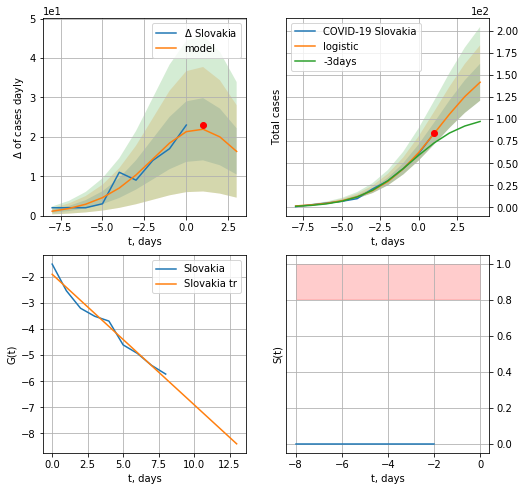

Slovakia data at: 2020-07-01
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +3 days
	 deltaDaycases:  16
	 total cases:  141 ± 20
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


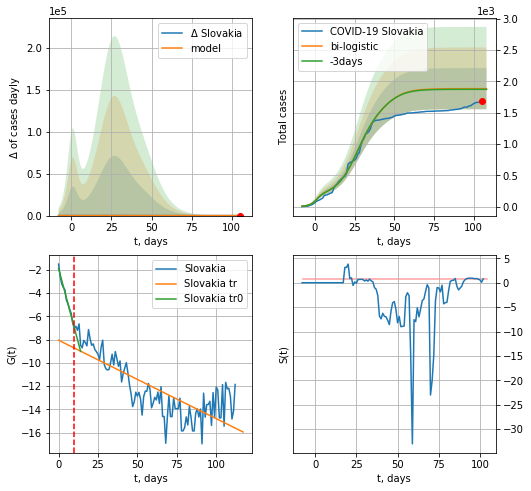

Slovakia data at: 2020-07-01
+3 day model MAPE: 0.005266623575763271
model: bi-logistic
coeffs:  [1.36359953e+03 1.50023106e-01 2.67338170e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.17453962764709222
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1881 ± 328
	 total death:  31 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.626143
 intercept: -8.054132
 slope: -0.067518


In [324]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,14*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


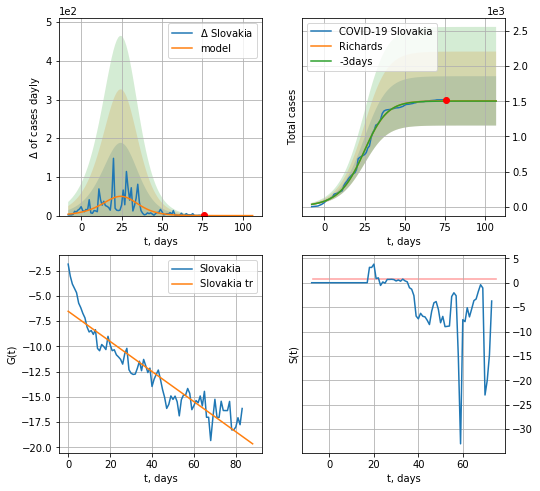

Slovakia data at: 2020-07-01
+3 day model MAPE: 0.002066
model: Richards
coeffs: [1.50610865e+03 1.09508318e-01 2.68945088e+01 1.32920214e+00]
rational stdev: 0.232989
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 1506 ± 350
	 total death: 24 ± 16
trend coefficient of determination: 0.871466
 intercept: -6.535200
 slope: -0.149062


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


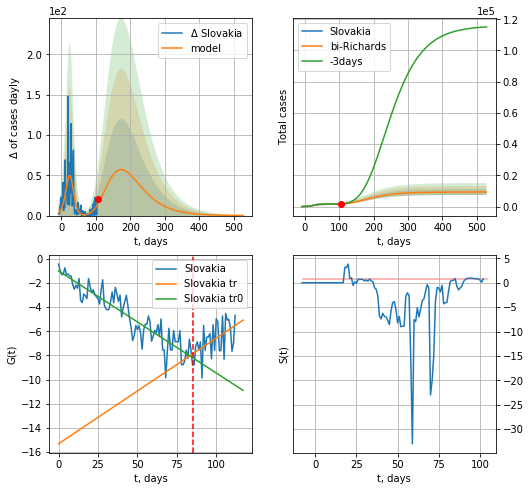

Slovakia data at: 2020-07-01
+3 day model MAPE: 0.012978
model: bi-Richards
coeffs: [7.85781089e+03 6.32257104e-01 1.72846914e+00 3.16884597e-02]
rational stdev: 0.202944
forecast at the end of period: +423 days
	 deltaDaycases: 0
	 total cases: 9357 ± 1899
	 total death: 155 ± 94
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.848348
 intercept: -0.998005
 slope: -0.084505
trend coefficient of determination: 0.245997
 intercept: -15.310188
 slope: 0.087459


In [325]:
vL = 85
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


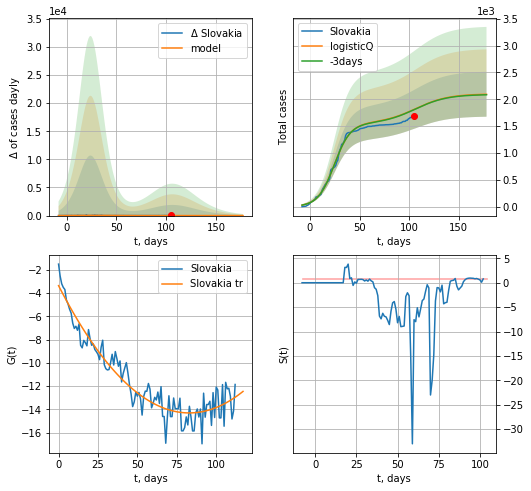

Slovakia data at: 2020-07-01
+3 day model MAPE: 0.002537
model: logisticQ
coeffs: [ 1.55102129e+03  1.37464665e-06  2.44651676e+01 -8.85378343e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199749
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 2093 ± 418
	 total death: 34 ± 20
trend coefficient of determination: 0.901843
 intercept_: -3.3586678927649185
 coeffs_: [ 0.         -0.26426526  0.00159366]


In [326]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
114 2020-06-27  1572.0    87.0  109.0
115 2020-06-28  1581.0    86.0  111.0
116 2020-06-29  1585.0    90.0  111.0
117 2020-06-30  1600.0   105.0  111.0
118 2020-07-01  1613.0   118.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


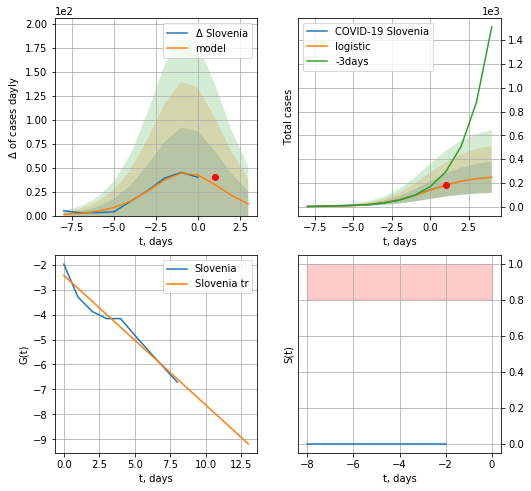

Slovenia data at: 2020-07-01
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +3 days
	 deltaDaycases:  12
	 total cases:  247 ± 131
	 total death:  17 ± 27
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


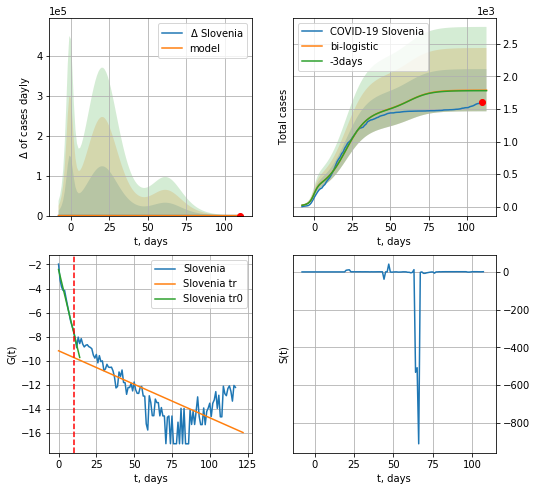

Slovenia data at: 2020-07-01
+3 day model MAPE: 0.004226939403432142
model: bi-logistic
coeffs:  [1.22169618e+03 1.40024052e-01 2.08718763e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.18116518859427816
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1787 ± 323
	 total death:  123 ± 66
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.514389
 intercept: -9.169099
 slope: -0.055635


In [327]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*14-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


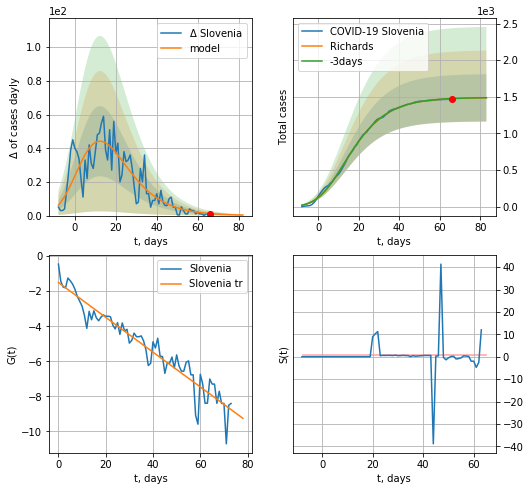

Slovenia data at: 2020-07-01
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 1485 ± 322
	 total death: 102 ± 66
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


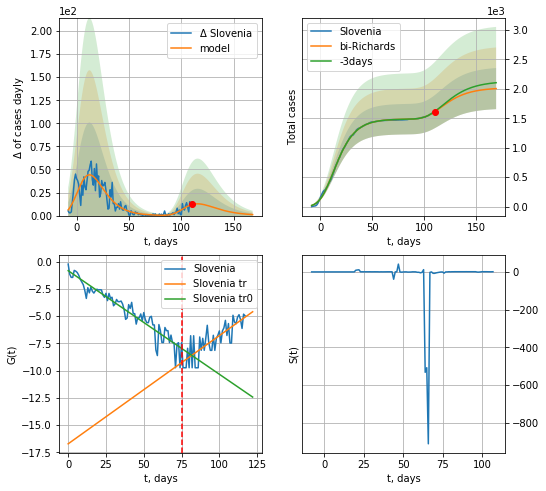

Slovenia data at: 2020-07-01
+3 day model MAPE: 0.002785
model: bi-Richards
coeffs: [5.32224973e+02 3.32453284e+00 5.62326538e+01 1.97492343e-02]
rational stdev: 0.174185
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 2004 ± 349
	 total death: 137 ± 71
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.904496
 intercept: -0.821680
 slope: -0.095169
trend coefficient of determination: 0.632152
 intercept: -16.727353
 slope: 0.099441


In [328]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


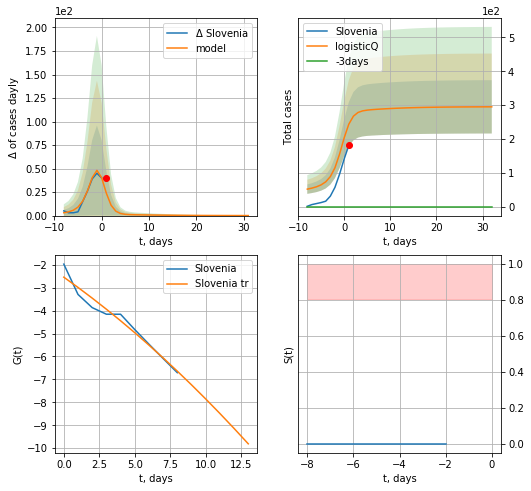

Slovenia data at: 2020-07-01
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


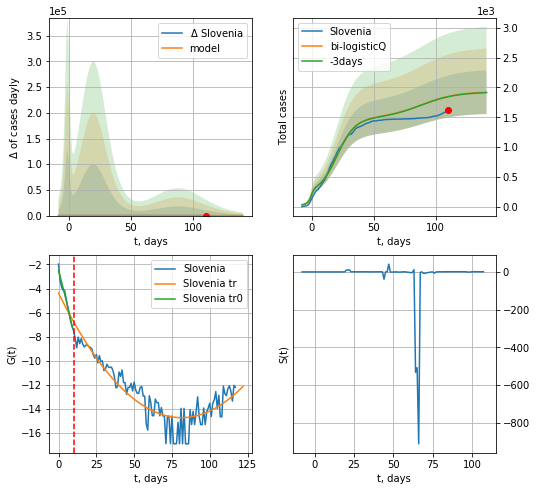

Slovenia data at: 2020-07-01
+3 day model MAPE: 0.002302
model: bi-logisticQ
coeffs: [ 1.26516141e+03  4.09113077e-07  2.02815043e+01 -3.33800367e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190241
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 1919 ± 365
	 total death: 132 ± 75
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.831382
 intercept_: -4.376557518353799
 coeffs_: [ 0.         -0.25452301  0.00156607]


In [329]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
109 2020-06-27  13792  1187.0  267.0
110 2020-06-28  14046  1312.0  270.0
111 2020-06-29  14288  1433.0  274.0
112 2020-06-30  14564  1625.0  277.0
113 2020-07-01  14836  1783.0  281.0


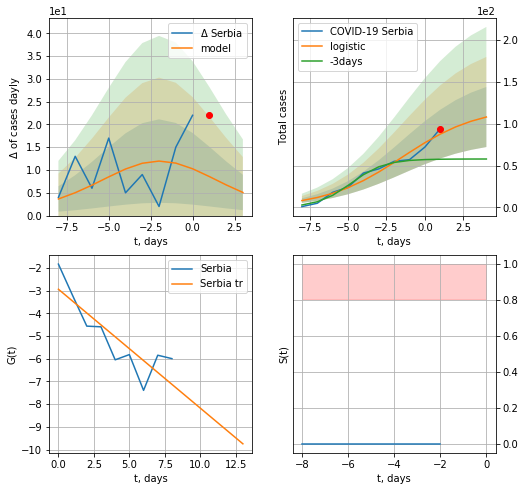

Serbia data at: 2020-07-01
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  107 ± 35
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


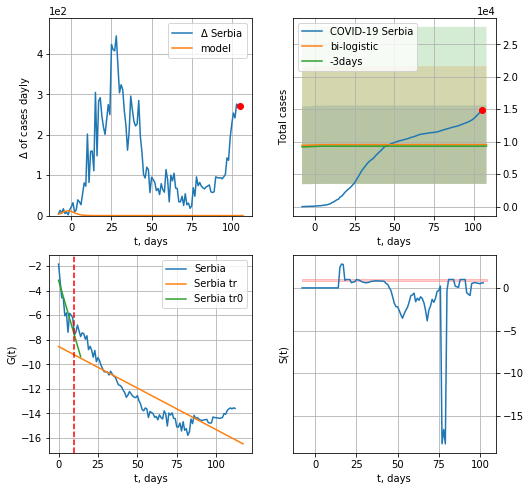

Serbia data at: 2020-07-01
+3 day model MAPE: 0.025056148364728675
model: bi-logistic
coeffs:  [ 7.53830458e+03 -1.40631883e+00  1.23530613e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6333925983544849
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9542 ± 6044
	 total death:  180 ± 342
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.726232
 intercept: -8.553651
 slope: -0.067827


In [330]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,14*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


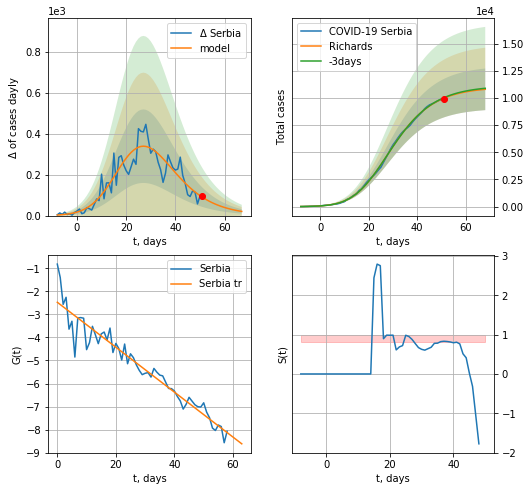

Serbia data at: 2020-07-01
+3 day model MAPE: 0.004687
model: Richards
coeffs: [1.10013418e+04 2.65942316e-01 1.74706718e+01 3.71455437e-01]
rational stdev: 0.177413
forecast at the end of period: +17 days
	 deltaDaycases: 20
	 total cases: 10802 ± 1916
	 total death: 204 ± 108
trend coefficient of determination: 0.925214
 intercept: -2.475756
 slope: -0.097437


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


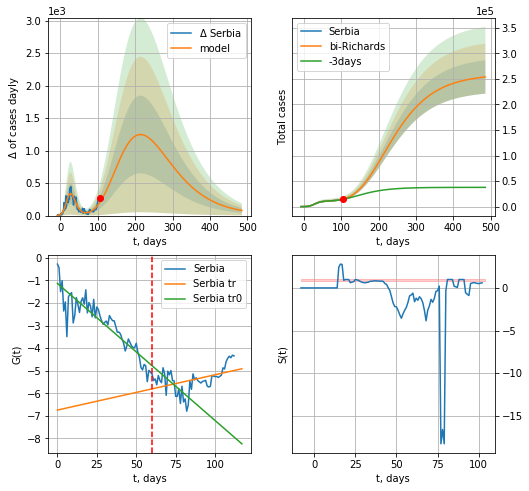

Serbia data at: 2020-07-01
+3 day model MAPE: 0.028463
model: bi-Richards
coeffs: [ 2.48401388e+05  3.83375129e-01 -2.41843201e+01  3.62528986e-02]
rational stdev: 0.128691
forecast at the end of period: +381 days
	 deltaDaycases: 77
	 total cases: 253764 ± 32657
	 total death: 4806 ± 1855
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.822173
 intercept: -1.135709
 slope: -0.060696
trend coefficient of determination: 0.192268
 intercept: -6.742753
 slope: 0.015628


In [332]:
vL=60
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


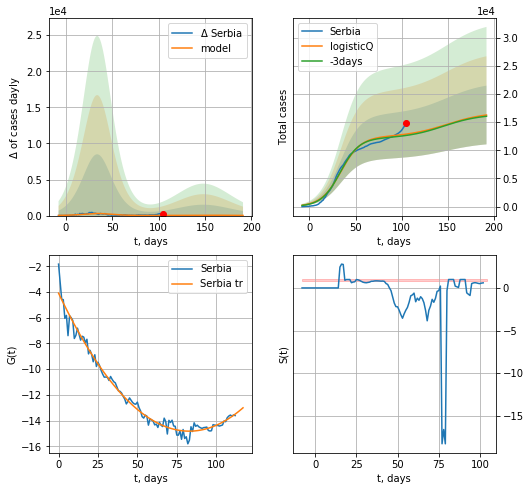

Serbia data at: 2020-07-01
+3 day model MAPE: 0.018404
model: logisticQ
coeffs: [ 1.23823018e+04  2.03181388e-07  3.40965931e+01 -4.57844718e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320578
forecast at the end of period: +87 days
	 deltaDaycases: 21
	 total cases: 16258 ± 5212
	 total death: 307 ± 295
trend coefficient of determination: 0.980275
 intercept_: -4.088722447814228
 coeffs_: [ 0.         -0.25872742  0.00156038]


In [333]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
119 2020-06-27  2624.0   365.0  107.0
120 2020-06-28  2691.0   432.0  107.0
121 2020-06-29  2725.0   463.0  107.0
122 2020-06-30  2777.0   515.0  107.0
123 2020-07-01  2831.0   568.0  108.0


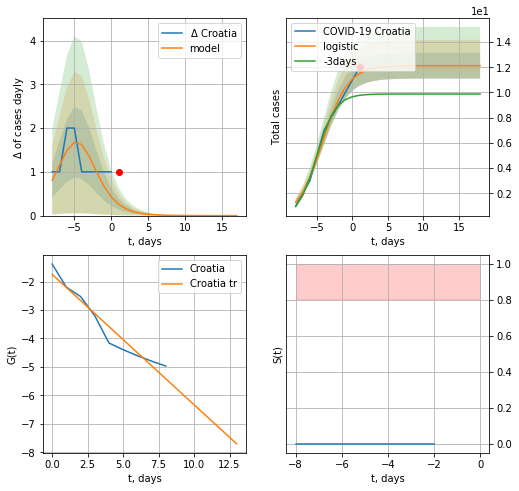

Croatia data at: 2020-07-01
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


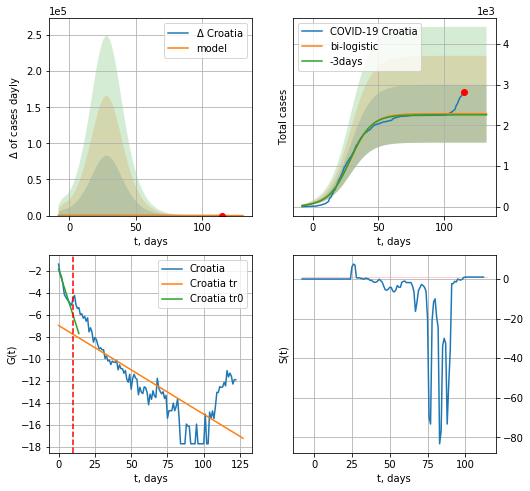

Croatia data at: 2020-07-01
+3 day model MAPE: 0.012792624981135542
model: bi-logistic
coeffs:  [2.27422581e+03 1.20903004e-01 2.86449317e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3113191521737935
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  2286 ± 711
	 total death:  87 ± 81
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.584300
 intercept: -6.967776
 slope: -0.080824


In [334]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


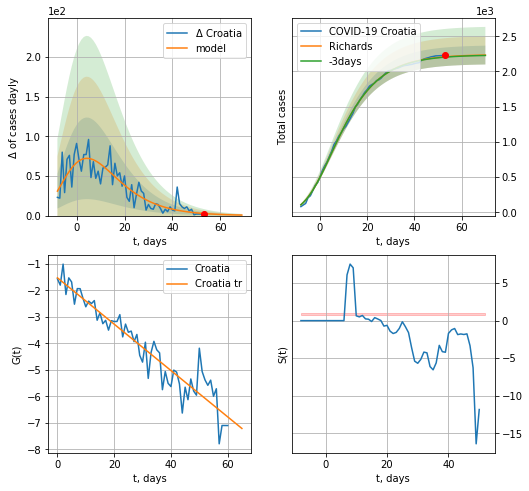

Croatia data at: 2020-07-01
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963101e+03  7.95190714e+00 -4.62548924e+01  1.10914885e-02]
rational stdev: 0.059686
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 2232 ± 133
	 total death: 85 ± 15
trend coefficient of determination: 0.897394
 intercept: -1.522031
 slope: -0.087533


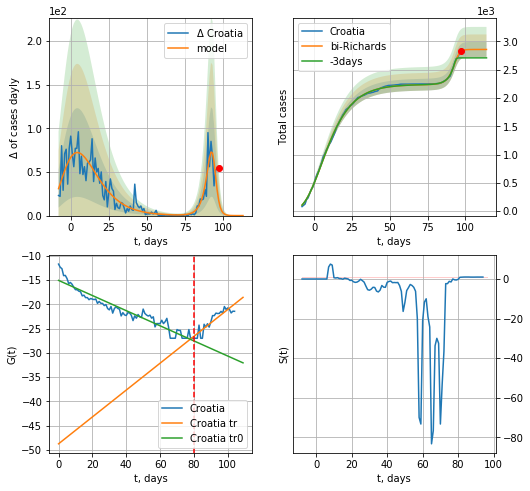

Croatia data at: 2020-07-01
+3 day model MAPE: 0.046856
model: bi-Richards
coeffs: [6.17696615e+02 2.94929855e-01 9.41184416e+01 2.19989548e+00]
rational stdev: 0.046497
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 2857 ± 132
	 total death: 108 ± 15
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.916330
 intercept: -15.080692
 slope: -0.155807
trend coefficient of determination: 0.815514
 intercept: -48.739428
 slope: 0.276756


In [336]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


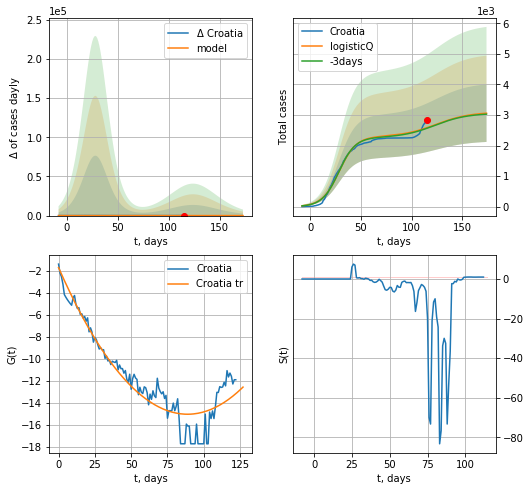

Croatia data at: 2020-07-01
+3 day model MAPE: 0.006975
model: logisticQ
coeffs: [ 2.28722478e+03  3.28742158e-07  2.85396226e+01 -3.64131757e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.307819
forecast at the end of period: +59 days
	 deltaDaycases: 2
	 total cases: 3058 ± 941
	 total death: 116 ± 107
trend coefficient of determination: 0.895448
 intercept_: -1.7009528039162056
 coeffs_: [ 0.        -0.3006107  0.0016927]


In [337]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
113 2020-06-27  63923   44075  2708.0
114 2020-06-28  65188   44860  2789.0
115 2020-06-29  66754   45931  2872.0
116 2020-06-30  68311   46898  2953.0
117 2020-07-01  69814   47899  3034.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


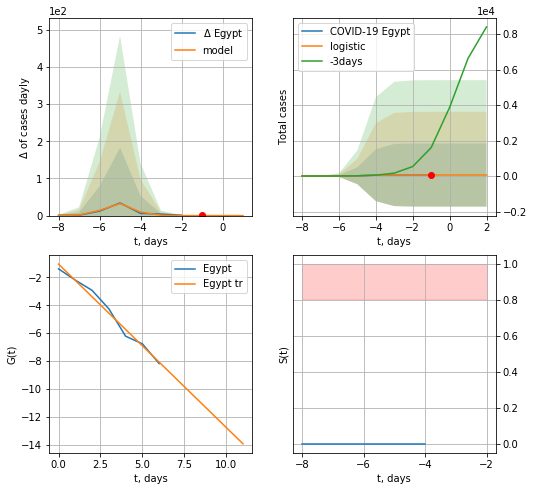

Egypt data at: 2020-07-01
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


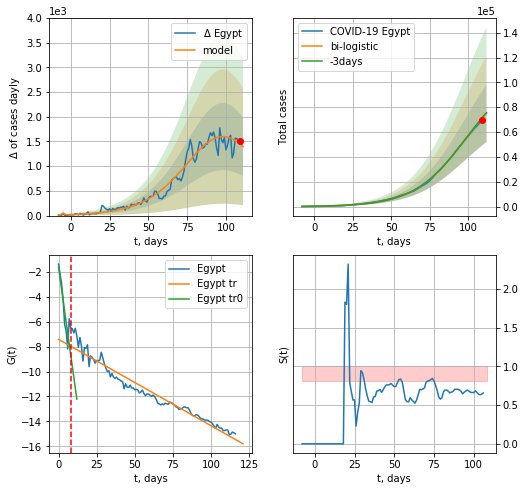

Egypt data at: 2020-07-01
+3 day model MAPE: 0.005175164744210272
model: bi-logistic
coeffs:  [1.06045207e+05 5.92771118e-02 9.77985955e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.30787554174321147
forecast at the end of period: +3 days
	 deltaDaycases:  1395
	 total cases:  75190 ± 23149
	 total death:  3267 ± 3017
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.949825
 intercept: -7.418185
 slope: -0.069265


In [338]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*14-dT)
xx = forecast2("Egypt",dfEG[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


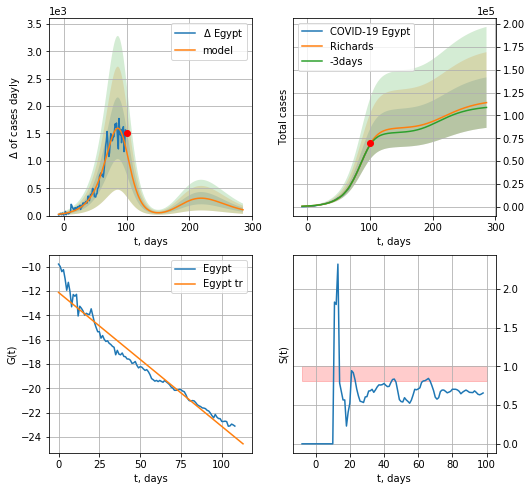

Egypt data at: 2020-07-01
+3 day model MAPE: 0.014515
model: Richards
coeffs: [8.64224161e+04 5.21798000e-02 9.25814505e+01 1.72594245e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.242542
forecast at the end of period: +185 days
	 deltaDaycases: 106
	 total cases: 114049 ± 27661
	 total death: 4956 ± 3606
trend coefficient of determination: 0.958233
 intercept: -12.117608
 slope: -0.109966


In [339]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


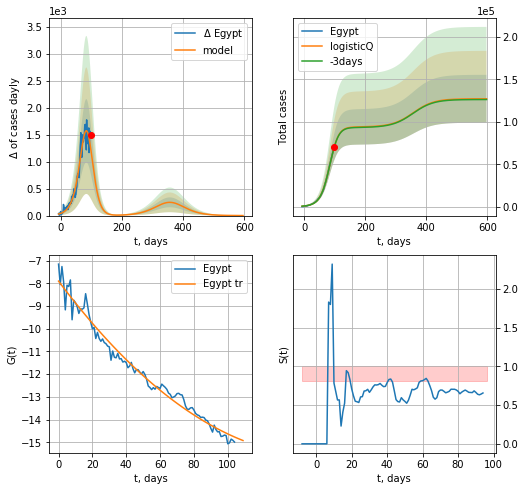

Egypt data at: 2020-07-01
+3 day model MAPE: 0.001547
model: logisticQ
coeffs: [ 9.38408595e+04  1.27217818e-04  8.17019817e+01 -4.43608134e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.221959
forecast at the end of period: +500 days
	 deltaDaycases: 0
	 total cases: 127054 ± 28200
	 total death: 5521 ± 3676
trend coefficient of determination: 0.976594
 intercept_: -7.904666999053935
 coeffs_: [ 0.         -0.09921386  0.00031949]


In [340]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
116 2020-06-27  43262  21664.0  1660.0
117 2020-06-28  45402  22524.0  1756.0
118 2020-06-29  47151  22338.0  1839.0
119 2020-06-30  49109  22406.0  1943.0
120 2020-07-01  51524  23207.0  2050.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


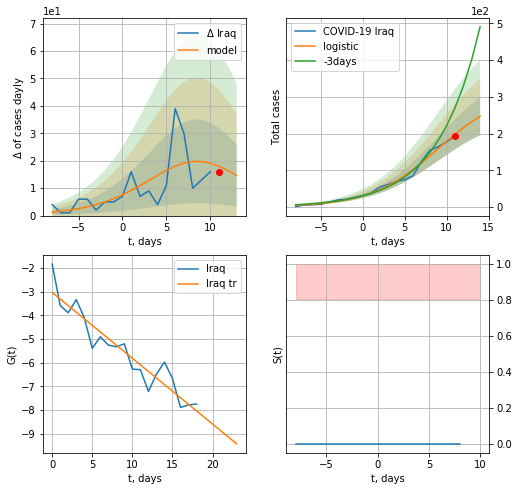

Iraq data at: 2020-07-01
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +3 days
	 deltaDaycases:  14
	 total cases:  246 ± 51
	 total death:  9 ± 5
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


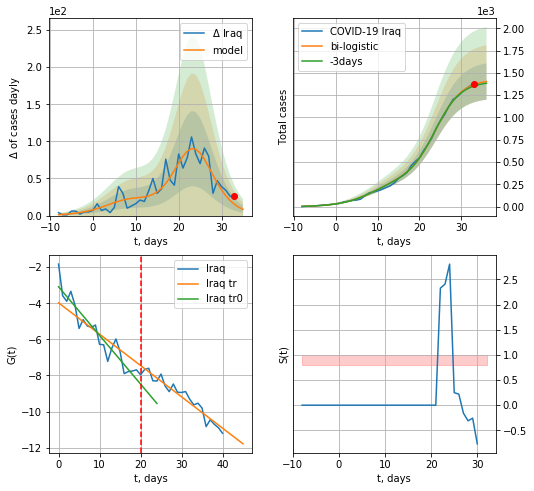

Iraq data at: 2020-07-01
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  1402 ± 203
	 total death:  55 ± 23
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


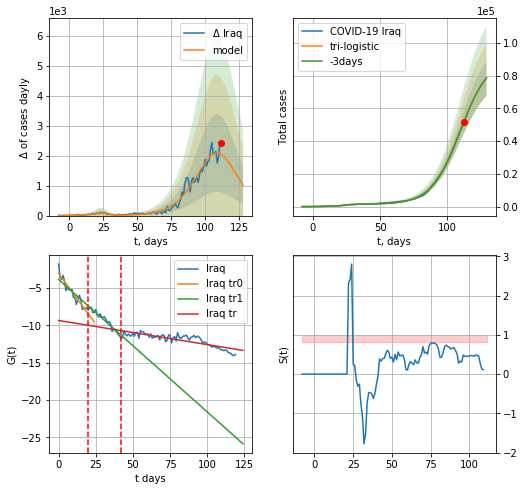

Iraq data at: 2020-07-01
+3 day model MAPE: 0.0030667561897956335
model: tri-logistic
coeffs:  [8.87715471e+04 9.40008802e-02 1.09311920e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.135455642964155
forecast at the end of period: +17 days
	 deltaDaycases:  1013
	 total cases:  78143 ± 10584
	 total death:  3109 ± 1263
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.695687
 intercept: -9.365769
 slope: -0.032225


In [341]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,14*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


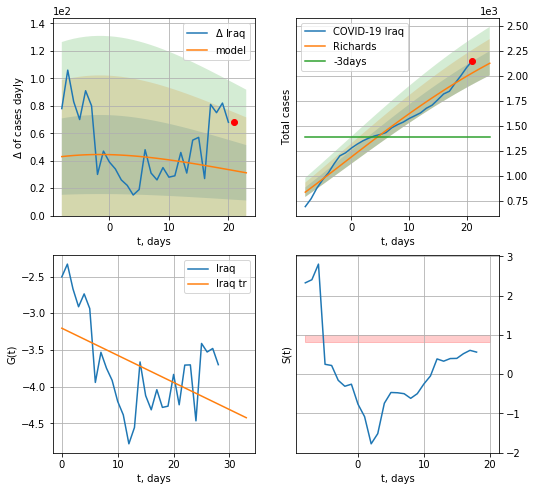

Iraq data at: 2020-07-01
+3 day model MAPE: 0.483696
model: Richards
coeffs: [ 3.05374051e+03  1.25736108e+00 -8.65808580e+01  3.20212773e-02]
rational stdev: 0.056950
forecast at the end of period: +3 days
	 deltaDaycases: 31
	 total cases: 2126 ± 121
	 total death: 84 ± 14
trend coefficient of determination: 0.238101
 intercept: -3.204366
 slope: -0.036947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


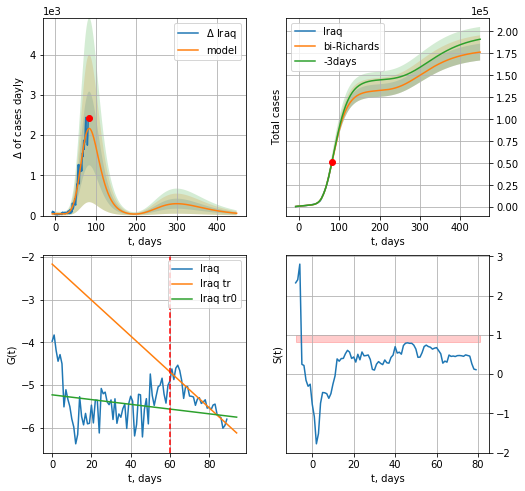

Iraq data at: 2020-07-01
+3 day model MAPE: 0.006142
model: bi-Richards
coeffs: [1.29681864e+05 2.01458823e-01 5.71284603e+01 2.52673476e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.054158
forecast at the end of period: +367 days
	 deltaDaycases: 57
	 total cases: 176298 ± 9547
	 total death: 7014 ± 1139
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.032143
 intercept: -5.230988
 slope: -0.005567
trend coefficient of determination: 0.863993
 intercept: -2.163867
 slope: -0.042135


In [342]:
vL=60+30#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,66*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

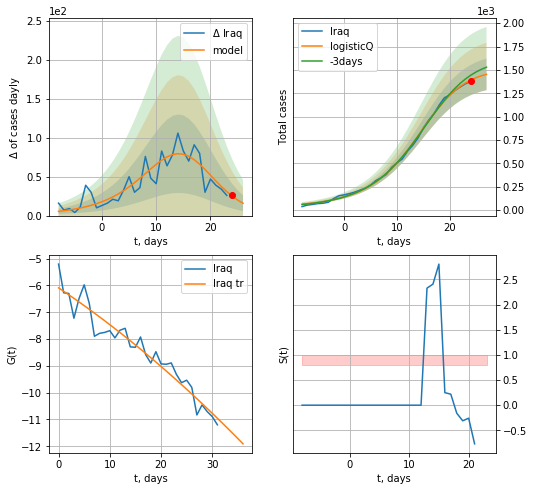

Iraq data at: 2020-07-01
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +3 days
	 deltaDaycases: 15
	 total cases: 1452 ± 169
	 total death: 57 ± 19
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


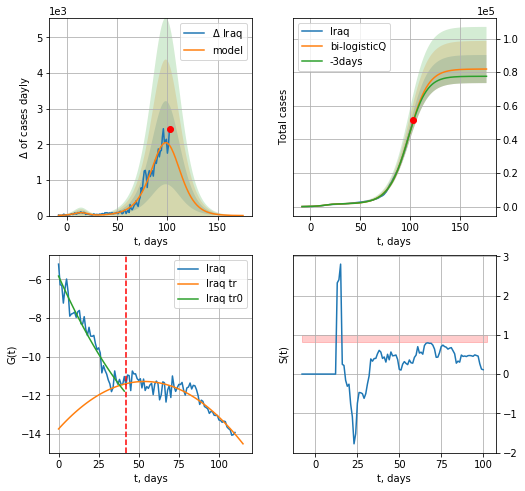

Iraq data at: 2020-07-01
+3 day model MAPE: 0.009554
model: bi-logisticQ
coeffs: [ 8.03918089e+04  1.45091243e-04  9.82939300e+01 -6.02714763e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.102077
forecast at the end of period: +73 days
	 deltaDaycases: 1
	 total cases: 81882 ± 8358
	 total death: 3257 ± 997
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.862986
 intercept_: -13.730825508141544
 coeffs_: [ 0.          0.09161033 -0.00085475]


In [343]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [344]:
#len(dfAR)

AR
           date    cases  active  death
115 2020-06-27  12968.0  2874.0  892.0
116 2020-06-28  13273.0  3005.0  897.0
117 2020-06-29  13571.0  2992.0  905.0
118 2020-06-30  13907.0  3098.0  912.0
119 2020-07-01  14272.0  3312.0  920.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


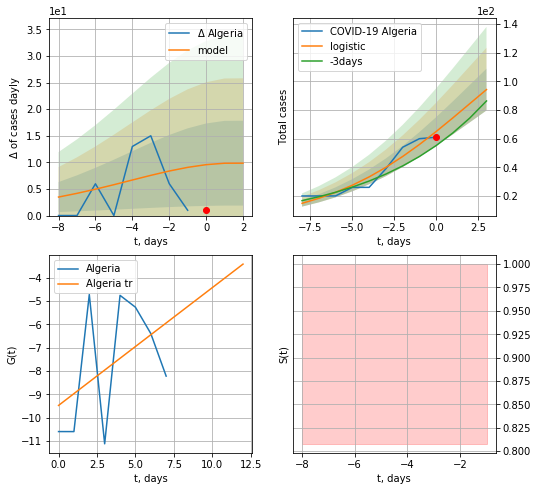

Algeria data at: 2020-07-01
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +3 days
	 deltaDaycases:  9
	 total cases:  94 ± 14
	 total death:  6 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


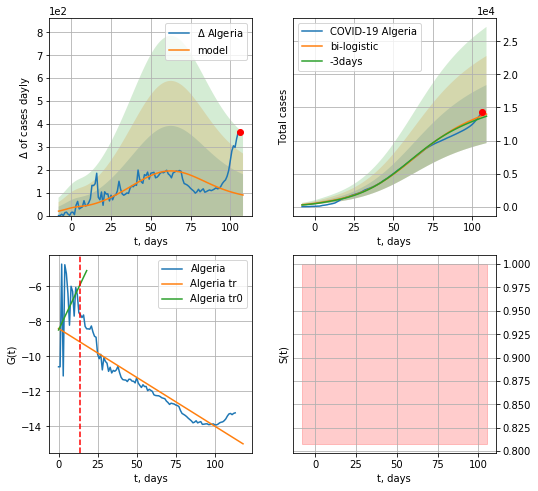

Algeria data at: 2020-07-01
+3 day model MAPE: 0.022976390136141927
model: bi-logistic
coeffs:  [1.37356642e+04 5.50906327e-02 6.19486984e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31348468197131407
forecast at the end of period: +3 days
	 deltaDaycases:  89
	 total cases:  13998 ± 4388
	 total death:  902 ± 848
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.873723
 intercept: -8.411578
 slope: -0.055858


In [345]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*14-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*14-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


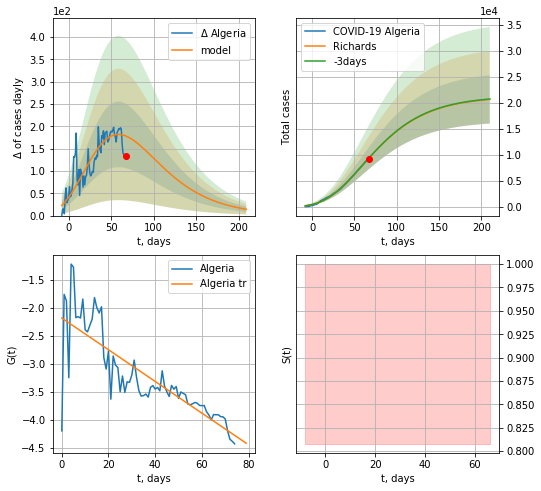

Algeria data at: 2020-07-01
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
rational stdev: 0.224506
forecast at the end of period: +143 days
	 deltaDaycases: 14
	 total cases: 20674 ± 4641
	 total death: 1332 ± 897
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


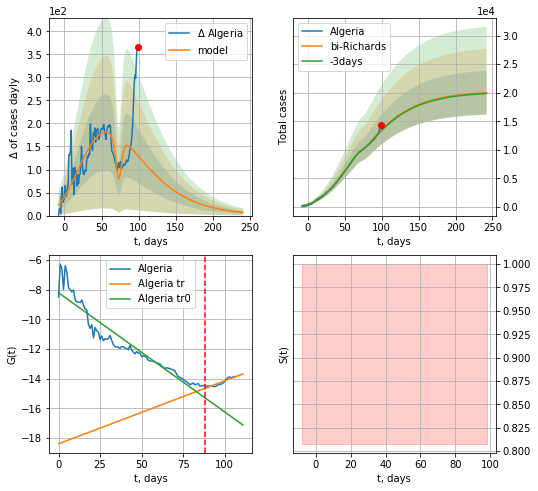

Algeria data at: 2020-07-01
+3 day model MAPE: 0.011410
model: bi-Richards
coeffs: [-9.72535887e+02  3.68683311e-01  7.37073138e+01  1.06576355e+00]
rational stdev: 0.191704
forecast at the end of period: +143 days
	 deltaDaycases: 6
	 total cases: 20020 ± 3837
	 total death: 1290 ± 741
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.906502
 intercept: -8.210948
 slope: -0.080396
trend coefficient of determination: 0.841304
 intercept: -18.397824
 slope: 0.042486


In [346]:
vL = 88+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


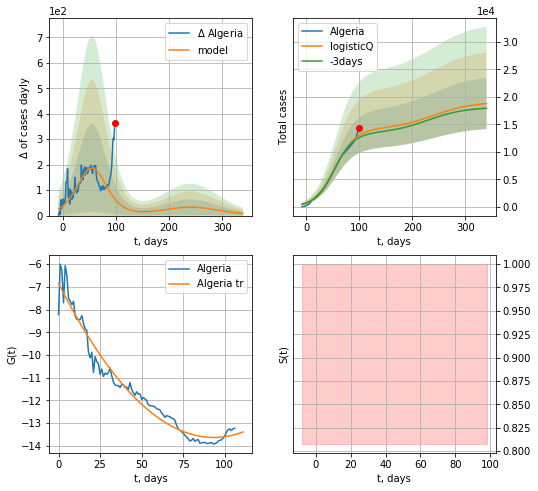

Algeria data at: 2020-07-01
+3 day model MAPE: 0.031850
model: logisticQ
coeffs: [ 1.41140890e+04  4.65101992e-07  5.50707058e+01 -1.13232561e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.247078
forecast at the end of period: +241 days
	 deltaDaycases: 8
	 total cases: 18782 ± 4640
	 total death: 1210 ± 896
trend coefficient of determination: 0.961029
 intercept_: -6.84469328000398
 coeffs_: [ 0.         -0.14560085  0.00077977]


In [347]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date  cases  active  death
107 2020-06-27  994.0   151.0   19.0
108 2020-06-28  994.5   142.0   19.0
109 2020-06-29  996.0   144.0   19.0
110 2020-06-30  998.0   146.0   19.0
111 2020-07-01  999.0   147.0   19.0


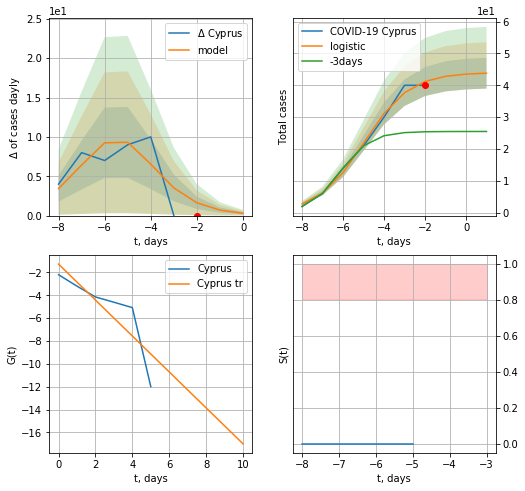

Cyprus data at: 2020-07-01
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


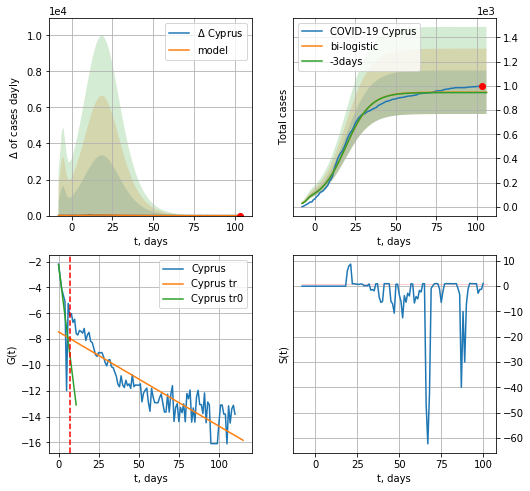

Cyprus data at: 2020-07-01
+3 day model MAPE: 0.003257133240420802
model: bi-logistic
coeffs:  [9.03577325e+02 1.29734245e-01 1.90078077e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.189921745895618
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  947 ± 179
	 total death:  18 ± 10
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.803757
 intercept: -7.441806
 slope: -0.072922


In [348]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*14-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


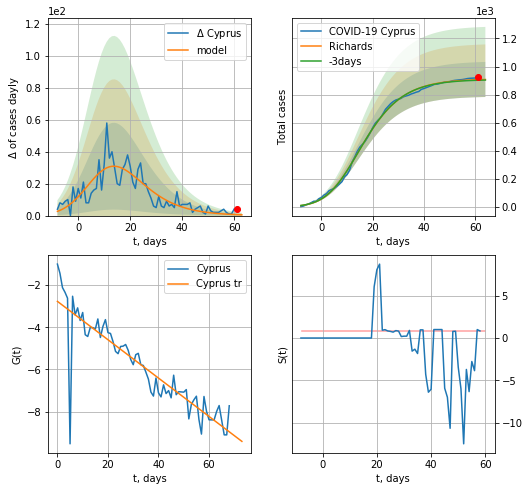

Cyprus data at: 2020-07-01
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 907 ± 124
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


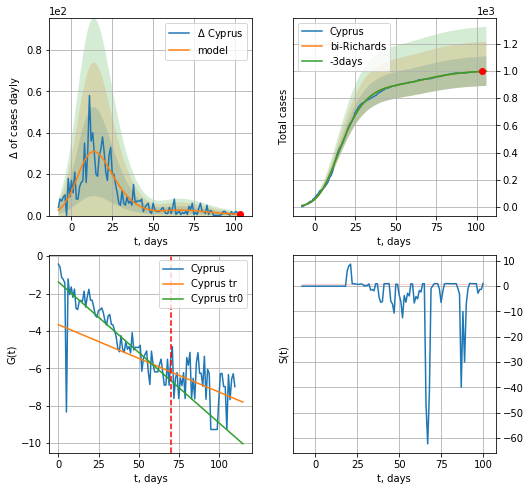

Cyprus data at: 2020-07-01
+3 day model MAPE: 0.000543
model: bi-Richards
coeffs: [9.50430545e+01 6.31705042e+00 3.21398894e+00 1.07430042e-02]
rational stdev: 0.108679
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 999 ± 108
	 total death: 19 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.729364
 intercept: -1.380409
 slope: -0.075264
trend coefficient of determination: 0.119336
 intercept: -3.663695
 slope: -0.036011


In [349]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


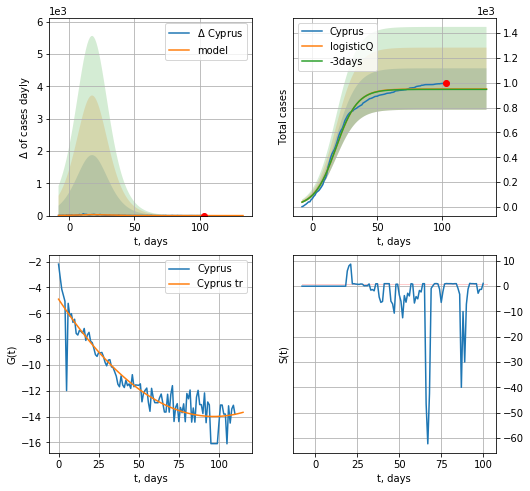

Cyprus data at: 2020-07-01
+3 day model MAPE: 0.003145
model: logisticQ
coeffs: [ 9.49922715e+02  3.51373534e-07  1.81258333e+01 -3.44542750e+05]
rational stdev: 0.175631
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 949 ± 166
	 total death: 18 ± 9
trend coefficient of determination: 0.871815
 intercept_: -4.909428873674736
 coeffs_: [ 0.         -0.1874395   0.00096773]


In [350]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active   death
112 2020-06-27  275989  102830.0  9135.0
113 2020-06-28  279419  102104.0  9317.0
114 2020-06-29  282365  101702.0  9504.0
115 2020-06-30  285213  101001.0  9677.0
116 2020-07-01  288477  100372.0  9860.0


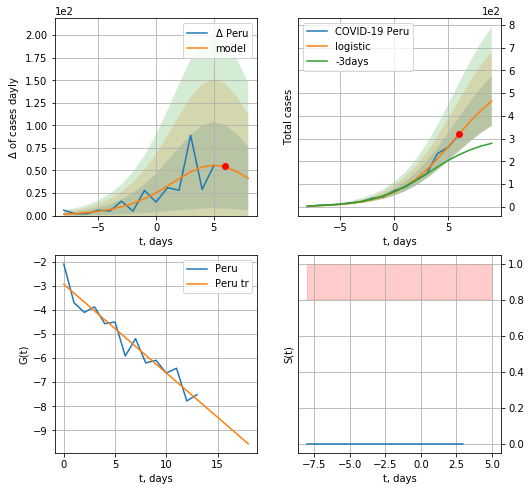

Peru data at: 2020-07-01
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +3 days
	 deltaDaycases:  41
	 total cases:  465 ± 108
	 total death:  15 ± 10
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


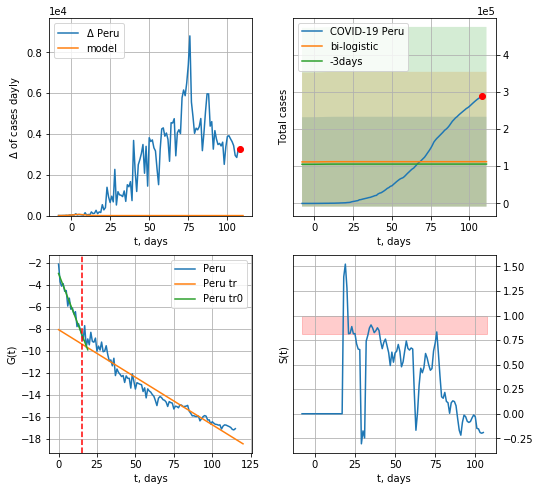

Peru data at: 2020-07-01
+3 day model MAPE: 0.06084384558033296
model: bi-logistic
coeffs:  [ 8.92403121e+04 -1.16598769e+01  2.89972520e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.076162685548348
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  112139 ± 120680
	 total death:  3832 ± 12371
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.940521
 intercept: -8.055264
 slope: -0.086450


In [351]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*14-dT)
xx = forecast2("Peru",dfPU[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


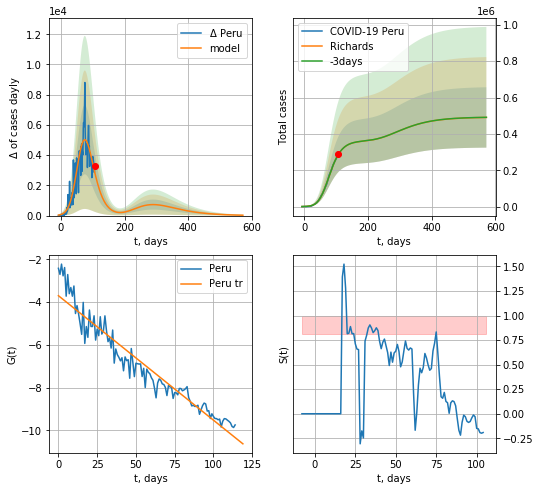

Peru data at: 2020-07-01
+3 day model MAPE: 0.000374
model: Richards
coeffs: [3.61264156e+05 1.08634689e-01 5.60826224e+01 4.18330757e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.338513
forecast at the end of period: +465 days
	 deltaDaycases: 25
	 total cases: 490564 ± 166062
	 total death: 16767 ± 17027
trend coefficient of determination: 0.924437
 intercept: -3.701738
 slope: -0.058169


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


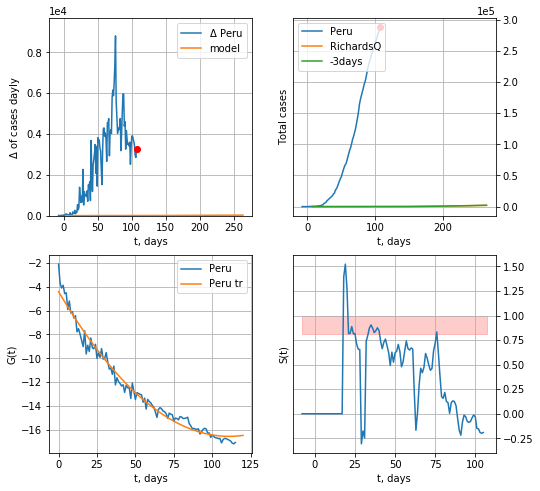

Peru data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.50045829e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +157 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [353]:
x = forecastRR("Peru",dfPU[1:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


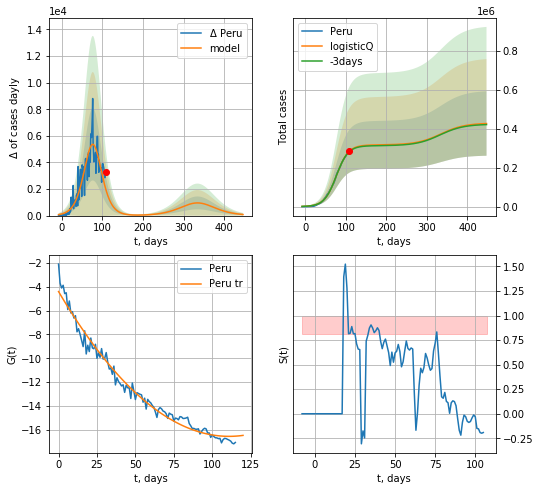

Peru data at: 2020-07-01
+3 day model MAPE: 0.007812
model: logisticQ
coeffs: [ 3.17531198e+05  1.00738732e-06  7.66943546e+01 -6.69507937e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387645
forecast at the end of period: +339 days
	 deltaDaycases: 80
	 total cases: 427592 ± 165754
	 total death: 14614 ± 16995
trend coefficient of determination: 0.978293
 intercept_: -4.401326174339969
 coeffs_: [ 0.         -0.21883093  0.00098612]


In [354]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
119 2020-06-27  529860  203544.0  16111.0
120 2020-06-28  549197  210936.0  16487.0
121 2020-06-29  567536  215361.0  16904.0
122 2020-06-30  585792  220403.0  17410.0
123 2020-07-01  605220  227476.0  17848.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


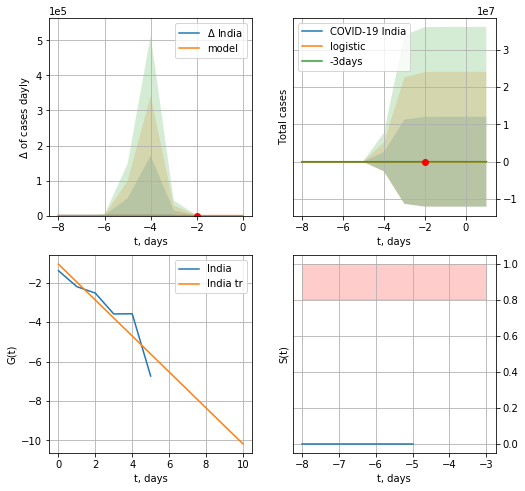

India data at: 2020-07-01
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


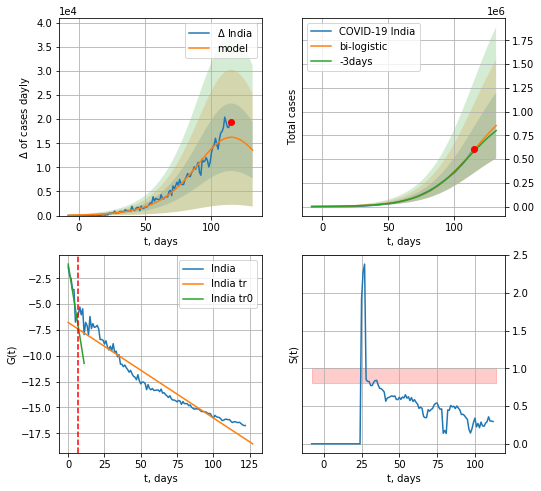

India data at: 2020-07-01
+3 day model MAPE: 0.027505102714321848
model: bi-logistic
coeffs:  [1.18690576e+06 5.44087898e-02 1.15089028e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40581186666449526
forecast at the end of period: +17 days
	 deltaDaycases:  13564
	 total cases:  853630 ± 346413
	 total death:  25173 ± 30646
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.928718
 intercept: -6.767161
 slope: -0.092572


In [355]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*14-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


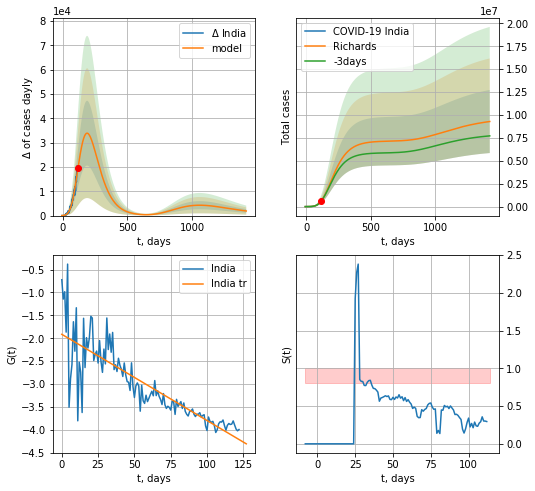

India data at: 2020-07-01
+3 day model MAPE: 0.011142
model: Richards
coeffs: [ 7.15902429e+06  3.14491555e-01 -5.35822901e+01  4.17669266e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.370542
forecast at the end of period: +1305 days
	 deltaDaycases: 1888
	 total cases: 9288678 ± 3441841
	 total death: 273924 ± 304500
trend coefficient of determination: 0.712383
 intercept: -1.914402
 slope: -0.018842


In [356]:
x = forecastRR("India",dfID[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


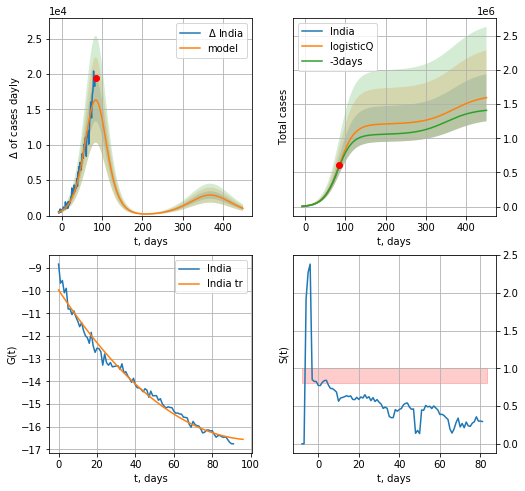

India data at: 2020-07-01
+3 day model MAPE: 0.027047
model: logisticQ
coeffs: [ 1.20689724e+06  2.51697245e-06  8.46519811e+01 -2.14129846e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.216294
forecast at the end of period: +367 days
	 deltaDaycases: 1031
	 total cases: 1592729 ± 344497
	 total death: 46969 ± 30477
trend coefficient of determination: 0.984058
 intercept_: -9.964054341816038
 coeffs_: [ 0.         -0.12890584  0.00062752]


In [357]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active   death
115 2020-06-27  57744.0  37394.0  1207.0
116 2020-06-28  59933.0  38567.0  1232.0
117 2020-06-29  62268.0  39850.0  1280.0
118 2020-06-30  64530.0  41195.0  1307.0
119 2020-07-01  67197.0  42806.0  1351.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


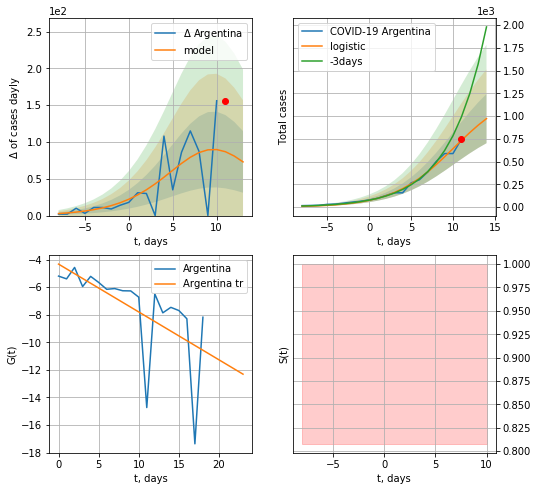

Argentina data at: 2020-07-01
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +3 days
	 deltaDaycases:  72
	 total cases:  972 ± 270
	 total death:  19 ± 15
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


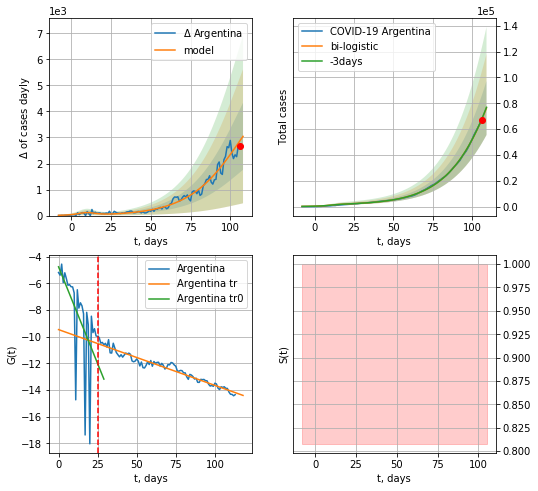

Argentina data at: 2020-07-01
+3 day model MAPE: 0.005174481043276293
model: bi-logistic
coeffs:  [3.12133652e+05 5.41163361e-02 1.30247840e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2737704172142125
forecast at the end of period: +3 days
	 deltaDaycases:  3043
	 total cases:  76400 ± 20916
	 total death:  1536 ± 1261
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.945697
 intercept: -9.470006
 slope: -0.041764


In [358]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*14-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,14*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

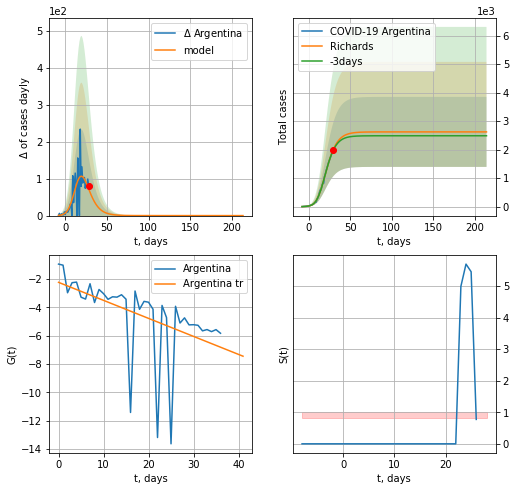

Argentina data at: 2020-07-01
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 52 ± 73
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


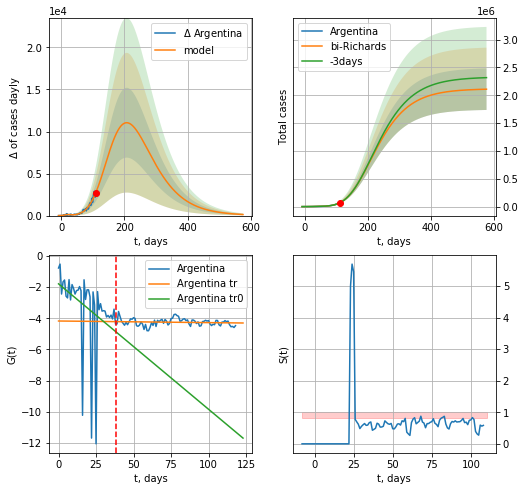

Argentina data at: 2020-07-01
+3 day model MAPE: 0.001004
model: bi-Richards
coeffs: [2.11572709e+06 1.33380692e-01 6.19566595e+01 1.12333485e-01]
rational stdev: 0.176870
forecast at the end of period: +465 days
	 deltaDaycases: 127
	 total cases: 2109854 ± 373170
	 total death: 42418 ± 22507
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.123271
 intercept: -1.789202
 slope: -0.080578
trend coefficient of determination: 0.011058
 intercept: -4.177142
 slope: -0.001036


In [359]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


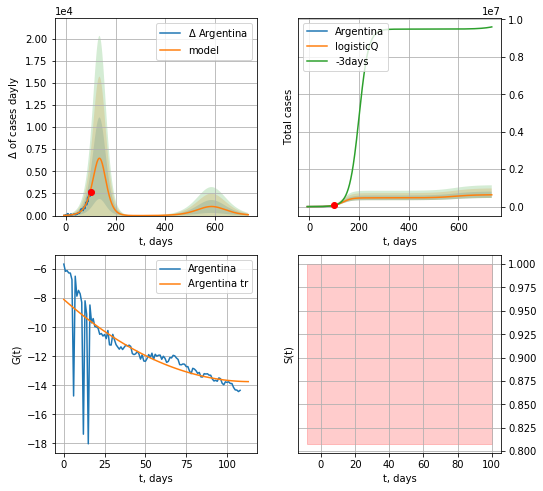

Argentina data at: 2020-07-01
+3 day model MAPE: 0.021384
model: logisticQ
coeffs: [ 4.68615646e+05  5.77151613e-05  1.34302274e+02 -8.22476716e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268475
forecast at the end of period: +633 days
	 deltaDaycases: 98
	 total cases: 630634 ± 169309
	 total death: 12678 ± 10211
trend coefficient of determination: 0.574554
 intercept_: -8.086900287467541
 coeffs_: [ 0.         -0.09872025  0.00043074]


In [360]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


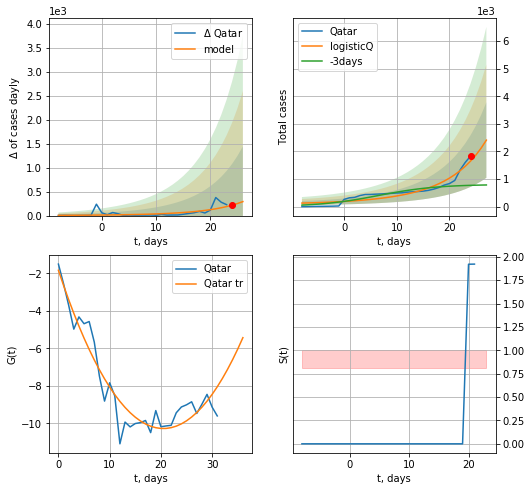

Qatar data at: 2020-07-01
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +3 days
	 deltaDaycases: 291
	 total cases: 2410 ± 1367
	 total death: 2 ± 3
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


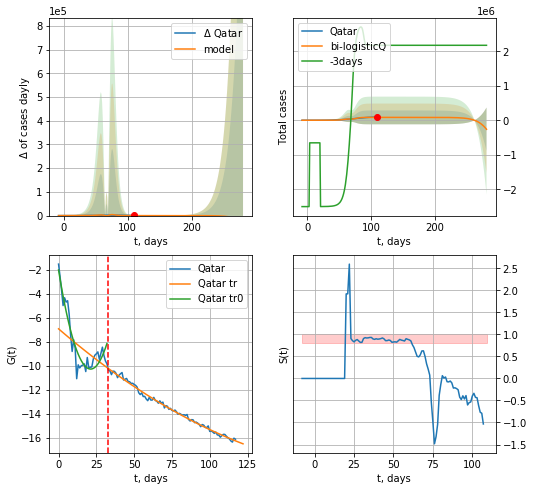

Qatar data at: 2020-07-01
+3 day model MAPE: 0.961655
model: bi-logisticQ
coeffs: [-4.59300384e+06  1.35451067e-03  6.79552491e+01 -1.12289375e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 2.406237
forecast at the end of period: +171 days
	 deltaDaycases: -22757
	 total cases: -261496 ± -629221
	 total death: -310 ± -2237
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.991089
 intercept_: -6.9135693839240915
 coeffs_: [ 0.         -0.10884513  0.00024624]


In [361]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*14-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


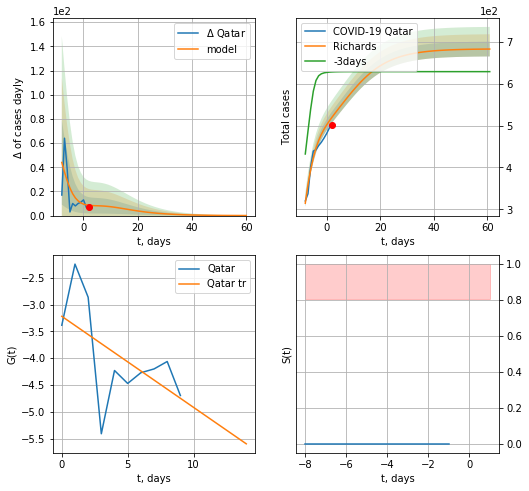

Qatar data at: 2020-07-01
+3 day model MAPE: 0.158936
model: Richards
coeffs: [ 5.01317281e+02  4.80174609e+00 -1.84019810e+01  6.85383715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.025817
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 682 ± 17
	 total death: 0 ± 0
trend coefficient of determination: 0.312842
 intercept: -3.219590
 slope: -0.169880


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


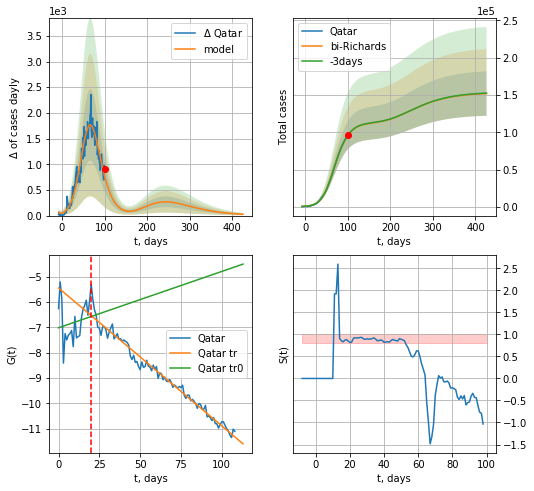

Qatar data at: 2020-07-01
+3 day model MAPE: 0.001571
model: bi-Richards
coeffs: [1.12198130e+05 9.67727604e-02 5.62690912e+01 5.61279240e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.196031
forecast at the end of period: +325 days
	 deltaDaycases: 25
	 total cases: 152000 ± 29796
	 total death: 180 ± 105
bi-Richards approximation splitting point: 20
trend coefficient of determination: 0.028020
 intercept: -7.012190
 slope: 0.022290
trend coefficient of determination: 0.973188
 intercept: -5.437888
 slope: -0.054572


In [362]:
vL = 29
x = forecastRR('Qatar',dfQR[9:vL-9].fillna(0),d1,22*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[9:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-9)

In [363]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
133 2020-06-27  47360.0   11215  311.0
134 2020-06-28  47797.0   11073  313.0
135 2020-06-29  48246.0   10856  314.0
136 2020-06-30  48667.0   10786  315.0
137 2020-07-01  49069.0   10593  316.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


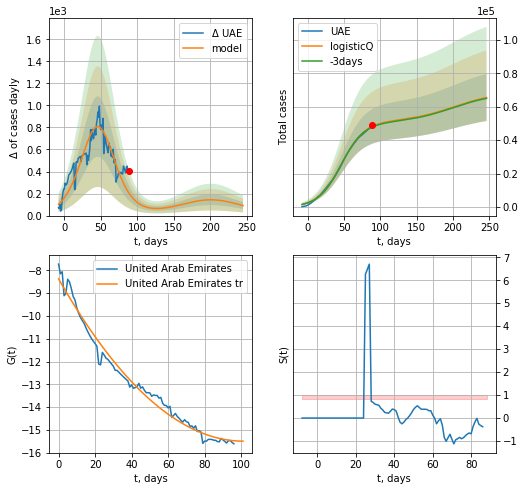

UAE data at: 2020-07-01
+3 day model MAPE: 0.007657
model: logisticQ
coeffs: [ 5.09810289e+04  9.66536344e-07  4.62074218e+01 -6.52442136e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214549
forecast at the end of period: +157 days
	 deltaDaycases: 90
	 total cases: 65508 ± 14054
	 total death: 421 ± 270
trend coefficient of determination: 0.981213
 intercept_: -8.376899658487375
 coeffs_: [ 0.         -0.14042938  0.00069311]


In [364]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


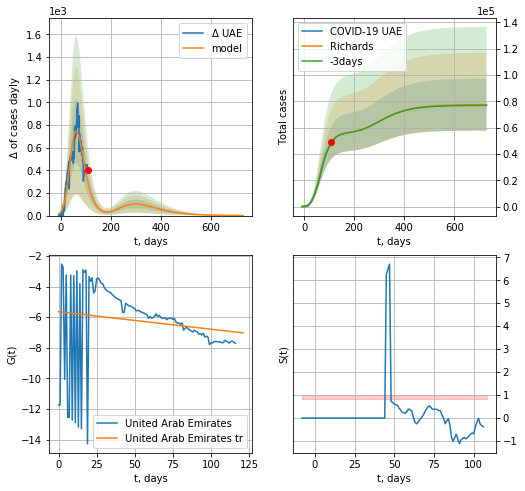

UAE data at: 2020-07-01
+3 day model MAPE: 0.002104
model: Richards
coeffs: [5.69249414e+04 1.50325428e-01 3.05043428e+01 2.68271458e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.254066
forecast at the end of period: +619 days
	 deltaDaycases: 0
	 total cases: 77500 ± 19690
	 total death: 499 ± 380
trend coefficient of determination: 0.026501
 intercept: -5.640461
 slope: -0.011448


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


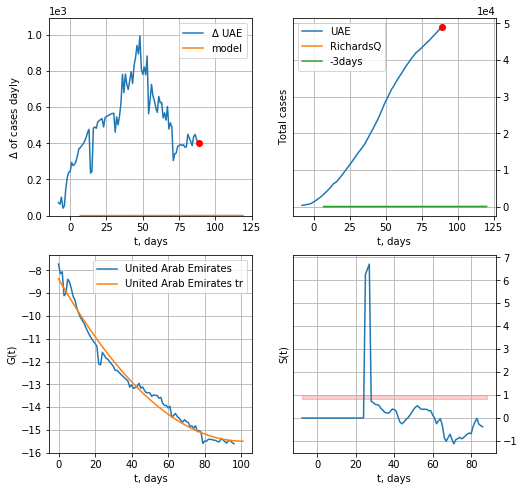

UAE data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.64994494e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +31 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [365]:
vL = 40
x = forecastRR('UAE',dfUAE[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('UAE',dfUAE[:],d1,102*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [366]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
116 2020-06-27  178504.0   54865  1511.0
117 2020-06-28  182493.0   56187  1551.0
118 2020-06-29  186436.0   57719  1599.0
119 2020-06-30  190823.0   58408  1649.0
120 2020-07-01  194225.0   59767  1698.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


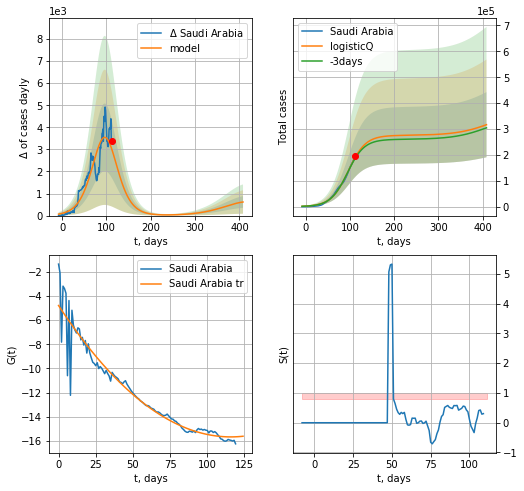

Saudi Arabia data at: 2020-07-01
+3 day model MAPE: 0.019027
model: logisticQ
coeffs: [ 2.75373154e+05  6.24802796e-07  9.65835833e+01 -8.23893156e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397850
forecast at the end of period: +297 days
	 deltaDaycases: 615
	 total cases: 316637 ± 125974
	 total death: 2768 ± 3303
trend coefficient of determination: 0.919589
 intercept_: -4.803991191318383
 coeffs_: [ 0.         -0.18733604  0.00080888]


In [367]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,56*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


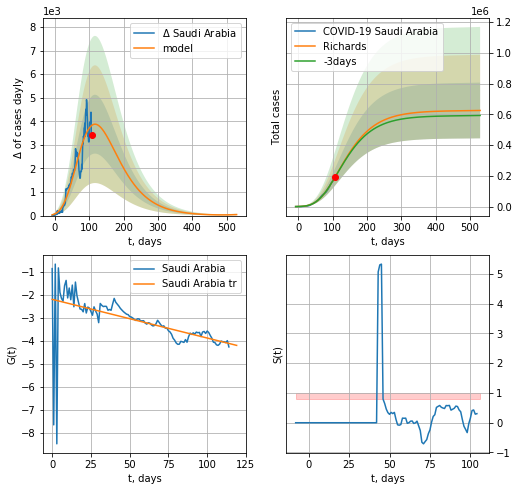

Saudi Arabia data at: 2020-07-01
+3 day model MAPE: 0.006443
model: Richards
coeffs: [ 6.24573820e+05  9.58139904e-01 -1.19462087e+02  1.77767857e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.289733
forecast at the end of period: +423 days
	 deltaDaycases: 42
	 total cases: 625124 ± 181119
	 total death: 5465 ± 4750
trend coefficient of determination: 0.297513
 intercept: -2.189982
 slope: -0.016838


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


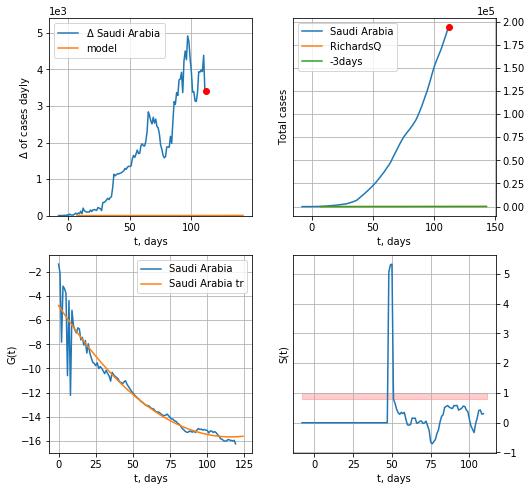

Saudi Arabia data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.80774879e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +31 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [369]:
x = forecastRR('Saudi Arabia',dfSA[5:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
109 2020-06-27  2033.0     383   11.0
110 2020-06-28  2037.0     365   11.0
111 2020-06-29  2039.0     350   11.0
112 2020-06-30  2047.0     325   11.0
113 2020-07-01  2054.0     295   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


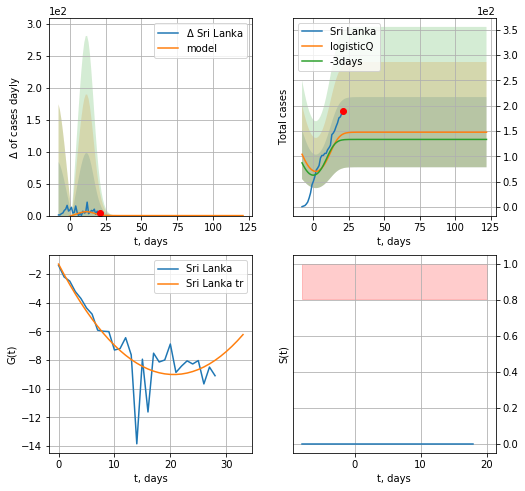

Sri Lanka data at: 2020-07-01
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


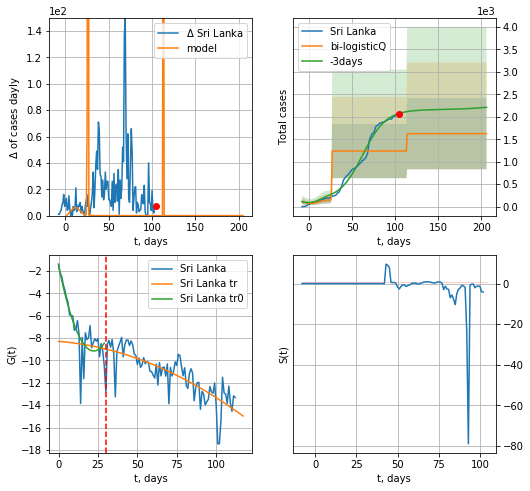

Sri Lanka data at: 2020-07-01
+3 day model MAPE: 0.405635
model: bi-logisticQ
coeffs: [1090.11332724    1.9413406    26.03927389   -9.23622014]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.487832
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 1624 ± 792
	 total death: 8 ± 11
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.614196
 intercept_: -8.296209180610497
 coeffs_: [ 0.         -0.01095973 -0.00039374]


In [370]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

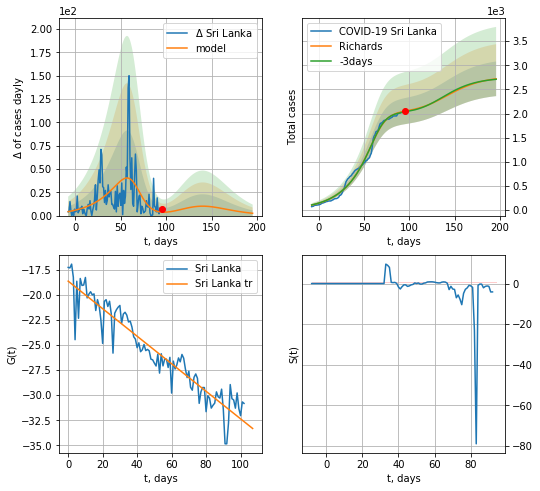

Sri Lanka data at: 2020-07-01
+3 day model MAPE: 0.007643
model: Richards
coeffs: [2.03749835e+03 4.01132407e-02 6.61502648e+01 3.29528477e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.131727
forecast at the end of period: +101 days
	 deltaDaycases: 2
	 total cases: 2718 ± 358
	 total death: 14 ± 5
trend coefficient of determination: 0.895712
 intercept: -18.638335
 slope: -0.137146


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


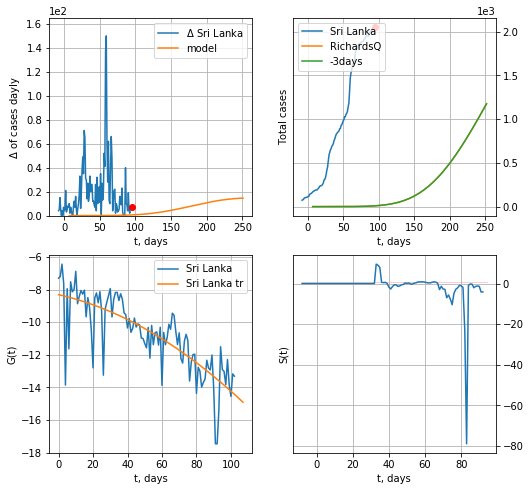

Sri Lanka data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.57221899e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +157 days
	 deltaDaycases: 14


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [371]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
121 2020-06-27  202955.0  106213  4118.0
122 2020-06-28  206512.0  106938  4167.0
123 2020-06-29  209337.0  106530  4304.0
124 2020-06-30  213470.0  108273  4395.0
125 2020-07-01  217809.0  108642  4473.0


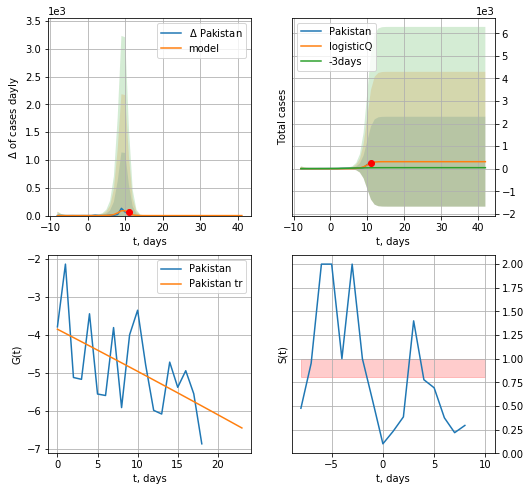

Pakistan data at: 2020-07-01
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


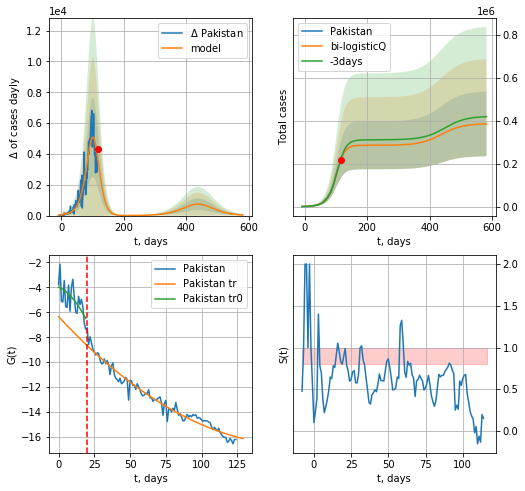

Pakistan data at: 2020-07-01
+3 day model MAPE: 0.022944
model: bi-logisticQ
coeffs: [ 2.85273467e+05  1.63761178e-04  1.00329934e+02 -3.33157399e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391004
forecast at the end of period: +465 days
	 deltaDaycases: 40
	 total cases: 385307 ± 150657
	 total death: 7912 ± 9280
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.963810
 intercept_: -6.345613903204077
 coeffs_: [ 0.         -0.12377319  0.00037105]


In [372]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


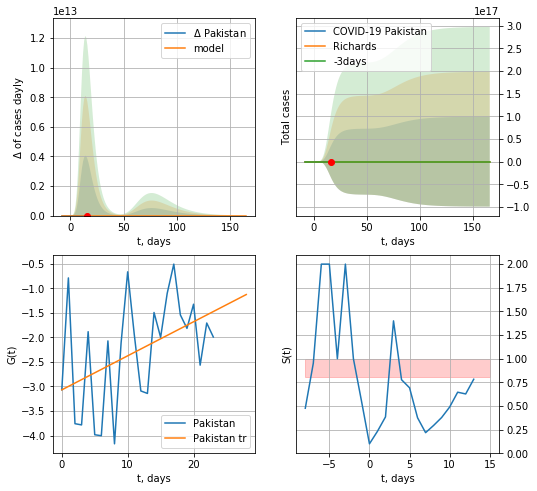

Pakistan data at: 2020-07-01
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +150 days
	 deltaDaycases: 0
	 total cases: 2229 ± 99013155706876528
	 total death: 45 ± 5994221461108005
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


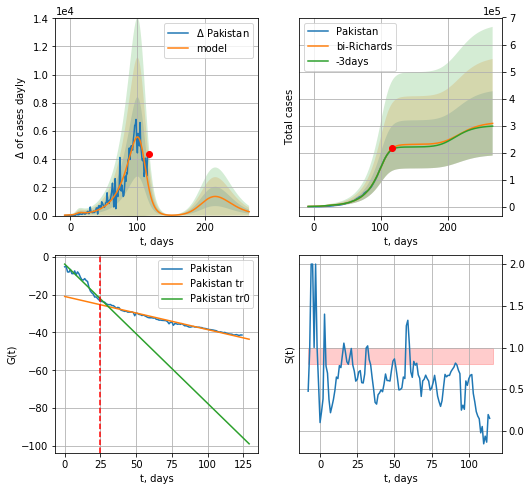

Pakistan data at: 2020-07-01
+3 day model MAPE: 0.019580
model: bi-Richards
coeffs: [2.28647732e+05 5.13670448e-02 1.07765354e+02 3.04458772e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.386705
forecast at the end of period: +150 days
	 deltaDaycases: 273
	 total cases: 307914 ± 119072
	 total death: 6323 ± 7335
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.916860
 intercept: -3.888315
 slope: -0.735767
trend coefficient of determination: 0.977580
 intercept: -20.972535
 slope: -0.175067


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


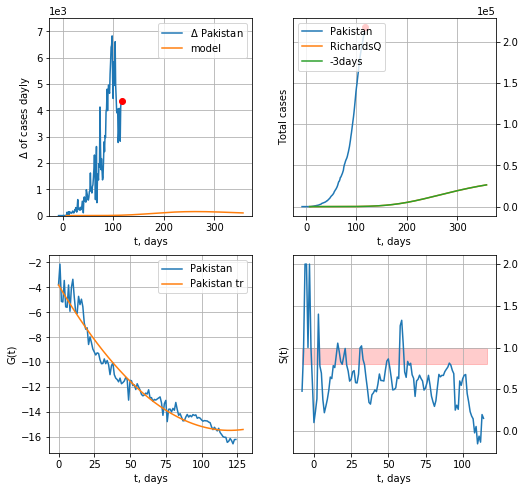

Pakistan data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.68498873e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +241 days
	 deltaDaycases: 101


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [373]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,35*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
111 2020-06-27  133978.0   77965  1695.0
112 2020-06-28  137787.0   80322  1738.0
113 2020-06-29  141801.0   82238  1783.0
114 2020-06-30  145483.0   84012  1847.0
115 2020-07-01  149258.0   85262  1888.0


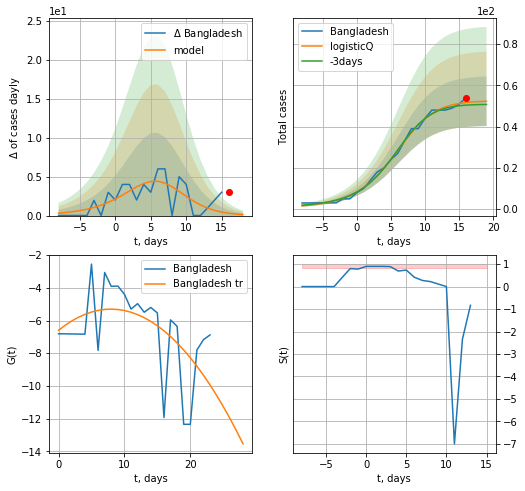

Bangladesh data at: 2020-07-01
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


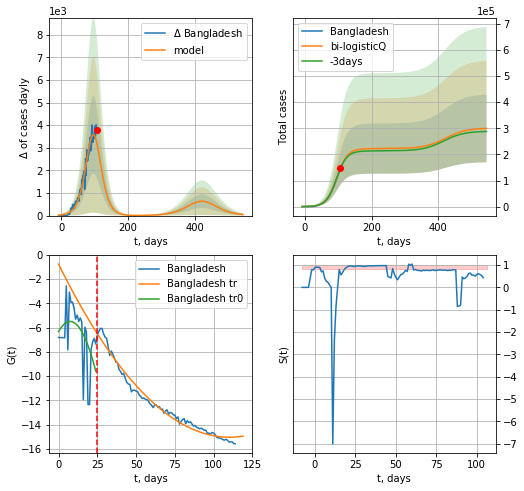

Bangladesh data at: 2020-07-01
+3 day model MAPE: 0.012542
model: bi-logisticQ
coeffs: [ 2.22198302e+05  1.89837782e-06  9.64838208e+01 -3.38189107e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432879
forecast at the end of period: +437 days
	 deltaDaycases: 46
	 total cases: 299519 ± 129655
	 total death: 3788 ± 4919
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.977797
 intercept_: -0.7545935575757206
 coeffs_: [ 0.         -0.2591551   0.00117489]


In [374]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


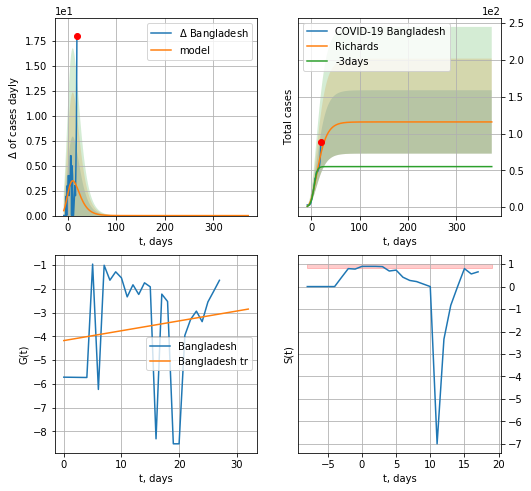

Bangladesh data at: 2020-07-01
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +353 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


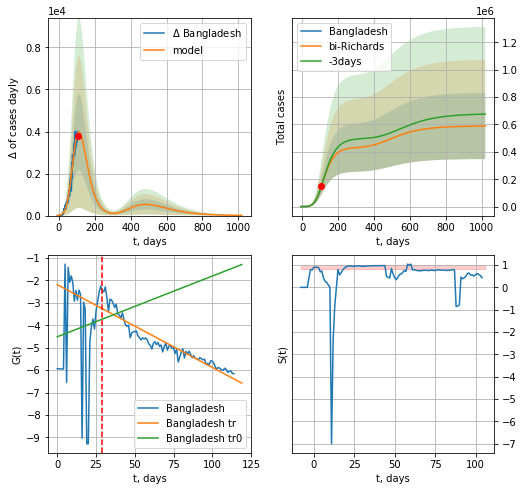

Bangladesh data at: 2020-07-01
+3 day model MAPE: 0.005984
model: bi-Richards
coeffs: [4.32572654e+05 1.32421039e-01 5.63267450e+01 2.08227168e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.410198
forecast at the end of period: +913 days
	 deltaDaycases: 9
	 total cases: 588448 ± 241380
	 total death: 7443 ± 9159
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.009875
 intercept: -4.512753
 slope: 0.027037
trend coefficient of determination: 0.888631
 intercept: -2.192693
 slope: -0.036864


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


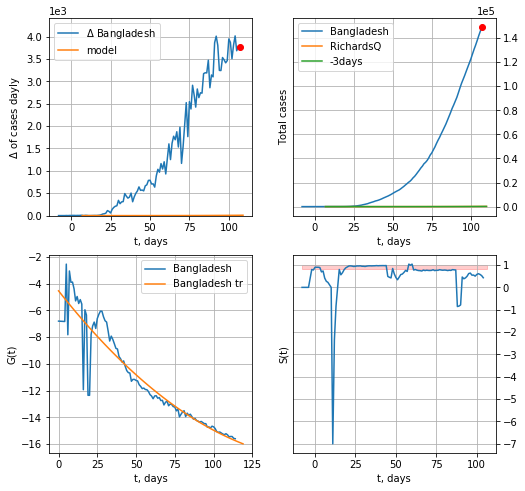

Bangladesh data at: 2020-07-01
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.74739504e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +3 days
	 deltaDaycases: 8


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [375]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,144*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
124 2020-06-27  44391.0    9461  344.0
125 2020-06-28  44942.0    9100  348.0
126 2020-06-29  45524.0    8861  350.0
127 2020-06-30  46195.0    8811  354.0
128 2020-07-01  46940.0    8867  358.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


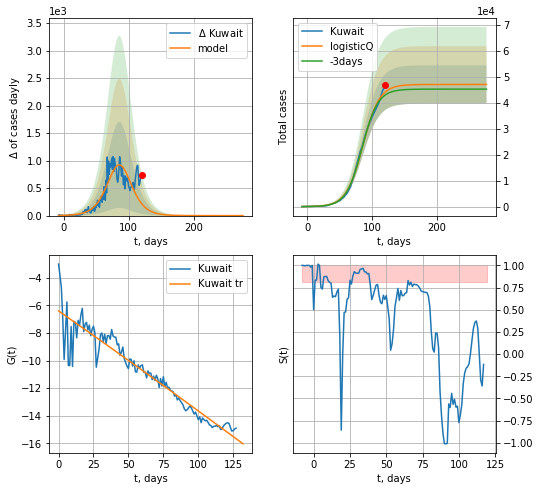

Kuwait data at: 2020-07-01
+3 day model MAPE: 0.026754
model: logisticQ
coeffs: [ 4.71008348e+04  7.09528957e-07  8.59405222e+01 -1.10322091e+05]
rational stdev: 0.157007
forecast at the end of period: +157 days
	 deltaDaycases: 0
	 total cases: 47100 ± 7395
	 total death: 359 ± 169
trend coefficient of determination: 0.902062
 intercept_: -6.3989116118186
 coeffs_: [ 0.00000000e+00 -7.10212594e-02 -1.52738564e-05]


In [376]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


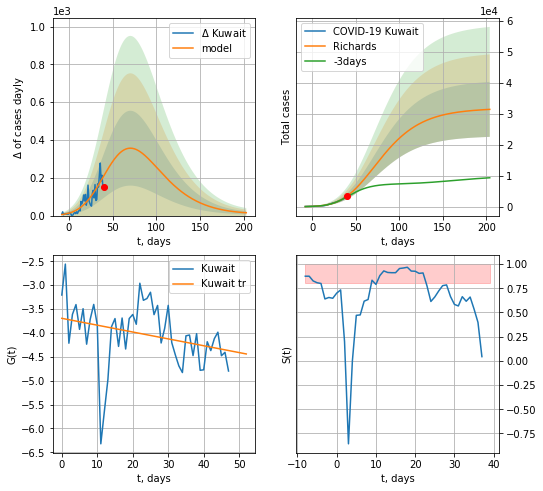

Kuwait data at: 2020-07-01
+3 day model MAPE: 0.076057
model: Richards
coeffs: [3.17726082e+04 1.63031833e-01 2.39076934e+01 2.06099067e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.282402
forecast at the end of period: +164 days
	 deltaDaycases: 15
	 total cases: 31464 ± 8885
	 total death: 239 ± 202
trend coefficient of determination: 0.088534
 intercept: -3.693859
 slope: -0.014352


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


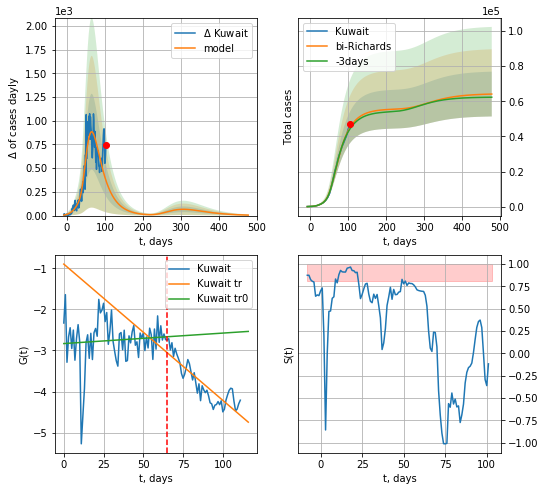

Kuwait data at: 2020-07-01
+3 day model MAPE: 0.017770
model: bi-Richards
coeffs: [ 2.39374064e+04  9.54699554e+00 -1.85204406e+01  6.35779824e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.198814
forecast at the end of period: +374 days
	 deltaDaycases: 5
	 total cases: 64137 ± 12751
	 total death: 489 ± 291
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.007109
 intercept: -2.831481
 slope: 0.002553
trend coefficient of determination: 0.771129
 intercept: -0.894818
 slope: -0.033206


In [405]:
iL= 16
vL = 65 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,67*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
118 2020-06-27  30619.0   13235  718.0
119 2020-06-28  31373.0   13505  726.0
120 2020-06-29  31816.0   13803  733.0
121 2020-06-30  32568.0   14241  747.0
122 2020-07-01  33387.0   14729  754.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


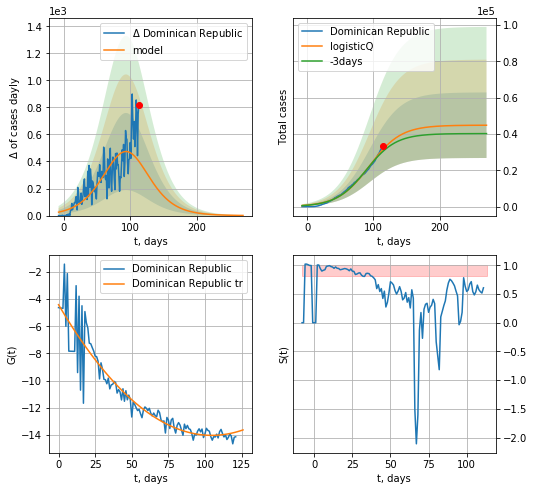

Dominican Republic data at: 2020-07-01
+3 day model MAPE: 0.037242
model: logisticQ
coeffs: [ 4.48416440e+04  3.54643975e-07  9.40037426e+01 -1.19083438e+05]
rational stdev: 0.402671
forecast at the end of period: +157 days
	 deltaDaycases: 1
	 total cases: 44816 ± 18046
	 total death: 1012 ± 1222
trend coefficient of determination: 0.879446
 intercept_: -4.410887199130375
 coeffs_: [ 0.         -0.18362651  0.00087732]


In [406]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


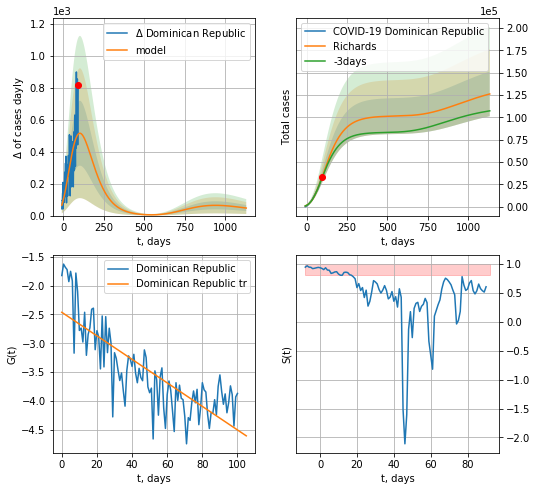

Dominican Republic data at: 2020-07-01
+3 day model MAPE: 0.023234
model: Richards
coeffs: [ 1.01631055e+05  8.98085588e-01 -1.95789356e+02  1.54736715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.198103
forecast at the end of period: +1039 days
	 deltaDaycases: 47
	 total cases: 126209 ± 25002
	 total death: 2850 ± 1693
trend coefficient of determination: 0.647011
 intercept: -2.462585
 slope: -0.020397


In [407]:
x = forecastRR('Dominican Republic',dfDM[21:],d1,162*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

MD
           date    cases  active  death
112 2020-06-27  16080.0    6596  521.0
113 2020-06-28  16250.0    6639  530.0
114 2020-06-29  16357.0    6592  536.0
115 2020-06-30  16613.0    6686  545.0
116 2020-07-01  16898.0    6755  549.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


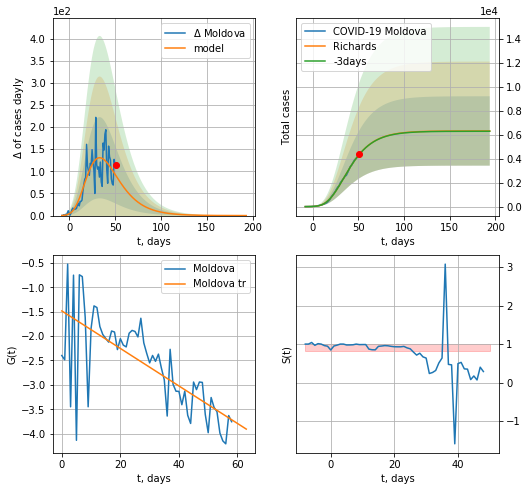

Moldova data at: 2020-07-01
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
rational stdev: 0.458349
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 6304 ± 2889
	 total death: 204 ± 280
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


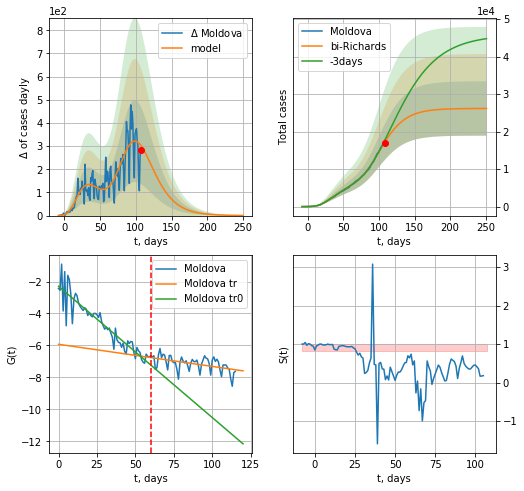

Moldova data at: 2020-07-01
+3 day model MAPE: 0.031742
model: bi-Richards
coeffs: [1.98811256e+04 1.38913078e-01 7.99388611e+01 3.63279148e-01]
rational stdev: 0.277026
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 26176 ± 7251
	 total death: 850 ± 706
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.858538
 intercept: -2.298490
 slope: -0.082134
trend coefficient of determination: 0.240479
 intercept: -5.926752
 slope: -0.013845


In [408]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [409]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
114 2020-06-27  131800.0   62293  2413.0
115 2020-06-28  138134.0   66753  2456.0
116 2020-06-29  144264.0   71121  2529.0
117 2020-06-30  151209.0   75009  2657.0
118 2020-07-01  159333.0   80559  2749.0


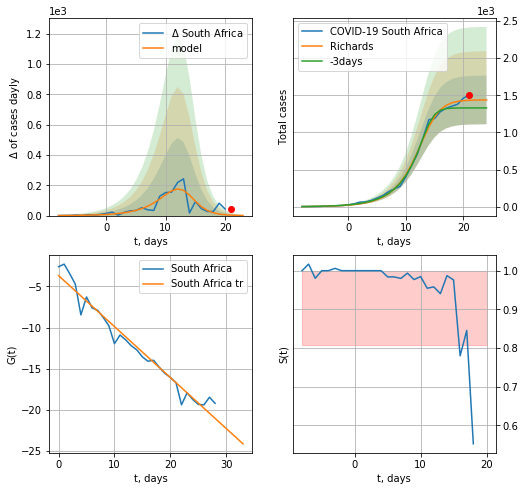

South Africa data at: 2020-07-01
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1437 ± 327
	 total death: 24 ± 16
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


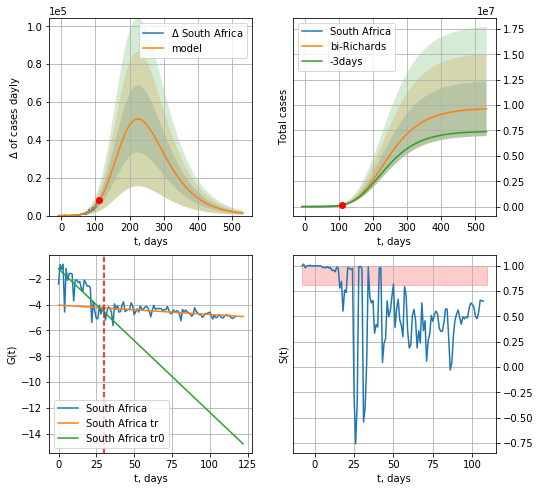

South Africa data at: 2020-07-01
+3 day model MAPE: 0.009639
model: bi-Richards
coeffs: [9.71906389e+06 9.52473721e-02 1.06805888e+02 1.61965262e-01]
rational stdev: 0.279074
forecast at the end of period: +423 days
	 deltaDaycases: 1288
	 total cases: 9637204 ± 2689494
	 total death: 166272 ± 139206
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.533746
 intercept: -1.243849
 slope: -0.110906
trend coefficient of determination: 0.305873
 intercept: -4.047926
 slope: -0.007222


In [410]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,653,835",North America,\nNorth America\n,,"+7,370",832,"+3,565",,"18,964",,"3,246,860","171,261","1,421,764",,
1,,\n,,,"763,359",South America,\nSouth America\n,,"+1,008",78,"+89,705",,"12,892",,"2,299,908","87,067","1,449,482",,
2,,\n,,,"877,616",Europe,\nEurope\n,,,,,,"5,636",,"2,456,661","192,122","1,386,923",,
3,,\n,,,"752,600",Asia,\nAsia\n,,"+6,746",115,"+4,665",,"19,488",,"2,375,132","58,049","1,564,483",,
4,,\n,,,"209,944",Africa,\nAfrica\n,,,,,,919,,"421,382","10,443","200,995",,
5,,\n,,,830,Australia/Oceania,\nOceania\n,,83,,56,,6,,"9,643",126,"8,687",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,258,239",All,World,66.6,"+15,207","+1,025","+97,991",,"57,909",,"10,810,307","519,083","6,032,985",,"1,387"
8,1,119,"2,531",9,"1,484,475",North America,USA,395,,,,"331,007,570","15,898","105,302","2,779,953","130,798","1,164,680","34,855,642","8,398"
9,2,146,"3,501",66,"476,509",South America,Brazil,286,,,"+89,281","212,562,300","8,318","15,184","1,453,369","60,713","916,147","3,227,591","6,837"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,653,835",North America,\nNorth America\n,,"+7,370",832,"+3,565",,"18,964",,"3,246,860","171,261","1,421,764",,
1,,\n,,,"763,359",South America,\nSouth America\n,,"+1,008",78,"+89,705",,"12,892",,"2,299,908","87,067","1,449,482",,
2,,\n,,,"877,616",Europe,\nEurope\n,,,,,,"5,636",,"2,456,661","192,122","1,386,923",,
3,,\n,,,"752,600",Asia,\nAsia\n,,"+6,746",115,"+4,665",,"19,488",,"2,375,132","58,049","1,564,483",,
4,,\n,,,"209,944",Africa,\nAfrica\n,,,,,,919,,"421,382","10,443","200,995",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
119,112,"1,497","34,895",6,216,Europe,Lithuania,29,,,,"2,721,829",16,"157,335","1,818",78,"1,524","428,238",668
352,113,"1,497","34,895",6,216,Europe,Lithuania,29,1,,9,"2,721,829",16,"157,335","1,818",78,"1,524","428,238",668
584,113,"1,498","34,895",6,224,Europe,Lithuania,29,1,,3,"2,721,829",16,"155,351","1,817",78,"1,515","422,840",668


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,653,835",North America,\nNorth America\n,,"+7,370",832,"+3,565",,"18,964",,"3,246,860","171,261","1,421,764",,
1,,\n,,,"763,359",South America,\nSouth America\n,,"+1,008",78,"+89,705",,"12,892",,"2,299,908","87,067","1,449,482",,
2,,\n,,,"877,616",Europe,\nEurope\n,,,,,,"5,636",,"2,456,661","192,122","1,386,923",,
3,,\n,,,"752,600",Asia,\nAsia\n,,"+6,746",115,"+4,665",,"19,488",,"2,375,132","58,049","1,564,483",,
4,,\n,,,"209,944",Africa,\nAfrica\n,,,,,,919,,"421,382","10,443","200,995",,
5,,\n,,,830,Australia/Oceania,\nOceania\n,,83,,56,,6,,"9,643",126,"8,687",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,258,239",All,World,66.6,"+15,207","+1,025","+97,991",,"57,909",,"10,810,307","519,083","6,032,985",,"1,387"
8,1,119,"2,531",9,"1,484,475",North America,USA,395,,,,"331,007,570","15,898","105,302","2,779,953","130,798","1,164,680","34,855,642","8,398"
9,2,146,"3,501",66,"476,509",South America,Brazil,286,,,"+89,281","212,562,300","8,318","15,184","1,453,369","60,713","916,147","3,227,591","6,837"


In [10]:
df.at[13, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[30, 'TotalRecovered'] = 0
df.at[37, 'TotalRecovered'] = 0
df.at[13,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[30,"ActiveCases"] = 0
df.at[37,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1653835,North America,\nNorth America\n,NaN,7370.0,832.0,"+3,565",,18964.0,NaN,3246860,171261.0,1421764.0,NaN,NaN
1,,\n,,,763359,South America,\nSouth America\n,NaN,1008.0,78.0,"+89,705",,12892.0,NaN,2299908,87067.0,1449482.0,NaN,NaN
2,,\n,,,877616,Europe,\nEurope\n,NaN,NaN,NaN,,,5636.0,NaN,2456661,192122.0,1386923.0,NaN,NaN
3,,\n,,,752600,Asia,\nAsia\n,NaN,6746.0,115.0,"+4,665",,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
4,,\n,,,209944,Africa,\nAfrica\n,NaN,NaN,NaN,,,919.0,NaN,421382,10443.0,200995.0,NaN,NaN
5,,\n,,,830,Australia/Oceania,\nOceania\n,NaN,83.0,NaN,56,,6.0,NaN,9643,126.0,8687.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4258239,All,World,66.6,15207.0,1025.0,"+97,991",,57909.0,NaN,10810307,519083.0,6032985.0,NaN,1387.0
8,1,119,"2,531",9,1484475,North America,USA,395.0,NaN,NaN,,"331,007,570",15898.0,105302.0,2779953,130798.0,1164680.0,34855642.0,8398.0
9,2,146,"3,501",66,476509,South America,Brazil,286.0,NaN,NaN,"+89,281","212,562,300",8318.0,15184.0,1453369,60713.0,916147.0,3227591.0,6837.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,752600,Asia,Total:,NaN,6746.0,115.0,"+4,665",,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
227,,,,,209944,Africa,Total:,NaN,NaN,NaN,,,919.0,NaN,421382,10443.0,200995.0,NaN,NaN
228,,,,,830,Australia/Oceania,Total:,NaN,83.0,NaN,,,6.0,NaN,9643,126.0,8687.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,159938,Europe,European Union,299.451648,0.0,0.0,NaN,NaN,2318.0,65537.202277,1290784,133331.0,620657.0,29180473.0,2899.006199


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1653835,North America,North America,NaN,7370.0,832.0,"+3,565",,18964.0,NaN,3246860,171261.0,1421764.0,NaN,NaN
1,,\n,,,763359,South America,South America,NaN,1008.0,78.0,"+89,705",,12892.0,NaN,2299908,87067.0,1449482.0,NaN,NaN
2,,\n,,,877616,Europe,Europe,NaN,NaN,NaN,,,5636.0,NaN,2456661,192122.0,1386923.0,NaN,NaN
3,,\n,,,752600,Asia,Asia,NaN,6746.0,115.0,"+4,665",,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
4,,\n,,,209944,Africa,Africa,NaN,NaN,NaN,,,919.0,NaN,421382,10443.0,200995.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1653835,North America,North America,NaN,7370.0,832.0,"+3,565",,18964.0,NaN,3246860,171261.0,1421764.0,NaN,NaN
1,,\n,,,763359,South America,South America,NaN,1008.0,78.0,"+89,705",,12892.0,NaN,2299908,87067.0,1449482.0,NaN,NaN
2,,\n,,,877616,Europe,Europe,NaN,NaN,NaN,,,5636.0,NaN,2456661,192122.0,1386923.0,NaN,NaN
3,,\n,,,752600,Asia,Asia,NaN,6746.0,115.0,"+4,665",,19488.0,NaN,2375132,58049.0,1564483.0,NaN,NaN
4,,\n,,,209944,Africa,Africa,NaN,NaN,NaN,,,919.0,NaN,421382,10443.0,200995.0,NaN,NaN
5,,\n,,,830,Australia/Oceania,Oceania,NaN,83.0,NaN,56,,6.0,NaN,9643,126.0,8687.0,NaN,NaN
7,,\n,,,4258239,All,World,66.6,15207.0,1025.0,"+97,991",,57909.0,NaN,10810307,519083.0,6032985.0,NaN,1387.0
8,1,119,"2,531",9,1484475,North America,USA,395.0,NaN,NaN,,"331,007,570",15898.0,105302.0,2779953,130798.0,1164680.0,34855642.0,8398.0
9,2,146,"3,501",66,476509,South America,Brazil,286.0,NaN,NaN,"+89,281","212,562,300",8318.0,15184.0,1453369,60713.0,916147.0,3227591.0,6837.0
10,3,223,"15,304",7,221938,Europe,Russia,65.0,NaN,NaN,,"145,934,790",2300.0,136035.0,654405,9536.0,422931.0,19852167.0,4484.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Luxembourg LX
UAE UAE
India ID
Greece GC
Hungary HG
Belarus BR
Singapore SG
Serbia SB
Norway NG
Malaysia ML
Moldova MD
Australia AS
Egypt EG
Ecuador ED
Russia RS
Romania RM
Estonia ES
Belgium BG
France FR
Qatar QR
Israel IS
UK GB
Panama PM
Chile CL
South Africa AF
Algeria AR
Germany GR
Latvia LV
Czechia CH
Sweden SW
Canada CA
Switzerland SZ
Iraq IQ
Kuwait KW
Poland PL
Croatia CT
Argentina AG
Cyprus CP
Morocco MR
Iran IN
Philippines PH
USA US
World World
Dominican Republic DM
Bulgaria BL
Finland FI
Bangladesh BN
Indonesia IE
Slovakia SL
Ireland IR
Japan JP
Lithuania LT
Portugal PT
Thailand TH
Colombia CB
S. Korea KR
Iceland IC
Saudi Arabia SA
Pakistan PS
Turkey TR
Italy IT
Spain SP
Brazil BZ
New Zealand ZL
Netherlands NL
Austria AT
Peru PU
Malta MT
Sri Lanka Sri
Denmark DK
European Union EU
Ukraine Ukr
Mexico MX
Slovenia SV
China CN


In [19]:
len(countryDic)

75

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-07-01,3246860,1653835,171261.0
South America
South America 2020-07-01,2299908,763359,87067.0
Europe
Europe 2020-07-01,2456661,877616,192122.0
Asia
Asia 2020-07-01,2375132,752600,58049.0
Africa
Africa 2020-07-01,421382,209944,10443.0
Oceania
Oceania 2020-07-01,9643,830,126.0
World
World 2020-07-01,10810307,4258239,519083.0
USA
USA 2020-07-01,2779953,1484475,130798.0
Brazil
Brazil 2020-07-01,1453369,476509,60713.0
Russia
Russia 2020-07-01,654405,221938,9536.0
India
India 2020-07-01,605220,227476,17848.0
UK
UK 2020-07-01,313483,0,43906.0
Spain
Spain 2020-07-01,296739,0,28363.0
Peru
Peru 2020-07-01,288477,100372,9860.0
Chile
Chile 2020-07-01,282043,30847,5753.0
Italy
Italy 2020-07-01,240760,15255,34788.0
Mexico
Mexico 2020-07-01,231770,64941,28510.0
Iran
Iran 2020-07-01,230211,27766,10958.0
Pakistan
Pakistan 2020-07-01,217809,108642,4473.0
Turkey
Turkey 2020-07-01,201098,20526,5150.0
Germany
Germany 2020-07-01,196324,7463,9061.0
Saudi Arabia
Saudi Arabia 20

Vatican City
Vatican City 2020-07-01,12,0,nan
Montserrat
Montserrat 2020-07-01,11,0,1.0
Papua New Guinea
Papua New Guinea 2020-07-01,11,3,nan
Western Sahara
Western Sahara 2020-07-01,10,1,1.0
MS Zaandam
MS Zaandam 2020-07-01,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-07-01,8,0,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-07-01,7,0,nan
St. Barth
St. Barth 2020-07-01,6,0,nan
Anguilla
Anguilla 2020-07-01,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-07-01,1,0,nan
China
China 2020-07-01,83537,416,4634.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
Total:
Total: 2020-07-01,3246860,1653835,171261.0
European Union
European Union 2020-07-01,1290784,159938,133331.0


In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaLX.csv 2020-07-01,4345,232,110.0

append data/coronaUAE.csv 2020-07-01,49069,10593,316.0

append data/coronaID.csv 2020-07-01,605220,227476,17848.0

append data/coronaGC.csv 2020-07-01,3432,1866,192.0

append data/coronaHG.csv 2020-07-01,4157,857,586.0

append data/coronaBR.csv 2020-07-01,62424,14473,398.0

append data/coronaSG.csv 2020-07-01,44122,5085,26.0

append data/coronaSB.csv 2020-07-01,14836,1783,281.0

append data/coronaNG.csv 2020-07-01,8896,507,251.0

append data/coronaML.csv 2020-07-01,8640,144,121.0

append data/coronaMD.csv 2020-07-01,16898,6755,549.0

append data/coronaAS.csv 2020-07-01,8001,807,104.0

append data/coronaEG.csv 2020-07-01,69814,47899,3034.0

append data/coronaED.csv 2020-07-01,58257,25794,4576.0

append data/coronaRS.csv 2020-07-01,654405,221938,9536.0

append data/coronaRM.csv 2020-07-01,27296,6315,1667.0

append data/coronaES.csv 2020-07-01,1989,84,69.0

append data/coronaBG.csv 2020-07-01,61509,34734,9754.0

append data/coronaFR.csv 

In [32]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400